# SCI-Paper
脊髓损伤——预测icu时间长短

一、准备采用的特征选择算法共７种：

参考：https://www.cnblogs.com/stevenlk/p/6543628.html

PCA : from sklearn.decomposition import PCA

LASSO-Logitic

mRMR: https://blog.csdn.net/cpc784221489/article/details/94409388

二、准备采用gridsearch来找最佳机器学习算法的最佳超参数
参考： https://blog.csdn.net/baidu_15113429/article/details/72651894

# Prepare

In [1]:
seed = 42
import random
random.seed( seed )
import numpy as np
np.random.seed(seed)

In [2]:
from ultils_for_ML_binary_classify import *
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split

# Data Preprocess

## Read Original Data

In [3]:
dir_result = './SCI-Paper-results-los_icustay'# where to save results
if not os.path.isdir(dir_result):
    os.mkdir(dir_result)

## internal data-set
from utils_SCI_data_process import SCI_data_process
fname = './data/Version20201122/los_icustay/MIMIC-internal/imputed-MIMIC-first.csv'
sheet_name = "imputed-MIMIC-first"
Y_feature_name = "los_icustays"
# columns to be deleted
delete_columns = [#"in.hospital.death",#指定要删除的，因为刚入住时，不知道这个特征数值
                  "drg_severity",#外部测试集无此特征#外部测试集无此特征
                  "drg_mortality",#外部测试集无此特征
                  "insurance",#外部测试集无此特征
                  "marital_status",#外部测试集无此特征
                  "los_emergency",#外部测试集无此特征
                  "temperature",#外部测试集无此特征
                  "Neutrophils",#外部测试集无此特征
                  #"los_hospital"#指定要删除的，因为刚入住时，不知道这个特征数值
                 ]
# category columns
dummy_columns = ["marital_status",
                 "ethnicity",
                 "gender",
                 "careunit"
                 "source.of.admission",#Version20201122新增分类变量
                ]

#　extract data-set
YX_internal, X_feature_names_internal, Y_feature_name_internal = SCI_data_process(fname,
                                                                                  sheet_name,
                                                                                  Y_feature_name,
                                                                                  delete_columns,
                                                                                  dummy_columns,
                                                                                 )


## External data-set
fname_external = './data/Version20201122/los_icustay/EICU-external/imputed/imputed-EICU-first.csv'
sheet_name = "imputed-EICU-first"
Y_feature_name = "los_icustays"
# columns to be deleted
delete_columns = [#"in.hospital.death",#指定要删除的，因为刚入住时，不知道这个特征数值
                  #"los_hospital"#指定要删除的，因为刚入住时，不知道这个特征数值
                 ]
# category columns
dummy_columns = ["ethnicity",
                 "gender",
                 "careunit",
                 "source.of.admission",#Version20201122新增分类变量
                 #"insurance",
                 #"marital_status",
                ]
YX_external, X_feature_names_external, Y_feature_name_external = SCI_data_process(fname_external,
                                                                                  sheet_name,
                                                                                  Y_feature_name,
                                                                                  delete_columns,
                                                                                  dummy_columns)
import operator
assert operator.eq(X_feature_names_internal,X_feature_names_external)

## combine internal data-set and external data-set
import operator
assert operator.eq(X_feature_names_internal,X_feature_names_external)
assert operator.eq(Y_feature_name_internal,Y_feature_name_external)
YX = pd.concat([YX_internal,YX_external],axis=0,ignore_index=True)

X_feature_names, Y_feature_name = X_feature_names_internal, Y_feature_name_internal

# display data-set
display(YX)

,los_icustays,sum_diagnosis,age,WBC,HR,respiration,Arterial.BP..Diastolic.,Arterial.BP..Systolic.,Arterial.BP..mean.,Potassium,...,Norepinephrine,ethnicity: Asian,ethnicity: Hispanic,ethnicity: Other,ethnicity: White,gender: M,careunit: MICU/SICU,careunit: NICU,source.of.admission: General care area/OR,source.of.admission: Transfer
0,1.897000,14,62,9.4,82,21,92,139,107.667000,4.8,...,0,0,0,0,1,1,1,0,0,0
1,28.688000,18,45,11.3,70,23,44,90,59.333302,3.9,...,1,0,1,0,0,1,1,0,0,0
2,1.325600,5,25,9.0,70,15,75,147,99.000000,4.0,...,0,0,0,0,1,1,1,0,0,0
3,1.473700,9,28,13.4,80,18,30,66,42.000000,4.1,...,0,0,0,0,1,1,1,0,0,0
4,1.047300,10,65,18.3,90,13,70,143,94.333298,3.5,...,0,0,0,0,1,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1260,3.171528,1,61,4.5,77,13,63,134,91.000000,5.0,...,0,0,0,0,1,1,1,0,0,0
1261,2.047917,2,61,9.9,78,23,62,113,82.000000,4.6,...,0,0,0,0,1,1,0,1,0,0
1262,0.462500,1,53,9.3,91,22,82,148,109.000000,3.9,...,0,0,0,0,0,1,0,1,0,0
1263,7.384028,6,40,6.6,83,28,72,117,88.000000,4.1,...,0,0,0,0,0,1,0,1,0,0


In [4]:
YX.columns

Index(['los_icustays', 'sum_diagnosis', 'age', 'WBC', 'HR', 'respiration',
       'Arterial.BP..Diastolic.', 'Arterial.BP..Systolic.',
       'Arterial.BP..mean.', 'Potassium', 'Sodium', 'PO2', 'PT', 'PTT',
       'Glucose.Blood', 'Hemoglobin', 'RDW', 'BUN', 'platelets', 'creatinine',
       'bicarbonate', 'hematocrit', 'lactate', 'INR', 'BE', 'Basophils', 'Ca',
       'Chloride', 'Free.Ca', 'Phosphate', 'Eosinophils', 'Lymphocytes',
       'Magnesium', 'Monocytes', 'PCO2', 'RBC', 'MCH', 'MCHC', 'MCV', 'PH',
       'Anion.Gap', 'CO2.Blood', 'Specific.Gravity', 'GCS.total',
       'Los.before.ICU.admission', 'Paralysis', 'Mechanical.ventilation',
       'Weight', 'Height', 'BMI', 'Fio2', 'Total.bilirubin', 'Albumin',
       'Morphine.Sulfate', 'cefazolin', 'Kcl', 'glucocorticoid', 'Dopamine',
       'Dobutamine', 'Epinephrine', 'Norepinephrine', 'ethnicity: Asian',
       'ethnicity: Hispanic', 'ethnicity: Other', 'ethnicity: White',
       'gender: M', 'careunit: MICU/SICU', 'careunit:

## Statistic Analysis of Original Data

<ipython-input-5-199a9c531d69>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  YX[Y_feature_name][indx_short]=0
<ipython-input-5-199a9c531d69>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  YX[Y_feature_name][indx_long]=1


,sum_diagnosis,age,WBC,HR,respiration,Arterial.BP..Diastolic.,Arterial.BP..Systolic.,Arterial.BP..mean.,Potassium,Sodium,...,Norepinephrine,ethnicity: Asian,ethnicity: Hispanic,ethnicity: Other,ethnicity: White,gender: M,careunit: MICU/SICU,careunit: NICU,source.of.admission: General care area/OR,source.of.admission: Transfer
0,0.420958,0.334026,-0.416585,-0.157241,0.406698,1.154416,0.472402,1.067031,1.112180,-0.031001,...,-0.486373,-0.158498,-0.219210,-0.242028,0.590435,0.62092,0.513553,-0.399358,-0.48513,-0.28818
1,0.869295,-0.544012,-0.138201,-0.732125,0.653744,-1.327214,-1.315148,-1.254084,-0.260175,1.028333,...,2.056033,-0.158498,4.561836,-0.242028,-1.693665,0.62092,0.513553,-0.399358,-0.48513,-0.28818
2,-0.587800,-1.576997,-0.475192,-0.732125,-0.334440,0.275505,0.764247,0.650819,-0.107691,0.180866,...,-0.486373,-0.158498,-0.219210,-0.242028,0.590435,0.62092,0.513553,-0.399358,-0.48513,-0.28818
3,-0.139463,-1.422049,0.169487,-0.253055,0.036129,-2.051023,-2.190683,-2.086476,0.044793,-0.666602,...,-0.486373,-0.158498,-0.219210,-0.242028,0.590435,0.62092,0.513553,-0.399358,-0.48513,-0.28818
4,-0.027379,0.488974,0.887426,0.226015,-0.581485,0.017002,0.618325,0.426711,-0.870111,0.604599,...,-0.486373,-0.158498,-0.219210,-0.242028,0.590435,0.62092,0.513553,-0.399358,-0.48513,-0.28818
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1260,-1.036137,0.282376,-1.134523,-0.396776,-0.581485,-0.344902,0.289999,0.266637,1.417148,-3.209003,...,-0.486373,-0.158498,-0.219210,-0.242028,0.590435,0.62092,0.513553,-0.399358,-0.48513,-0.28818
1261,-0.924052,0.282376,-0.343326,-0.348869,0.653744,-0.396603,-0.476094,-0.165568,0.807213,-0.454735,...,-0.486373,-0.158498,-0.219210,-0.242028,0.590435,0.62092,-1.947220,2.504020,-0.48513,-0.28818
1262,-1.036137,-0.130818,-0.431237,0.273922,0.530221,0.637409,0.800728,1.131046,-0.260175,-0.666602,...,-0.486373,-0.158498,-0.219210,-0.242028,-1.693665,0.62092,-1.947220,2.504020,-0.48513,-0.28818
1263,-0.475716,-0.802258,-0.826835,-0.109334,1.271359,0.120403,-0.330171,0.122569,0.044793,-0.031001,...,-0.486373,-0.158498,-0.219210,-0.242028,-1.693665,0.62092,-1.947220,2.504020,-0.48513,-0.28818


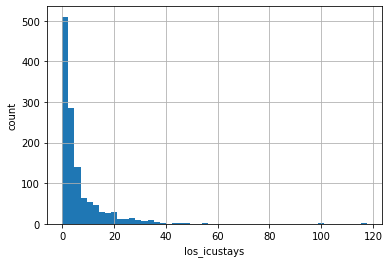

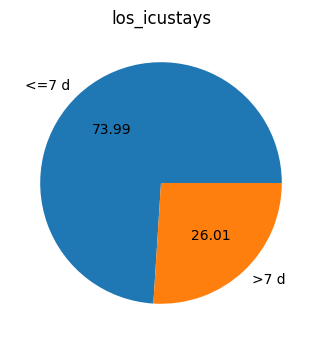

In [5]:
## distribution of Y（eg: hist plot, median value）
# fillna# hasnans# groupby# mean
ax = YX[Y_feature_name].hist(bins=50)
ax.set_xlabel(Y_feature_name)
ax.set_ylabel('count')
# print('median: ',YX['los_hospital'].median())
fn = os.path.join(dir_result,'internal-dataset Histgram of sum_admission.png')
plt.savefig(fn)

## pie plot of Y grouping
# Y grouping
indx_short = YX[Y_feature_name]<=7
indx_long = YX[Y_feature_name]>7
YX[Y_feature_name][indx_short]=0
YX[Y_feature_name][indx_long]=1
YX[Y_feature_name].value_counts()

df = YX[Y_feature_name].replace({0: '<=7 d', 1: '>7 d'},inplace=False).value_counts()
f,ax = plt.subplots(dpi=100)
df.plot.pie(figsize=(4, 4),autopct='%.2f',title=Y_feature_name)#,index=['short','long']
ax.set_ylabel('')
fn = os.path.join(dir_result,'Internal Dataset Pie Chart of Dependent Variable.png')
plt.savefig(fn)


## Standardized processing，ouput format: pandas dataframe
X = YX[X_feature_names]
from sklearn.preprocessing import StandardScaler
sc = StandardScaler(with_mean=True, with_std=True)

X = sc.fit_transform(X)
X = pd.DataFrame(data=X,columns=X_feature_names)
Y = YX[Y_feature_name]

# StratifiedShuffleSplit
index0 = np.array(np.where(Y.values.ravel()==0)).squeeze().tolist()
index1 = np.array(np.where(Y.values.ravel()==1)).squeeze().tolist()
X0,Y0 = X.iloc[index0,:], Y.iloc[index0]
X1,Y1 = X.iloc[index1,:], Y.iloc[index1]
X_train0, X_test0, Y_train0, Y_test0 = train_test_split(
    X0, Y0, test_size=0.2, random_state=123)
X_train1, X_test1, Y_train1, Y_test1 = train_test_split(
    X1, Y1, test_size=0.2, random_state=321)
X_train = pd.concat([X_train0,X_train1],axis=0)#合并
X_test = pd.concat([X_test0,X_test1],axis=0)
Y_train = pd.concat([Y_train0,Y_train1],axis=0)
Y_test = pd.concat([Y_test0,Y_test1],axis=0)

processed_data={'X_train':X_train,
                'Y_train':Y_train,
                'X_test':X_test,
                'Y_test':Y_test,
                'class_names':['<=7 d', '>7 d']
               }
display(X)

n_repeats = 3 # p time
n_splits = 5 # k fold

# Train and Validation

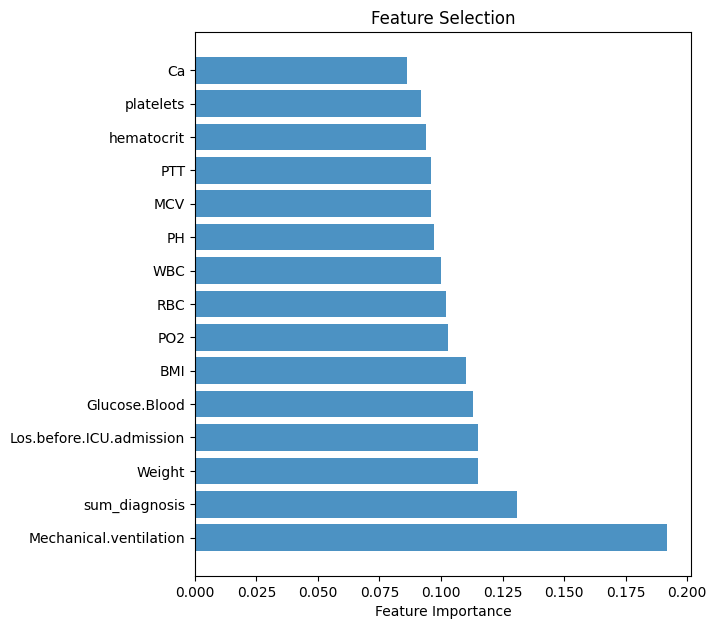

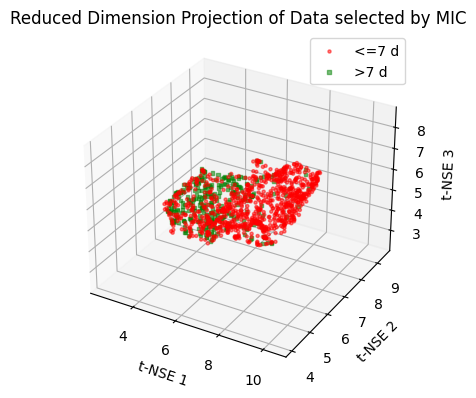

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


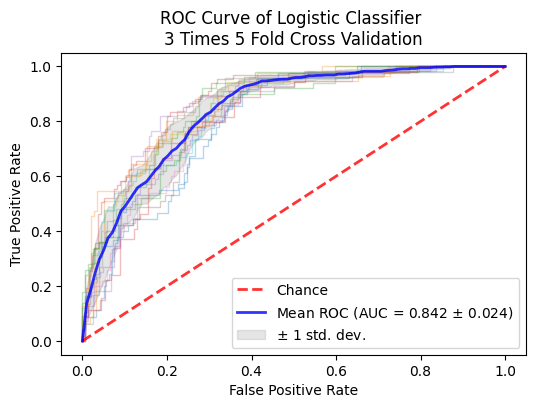

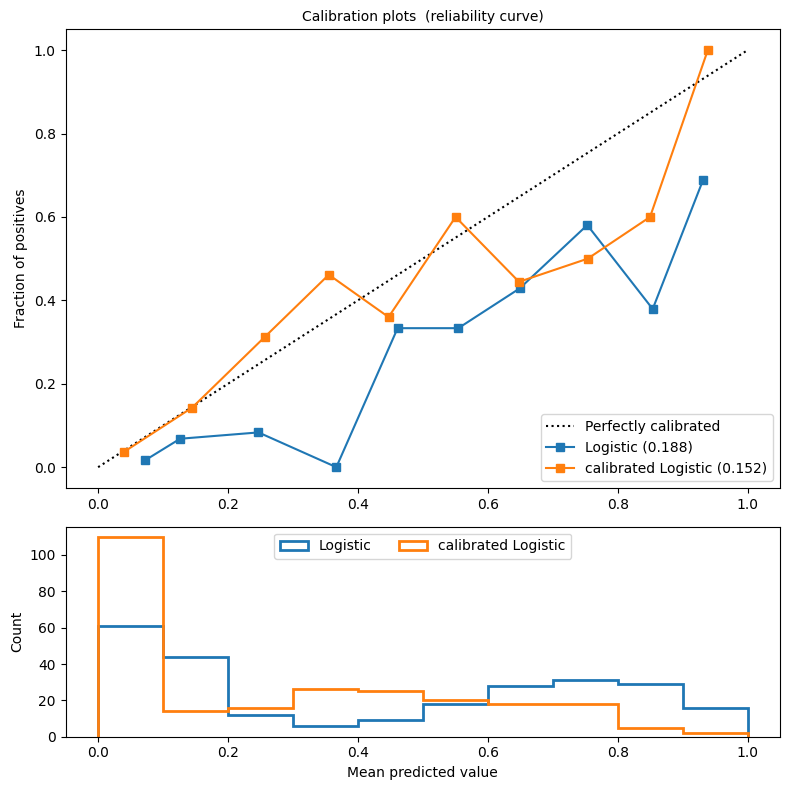

No handles with labels found to put in legend.


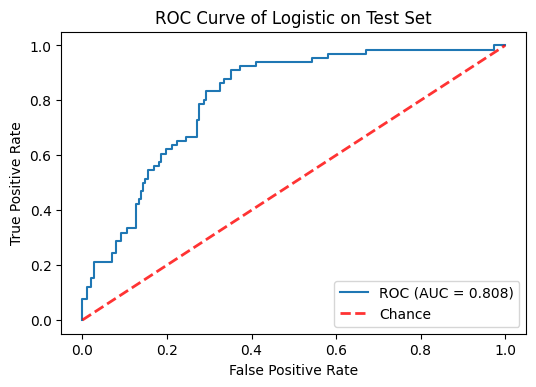

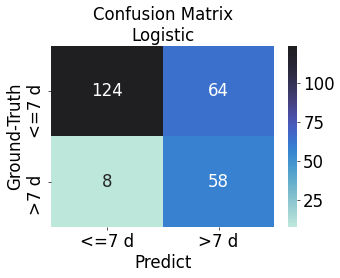

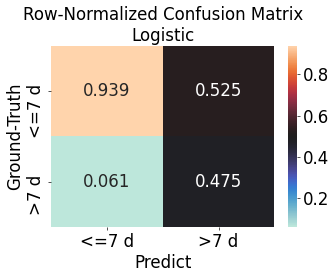

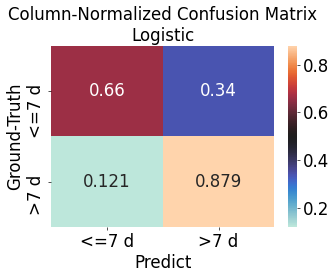

              precision    recall  f1-score   support

       <=7 d      0.939     0.660     0.775       188
        >7 d      0.475     0.879     0.617        66

    accuracy                          0.717       254
   macro avg      0.707     0.769     0.696       254
weighted avg      0.819     0.717     0.734       254

roc_auc: 0.808


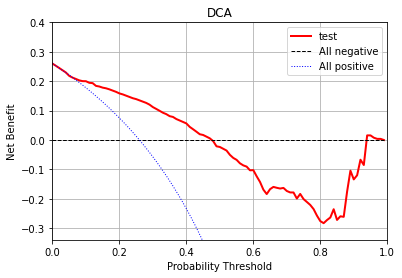

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


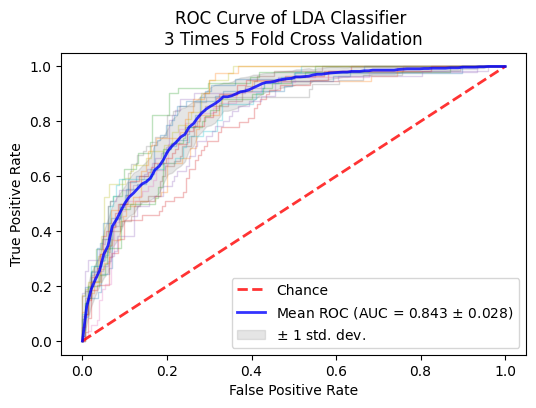

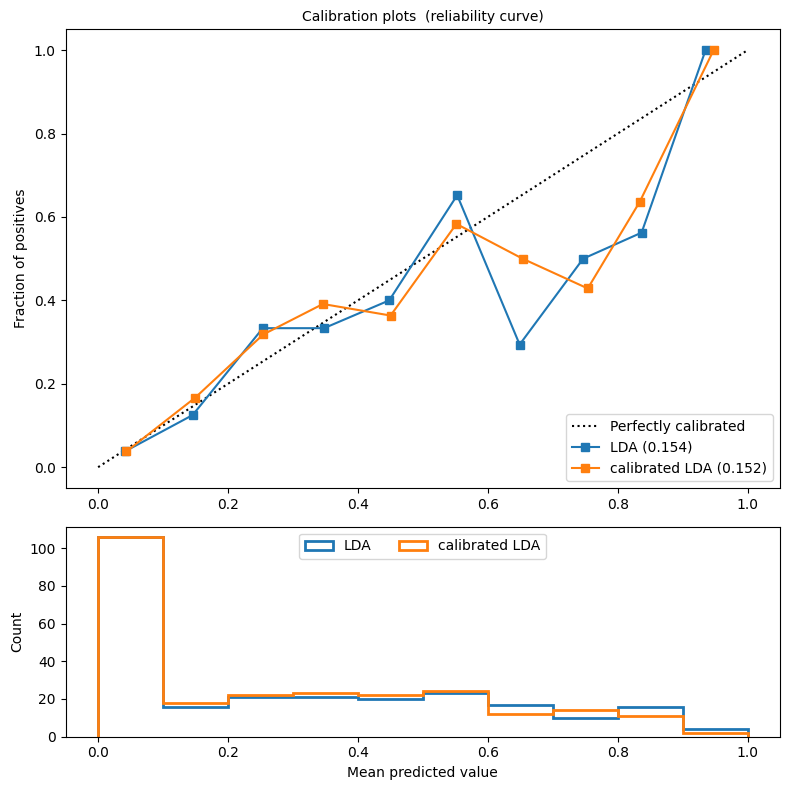

No handles with labels found to put in legend.


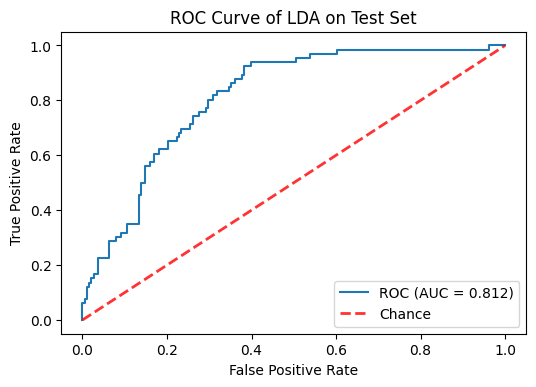

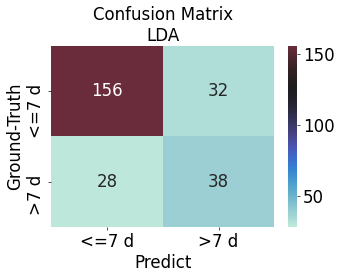

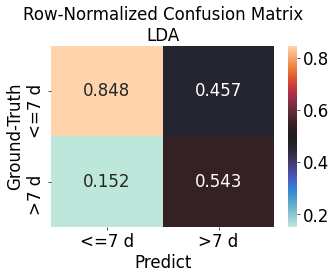

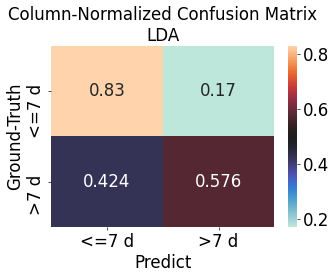

              precision    recall  f1-score   support

       <=7 d      0.848     0.830     0.839       188
        >7 d      0.543     0.576     0.559        66

    accuracy                          0.764       254
   macro avg      0.695     0.703     0.699       254
weighted avg      0.769     0.764     0.766       254

roc_auc: 0.812


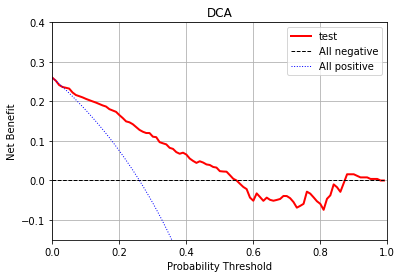

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


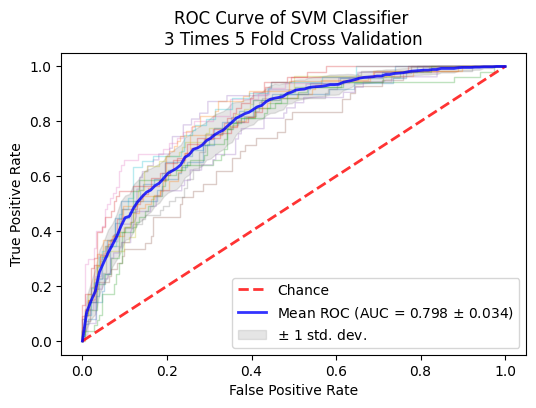

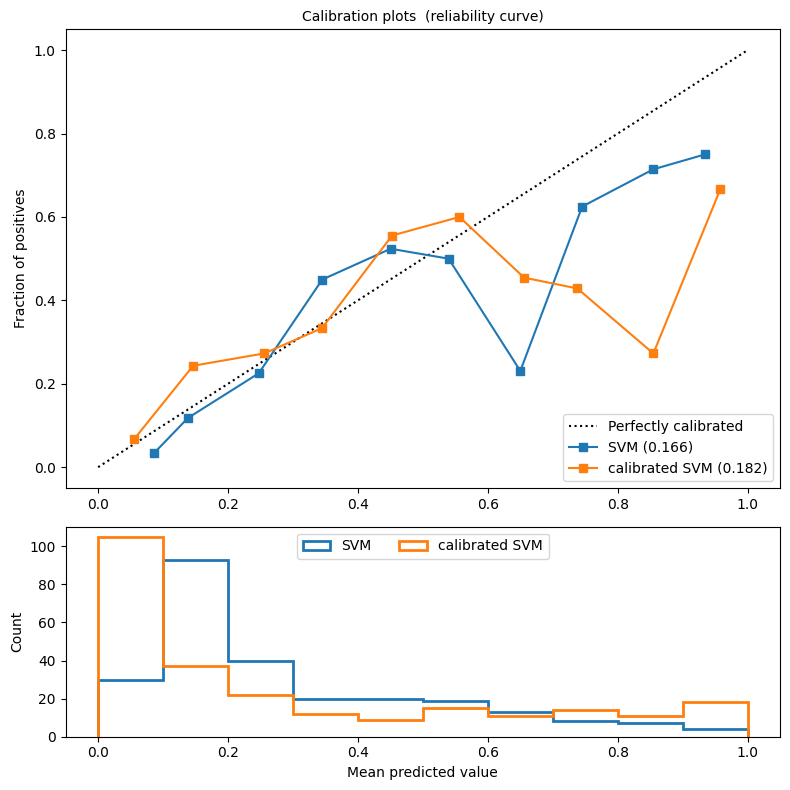

No handles with labels found to put in legend.


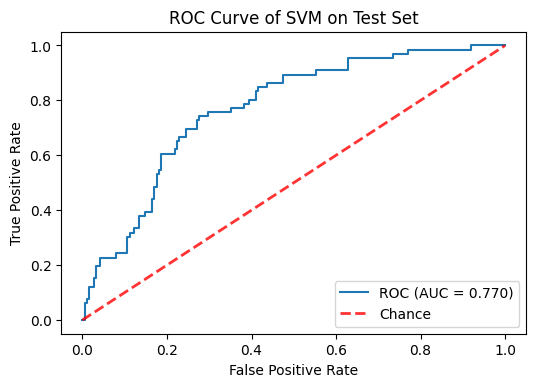

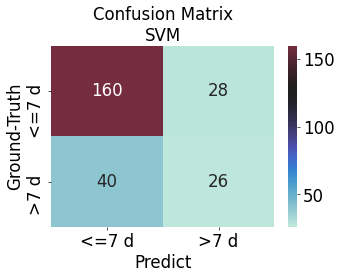

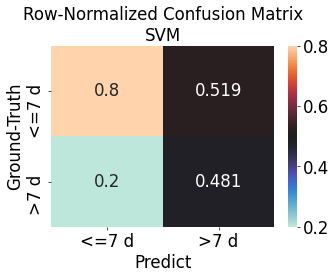

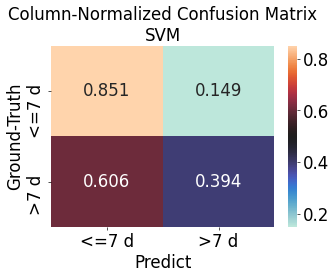

              precision    recall  f1-score   support

       <=7 d      0.800     0.851     0.825       188
        >7 d      0.481     0.394     0.433        66

    accuracy                          0.732       254
   macro avg      0.641     0.623     0.629       254
weighted avg      0.717     0.732     0.723       254

roc_auc: 0.77


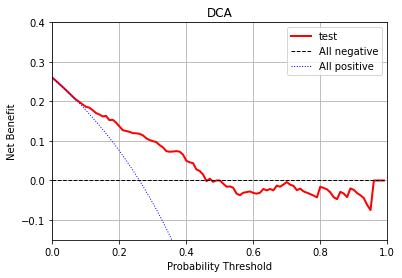

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


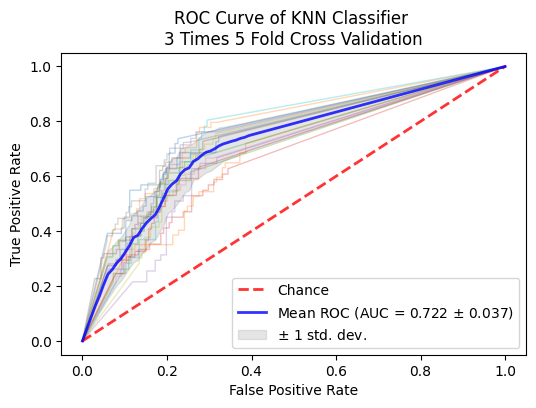

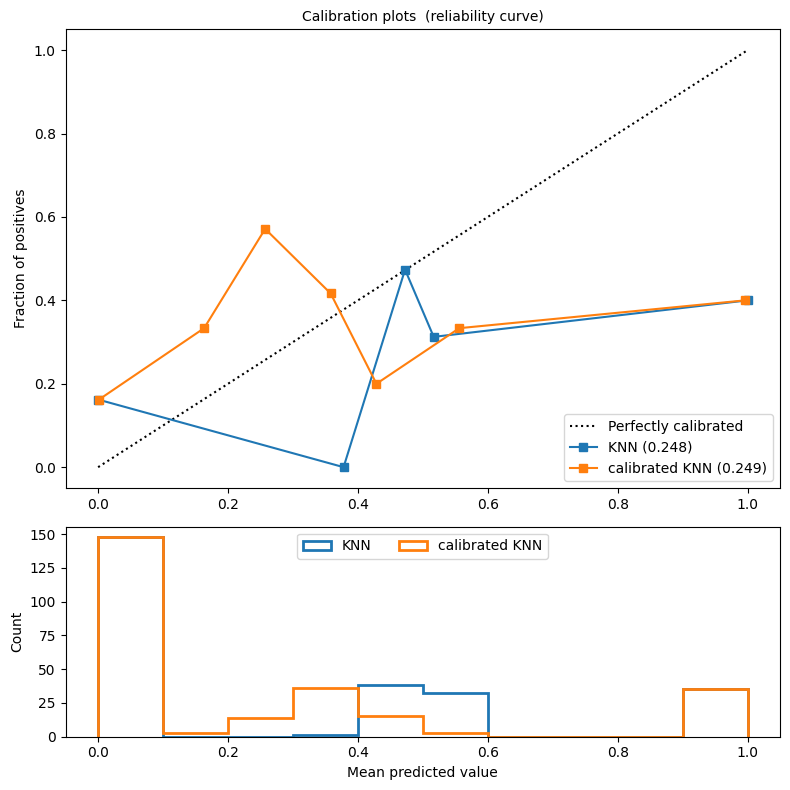

No handles with labels found to put in legend.


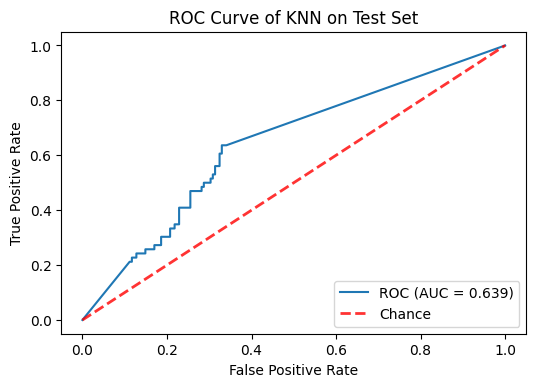

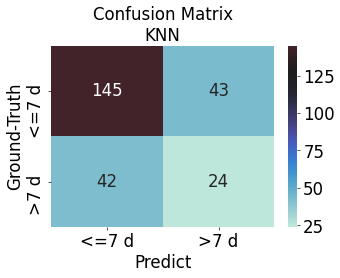

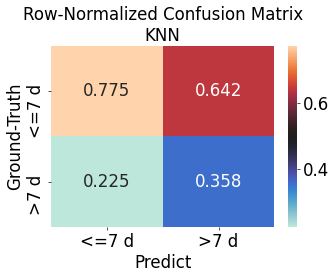

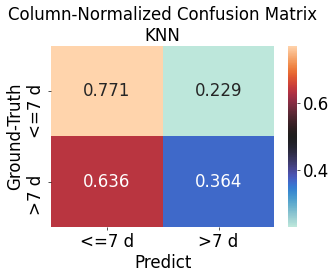

              precision    recall  f1-score   support

       <=7 d      0.775     0.771     0.773       188
        >7 d      0.358     0.364     0.361        66

    accuracy                          0.665       254
   macro avg      0.567     0.567     0.567       254
weighted avg      0.667     0.665     0.666       254

roc_auc: 0.639


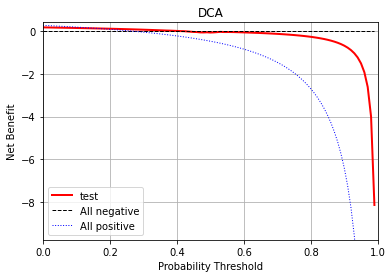

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


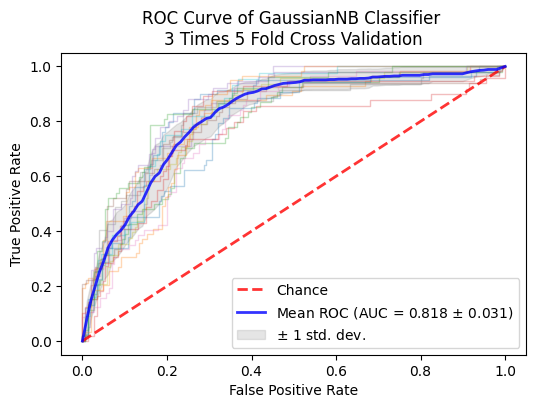

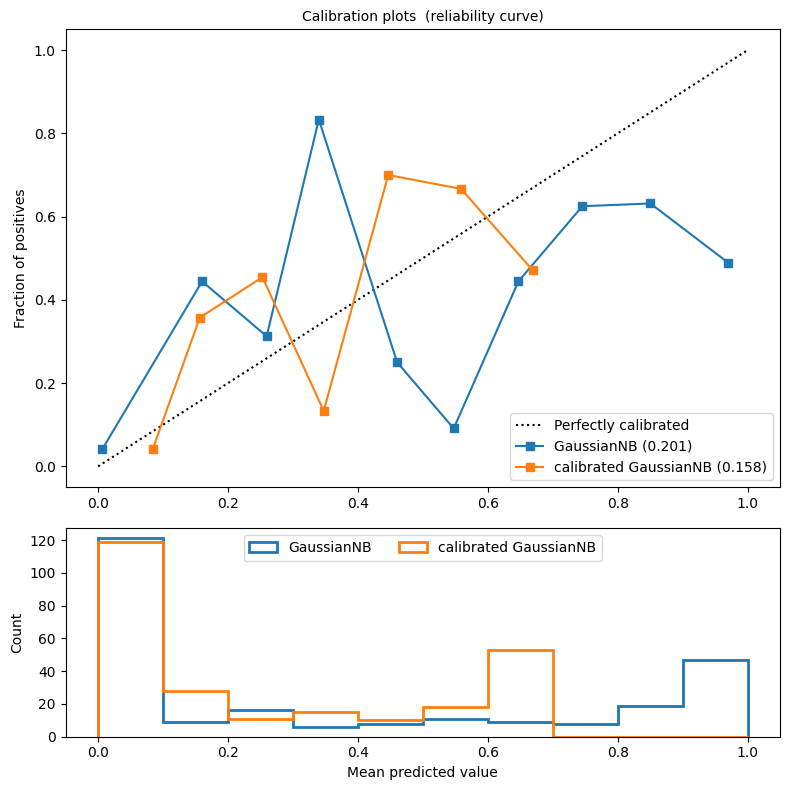

No handles with labels found to put in legend.


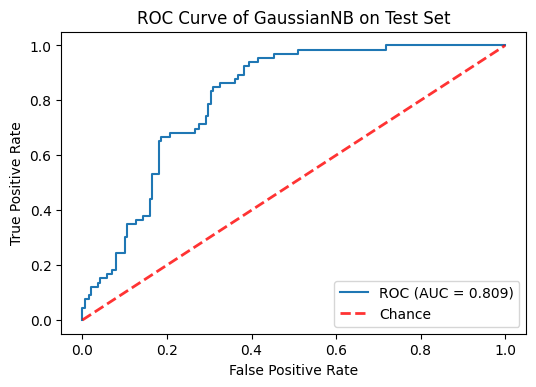

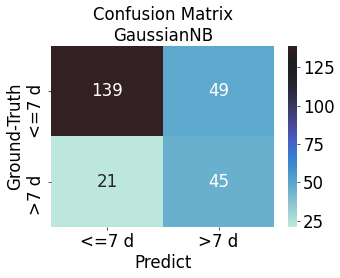

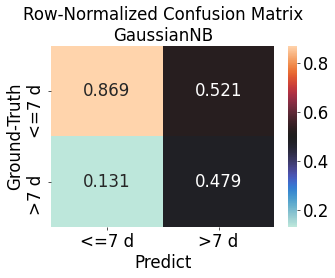

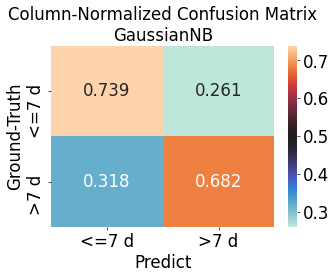

              precision    recall  f1-score   support

       <=7 d      0.869     0.739     0.799       188
        >7 d      0.479     0.682     0.562        66

    accuracy                          0.724       254
   macro avg      0.674     0.711     0.681       254
weighted avg      0.767     0.724     0.737       254

roc_auc: 0.809


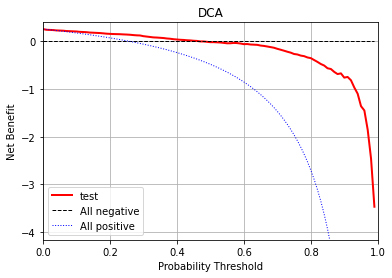

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


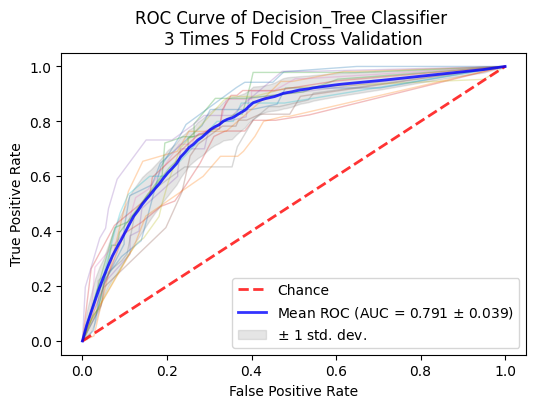

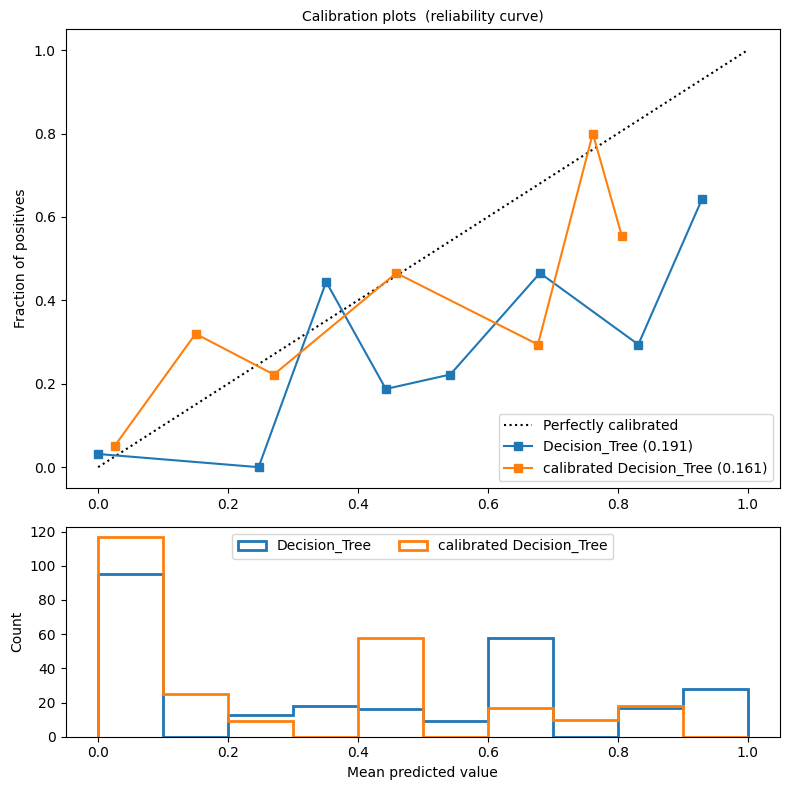

No handles with labels found to put in legend.


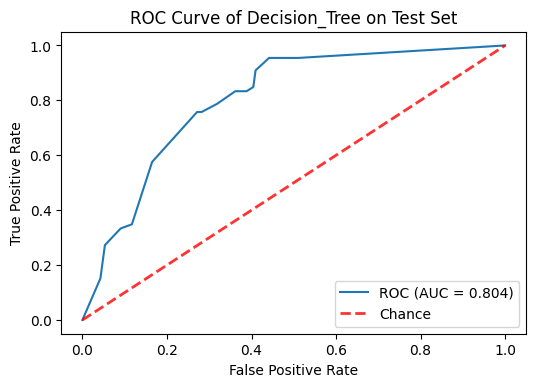

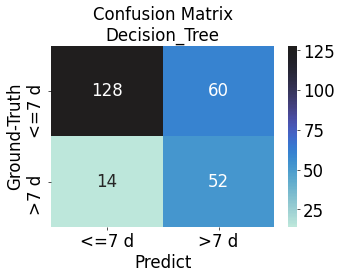

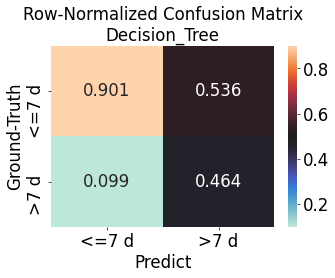

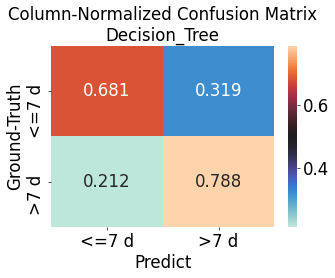

              precision    recall  f1-score   support

       <=7 d      0.901     0.681     0.776       188
        >7 d      0.464     0.788     0.584        66

    accuracy                          0.709       254
   macro avg      0.683     0.734     0.680       254
weighted avg      0.788     0.709     0.726       254

roc_auc: 0.804


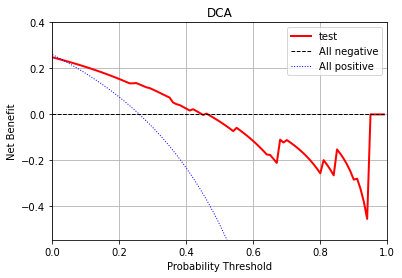

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


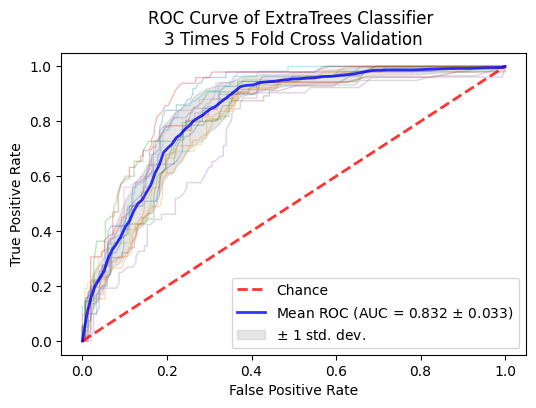

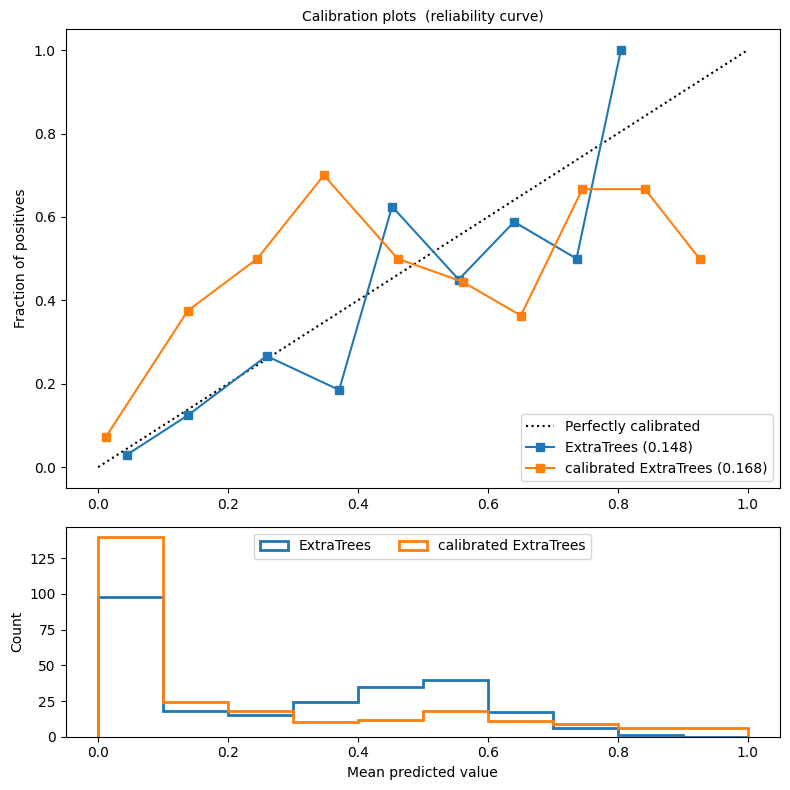

No handles with labels found to put in legend.


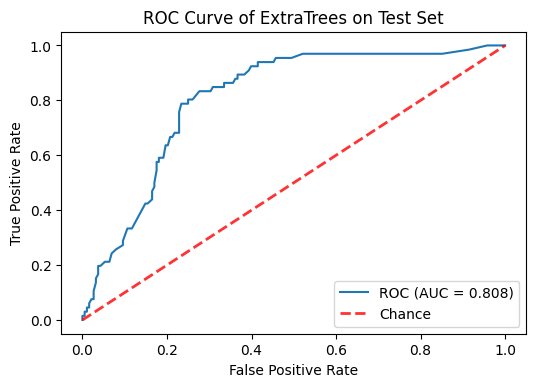

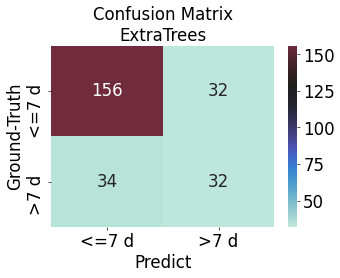

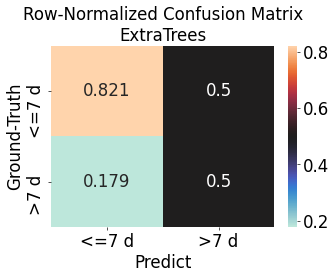

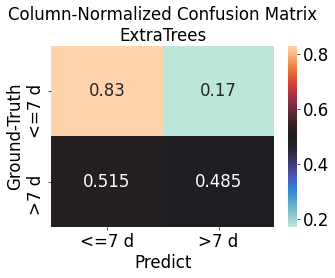

              precision    recall  f1-score   support

       <=7 d      0.821     0.830     0.825       188
        >7 d      0.500     0.485     0.492        66

    accuracy                          0.740       254
   macro avg      0.661     0.657     0.659       254
weighted avg      0.738     0.740     0.739       254

roc_auc: 0.808


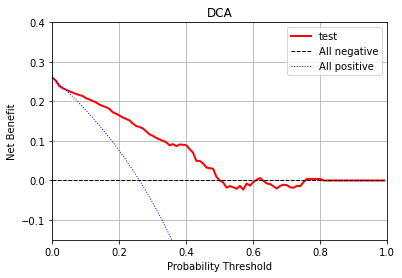

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


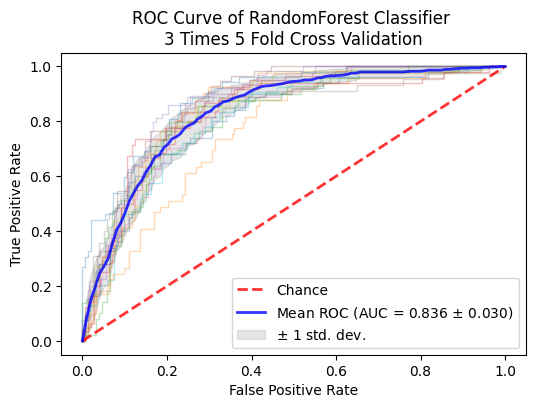

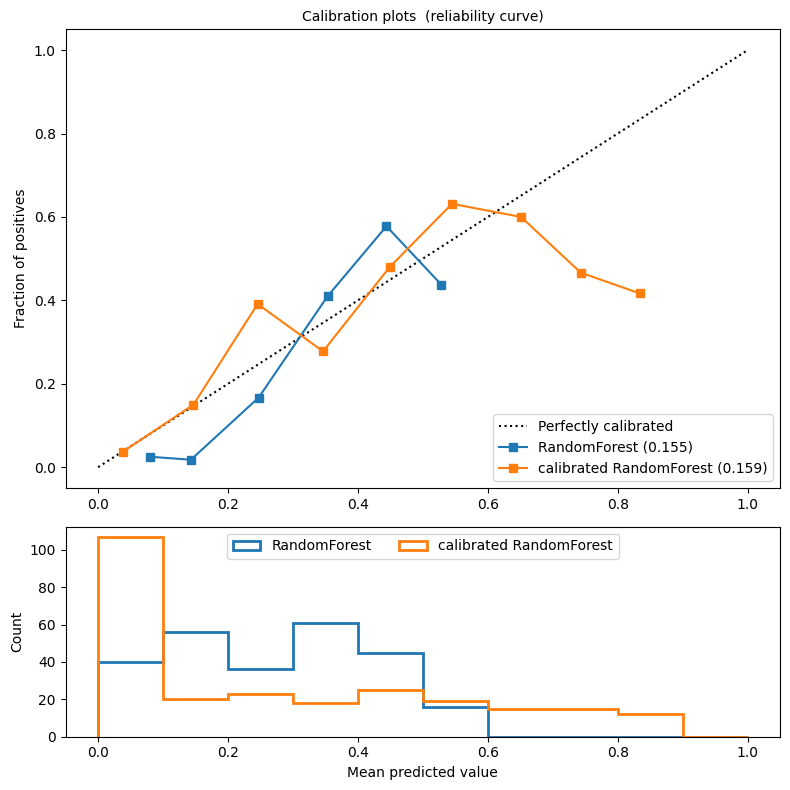

No handles with labels found to put in legend.


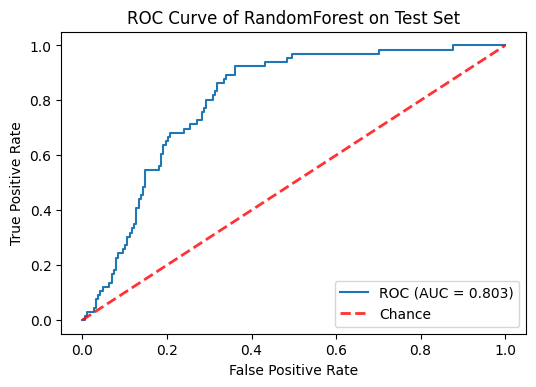

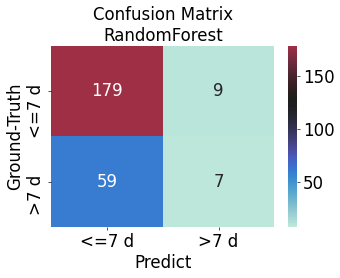

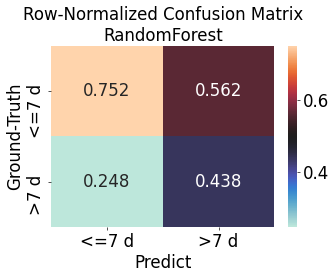

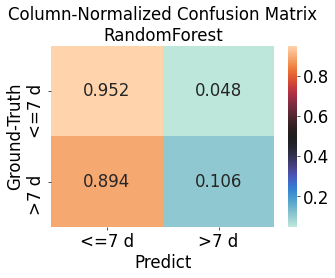

              precision    recall  f1-score   support

       <=7 d      0.752     0.952     0.840       188
        >7 d      0.438     0.106     0.171        66

    accuracy                          0.732       254
   macro avg      0.595     0.529     0.506       254
weighted avg      0.670     0.732     0.666       254

roc_auc: 0.803


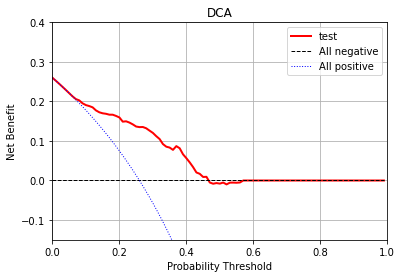

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


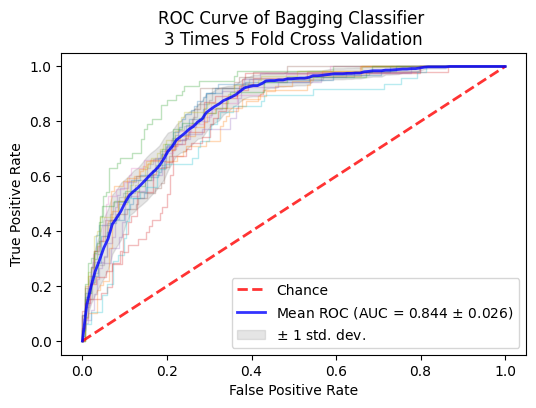

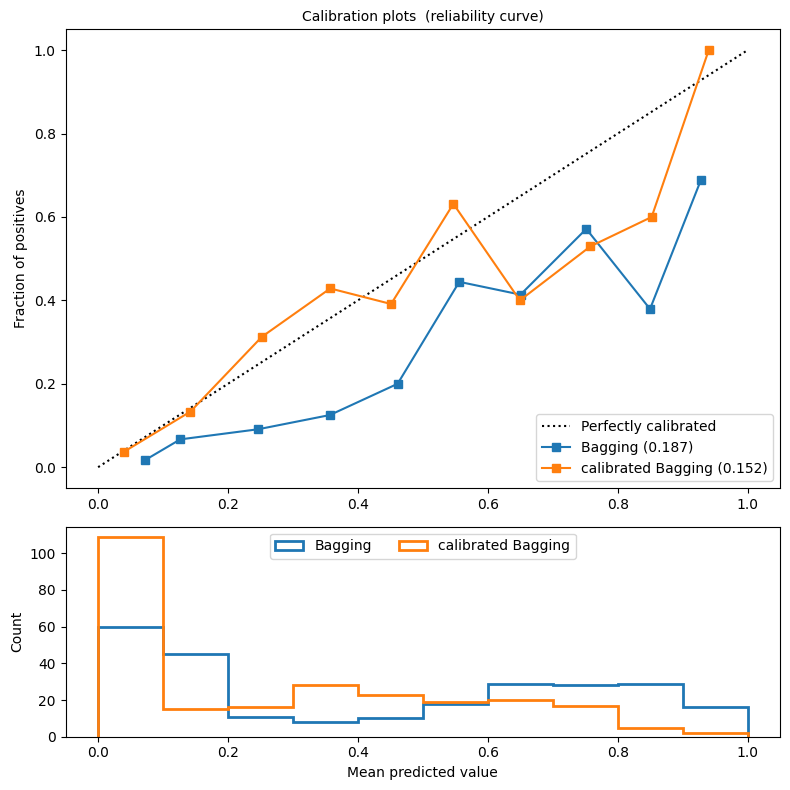

No handles with labels found to put in legend.


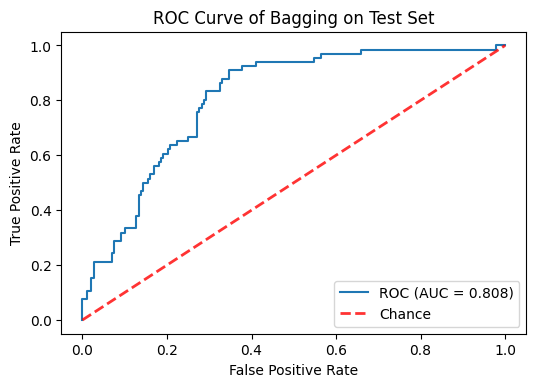

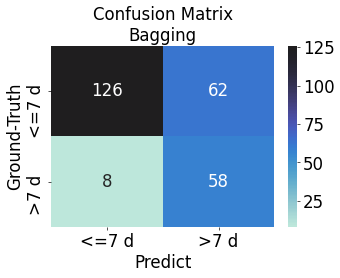

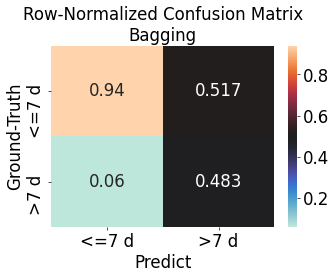

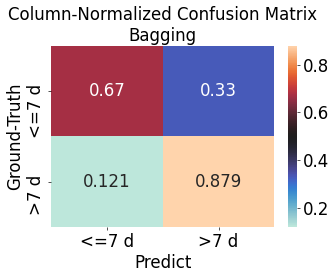

              precision    recall  f1-score   support

       <=7 d      0.940     0.670     0.783       188
        >7 d      0.483     0.879     0.624        66

    accuracy                          0.724       254
   macro avg      0.712     0.775     0.703       254
weighted avg      0.822     0.724     0.741       254

roc_auc: 0.808


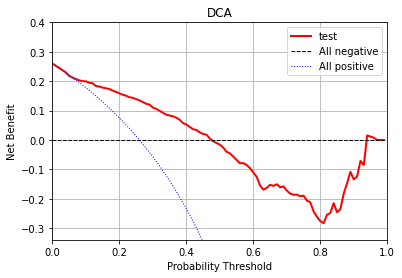

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


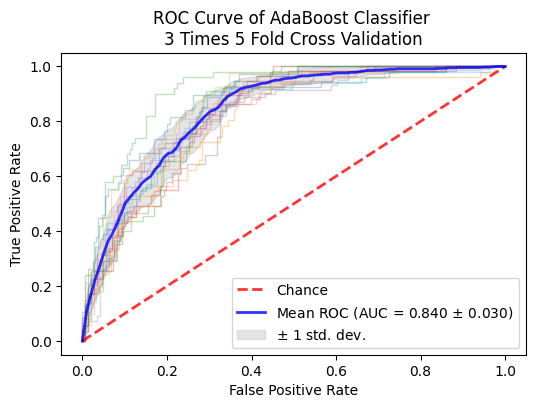

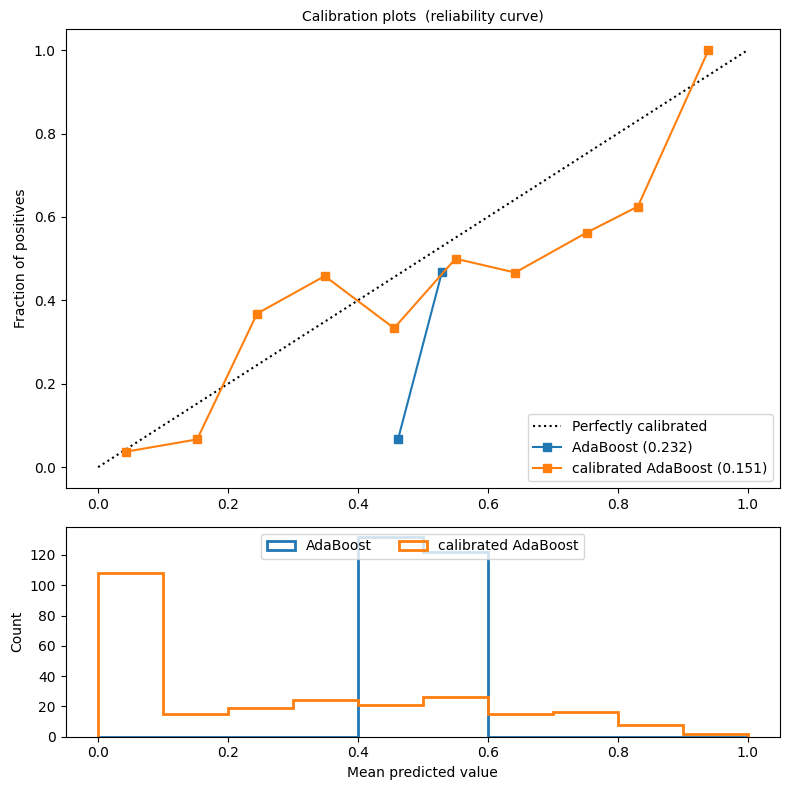

No handles with labels found to put in legend.


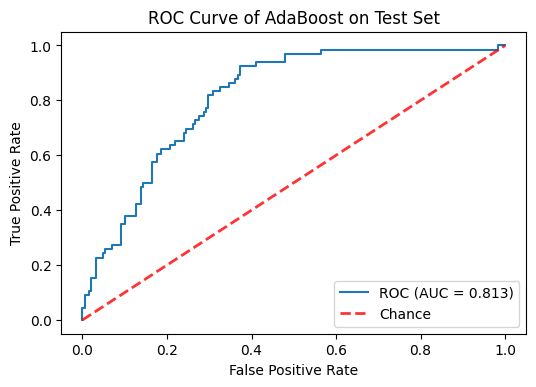

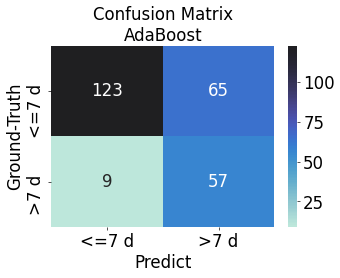

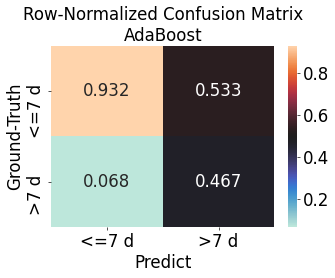

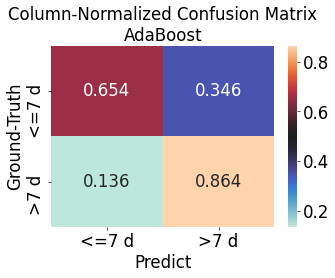

              precision    recall  f1-score   support

       <=7 d      0.932     0.654     0.769       188
        >7 d      0.467     0.864     0.606        66

    accuracy                          0.709       254
   macro avg      0.700     0.759     0.688       254
weighted avg      0.811     0.709     0.727       254

roc_auc: 0.813


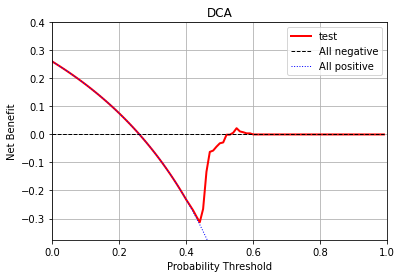

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


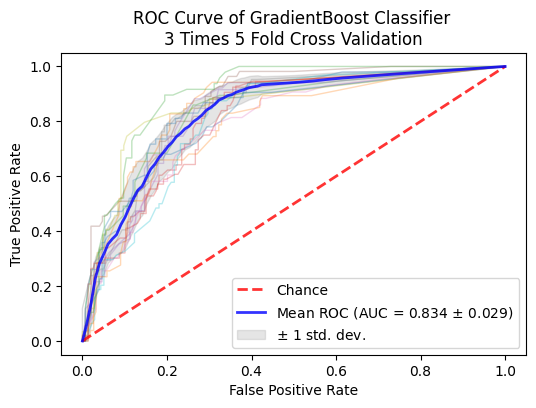

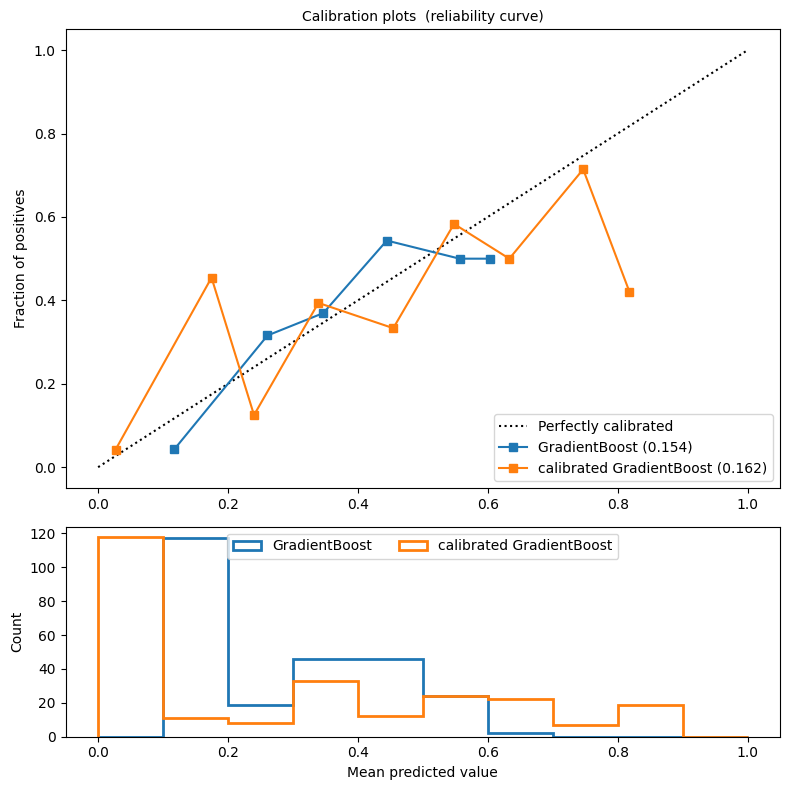

No handles with labels found to put in legend.


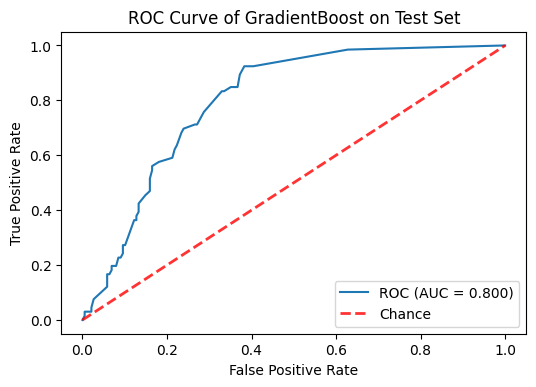

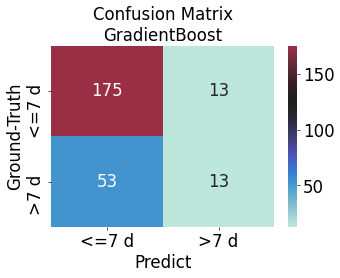

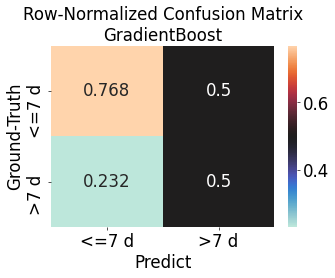

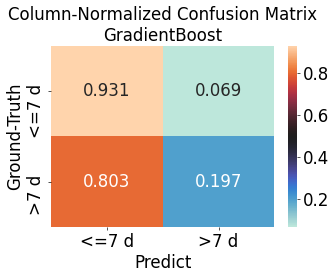

              precision    recall  f1-score   support

       <=7 d      0.768     0.931     0.841       188
        >7 d      0.500     0.197     0.283        66

    accuracy                          0.740       254
   macro avg      0.634     0.564     0.562       254
weighted avg      0.698     0.740     0.696       254

roc_auc: 0.8


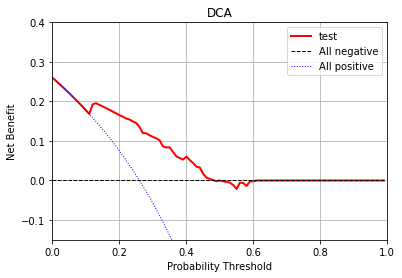

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


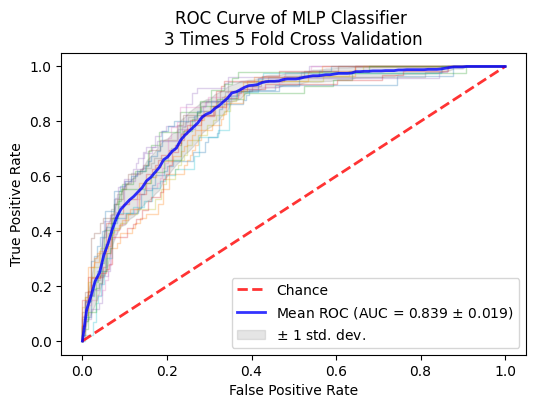

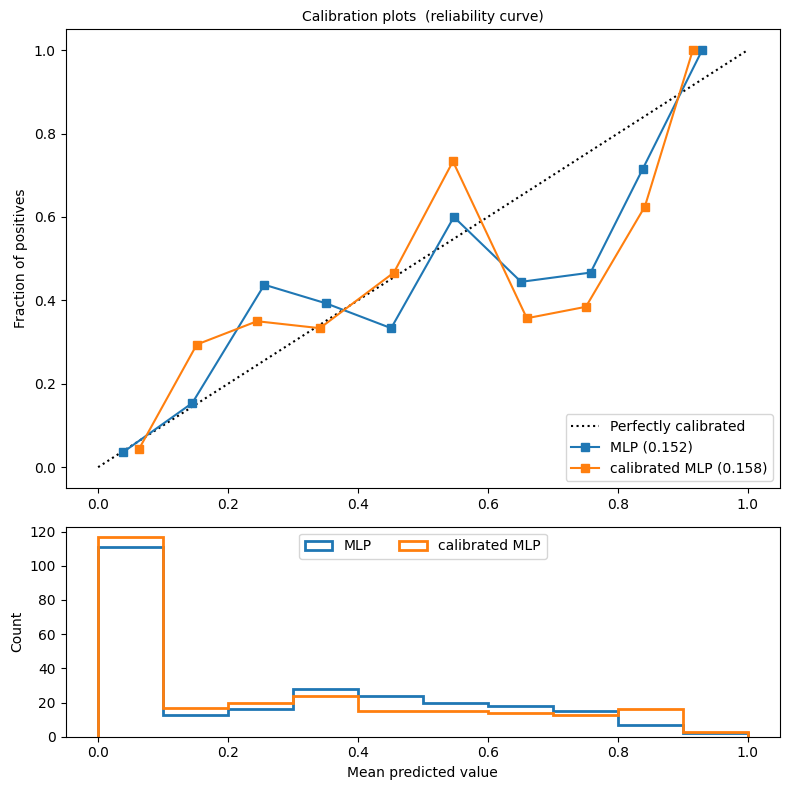

No handles with labels found to put in legend.


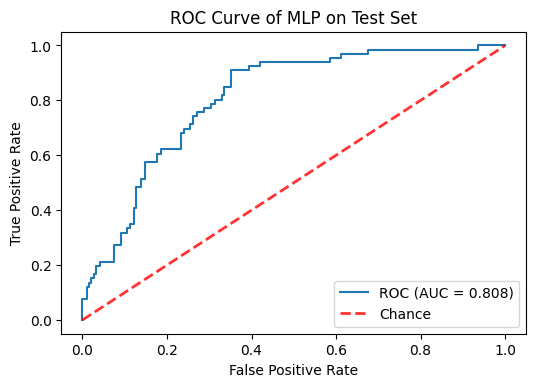

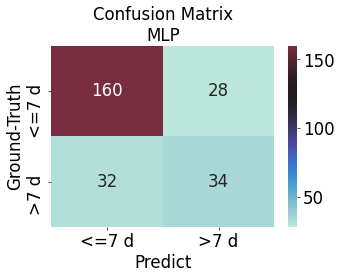

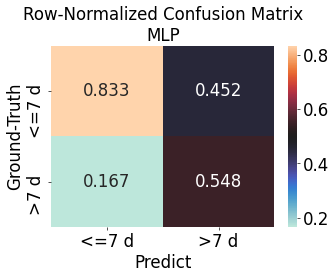

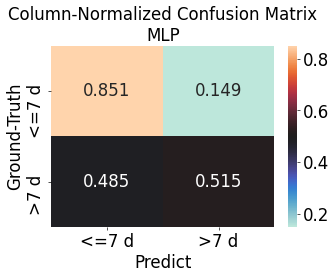

              precision    recall  f1-score   support

       <=7 d      0.833     0.851     0.842       188
        >7 d      0.548     0.515     0.531        66

    accuracy                          0.764       254
   macro avg      0.691     0.683     0.687       254
weighted avg      0.759     0.764     0.761       254

roc_auc: 0.808


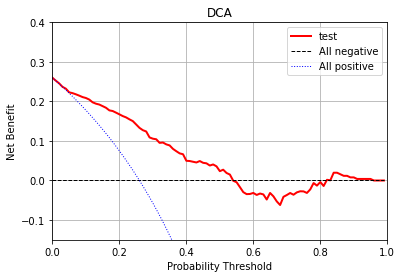

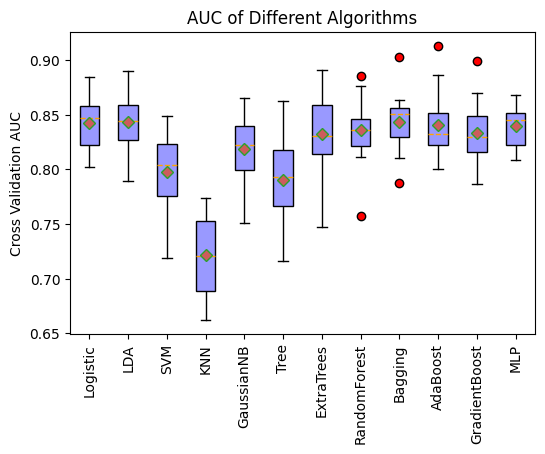

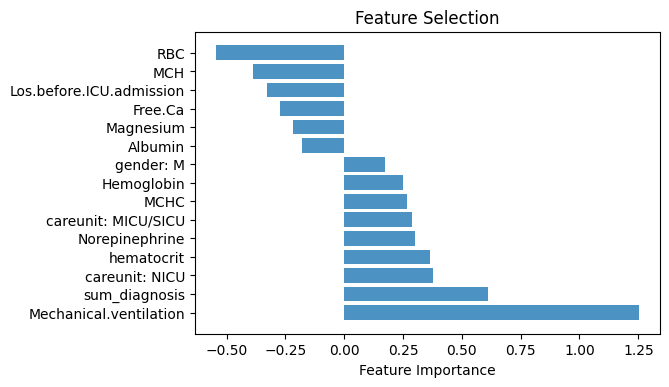

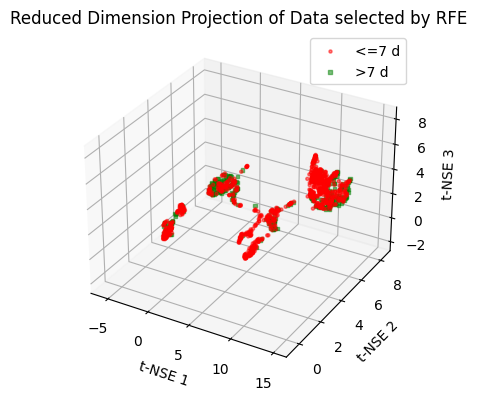

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


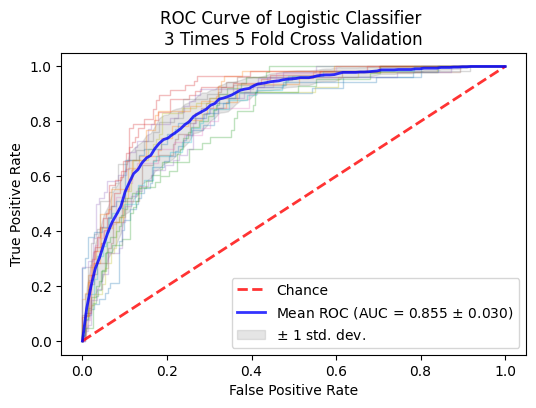

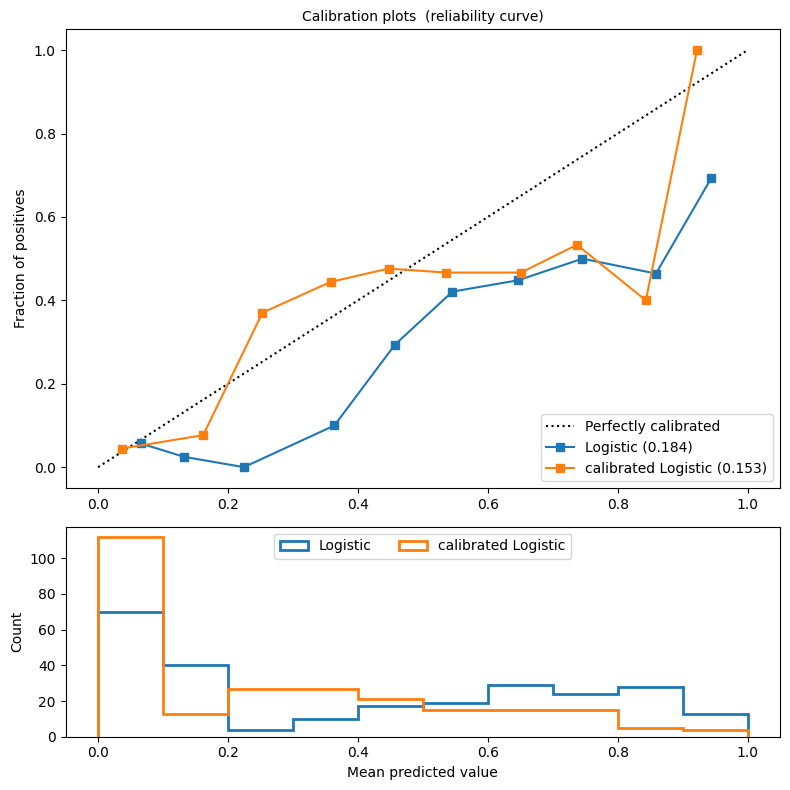

No handles with labels found to put in legend.


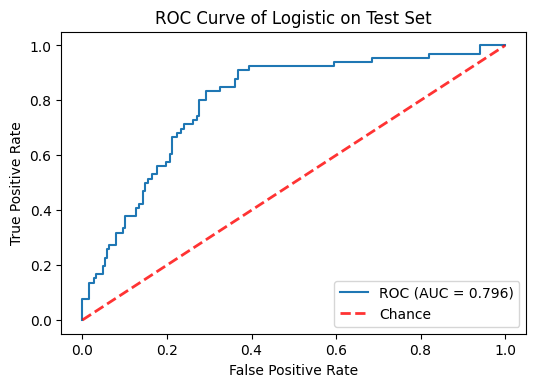

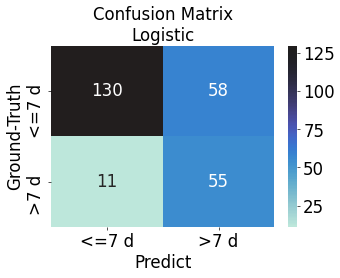

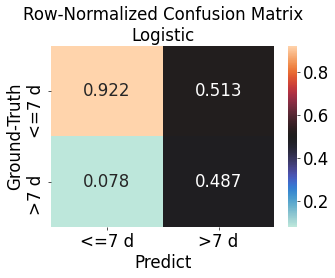

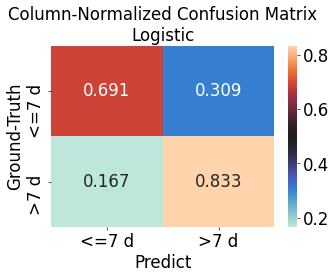

              precision    recall  f1-score   support

       <=7 d      0.922     0.691     0.790       188
        >7 d      0.487     0.833     0.615        66

    accuracy                          0.728       254
   macro avg      0.704     0.762     0.702       254
weighted avg      0.809     0.728     0.745       254

roc_auc: 0.796


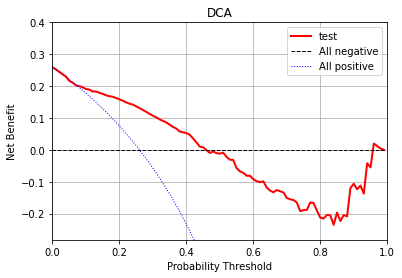

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


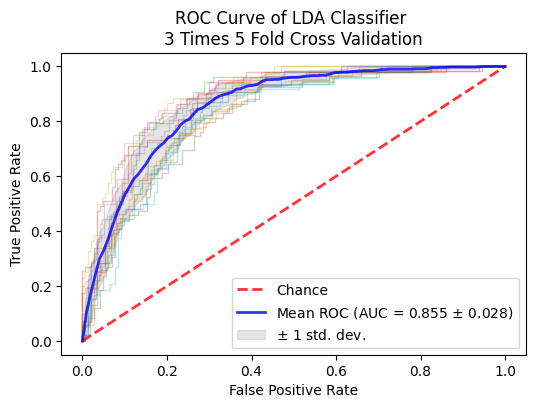

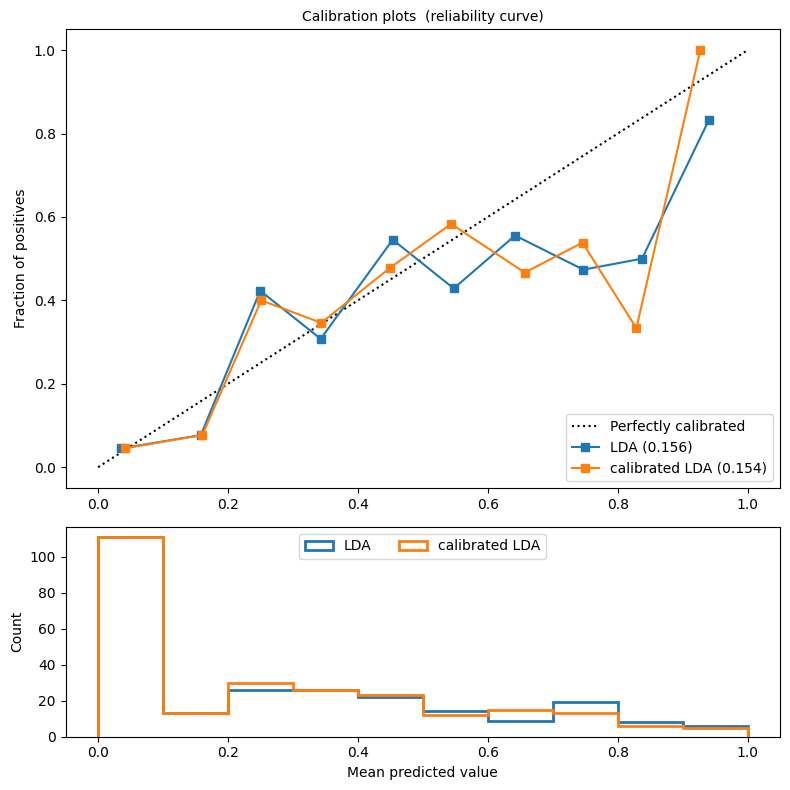

No handles with labels found to put in legend.


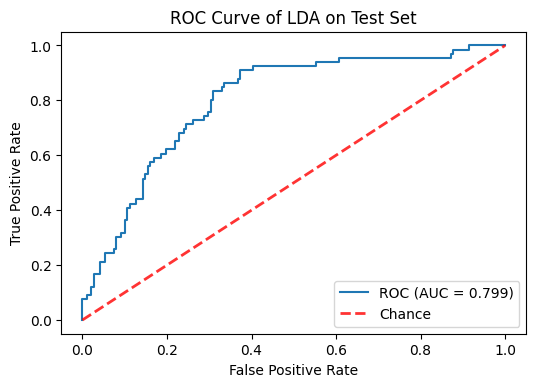

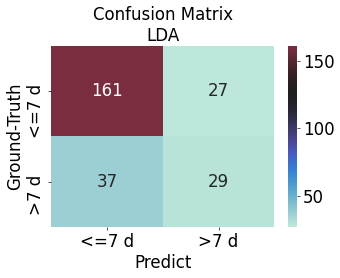

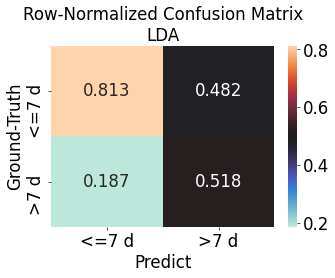

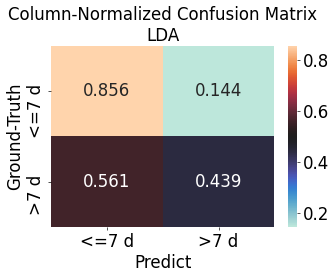

              precision    recall  f1-score   support

       <=7 d      0.813     0.856     0.834       188
        >7 d      0.518     0.439     0.475        66

    accuracy                          0.748       254
   macro avg      0.665     0.648     0.655       254
weighted avg      0.736     0.748     0.741       254

roc_auc: 0.799


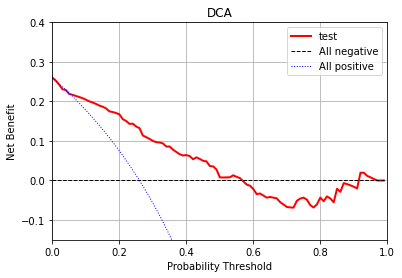

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


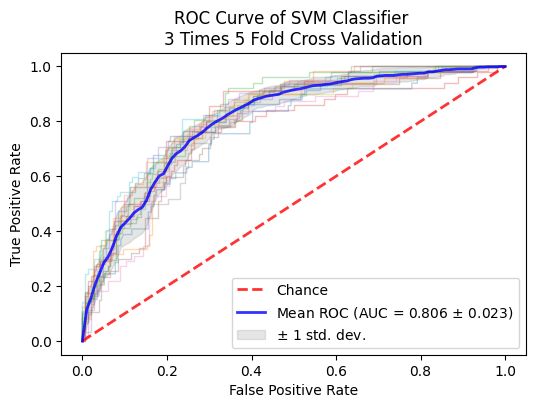

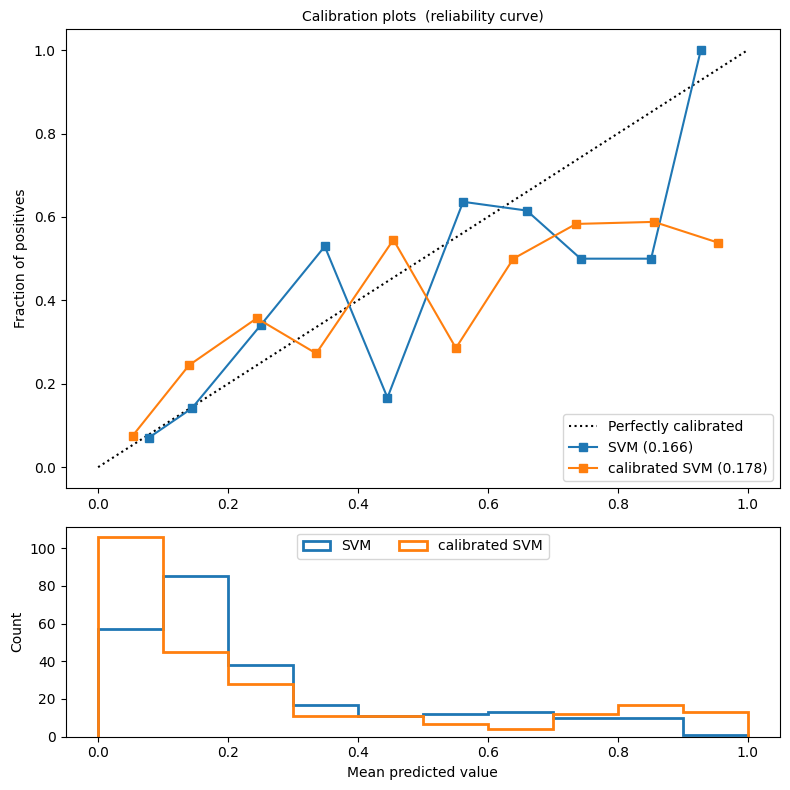

No handles with labels found to put in legend.


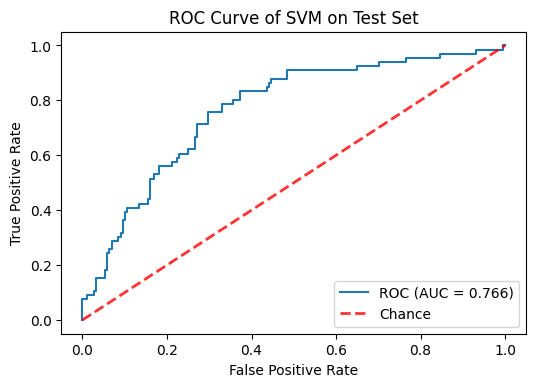

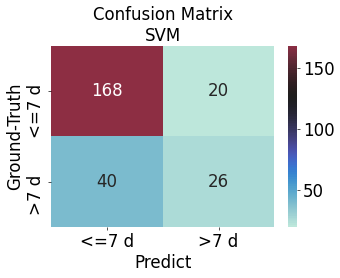

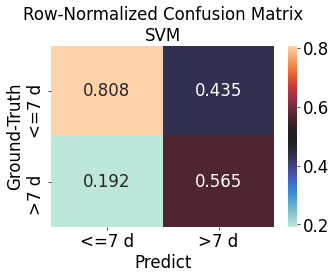

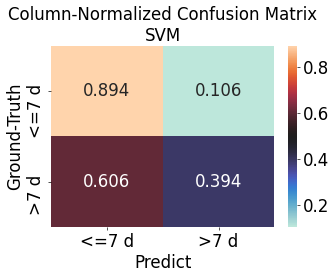

              precision    recall  f1-score   support

       <=7 d      0.808     0.894     0.848       188
        >7 d      0.565     0.394     0.464        66

    accuracy                          0.764       254
   macro avg      0.686     0.644     0.656       254
weighted avg      0.745     0.764     0.749       254

roc_auc: 0.766


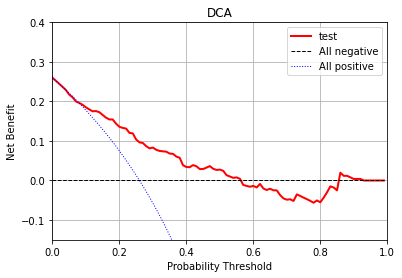

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


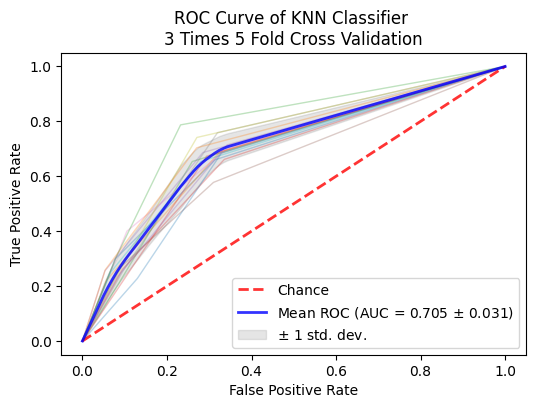

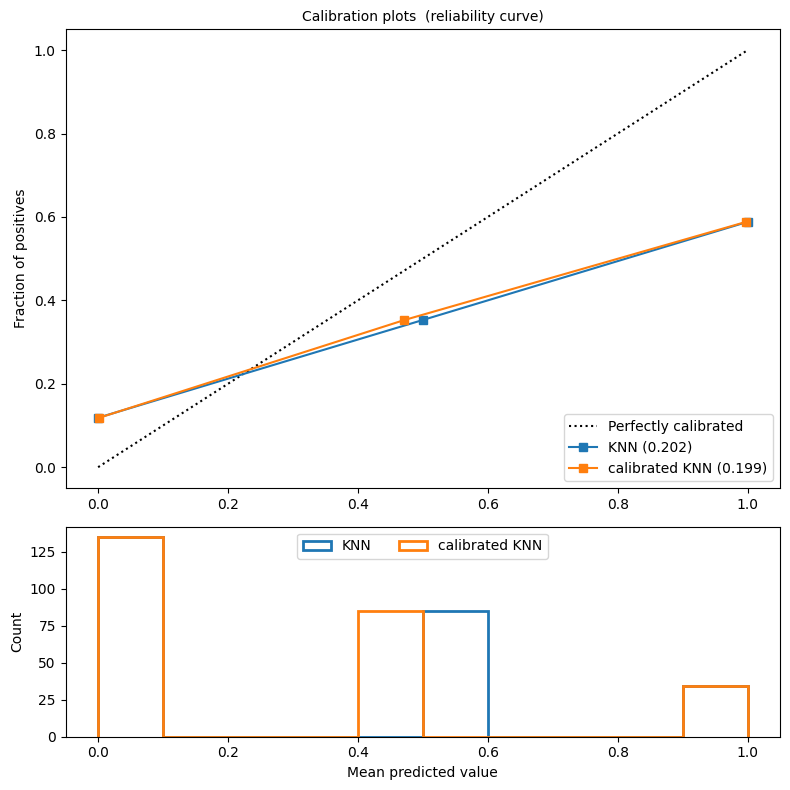

No handles with labels found to put in legend.


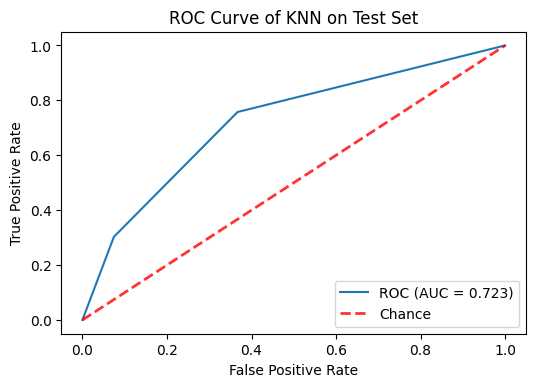

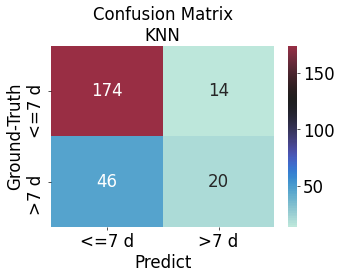

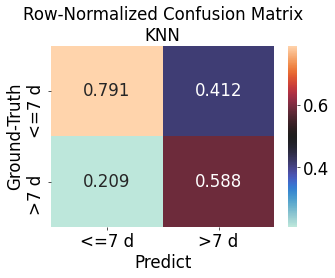

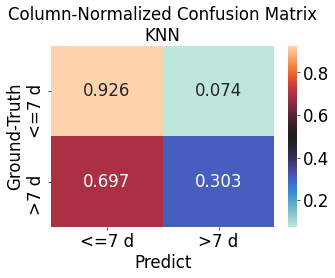

              precision    recall  f1-score   support

       <=7 d      0.791     0.926     0.853       188
        >7 d      0.588     0.303     0.400        66

    accuracy                          0.764       254
   macro avg      0.690     0.614     0.626       254
weighted avg      0.738     0.764     0.735       254

roc_auc: 0.723


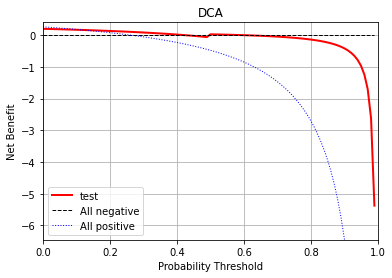

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


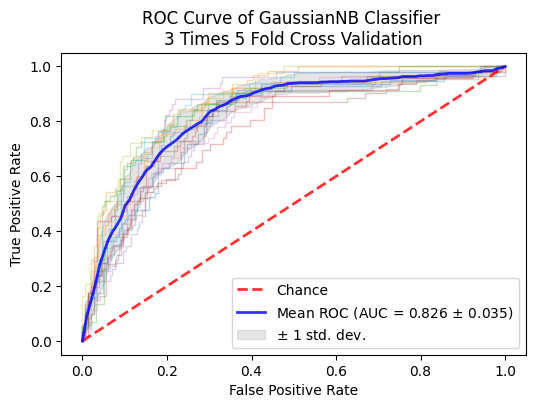

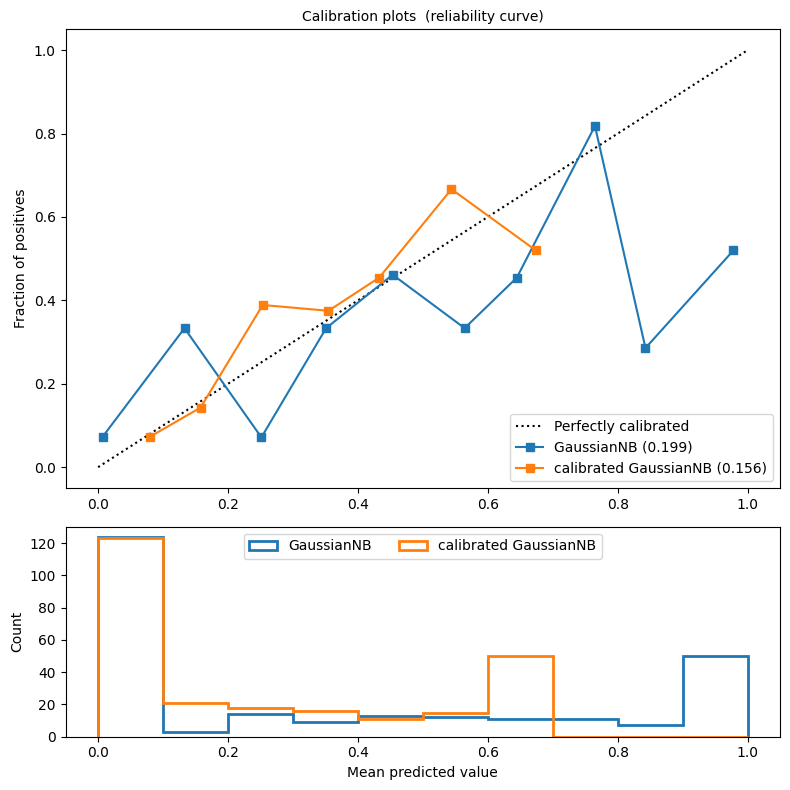

No handles with labels found to put in legend.


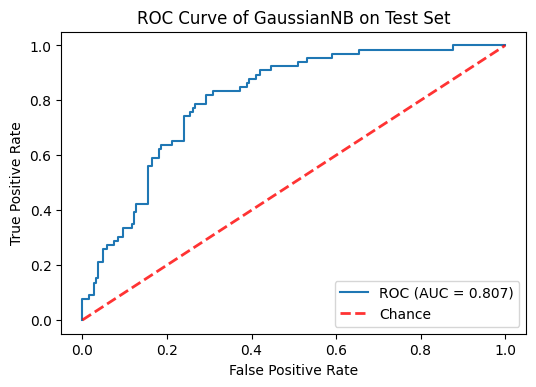

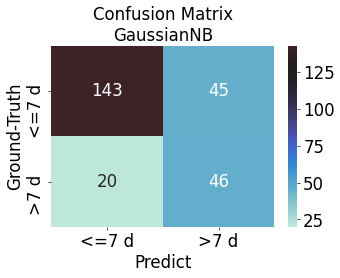

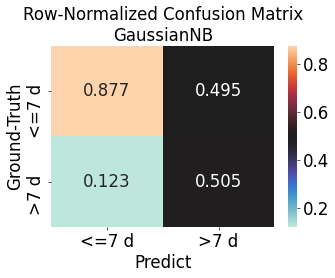

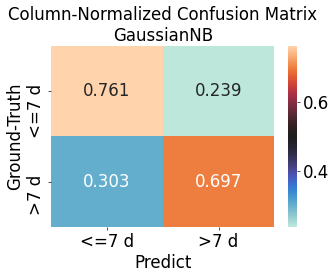

              precision    recall  f1-score   support

       <=7 d      0.877     0.761     0.815       188
        >7 d      0.505     0.697     0.586        66

    accuracy                          0.744       254
   macro avg      0.691     0.729     0.700       254
weighted avg      0.781     0.744     0.755       254

roc_auc: 0.807


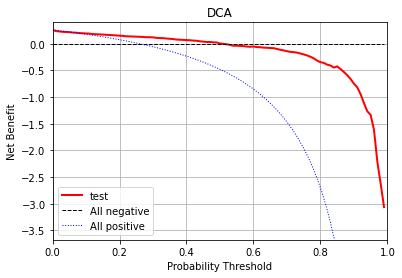

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


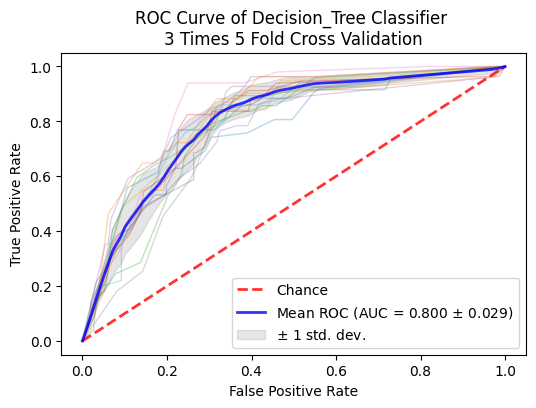

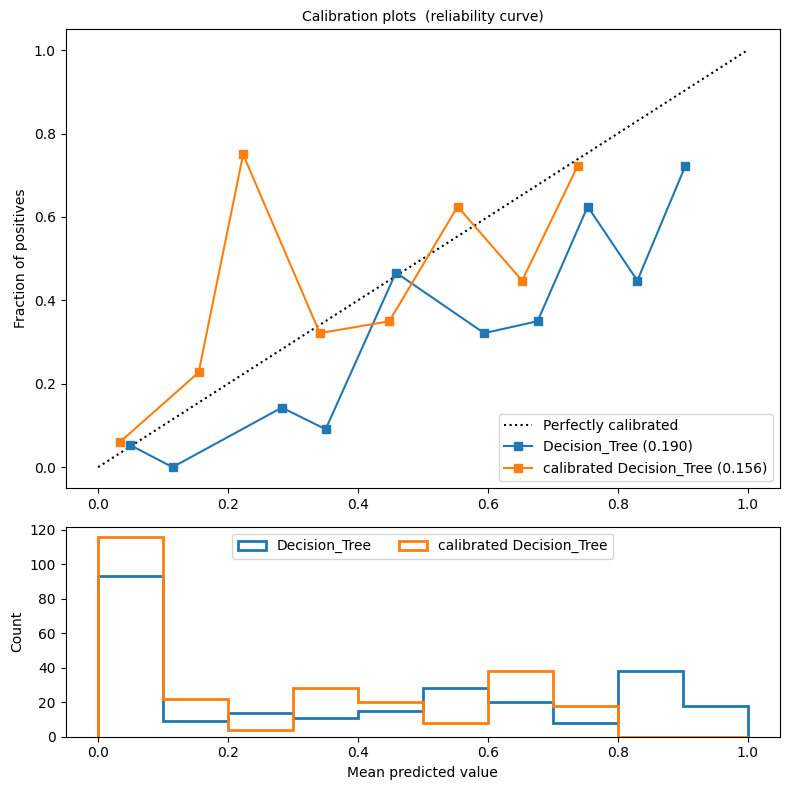

No handles with labels found to put in legend.


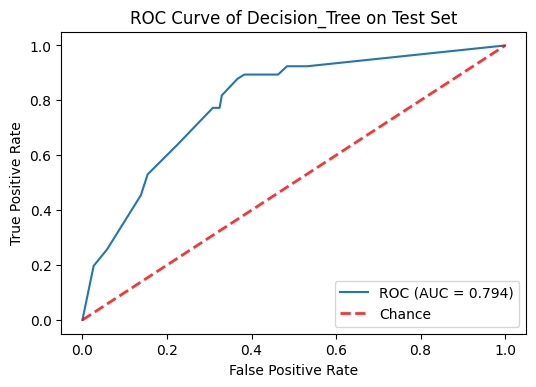

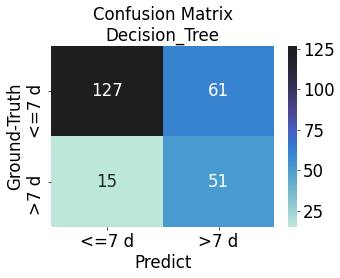

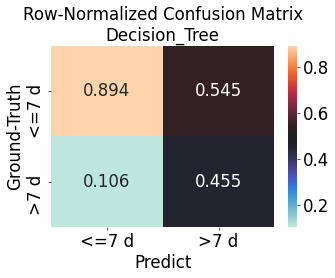

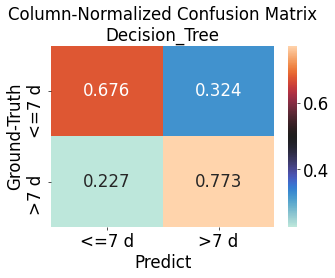

              precision    recall  f1-score   support

       <=7 d      0.894     0.676     0.770       188
        >7 d      0.455     0.773     0.573        66

    accuracy                          0.701       254
   macro avg      0.675     0.724     0.671       254
weighted avg      0.780     0.701     0.719       254

roc_auc: 0.794


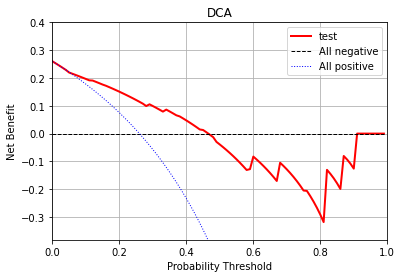

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


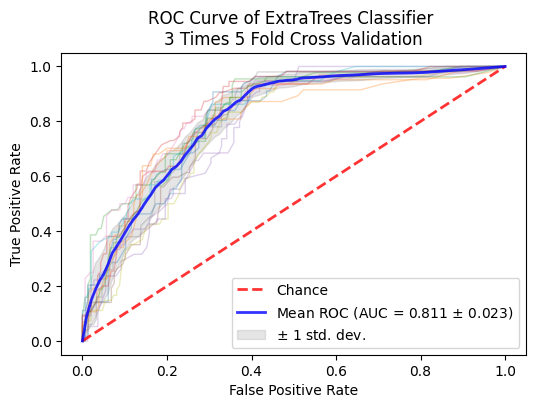

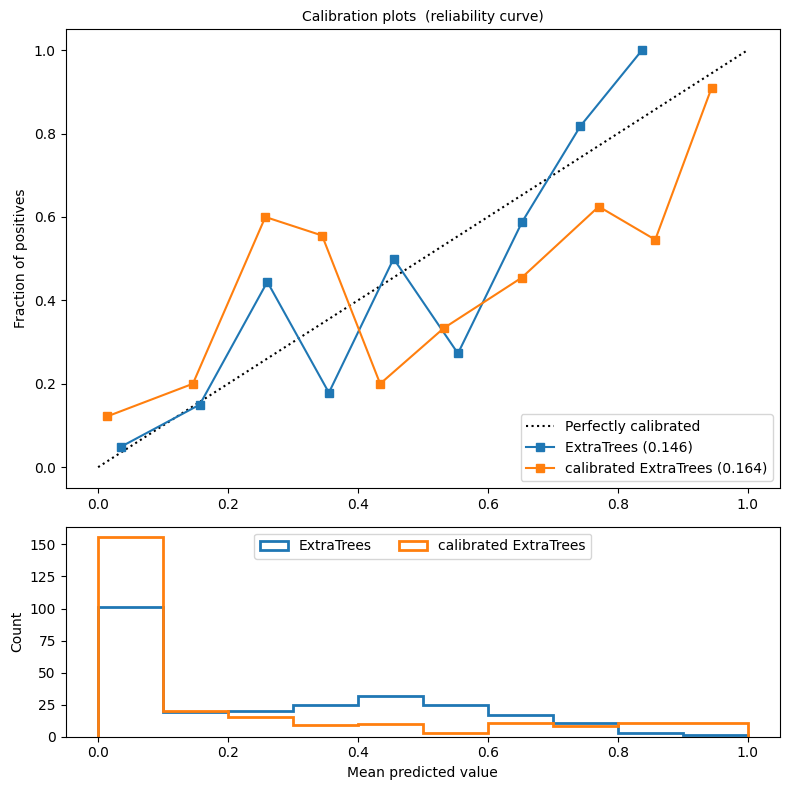

No handles with labels found to put in legend.


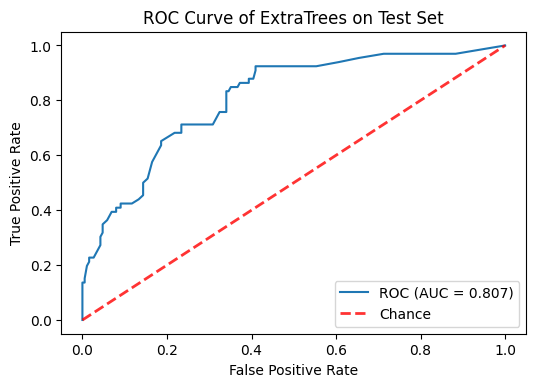

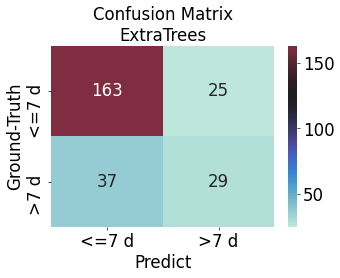

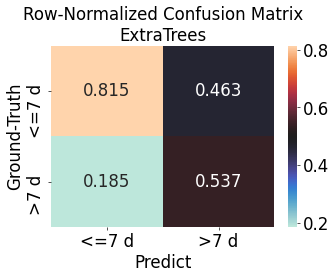

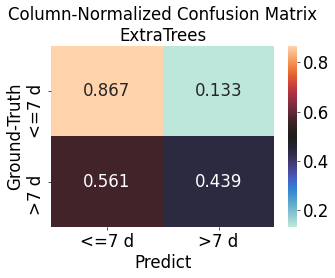

              precision    recall  f1-score   support

       <=7 d      0.815     0.867     0.840       188
        >7 d      0.537     0.439     0.483        66

    accuracy                          0.756       254
   macro avg      0.676     0.653     0.662       254
weighted avg      0.743     0.756     0.747       254

roc_auc: 0.807


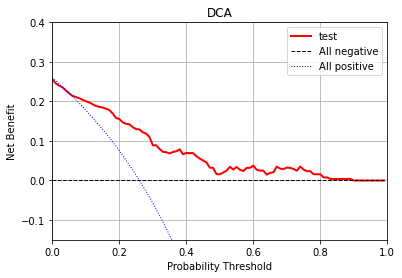

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


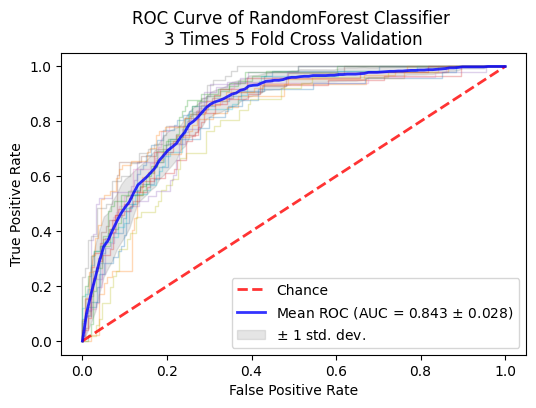

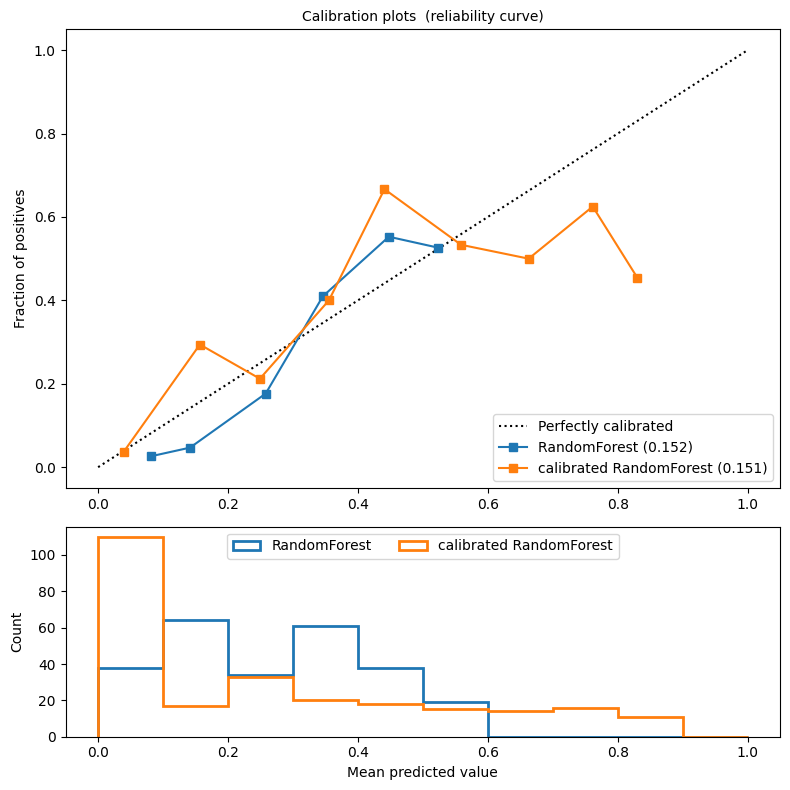

No handles with labels found to put in legend.


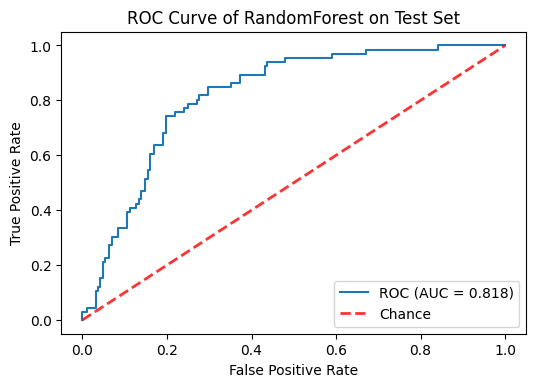

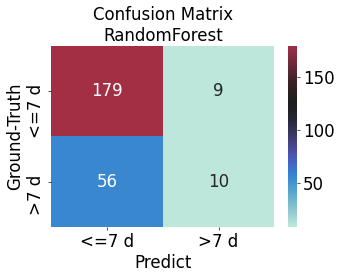

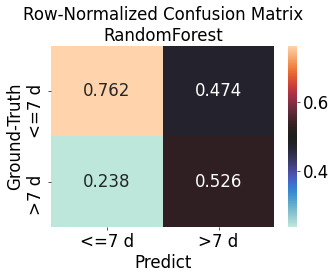

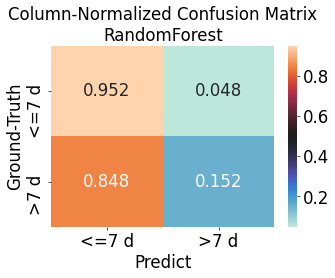

              precision    recall  f1-score   support

       <=7 d      0.762     0.952     0.846       188
        >7 d      0.526     0.152     0.235        66

    accuracy                          0.744       254
   macro avg      0.644     0.552     0.541       254
weighted avg      0.701     0.744     0.688       254

roc_auc: 0.818


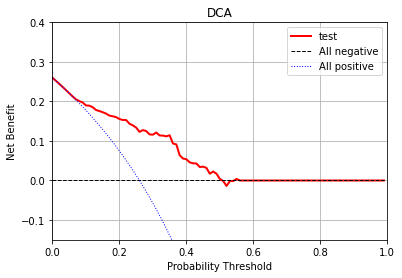

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


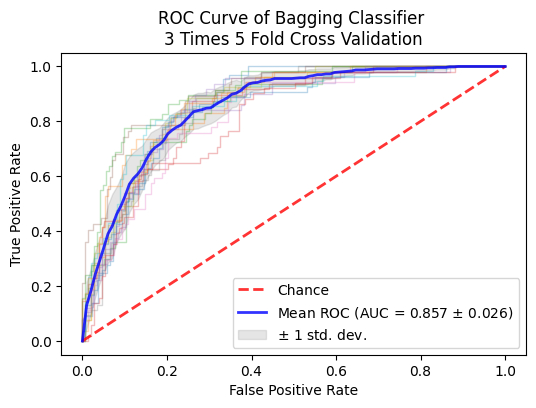

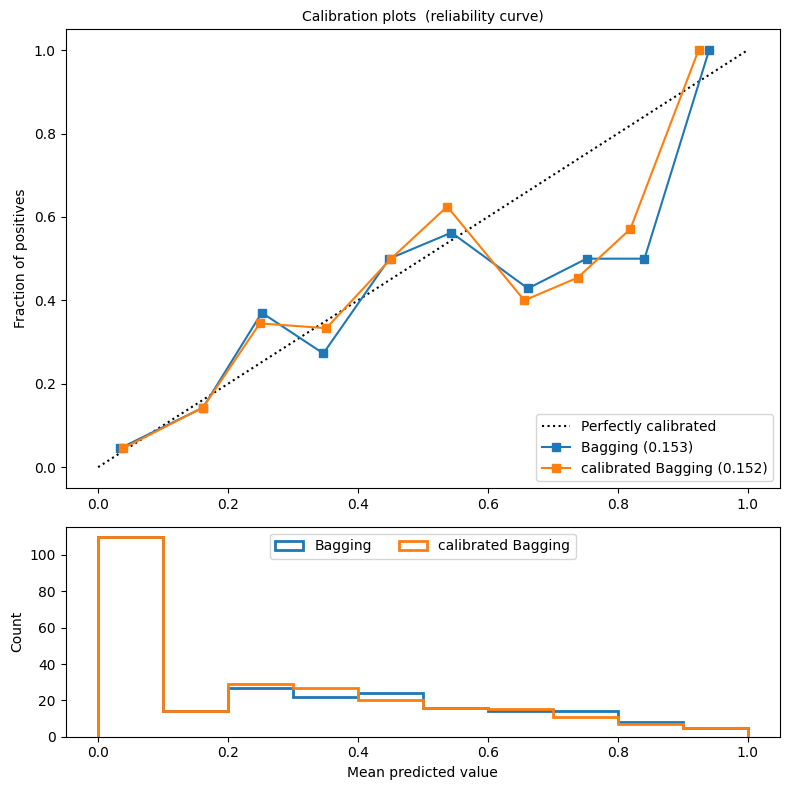

No handles with labels found to put in legend.


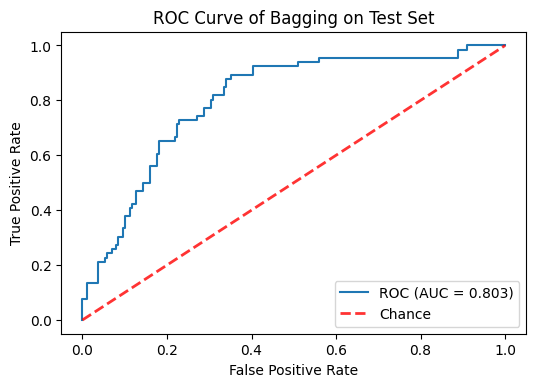

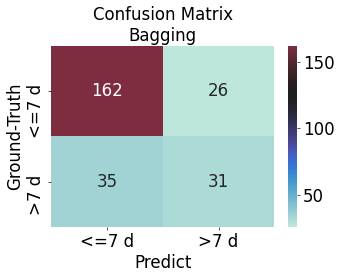

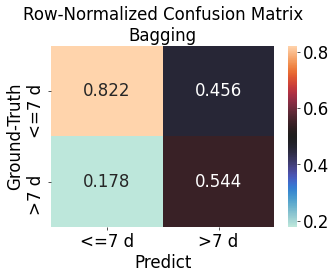

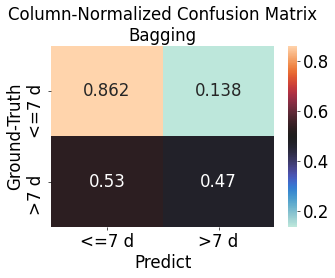

              precision    recall  f1-score   support

       <=7 d      0.822     0.862     0.842       188
        >7 d      0.544     0.470     0.504        66

    accuracy                          0.760       254
   macro avg      0.683     0.666     0.673       254
weighted avg      0.750     0.760     0.754       254

roc_auc: 0.803


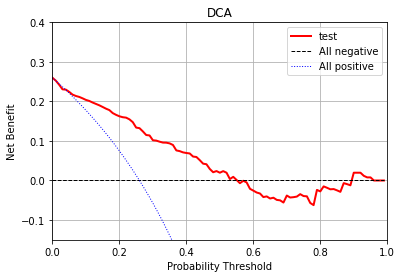

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


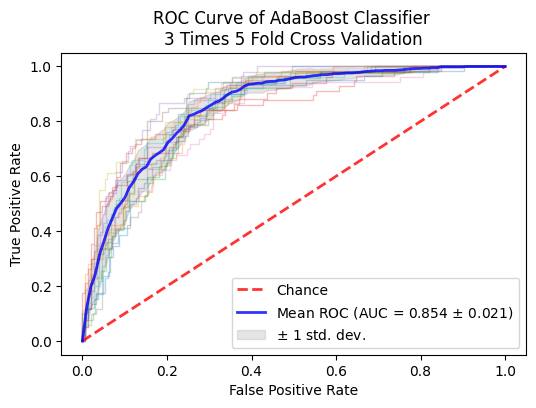

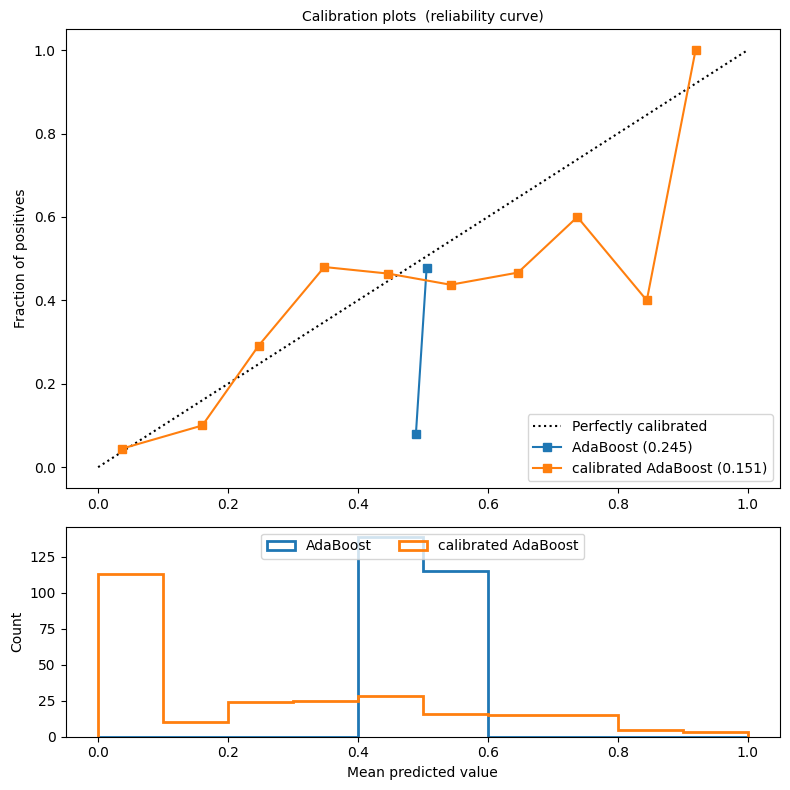

No handles with labels found to put in legend.


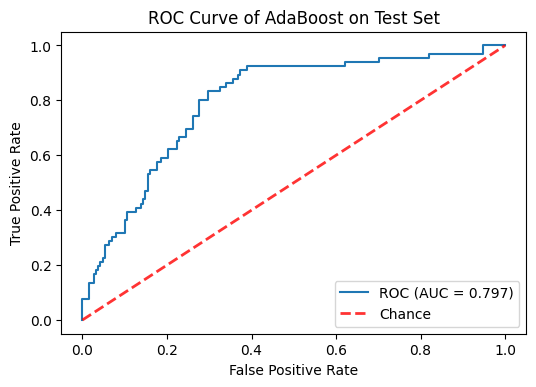

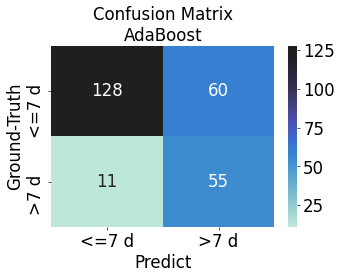

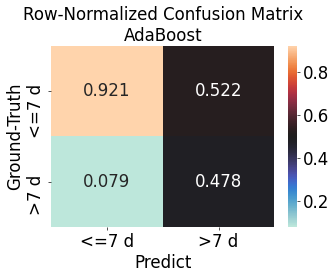

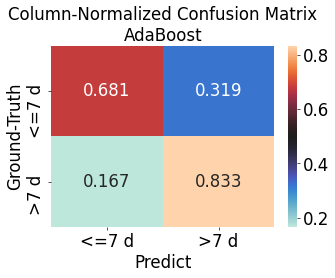

              precision    recall  f1-score   support

       <=7 d      0.921     0.681     0.783       188
        >7 d      0.478     0.833     0.608        66

    accuracy                          0.720       254
   macro avg      0.700     0.757     0.695       254
weighted avg      0.806     0.720     0.737       254

roc_auc: 0.797


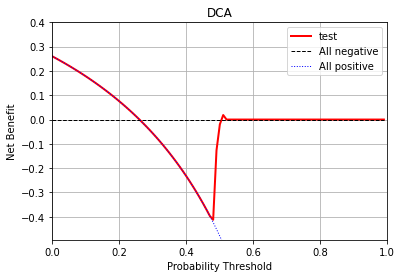

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


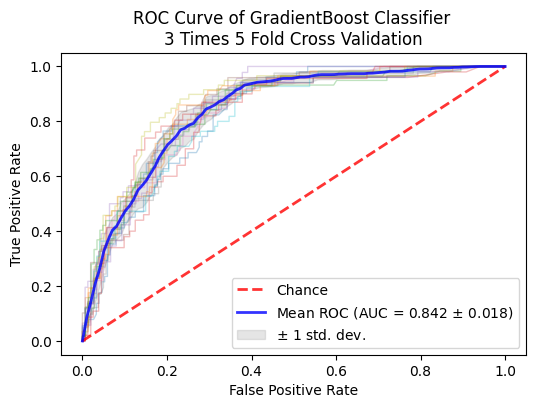

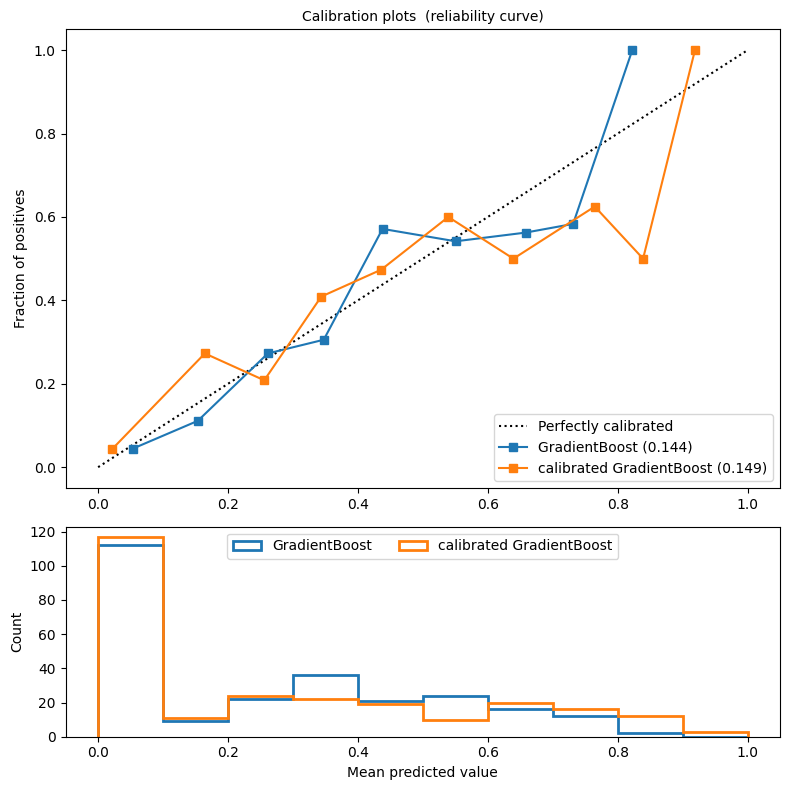

No handles with labels found to put in legend.


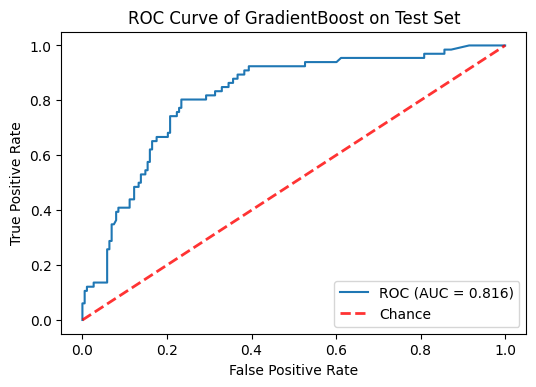

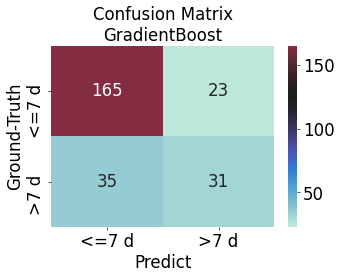

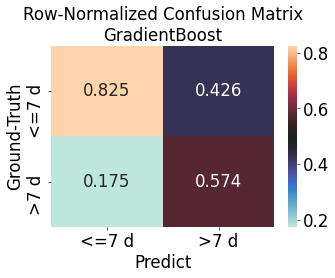

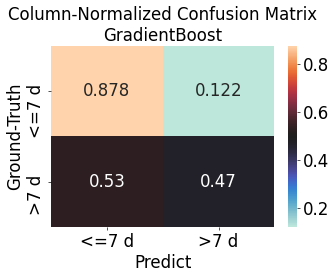

              precision    recall  f1-score   support

       <=7 d      0.825     0.878     0.851       188
        >7 d      0.574     0.470     0.517        66

    accuracy                          0.772       254
   macro avg      0.700     0.674     0.684       254
weighted avg      0.760     0.772     0.764       254

roc_auc: 0.816


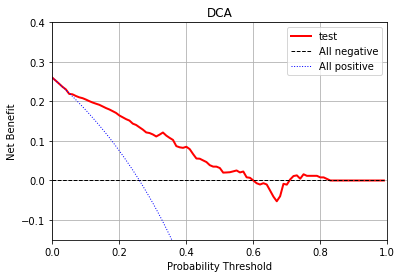

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


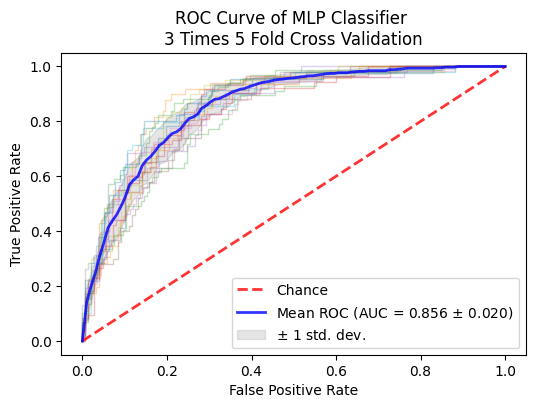

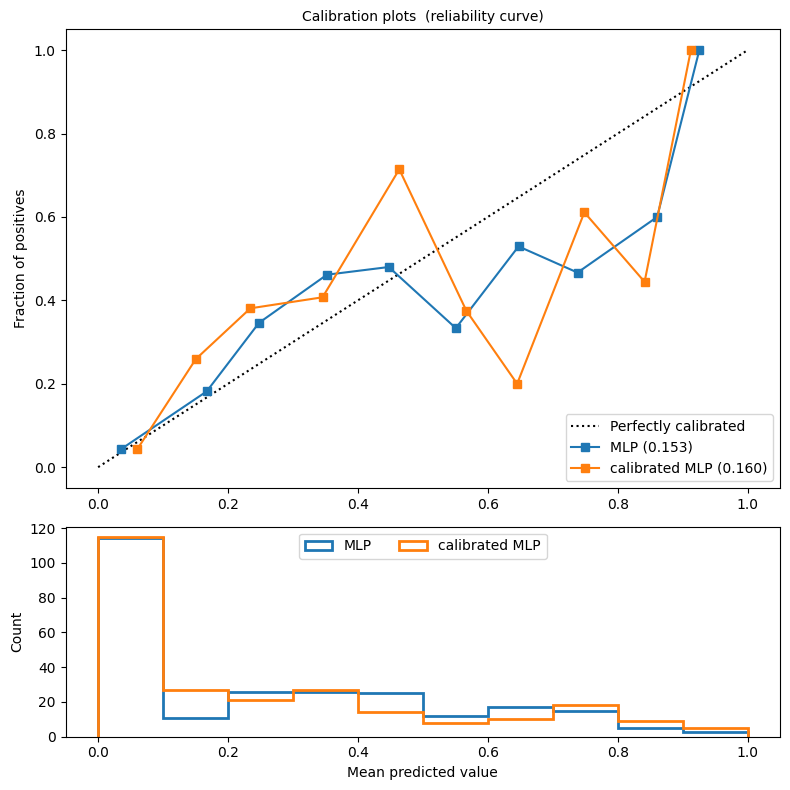

No handles with labels found to put in legend.


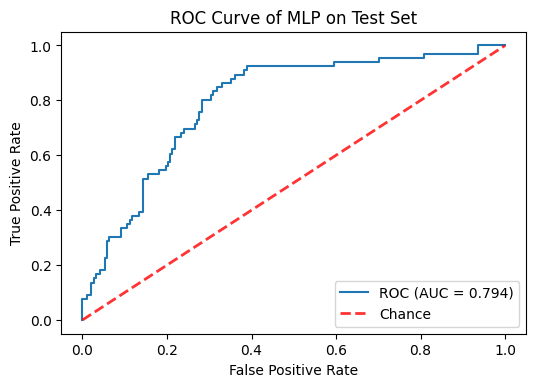

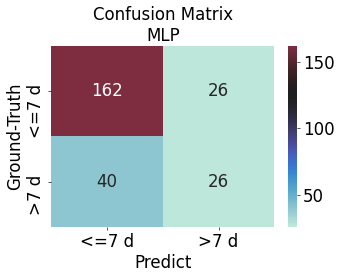

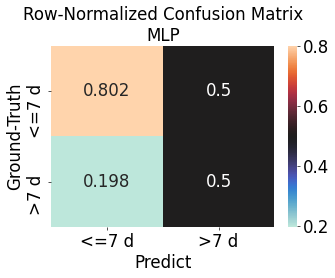

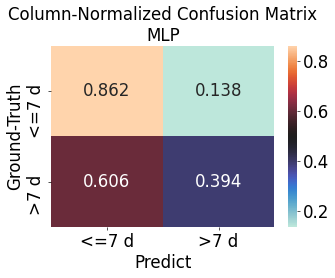

              precision    recall  f1-score   support

       <=7 d      0.802     0.862     0.831       188
        >7 d      0.500     0.394     0.441        66

    accuracy                          0.740       254
   macro avg      0.651     0.628     0.636       254
weighted avg      0.724     0.740     0.729       254

roc_auc: 0.794


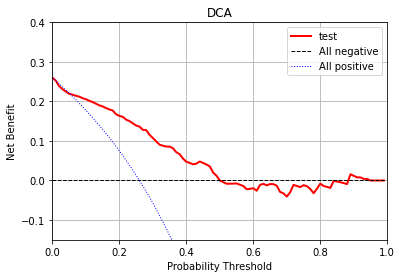

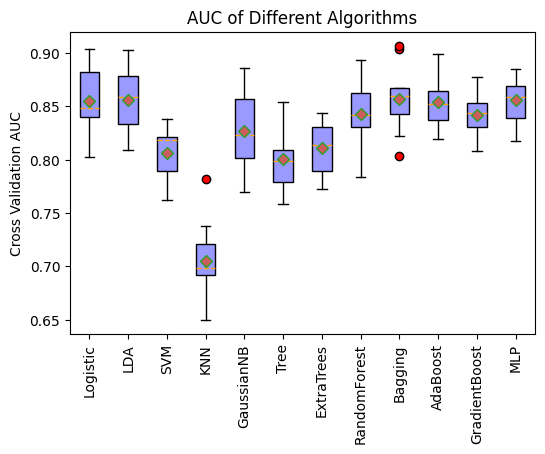

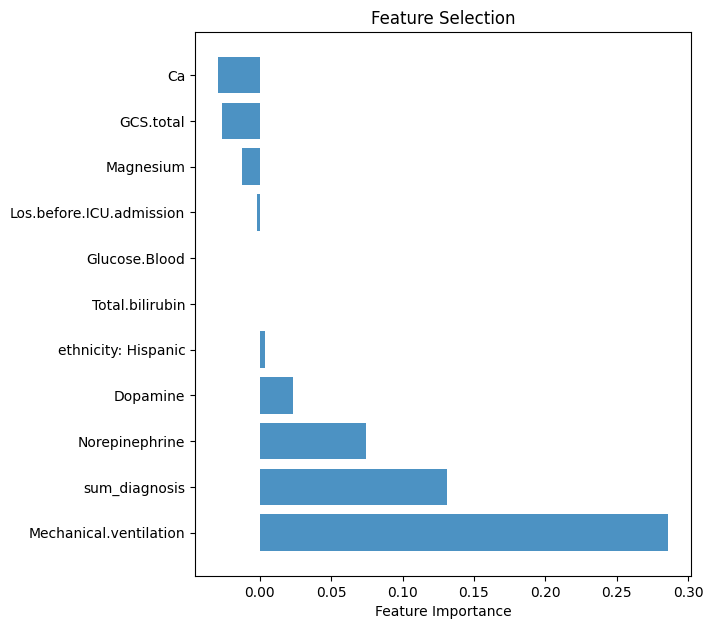

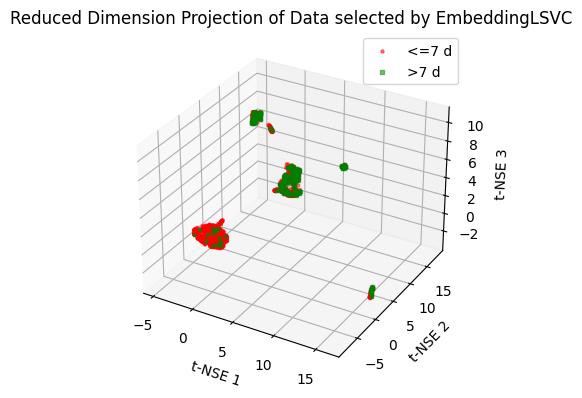

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


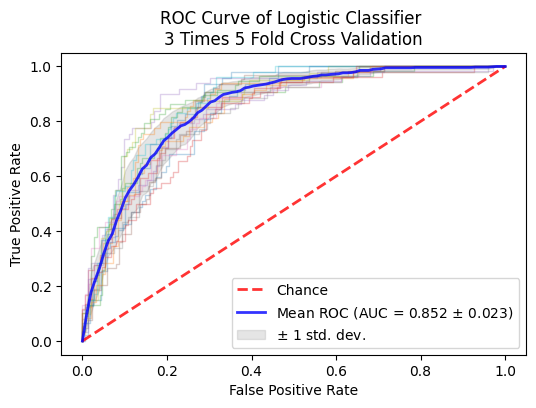

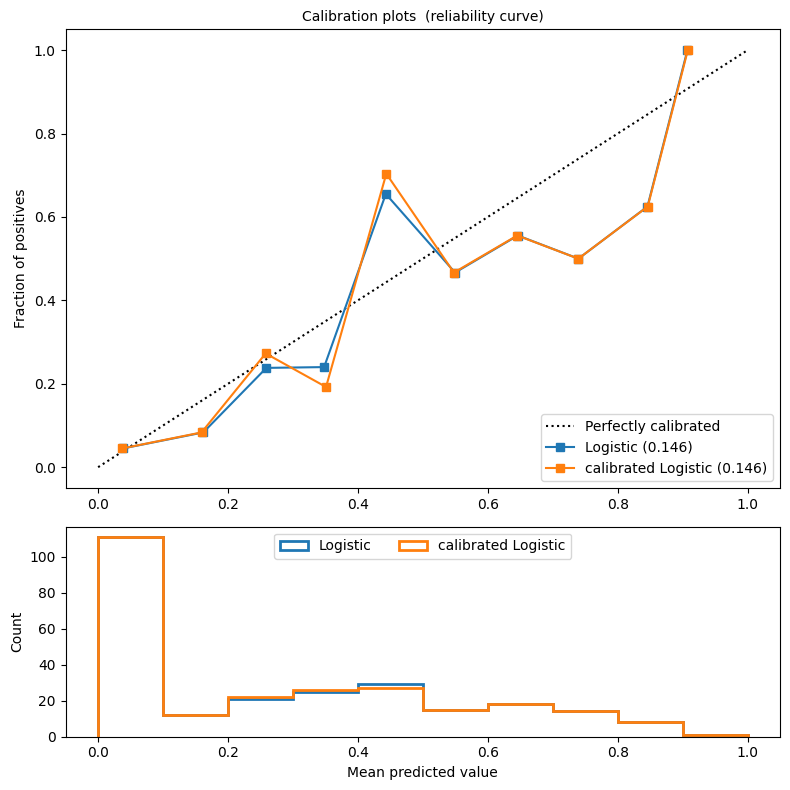

No handles with labels found to put in legend.


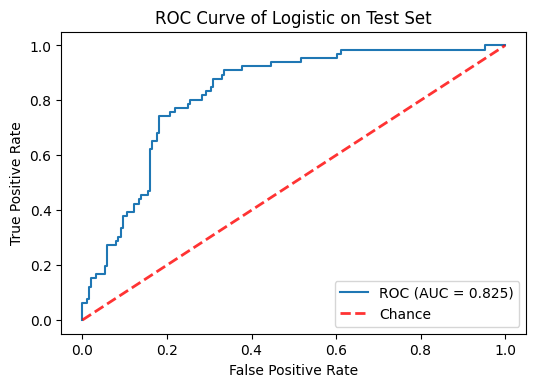

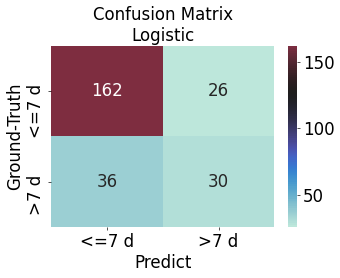

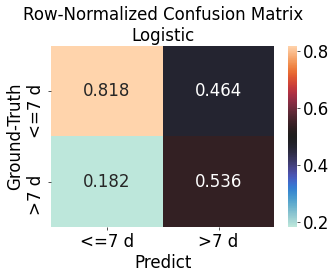

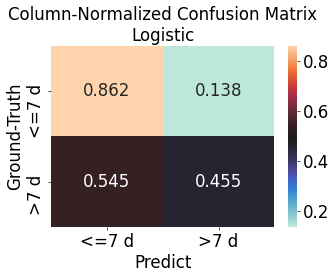

              precision    recall  f1-score   support

       <=7 d      0.818     0.862     0.839       188
        >7 d      0.536     0.455     0.492        66

    accuracy                          0.756       254
   macro avg      0.677     0.658     0.666       254
weighted avg      0.745     0.756     0.749       254

roc_auc: 0.825


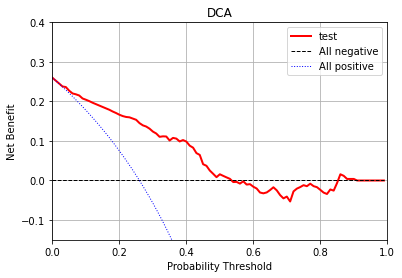

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


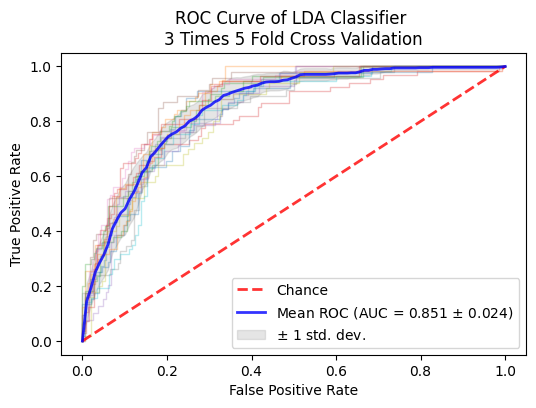

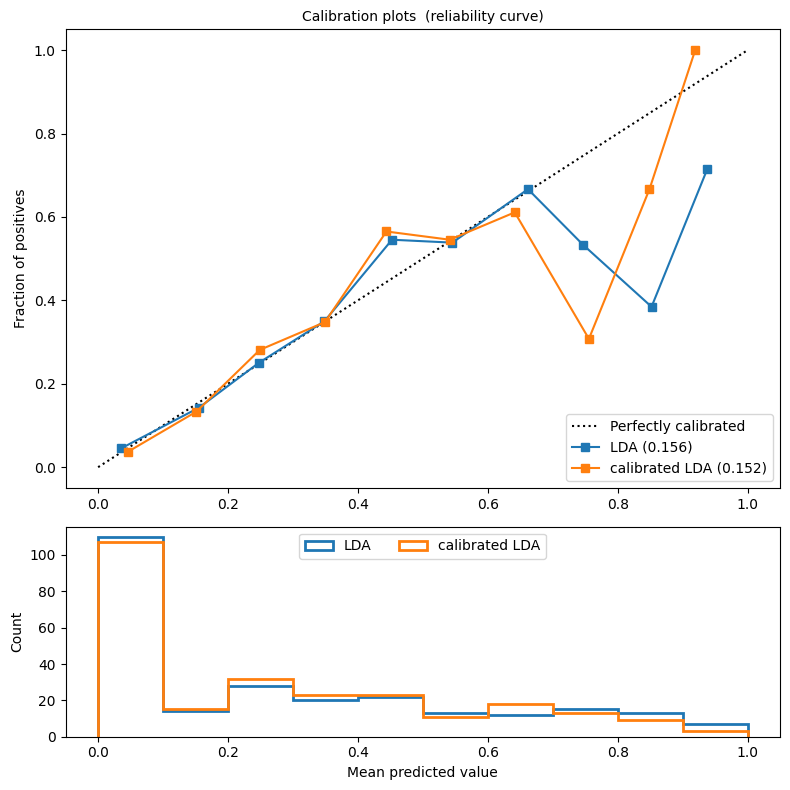

No handles with labels found to put in legend.


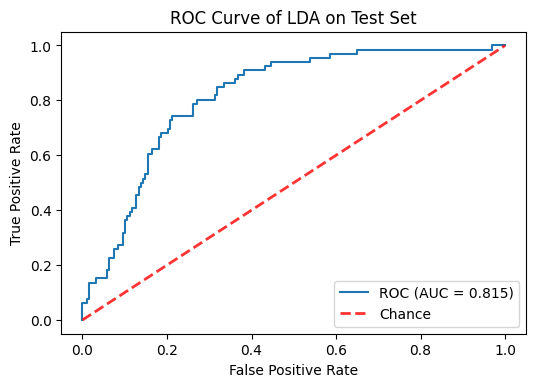

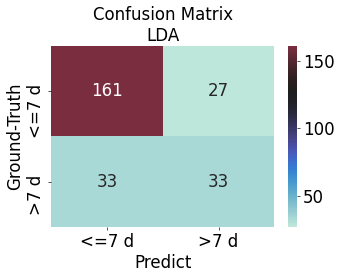

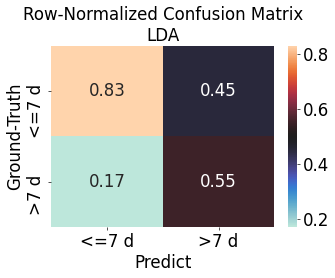

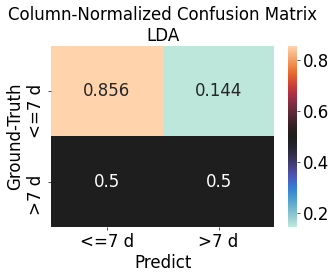

              precision    recall  f1-score   support

       <=7 d      0.830     0.856     0.843       188
        >7 d      0.550     0.500     0.524        66

    accuracy                          0.764       254
   macro avg      0.690     0.678     0.683       254
weighted avg      0.757     0.764     0.760       254

roc_auc: 0.815


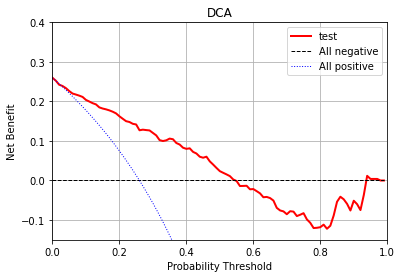

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


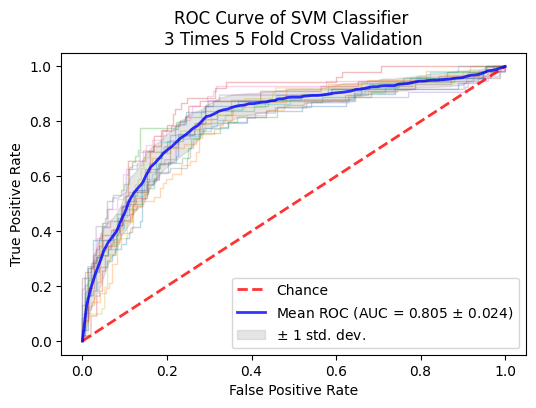

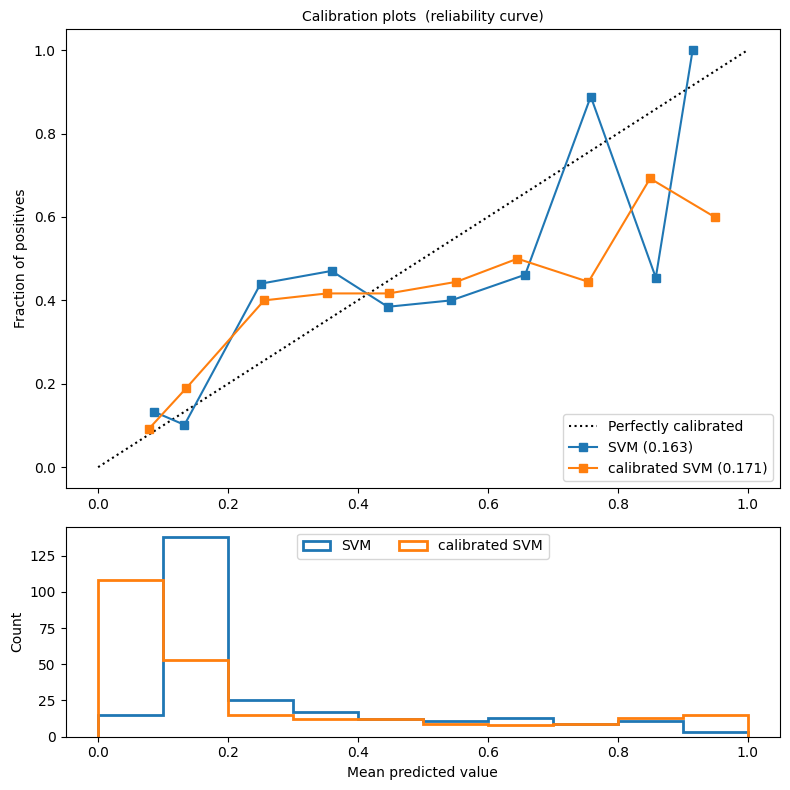

No handles with labels found to put in legend.


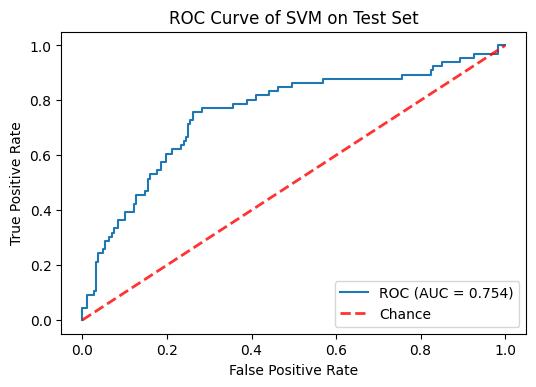

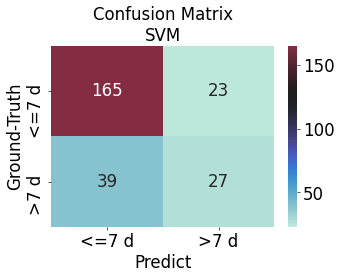

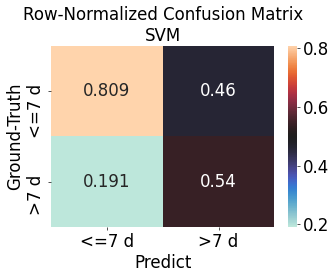

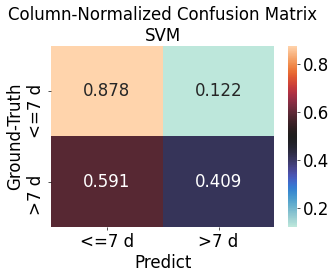

              precision    recall  f1-score   support

       <=7 d      0.809     0.878     0.842       188
        >7 d      0.540     0.409     0.466        66

    accuracy                          0.756       254
   macro avg      0.674     0.643     0.654       254
weighted avg      0.739     0.756     0.744       254

roc_auc: 0.754


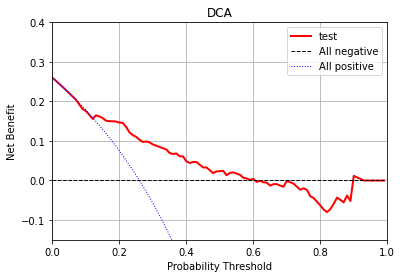

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


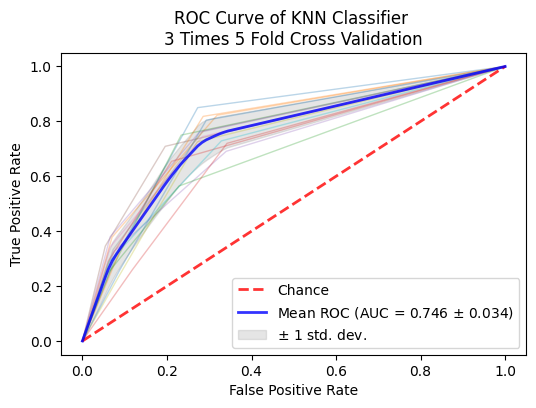

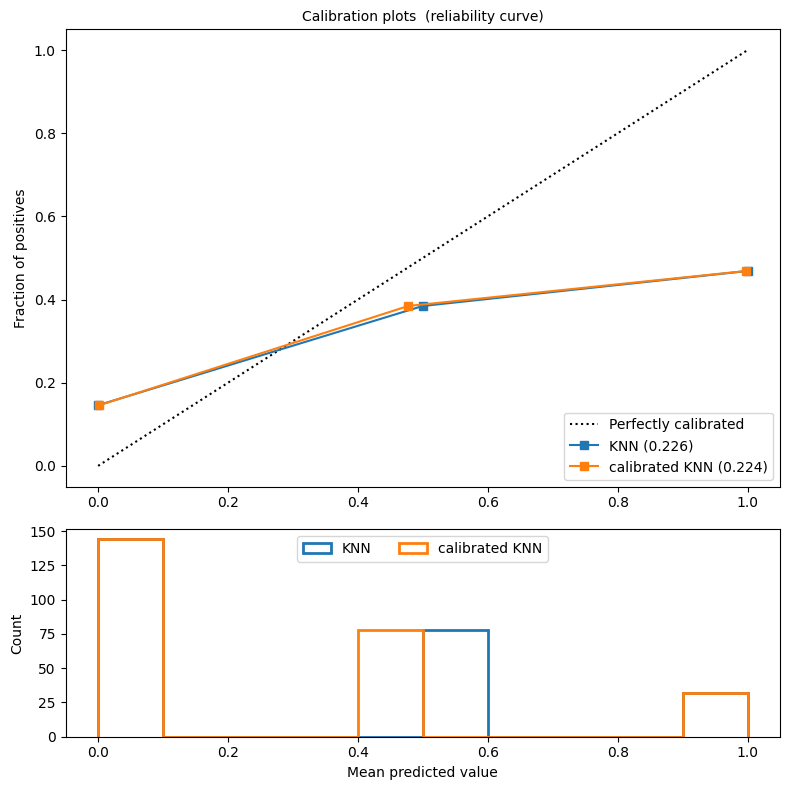

No handles with labels found to put in legend.


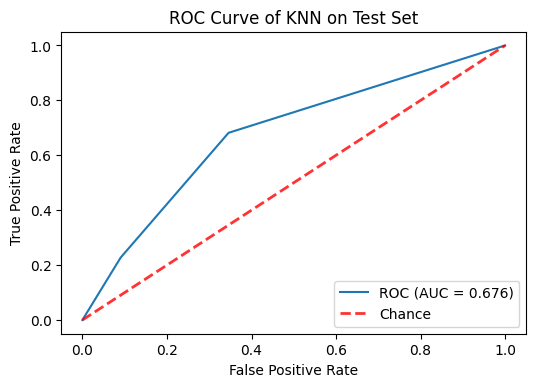

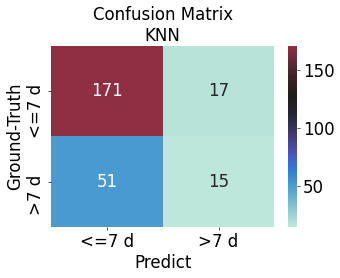

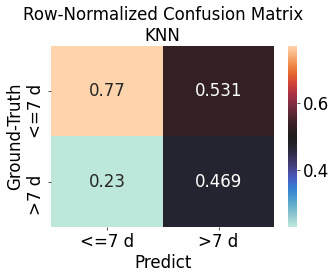

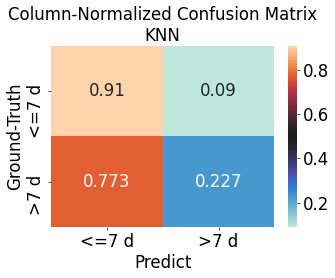

              precision    recall  f1-score   support

       <=7 d      0.770     0.910     0.834       188
        >7 d      0.469     0.227     0.306        66

    accuracy                          0.732       254
   macro avg      0.620     0.568     0.570       254
weighted avg      0.692     0.732     0.697       254

roc_auc: 0.676


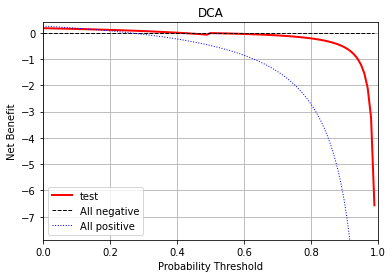

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


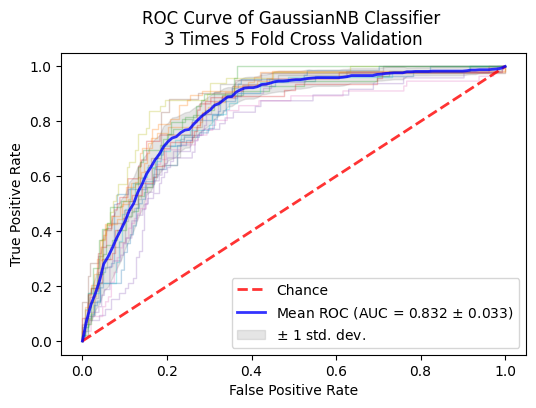

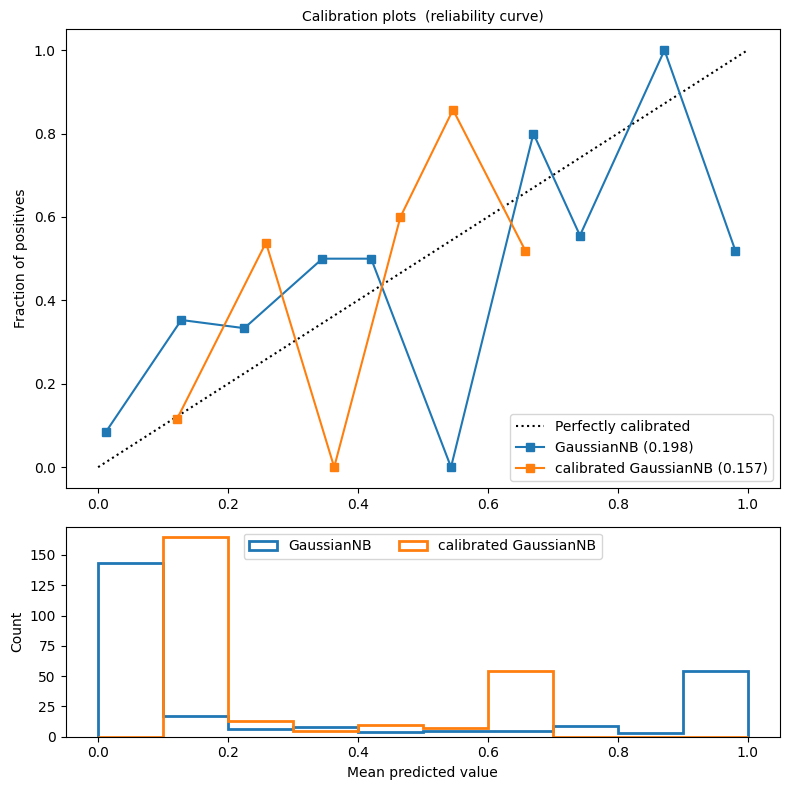

No handles with labels found to put in legend.


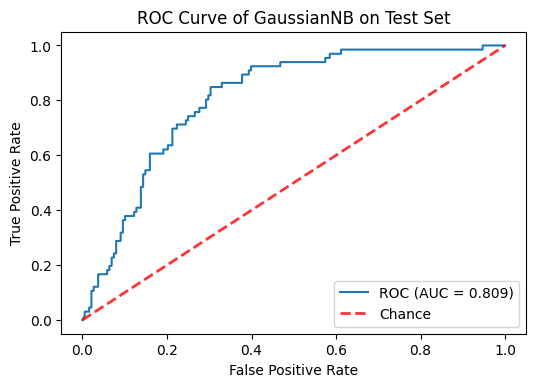

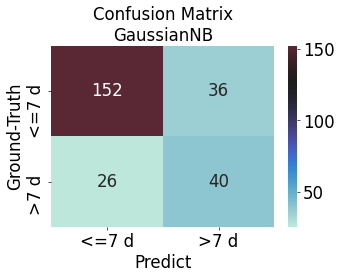

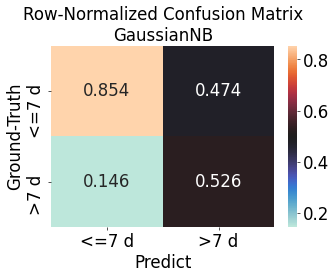

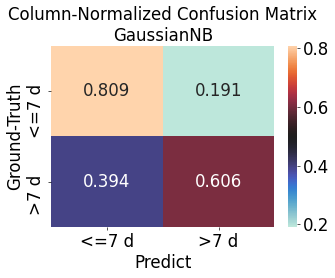

              precision    recall  f1-score   support

       <=7 d      0.854     0.809     0.831       188
        >7 d      0.526     0.606     0.563        66

    accuracy                          0.756       254
   macro avg      0.690     0.707     0.697       254
weighted avg      0.769     0.756     0.761       254

roc_auc: 0.809


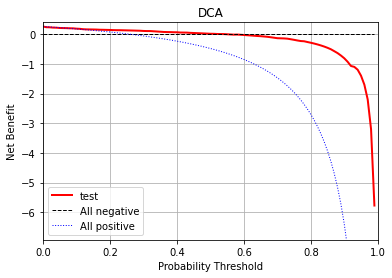

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


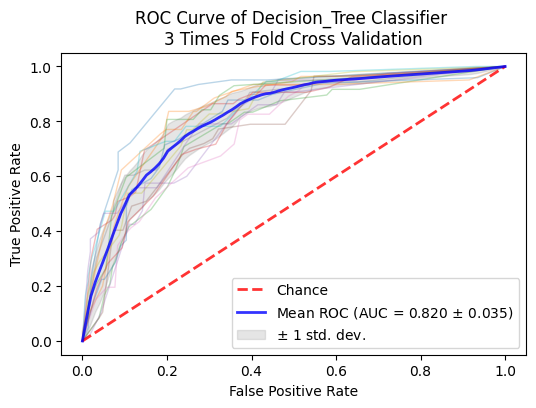

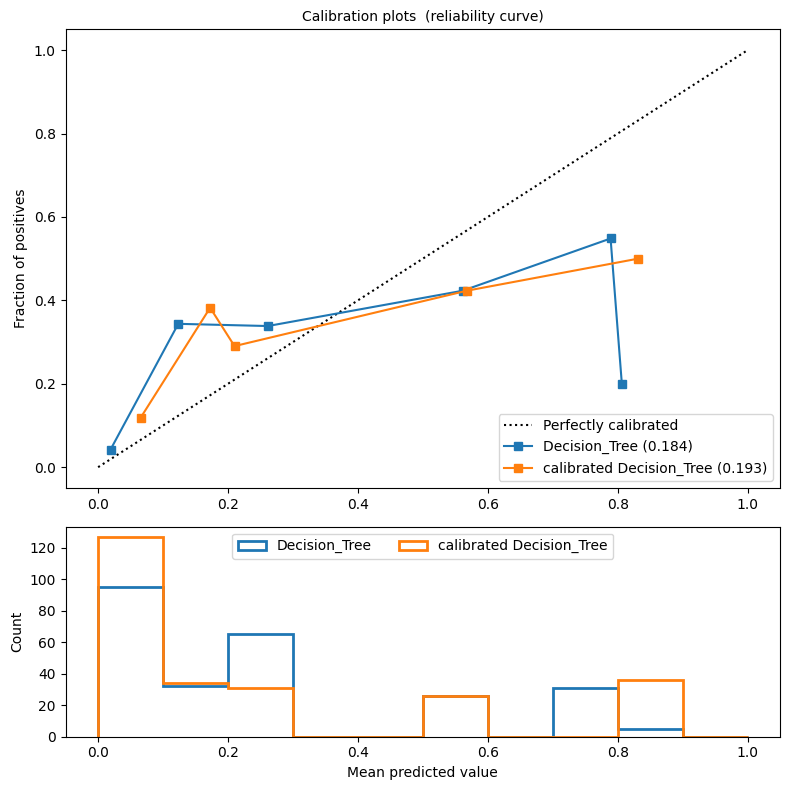

No handles with labels found to put in legend.


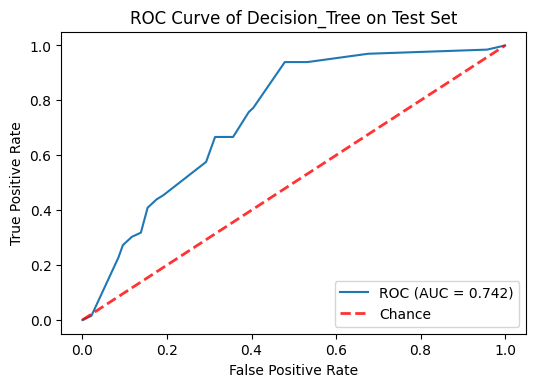

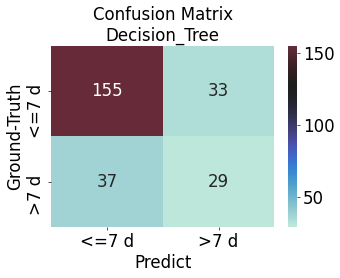

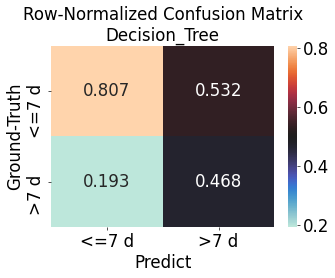

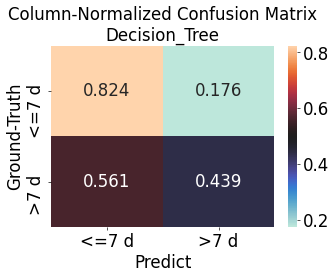

              precision    recall  f1-score   support

       <=7 d      0.807     0.824     0.816       188
        >7 d      0.468     0.439     0.453        66

    accuracy                          0.724       254
   macro avg      0.638     0.632     0.634       254
weighted avg      0.719     0.724     0.722       254

roc_auc: 0.742


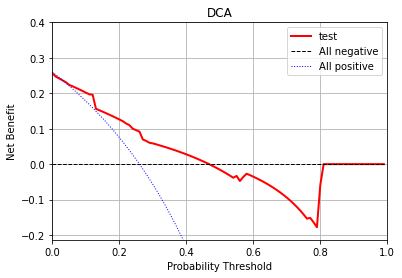

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


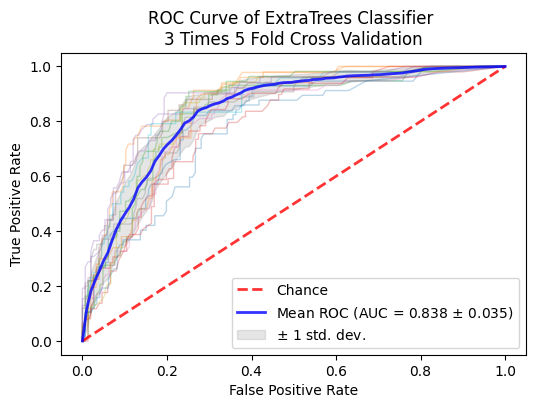

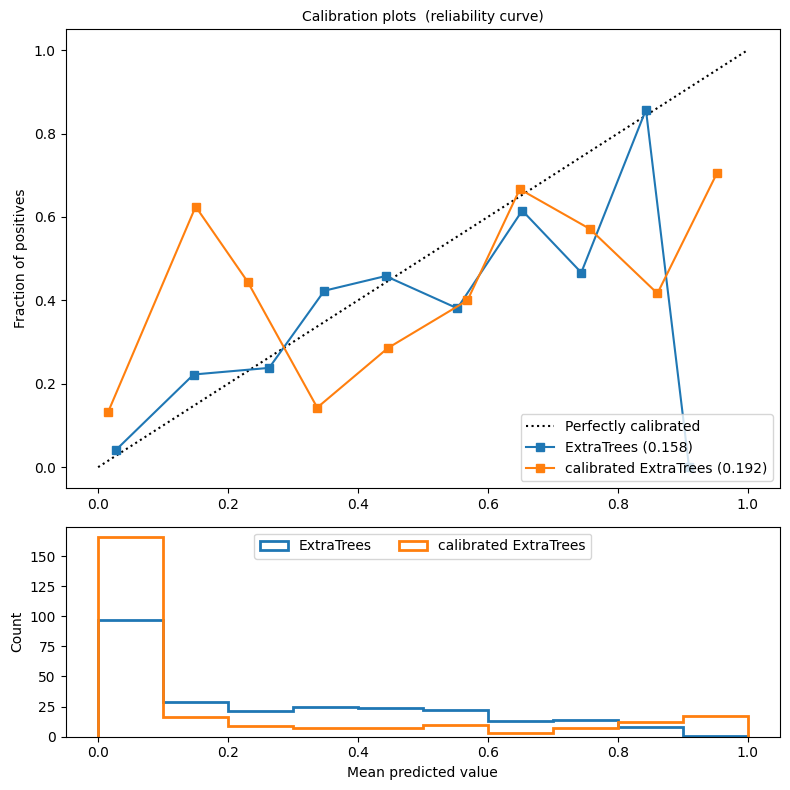

No handles with labels found to put in legend.


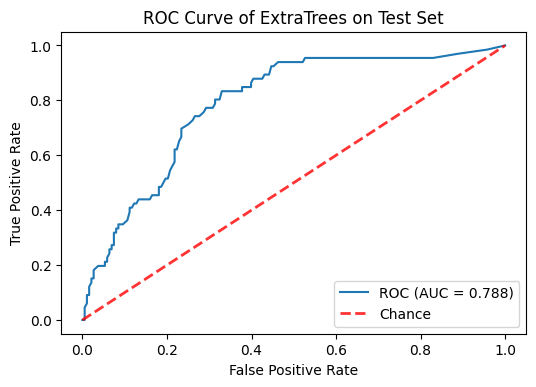

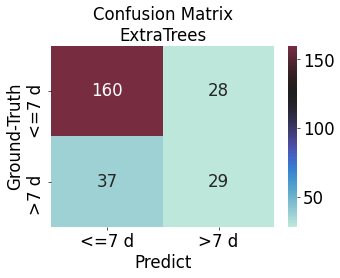

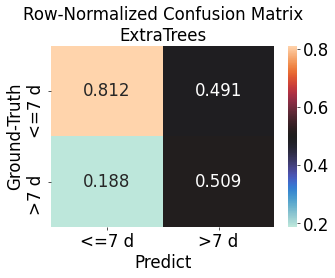

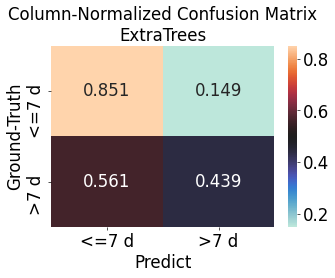

              precision    recall  f1-score   support

       <=7 d      0.812     0.851     0.831       188
        >7 d      0.509     0.439     0.472        66

    accuracy                          0.744       254
   macro avg      0.660     0.645     0.651       254
weighted avg      0.733     0.744     0.738       254

roc_auc: 0.788


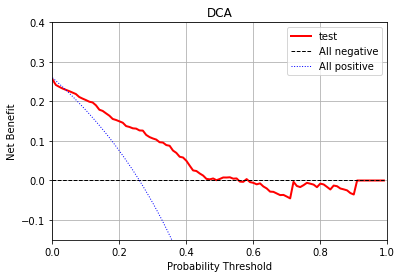

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


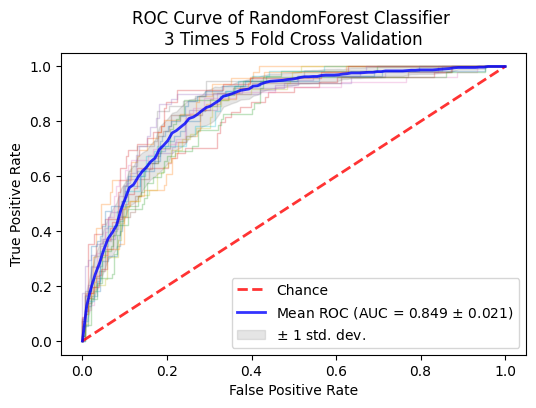

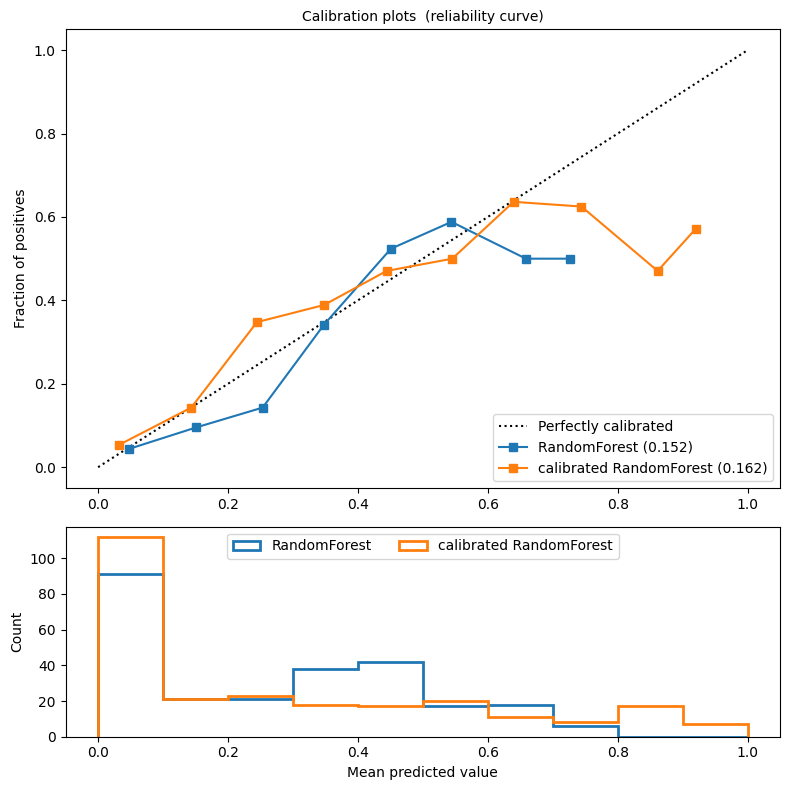

No handles with labels found to put in legend.


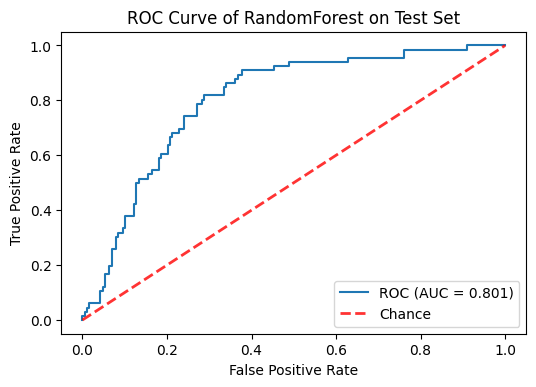

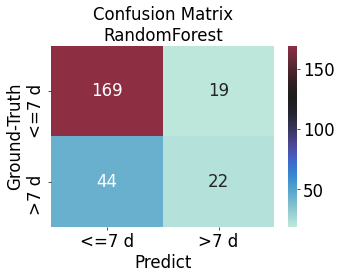

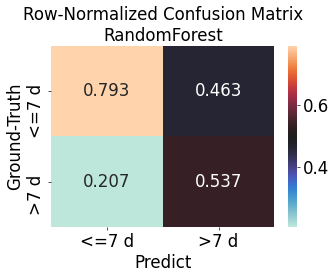

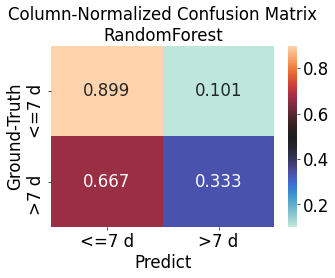

              precision    recall  f1-score   support

       <=7 d      0.793     0.899     0.843       188
        >7 d      0.537     0.333     0.411        66

    accuracy                          0.752       254
   macro avg      0.665     0.616     0.627       254
weighted avg      0.727     0.752     0.731       254

roc_auc: 0.801


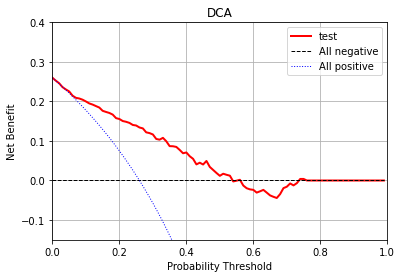

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


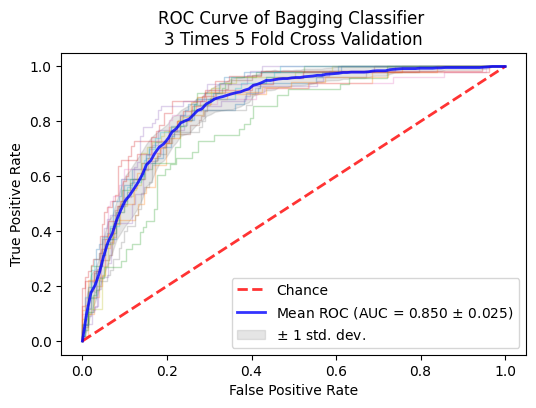

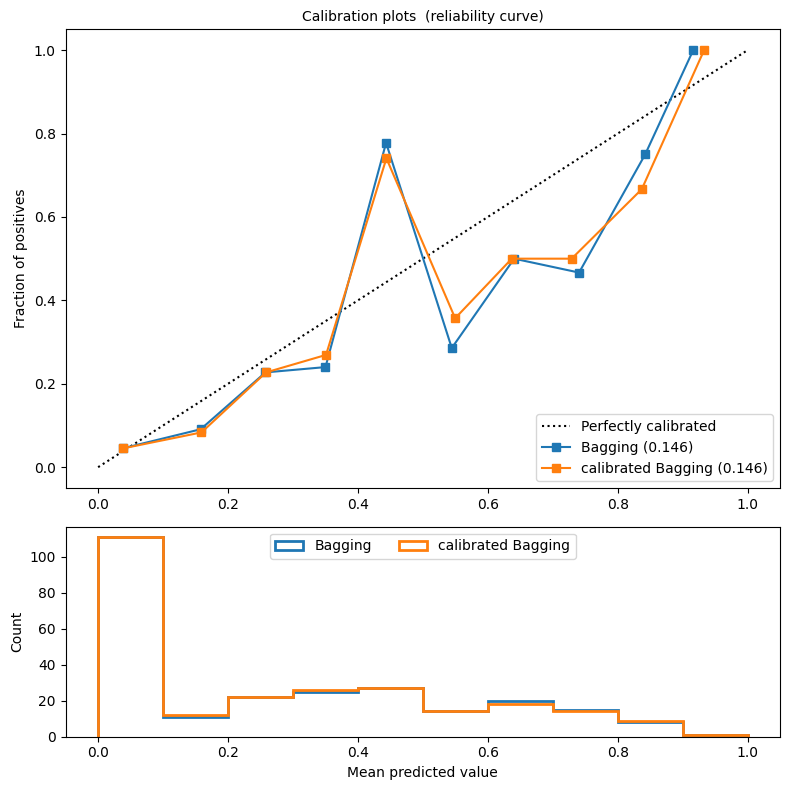

No handles with labels found to put in legend.


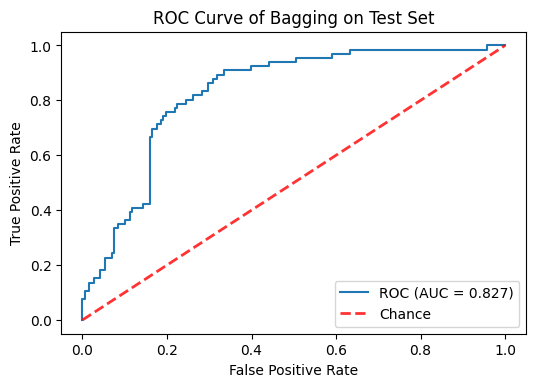

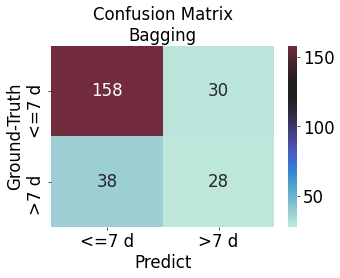

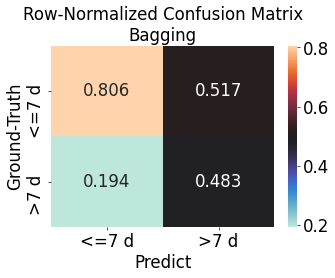

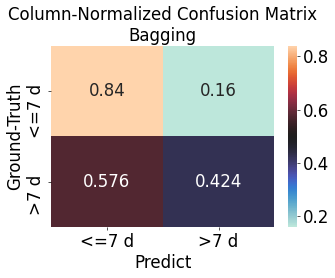

              precision    recall  f1-score   support

       <=7 d      0.806     0.840     0.823       188
        >7 d      0.483     0.424     0.452        66

    accuracy                          0.732       254
   macro avg      0.644     0.632     0.637       254
weighted avg      0.722     0.732     0.726       254

roc_auc: 0.827


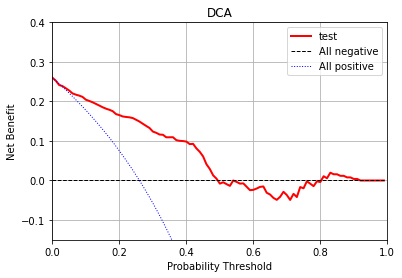

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


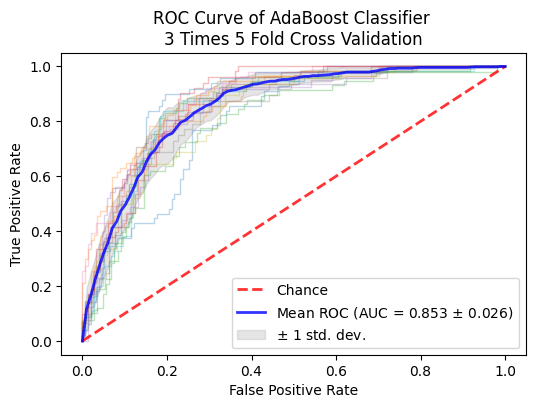

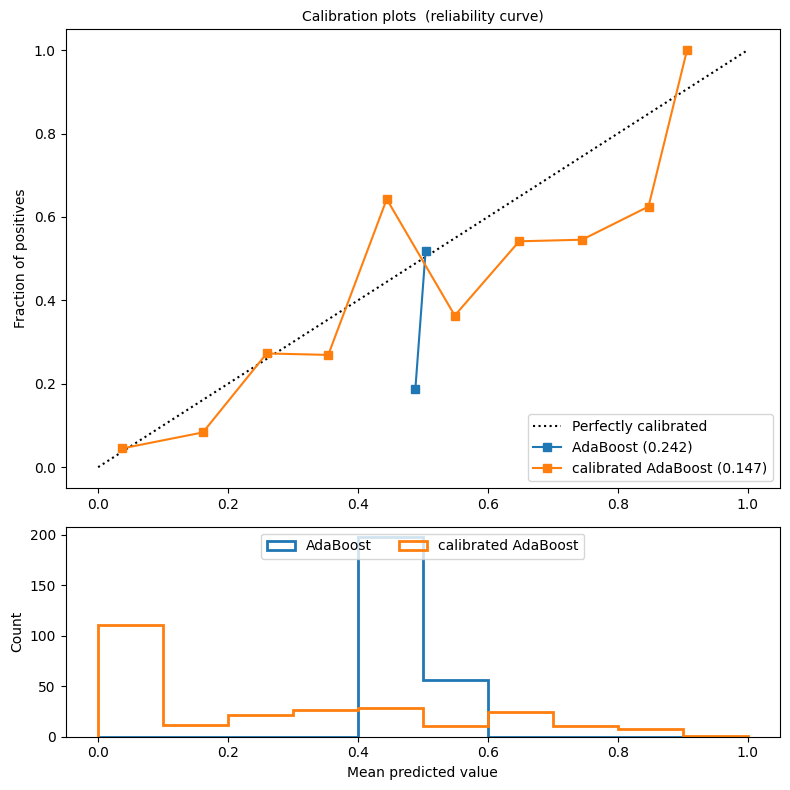

No handles with labels found to put in legend.


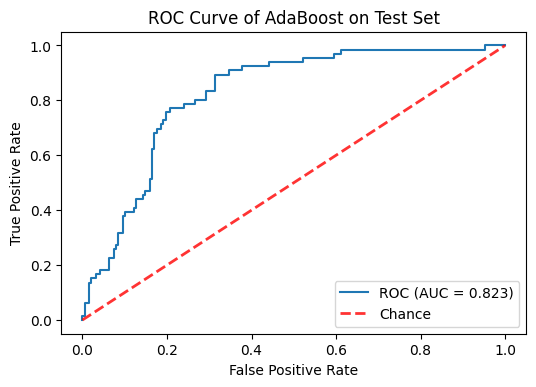

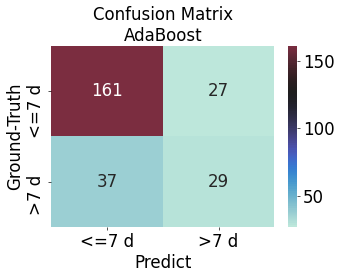

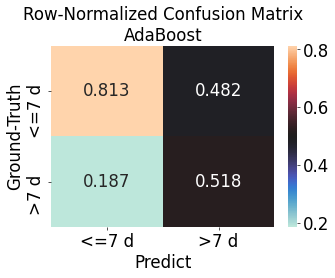

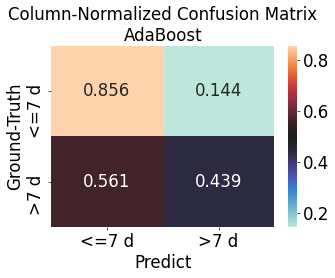

              precision    recall  f1-score   support

       <=7 d      0.813     0.856     0.834       188
        >7 d      0.518     0.439     0.475        66

    accuracy                          0.748       254
   macro avg      0.665     0.648     0.655       254
weighted avg      0.736     0.748     0.741       254

roc_auc: 0.823


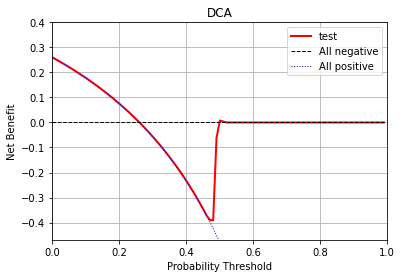

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


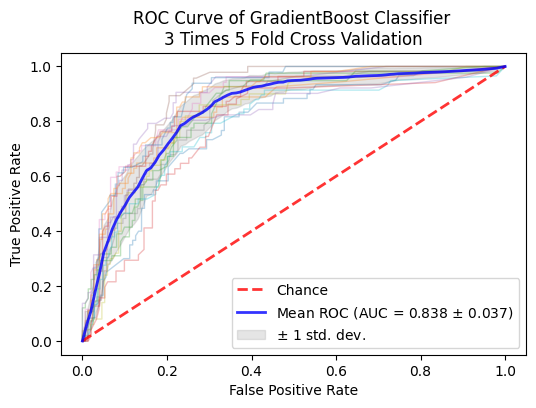

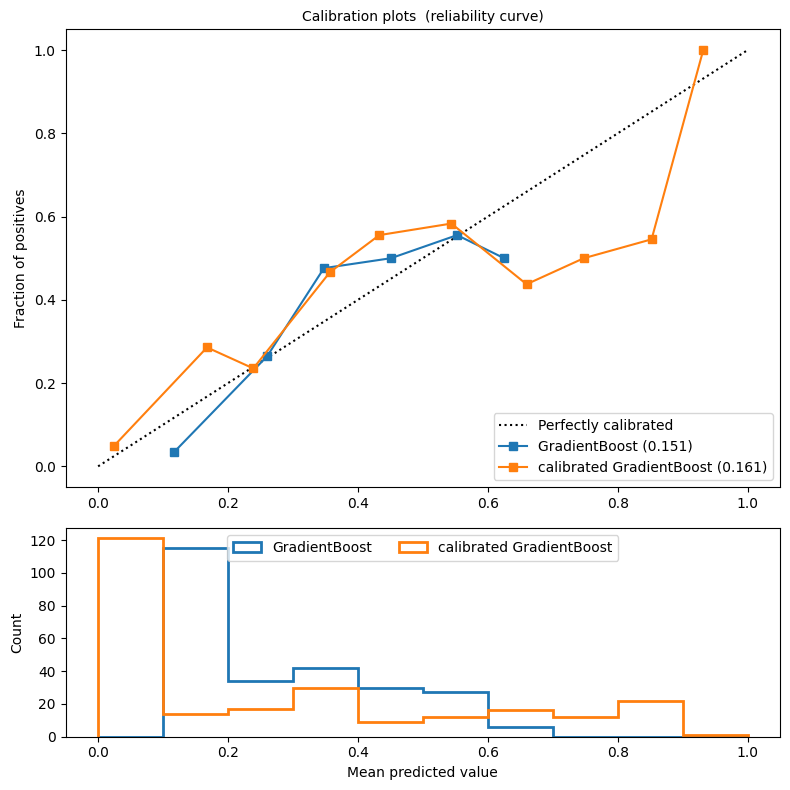

No handles with labels found to put in legend.


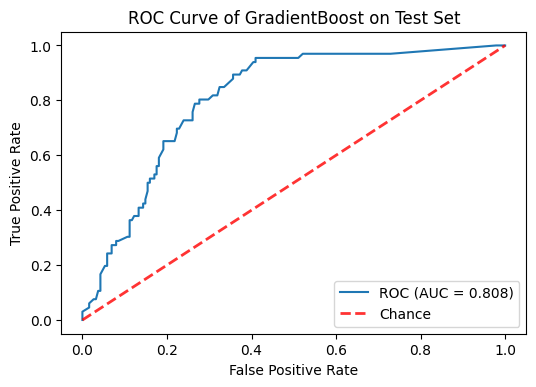

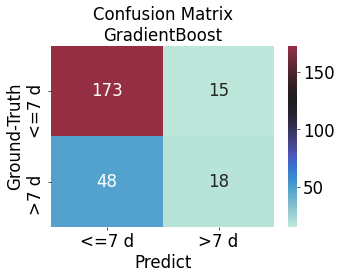

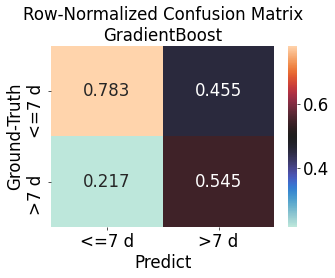

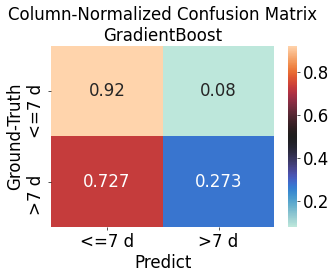

              precision    recall  f1-score   support

       <=7 d      0.783     0.920     0.846       188
        >7 d      0.545     0.273     0.364        66

    accuracy                          0.752       254
   macro avg      0.664     0.596     0.605       254
weighted avg      0.721     0.752     0.721       254

roc_auc: 0.808


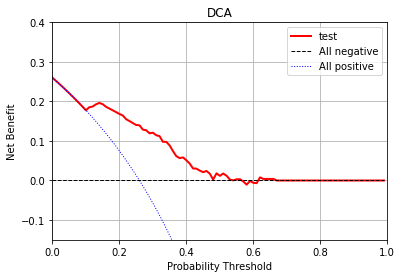

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


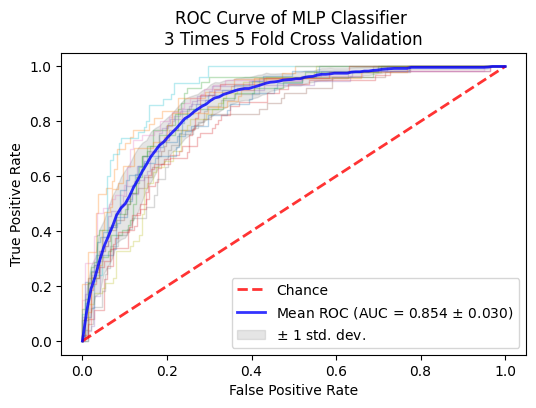

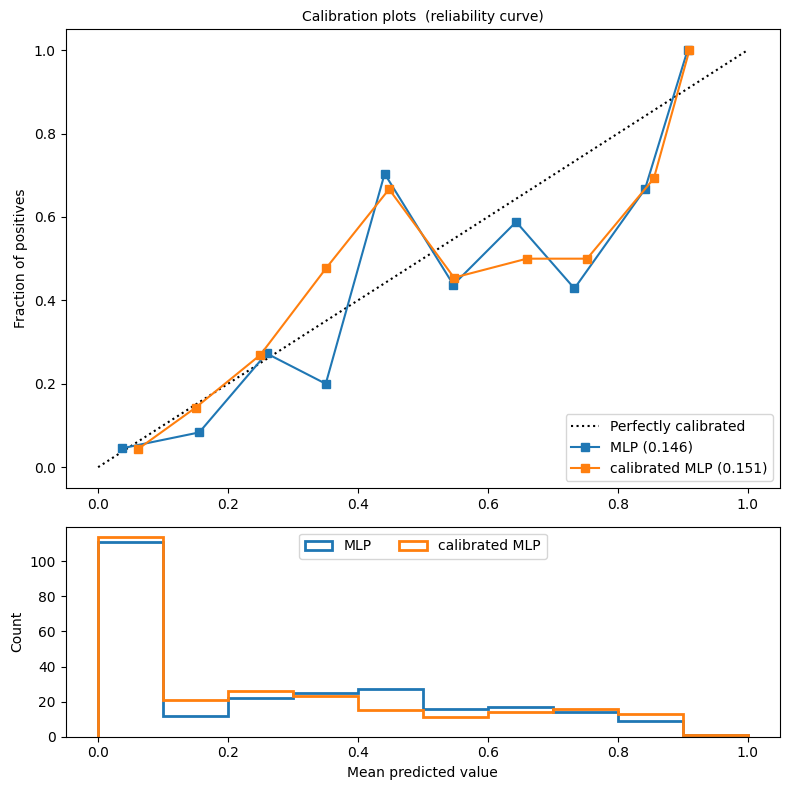

No handles with labels found to put in legend.


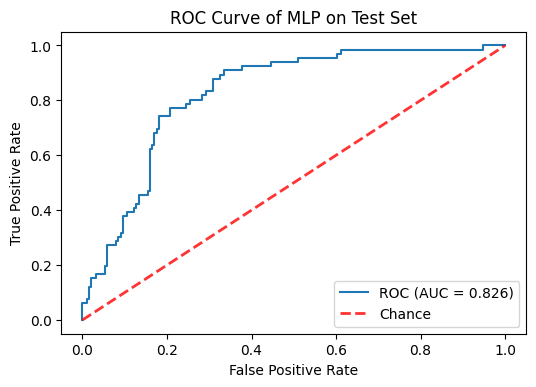

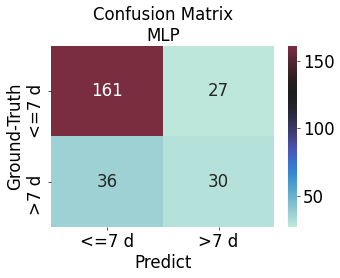

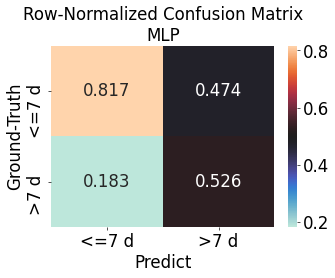

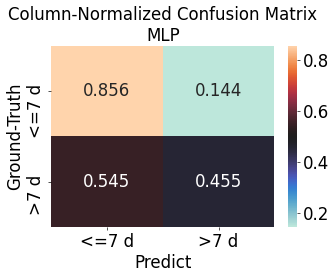

              precision    recall  f1-score   support

       <=7 d      0.817     0.856     0.836       188
        >7 d      0.526     0.455     0.488        66

    accuracy                          0.752       254
   macro avg      0.672     0.655     0.662       254
weighted avg      0.742     0.752     0.746       254

roc_auc: 0.826


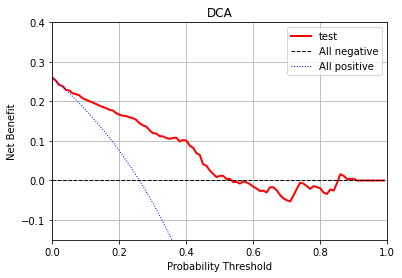

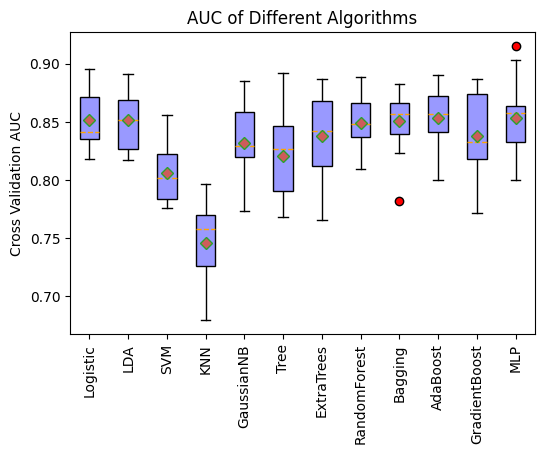

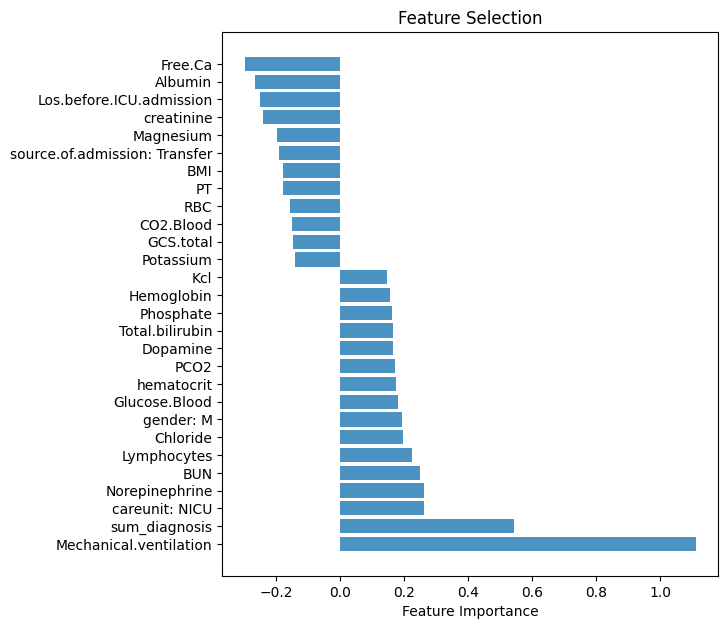

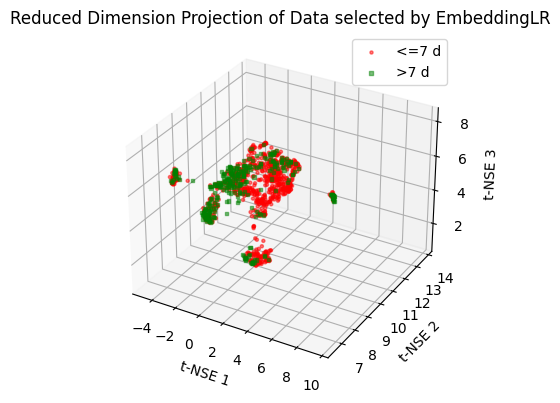

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


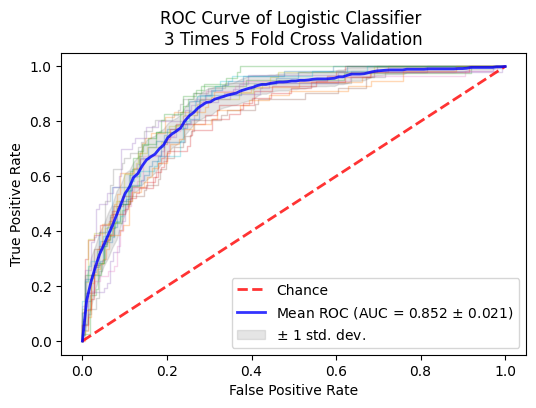

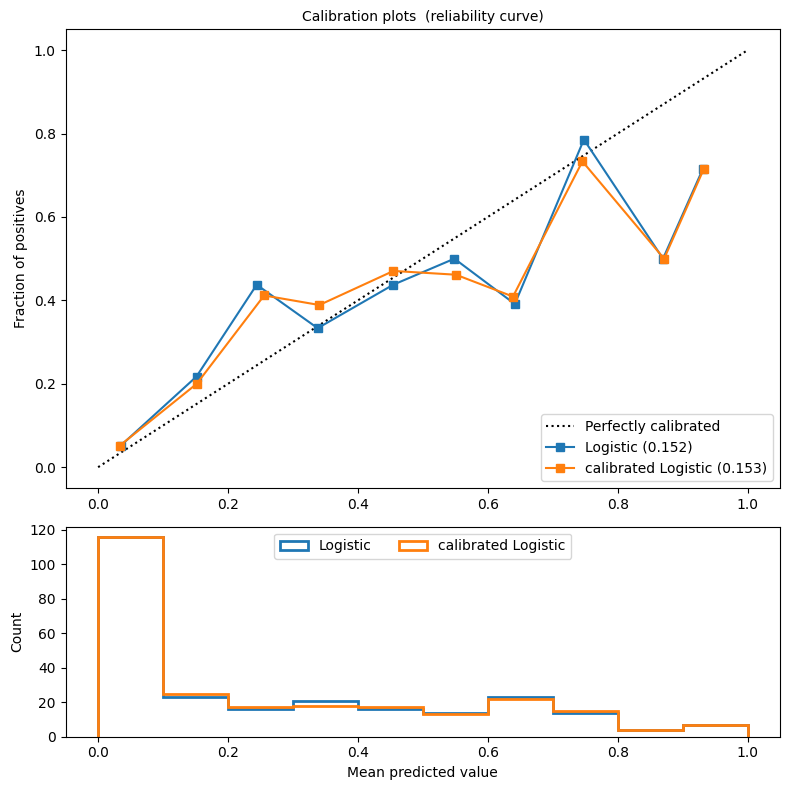

No handles with labels found to put in legend.


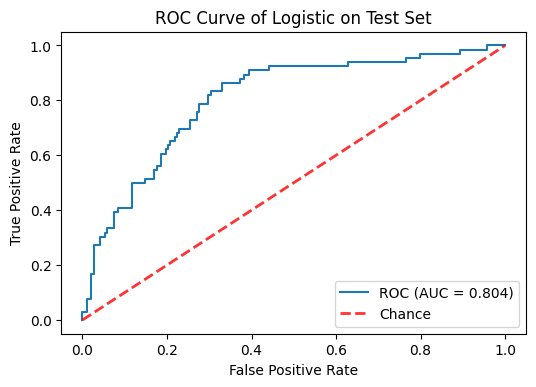

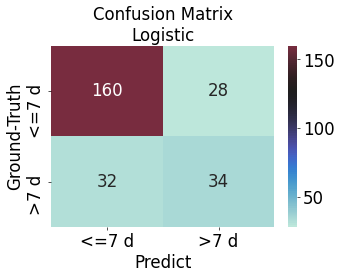

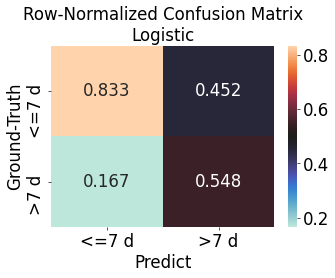

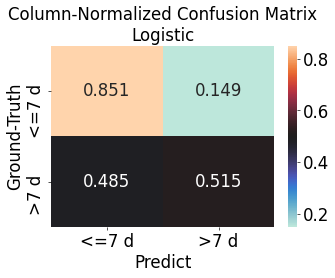

              precision    recall  f1-score   support

       <=7 d      0.833     0.851     0.842       188
        >7 d      0.548     0.515     0.531        66

    accuracy                          0.764       254
   macro avg      0.691     0.683     0.687       254
weighted avg      0.759     0.764     0.761       254

roc_auc: 0.804


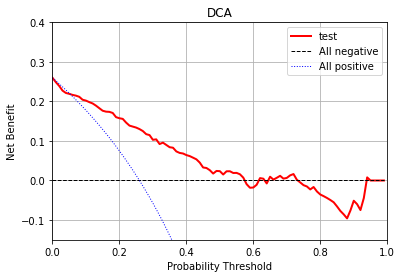

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


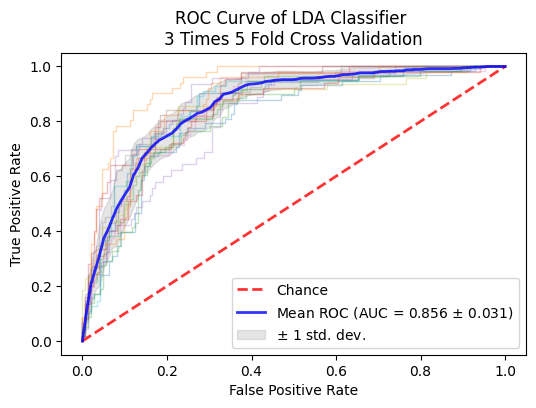

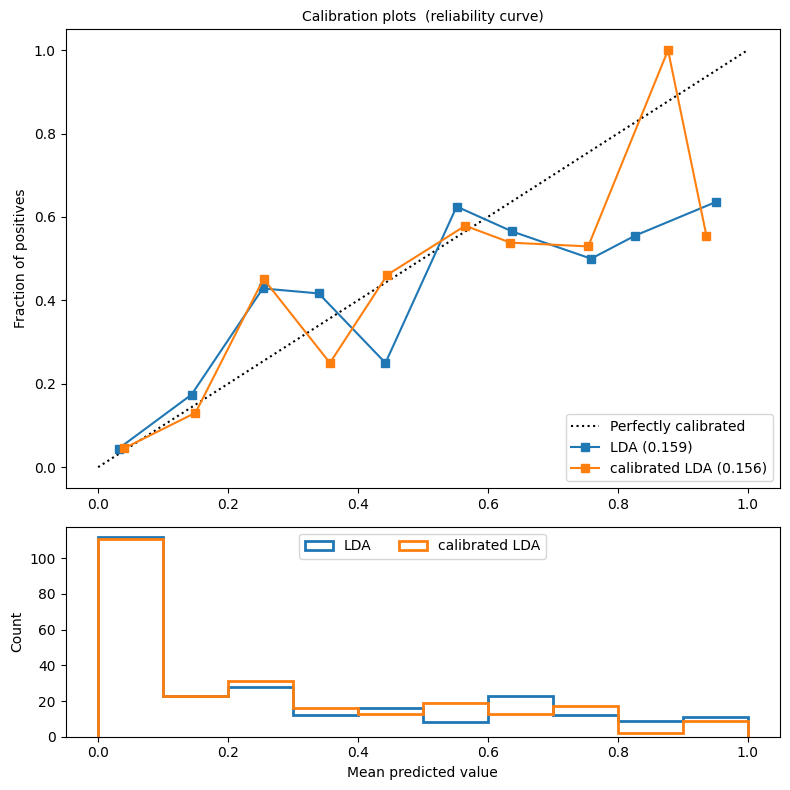

No handles with labels found to put in legend.


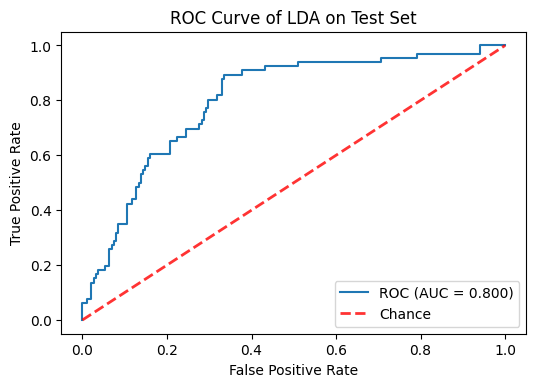

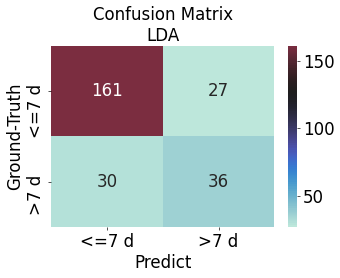

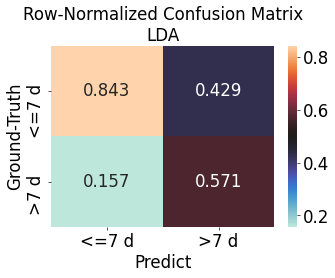

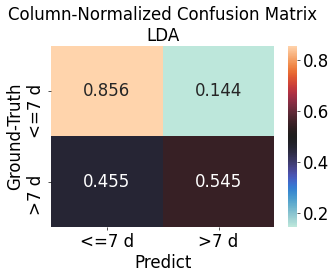

              precision    recall  f1-score   support

       <=7 d      0.843     0.856     0.850       188
        >7 d      0.571     0.545     0.558        66

    accuracy                          0.776       254
   macro avg      0.707     0.701     0.704       254
weighted avg      0.772     0.776     0.774       254

roc_auc: 0.8


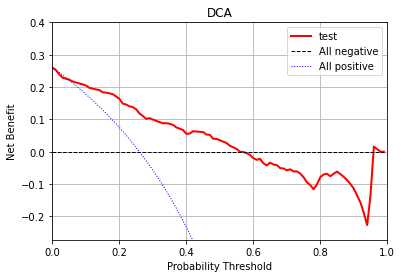

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


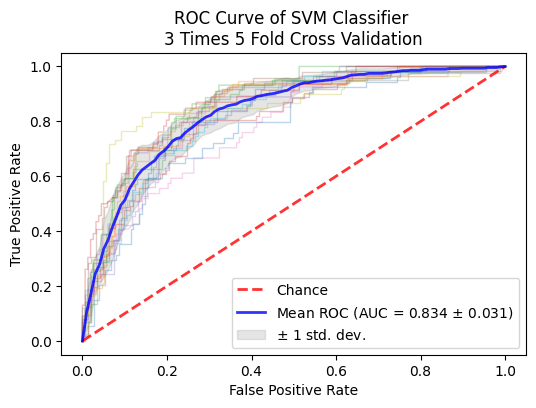

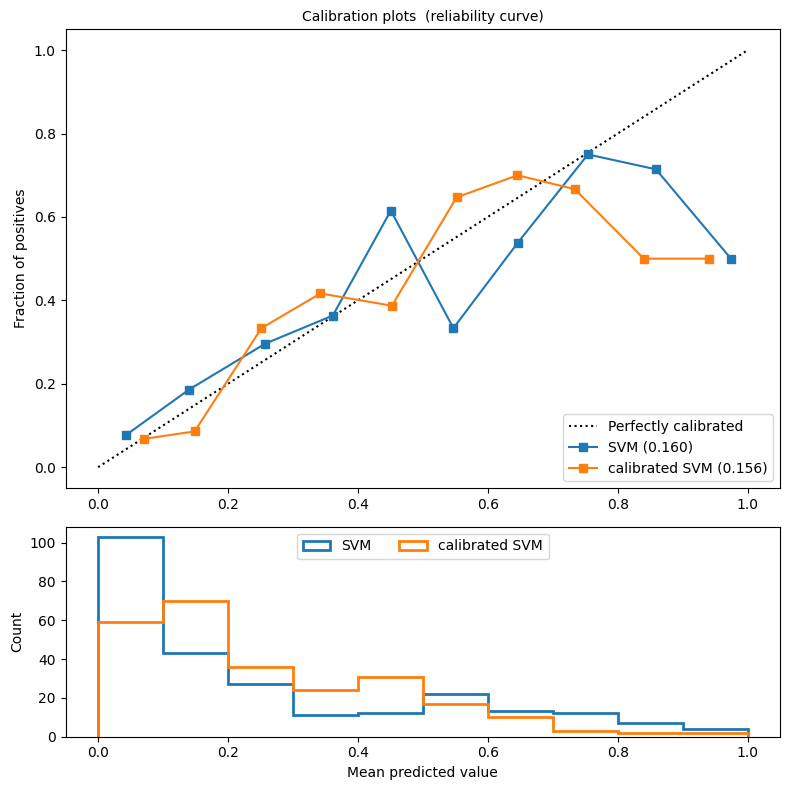

No handles with labels found to put in legend.


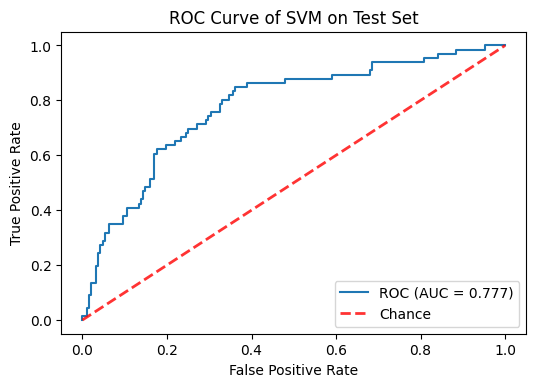

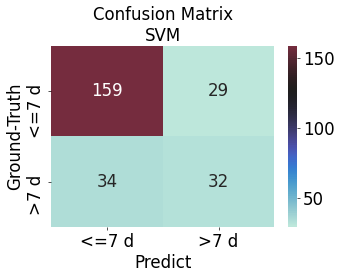

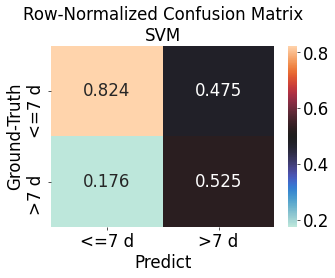

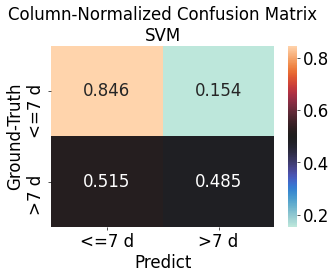

              precision    recall  f1-score   support

       <=7 d      0.824     0.846     0.835       188
        >7 d      0.525     0.485     0.504        66

    accuracy                          0.752       254
   macro avg      0.674     0.665     0.669       254
weighted avg      0.746     0.752     0.749       254

roc_auc: 0.777


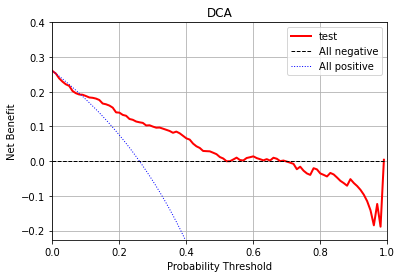

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


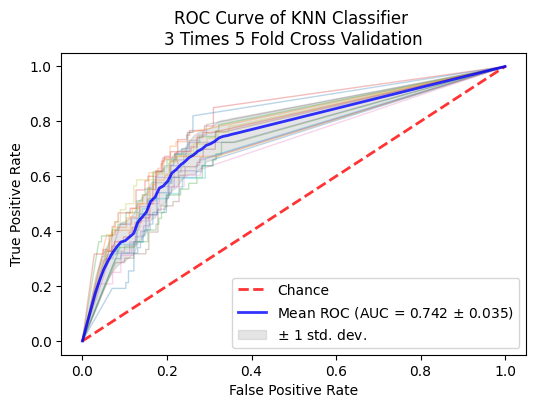

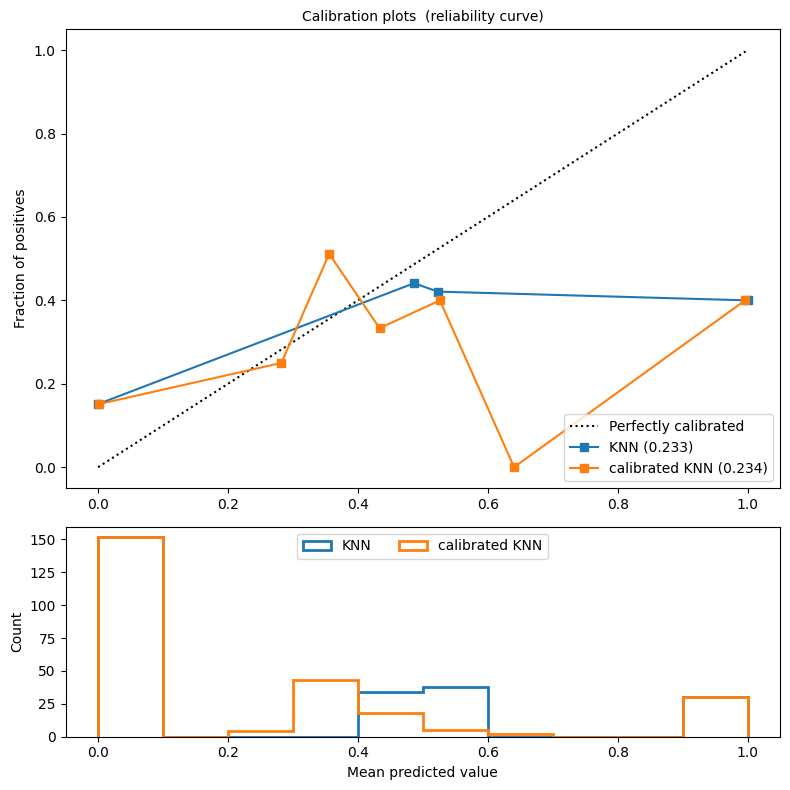

No handles with labels found to put in legend.


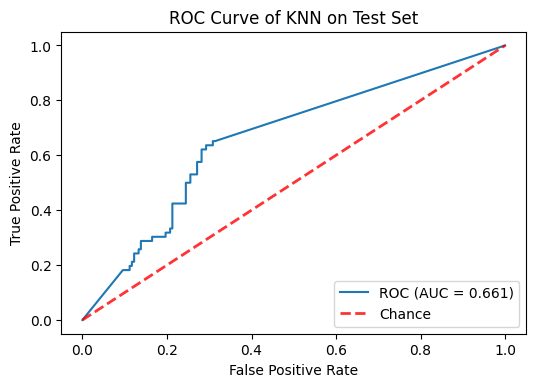

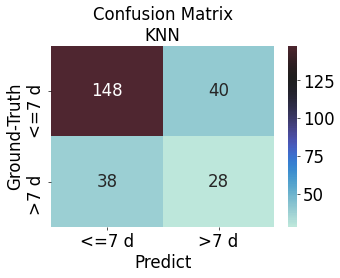

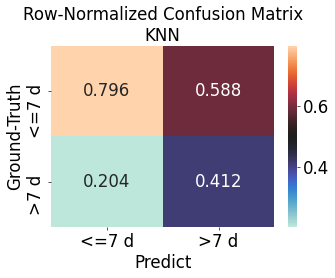

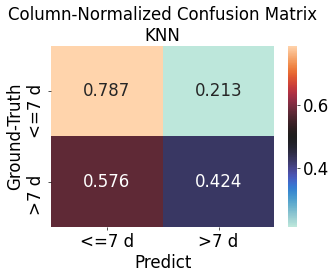

              precision    recall  f1-score   support

       <=7 d      0.796     0.787     0.791       188
        >7 d      0.412     0.424     0.418        66

    accuracy                          0.693       254
   macro avg      0.604     0.606     0.605       254
weighted avg      0.696     0.693     0.694       254

roc_auc: 0.661


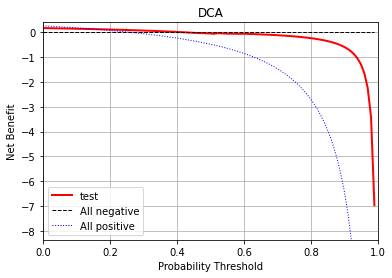

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


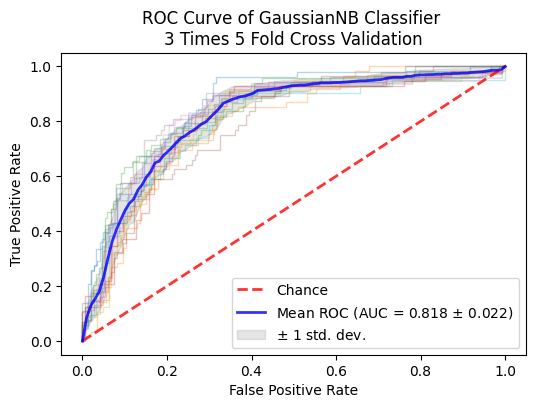

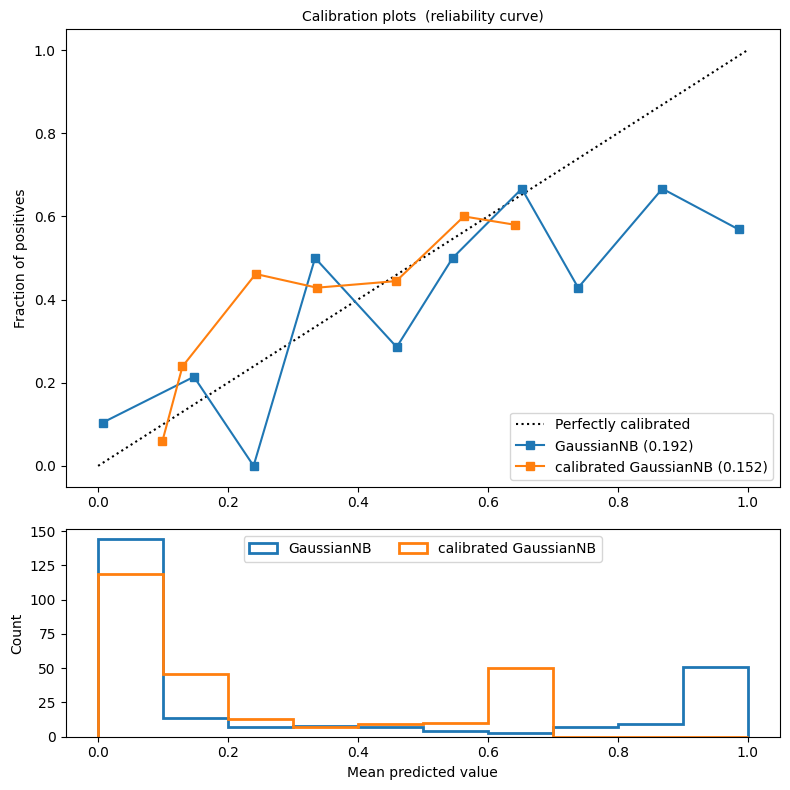

No handles with labels found to put in legend.


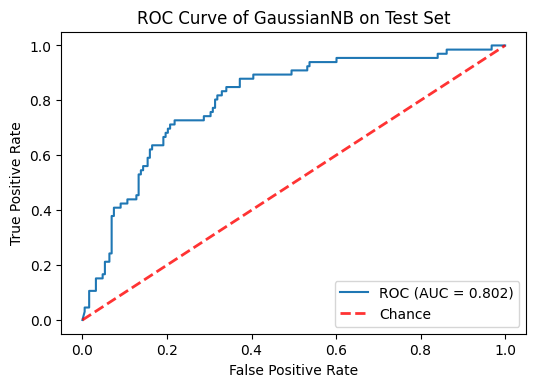

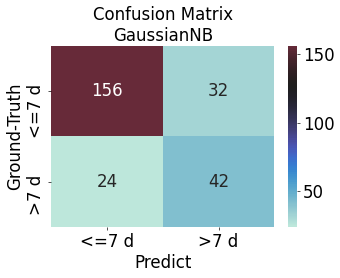

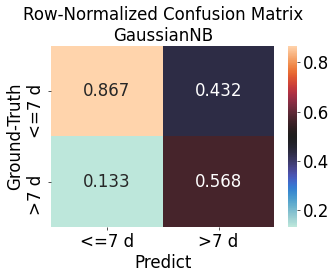

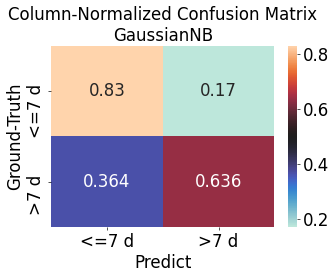

              precision    recall  f1-score   support

       <=7 d      0.867     0.830     0.848       188
        >7 d      0.568     0.636     0.600        66

    accuracy                          0.780       254
   macro avg      0.717     0.733     0.724       254
weighted avg      0.789     0.780     0.783       254

roc_auc: 0.802


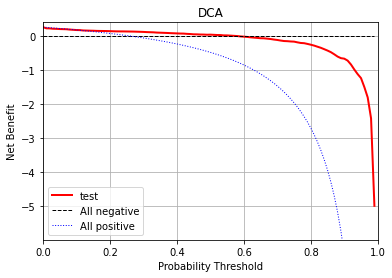

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


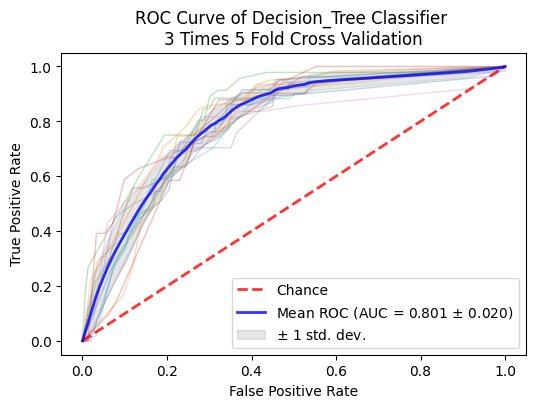

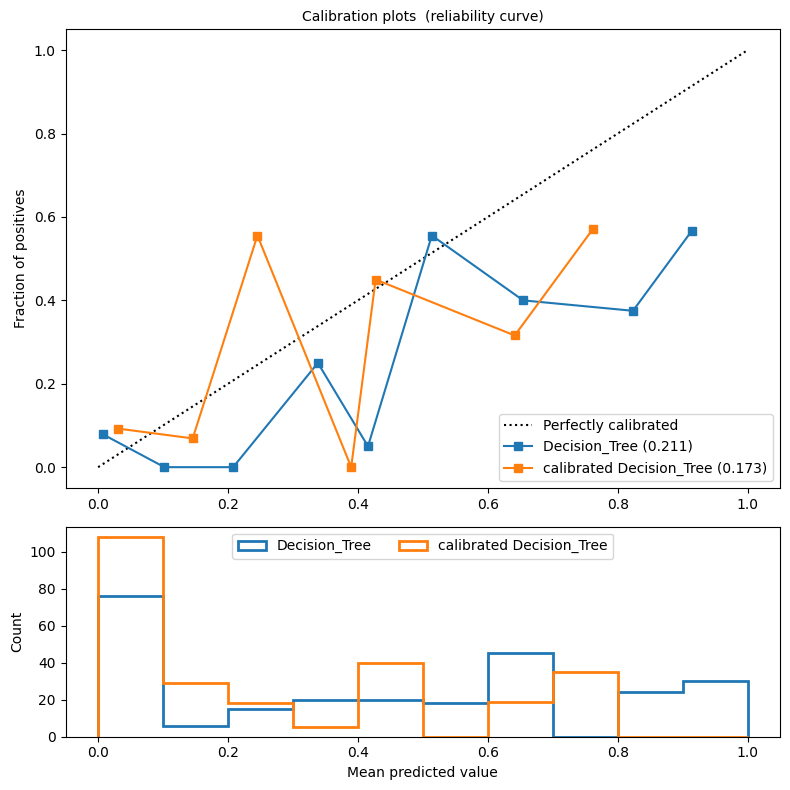

No handles with labels found to put in legend.


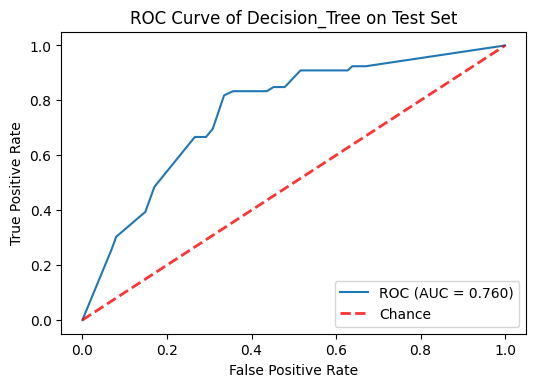

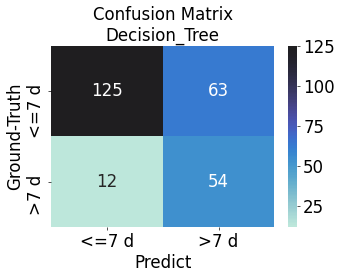

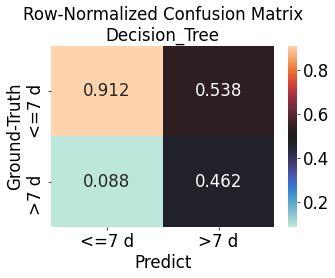

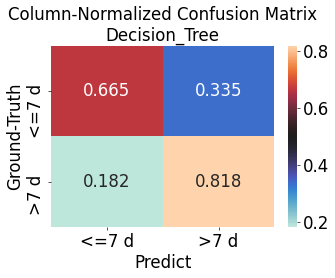

              precision    recall  f1-score   support

       <=7 d      0.912     0.665     0.769       188
        >7 d      0.462     0.818     0.590        66

    accuracy                          0.705       254
   macro avg      0.687     0.742     0.680       254
weighted avg      0.795     0.705     0.723       254

roc_auc: 0.76


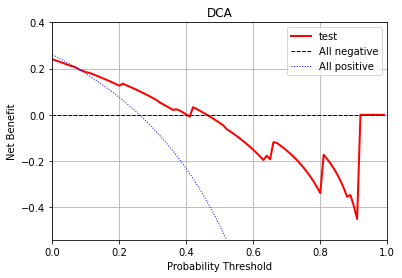

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


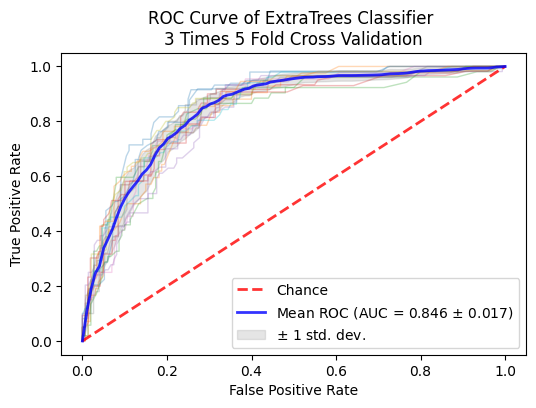

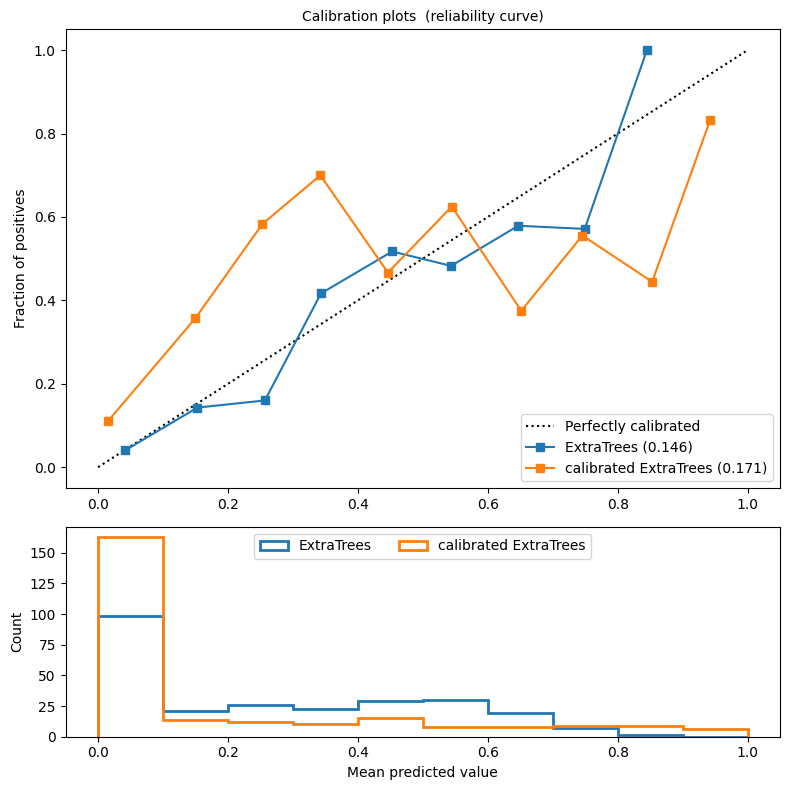

No handles with labels found to put in legend.


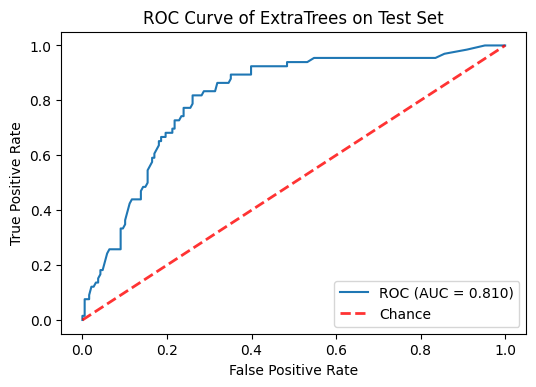

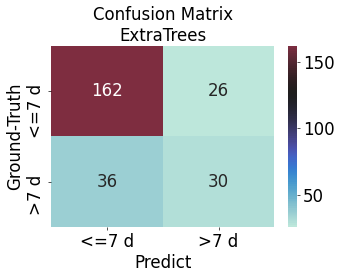

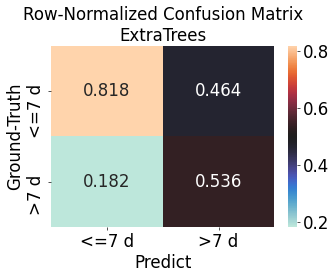

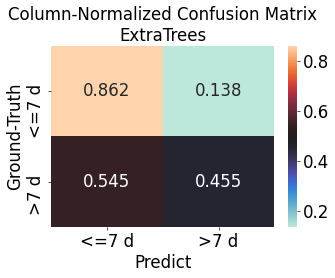

              precision    recall  f1-score   support

       <=7 d      0.818     0.862     0.839       188
        >7 d      0.536     0.455     0.492        66

    accuracy                          0.756       254
   macro avg      0.677     0.658     0.666       254
weighted avg      0.745     0.756     0.749       254

roc_auc: 0.81


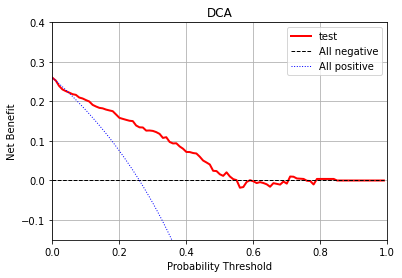

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


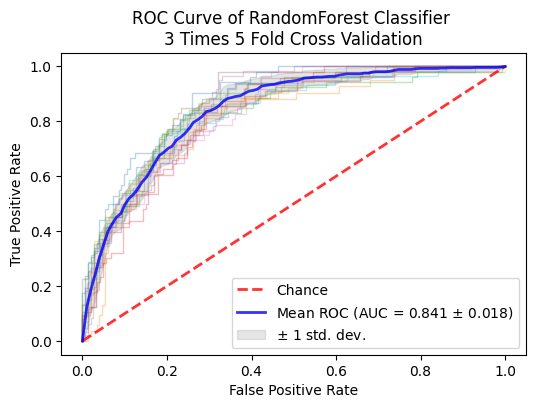

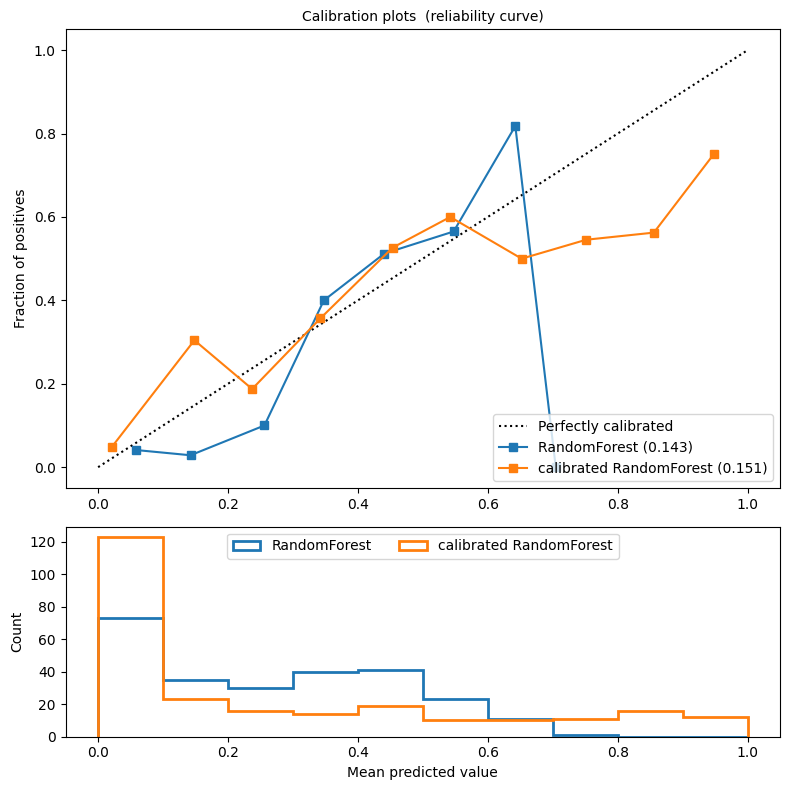

No handles with labels found to put in legend.


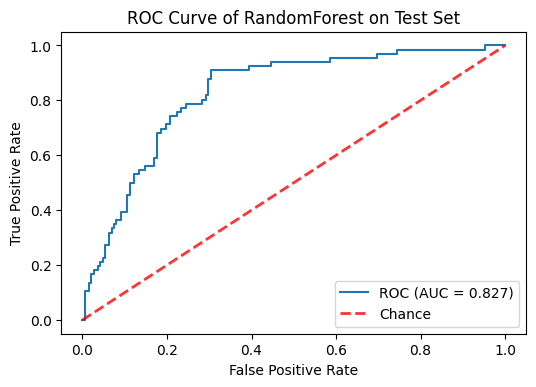

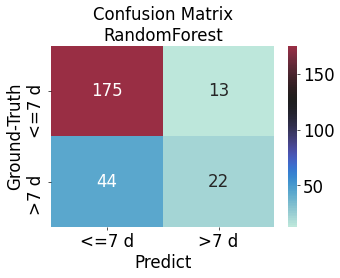

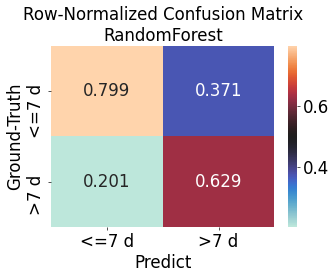

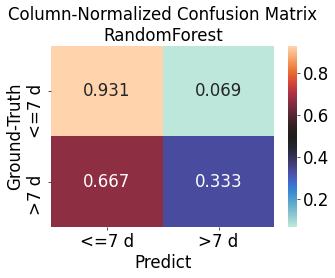

              precision    recall  f1-score   support

       <=7 d      0.799     0.931     0.860       188
        >7 d      0.629     0.333     0.436        66

    accuracy                          0.776       254
   macro avg      0.714     0.632     0.648       254
weighted avg      0.755     0.776     0.750       254

roc_auc: 0.827


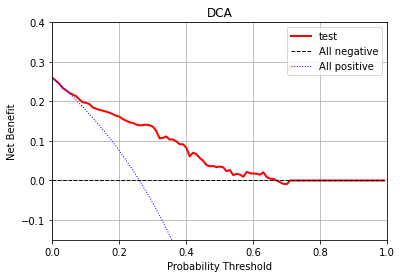

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


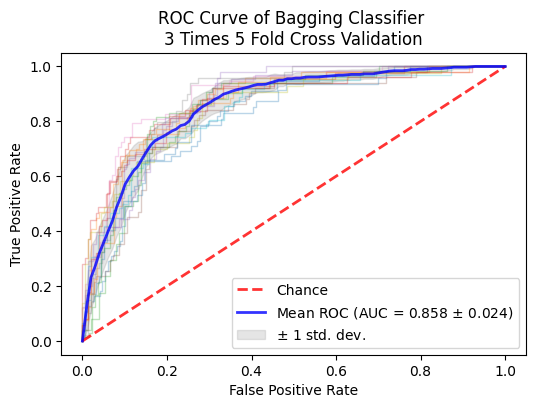

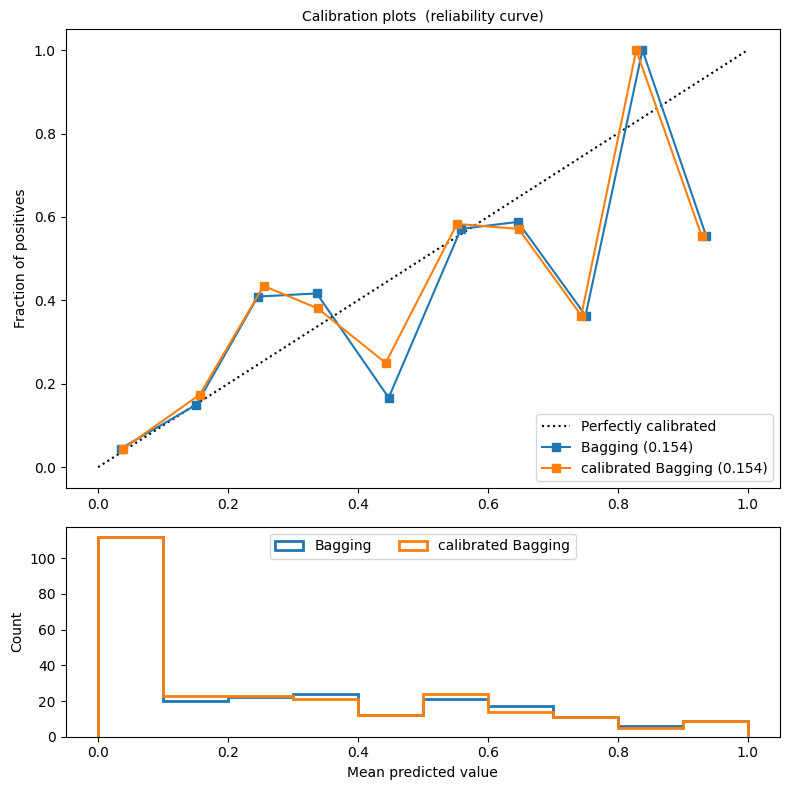

No handles with labels found to put in legend.


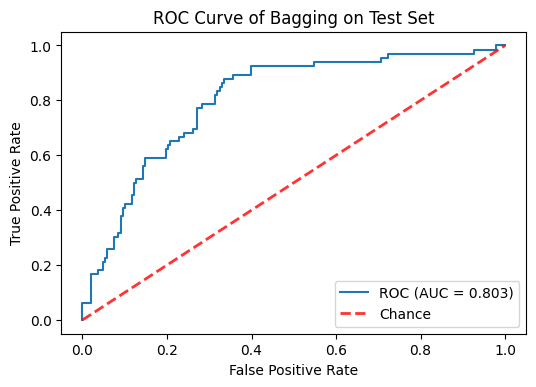

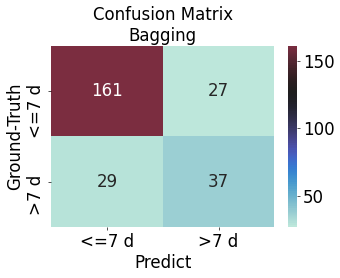

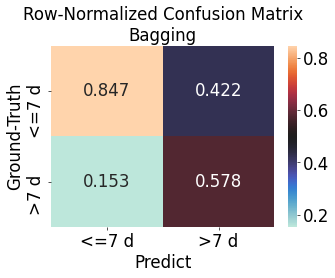

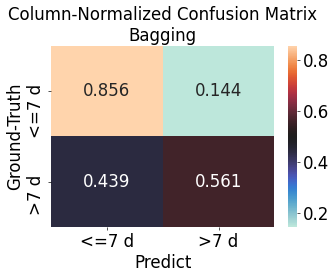

              precision    recall  f1-score   support

       <=7 d      0.847     0.856     0.852       188
        >7 d      0.578     0.561     0.569        66

    accuracy                          0.780       254
   macro avg      0.713     0.708     0.711       254
weighted avg      0.777     0.780     0.778       254

roc_auc: 0.803


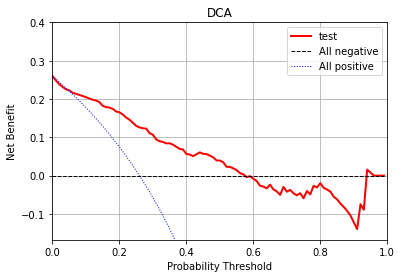

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


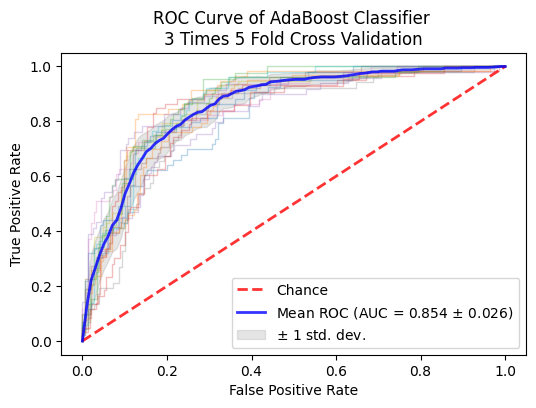

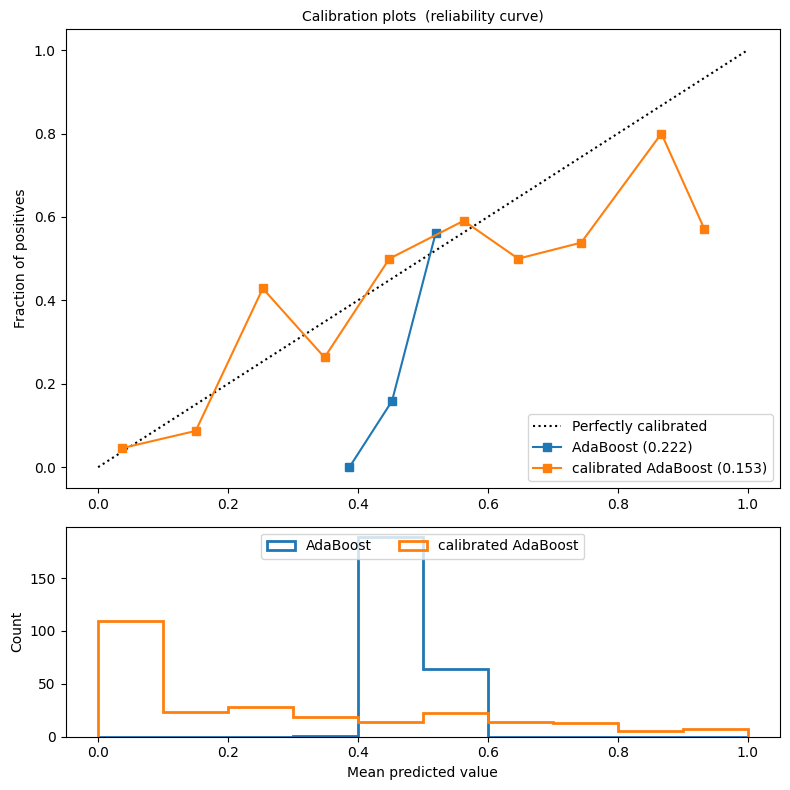

No handles with labels found to put in legend.


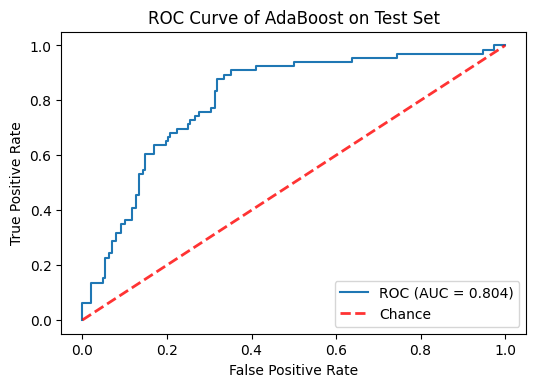

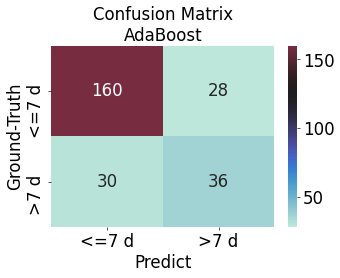

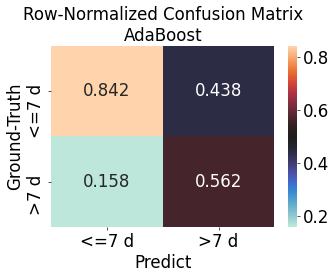

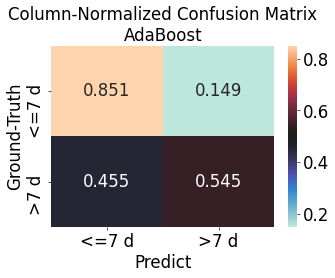

              precision    recall  f1-score   support

       <=7 d      0.842     0.851     0.847       188
        >7 d      0.562     0.545     0.554        66

    accuracy                          0.772       254
   macro avg      0.702     0.698     0.700       254
weighted avg      0.769     0.772     0.771       254

roc_auc: 0.804


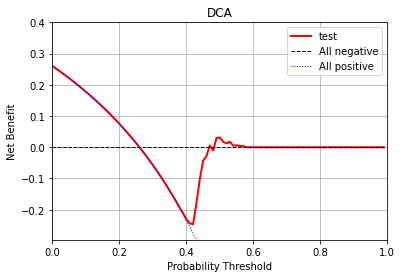

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


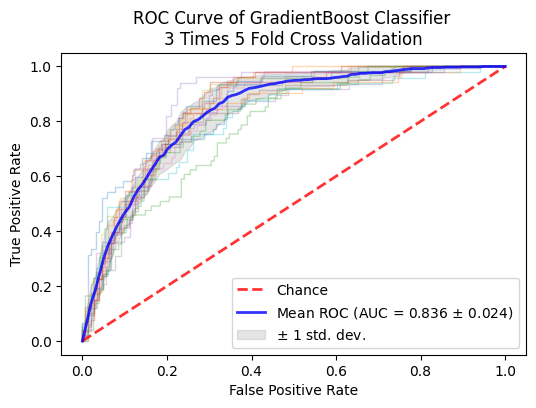

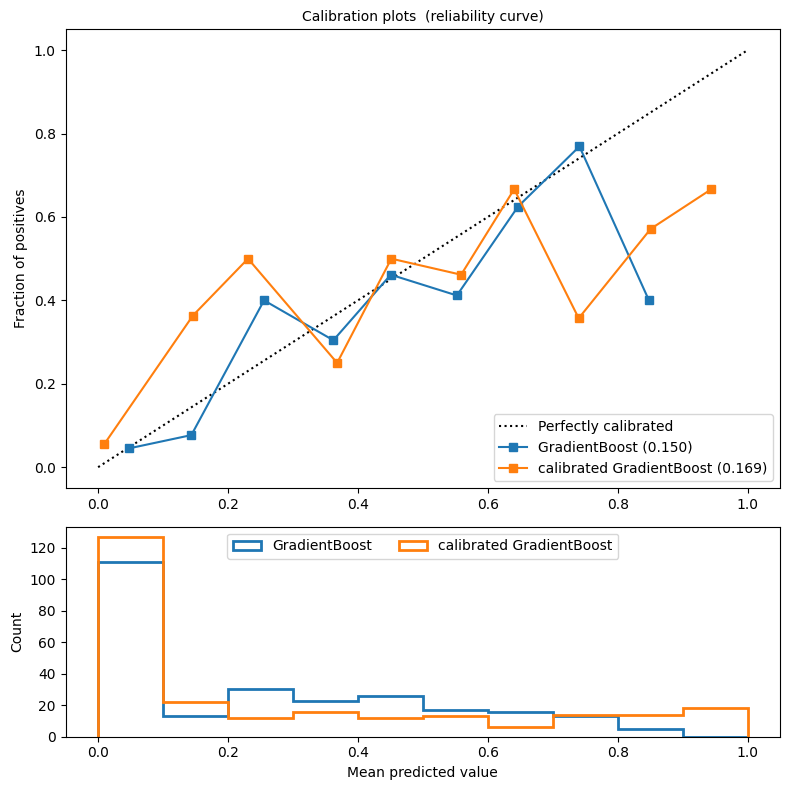

No handles with labels found to put in legend.


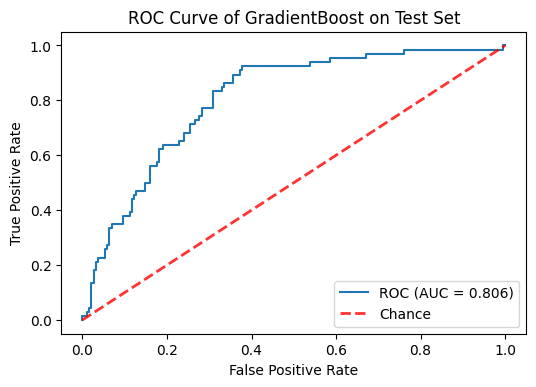

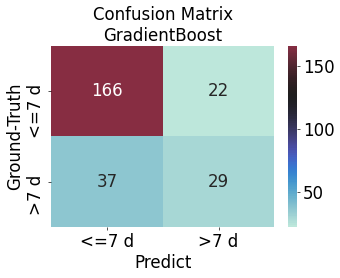

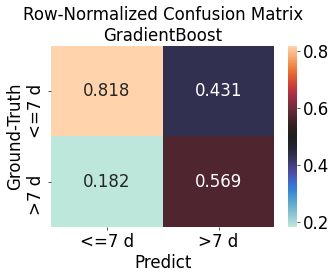

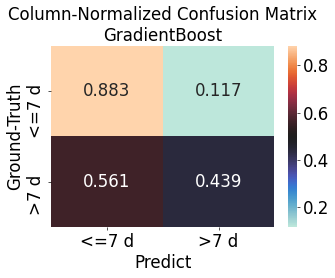

              precision    recall  f1-score   support

       <=7 d      0.818     0.883     0.849       188
        >7 d      0.569     0.439     0.496        66

    accuracy                          0.768       254
   macro avg      0.693     0.661     0.672       254
weighted avg      0.753     0.768     0.757       254

roc_auc: 0.806


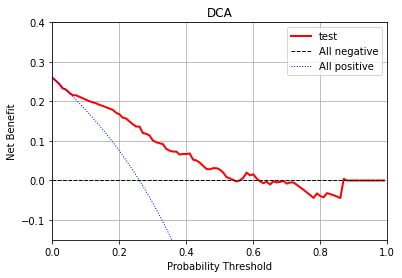

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


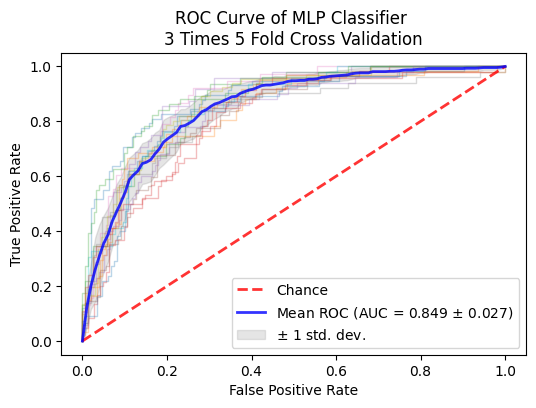

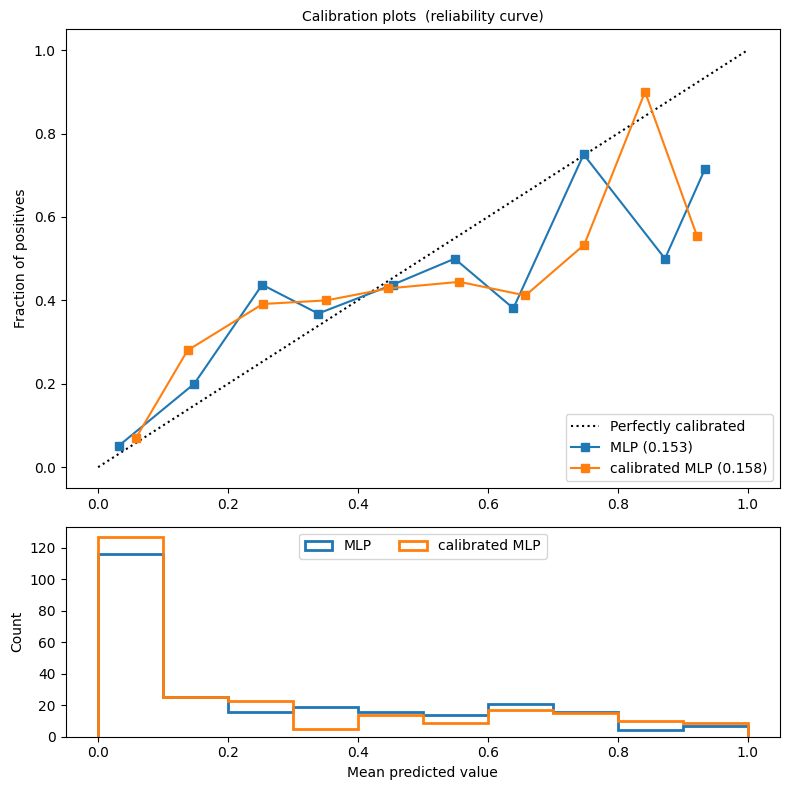

No handles with labels found to put in legend.


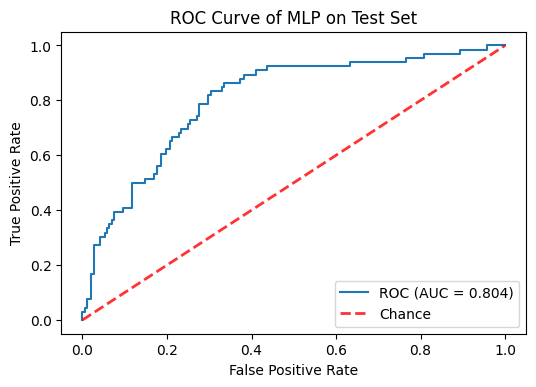

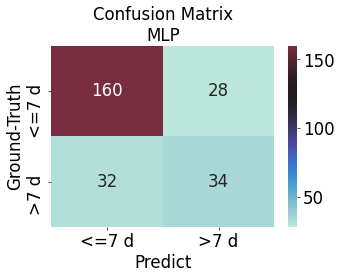

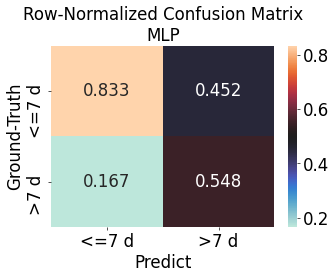

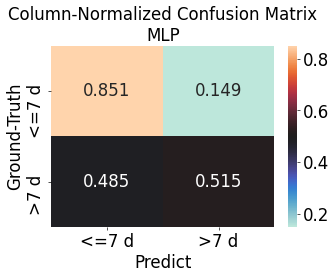

              precision    recall  f1-score   support

       <=7 d      0.833     0.851     0.842       188
        >7 d      0.548     0.515     0.531        66

    accuracy                          0.764       254
   macro avg      0.691     0.683     0.687       254
weighted avg      0.759     0.764     0.761       254

roc_auc: 0.804


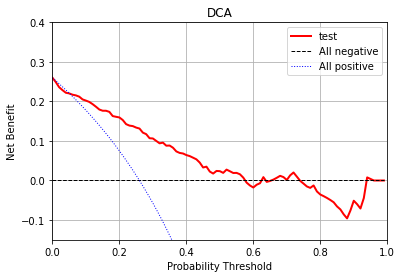

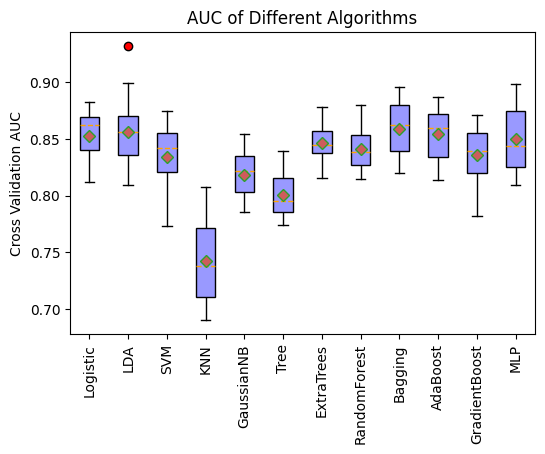

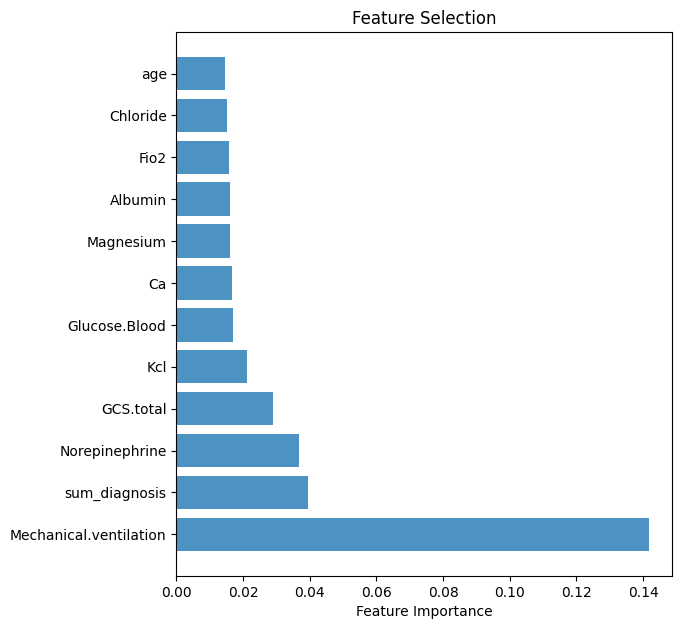

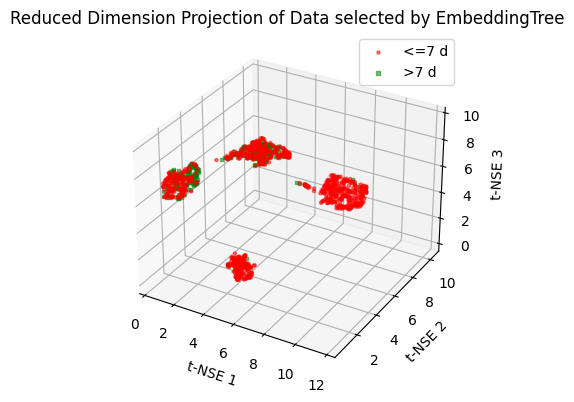

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


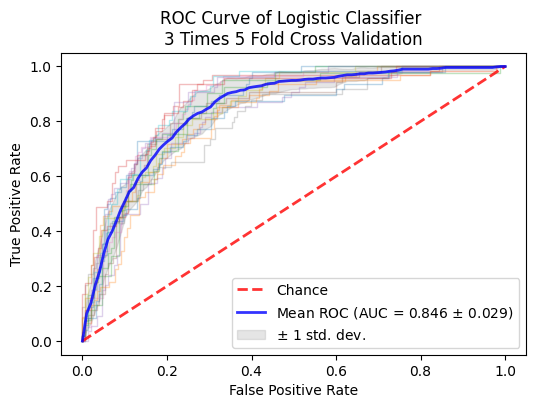

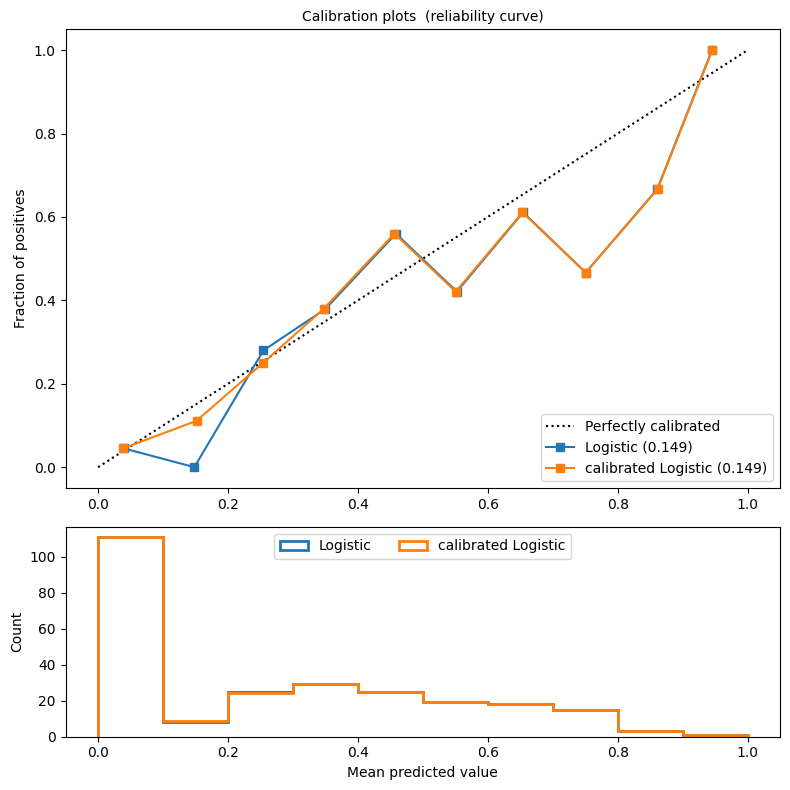

No handles with labels found to put in legend.


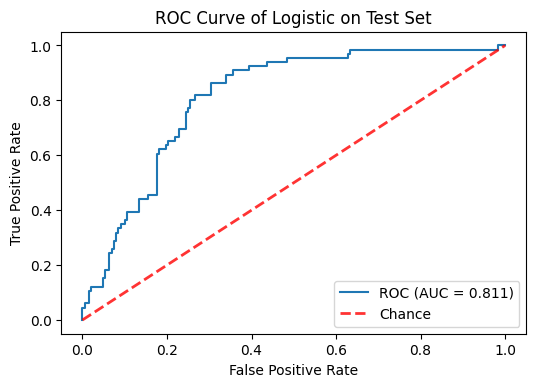

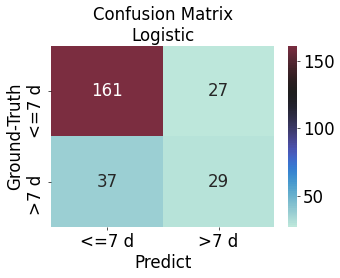

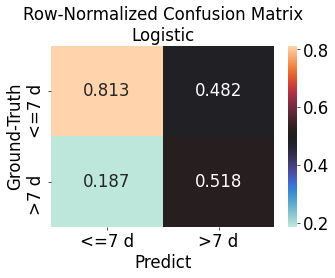

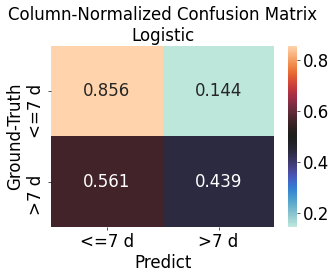

              precision    recall  f1-score   support

       <=7 d      0.813     0.856     0.834       188
        >7 d      0.518     0.439     0.475        66

    accuracy                          0.748       254
   macro avg      0.665     0.648     0.655       254
weighted avg      0.736     0.748     0.741       254

roc_auc: 0.811


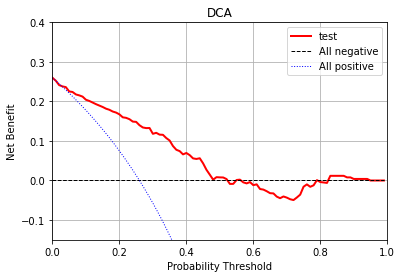

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


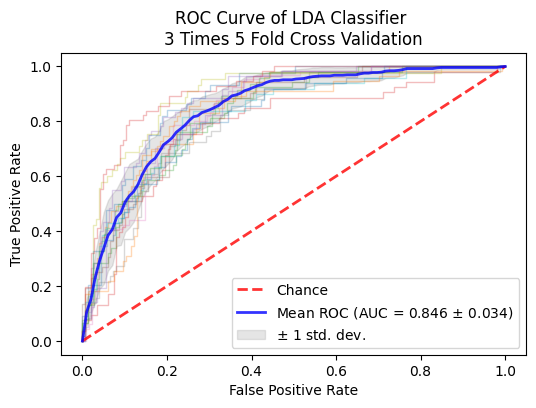

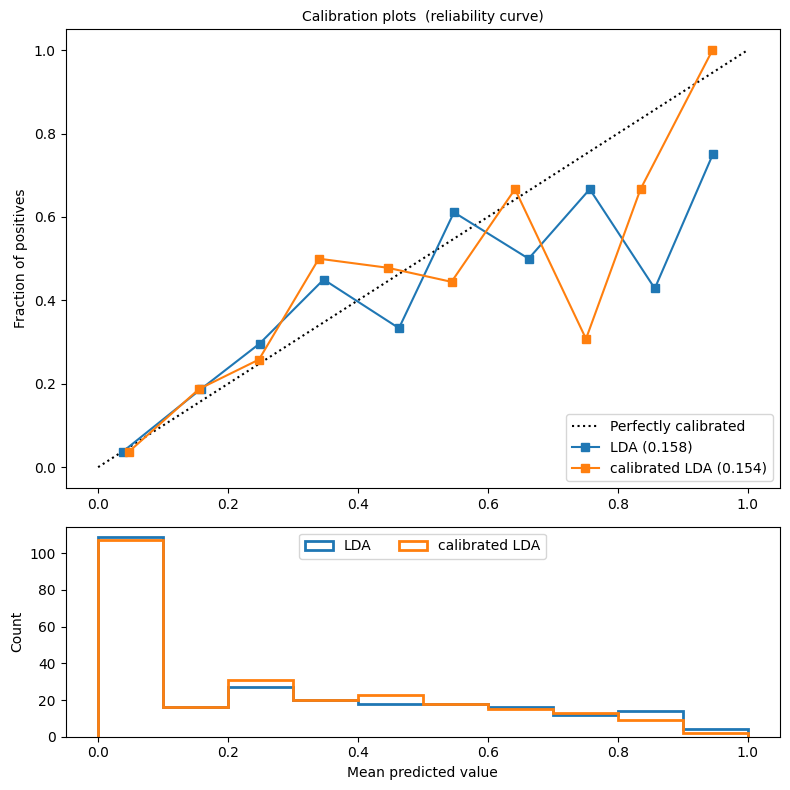

No handles with labels found to put in legend.


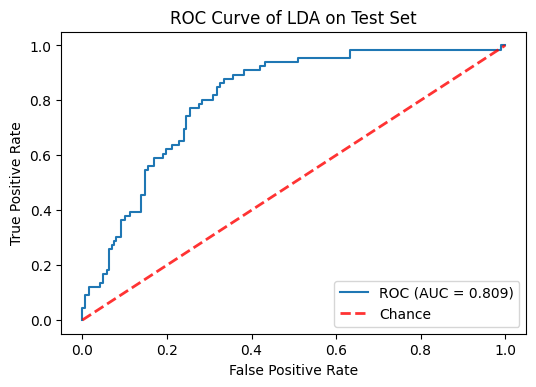

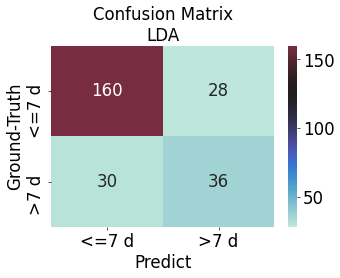

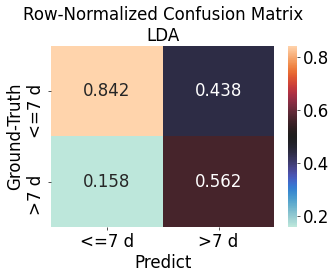

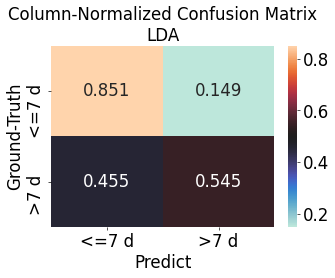

              precision    recall  f1-score   support

       <=7 d      0.842     0.851     0.847       188
        >7 d      0.562     0.545     0.554        66

    accuracy                          0.772       254
   macro avg      0.702     0.698     0.700       254
weighted avg      0.769     0.772     0.771       254

roc_auc: 0.809


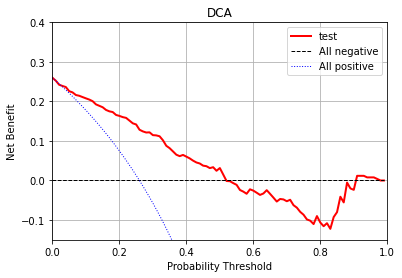

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


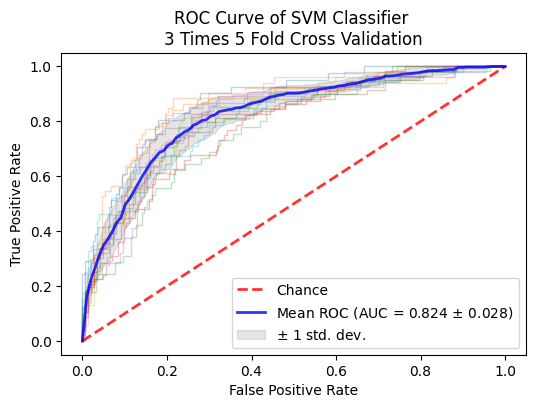

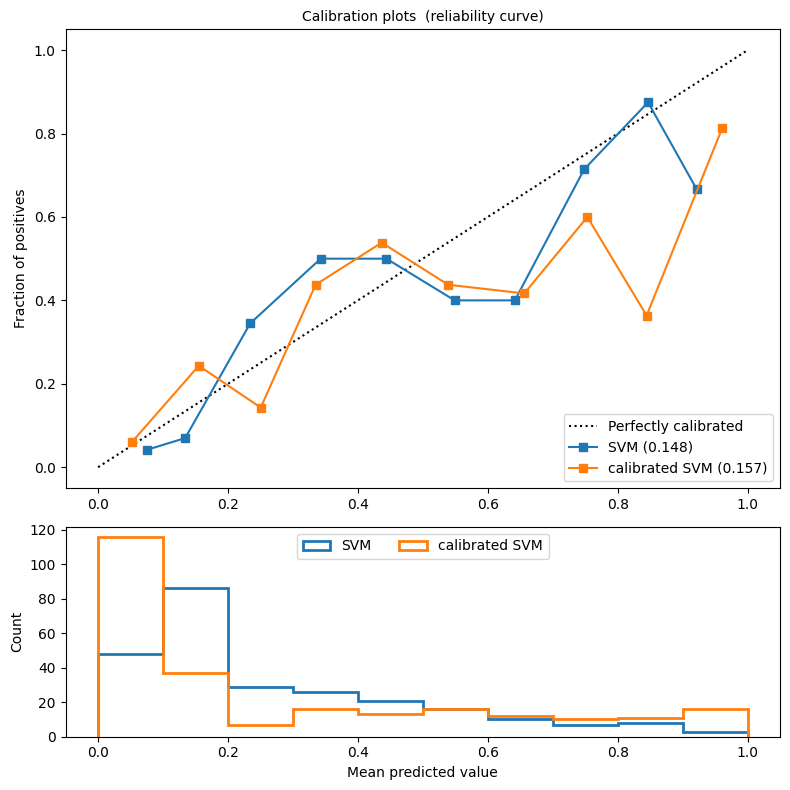

No handles with labels found to put in legend.


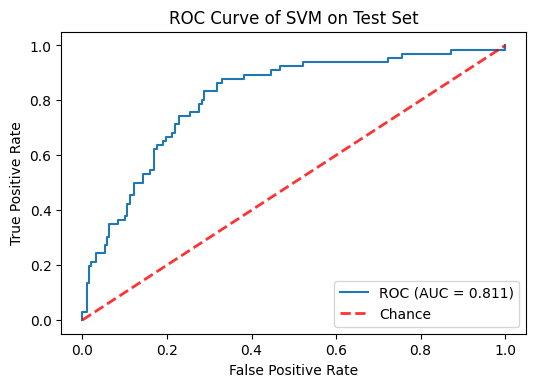

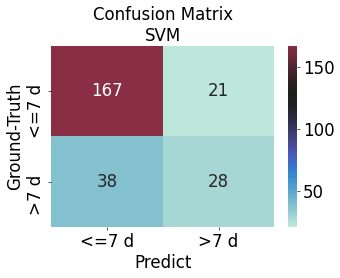

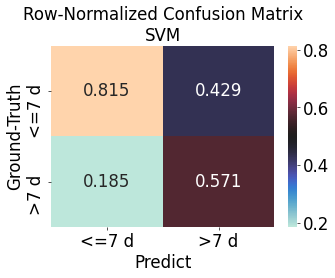

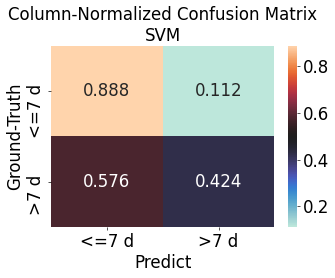

              precision    recall  f1-score   support

       <=7 d      0.815     0.888     0.850       188
        >7 d      0.571     0.424     0.487        66

    accuracy                          0.768       254
   macro avg      0.693     0.656     0.668       254
weighted avg      0.751     0.768     0.756       254

roc_auc: 0.811


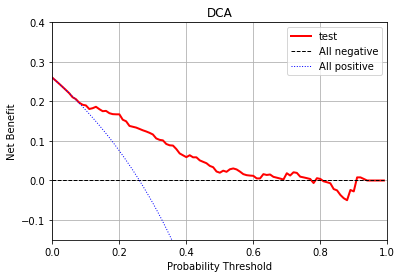

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


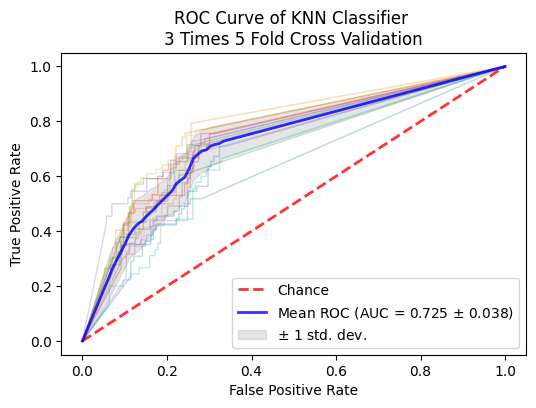

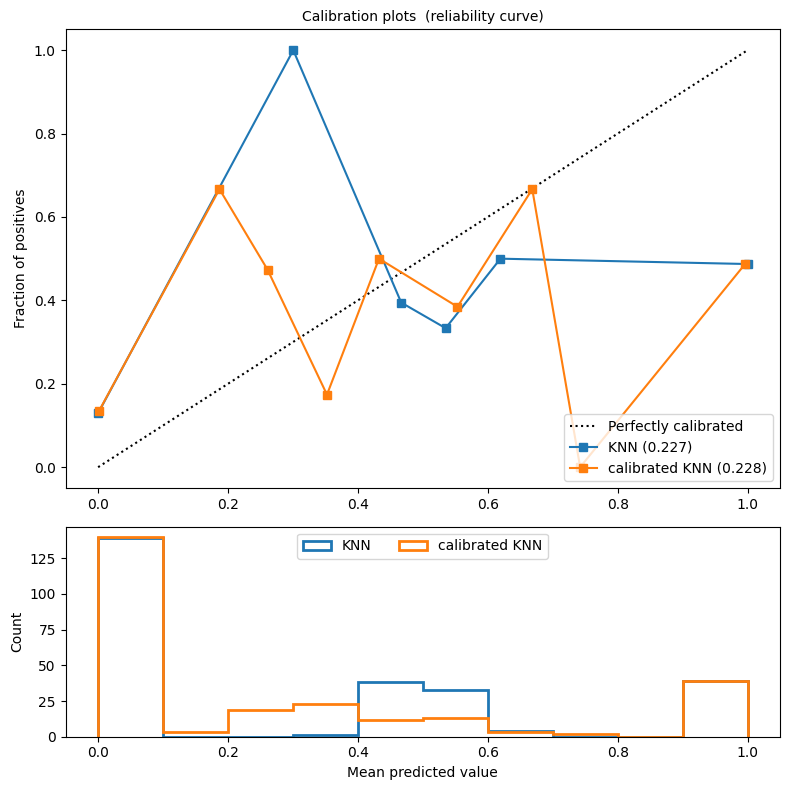

No handles with labels found to put in legend.


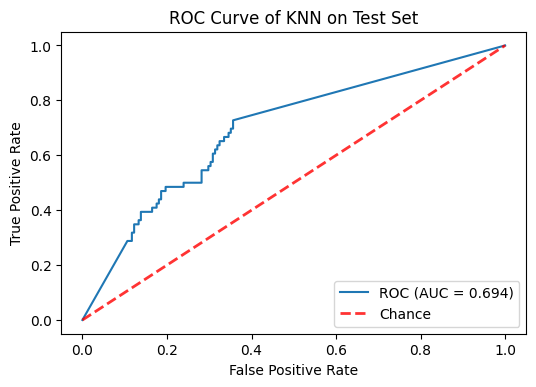

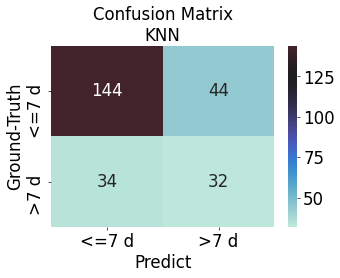

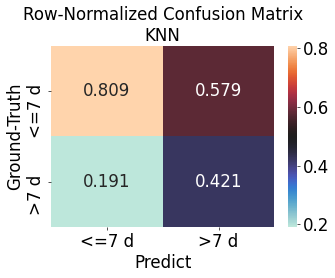

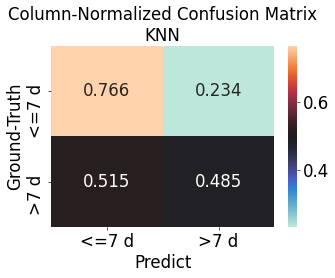

              precision    recall  f1-score   support

       <=7 d      0.809     0.766     0.787       188
        >7 d      0.421     0.485     0.451        66

    accuracy                          0.693       254
   macro avg      0.615     0.625     0.619       254
weighted avg      0.708     0.693     0.700       254

roc_auc: 0.694


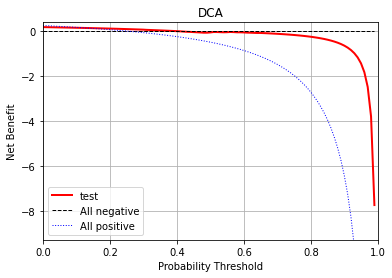

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


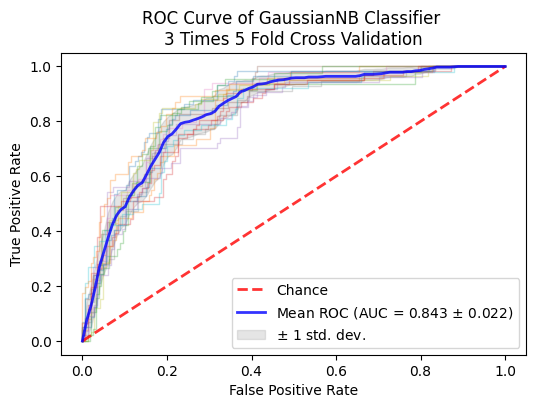

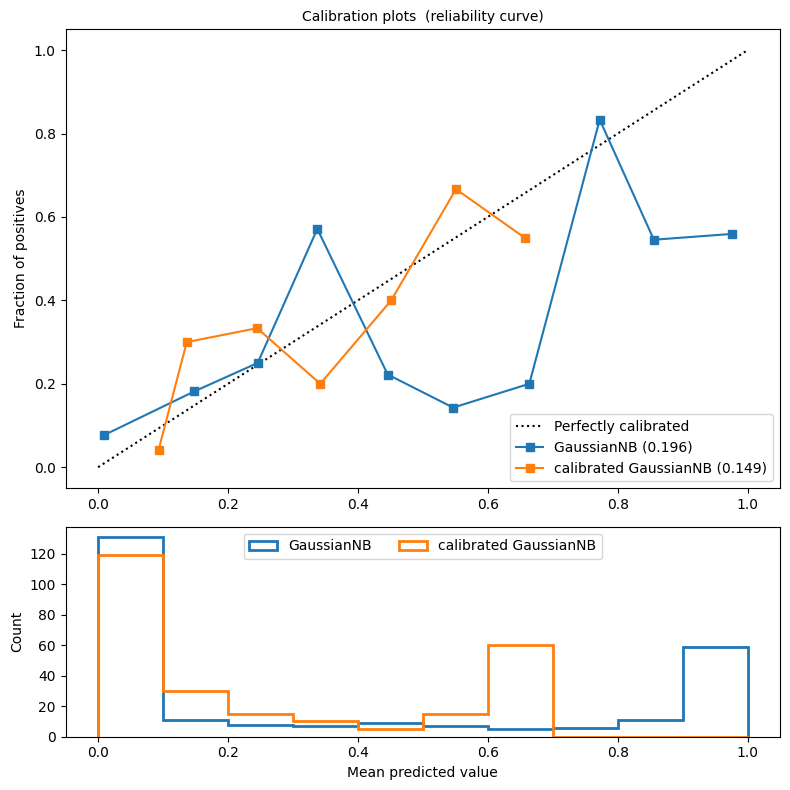

No handles with labels found to put in legend.


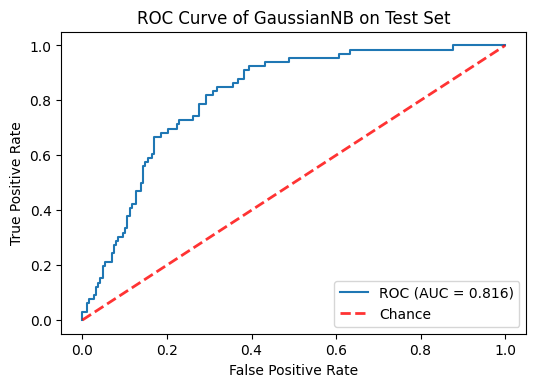

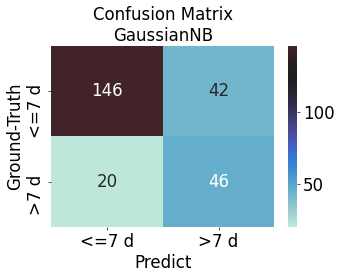

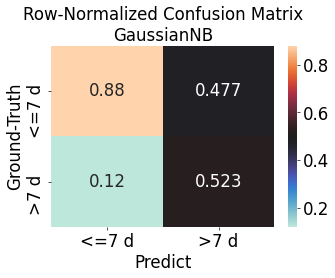

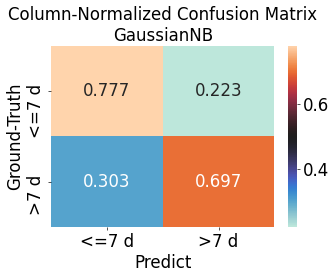

              precision    recall  f1-score   support

       <=7 d      0.880     0.777     0.825       188
        >7 d      0.523     0.697     0.597        66

    accuracy                          0.756       254
   macro avg      0.701     0.737     0.711       254
weighted avg      0.787     0.756     0.766       254

roc_auc: 0.816


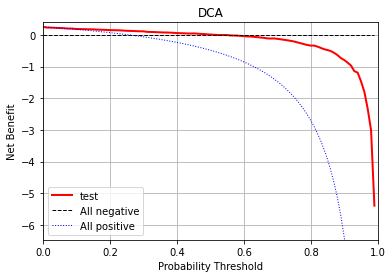

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


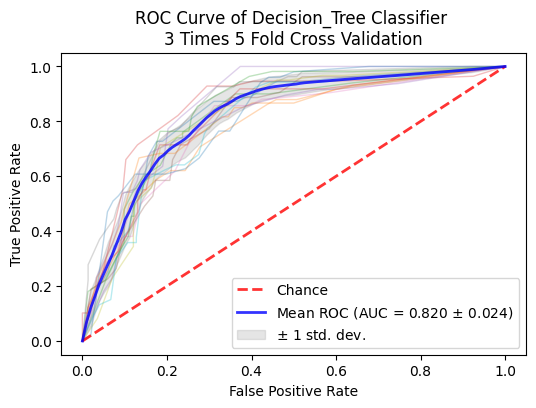

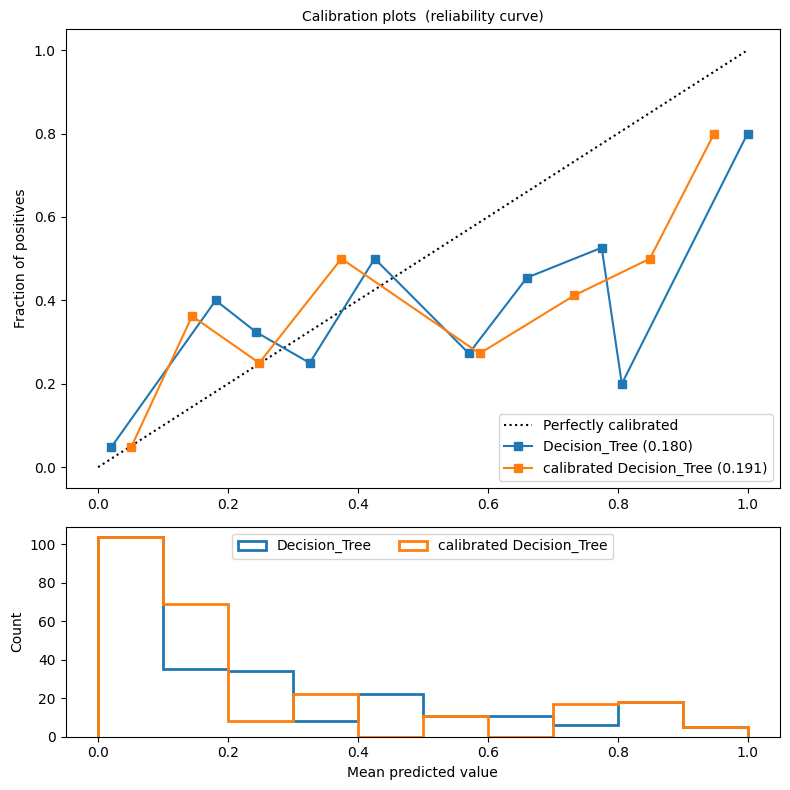

No handles with labels found to put in legend.


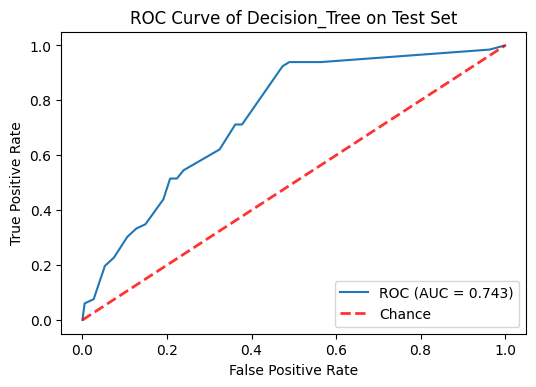

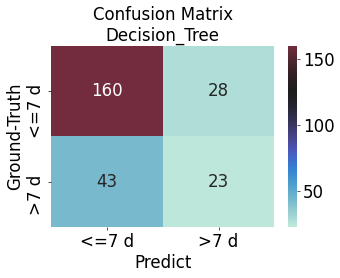

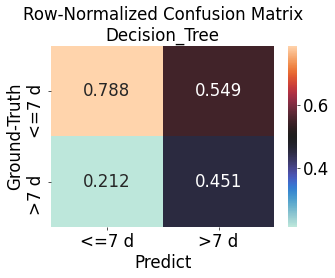

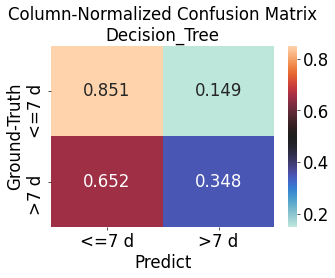

              precision    recall  f1-score   support

       <=7 d      0.788     0.851     0.818       188
        >7 d      0.451     0.348     0.393        66

    accuracy                          0.720       254
   macro avg      0.620     0.600     0.606       254
weighted avg      0.701     0.720     0.708       254

roc_auc: 0.743


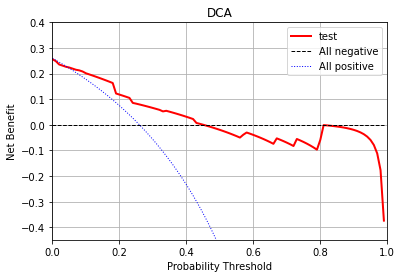

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


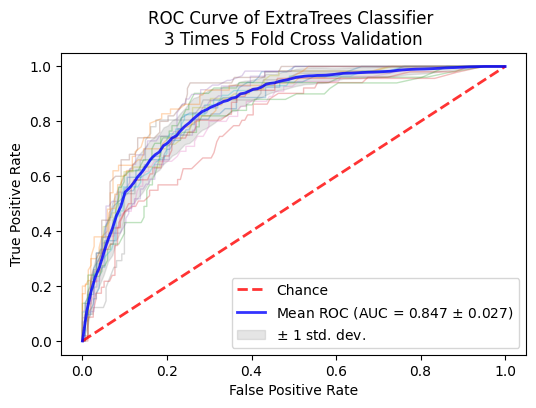

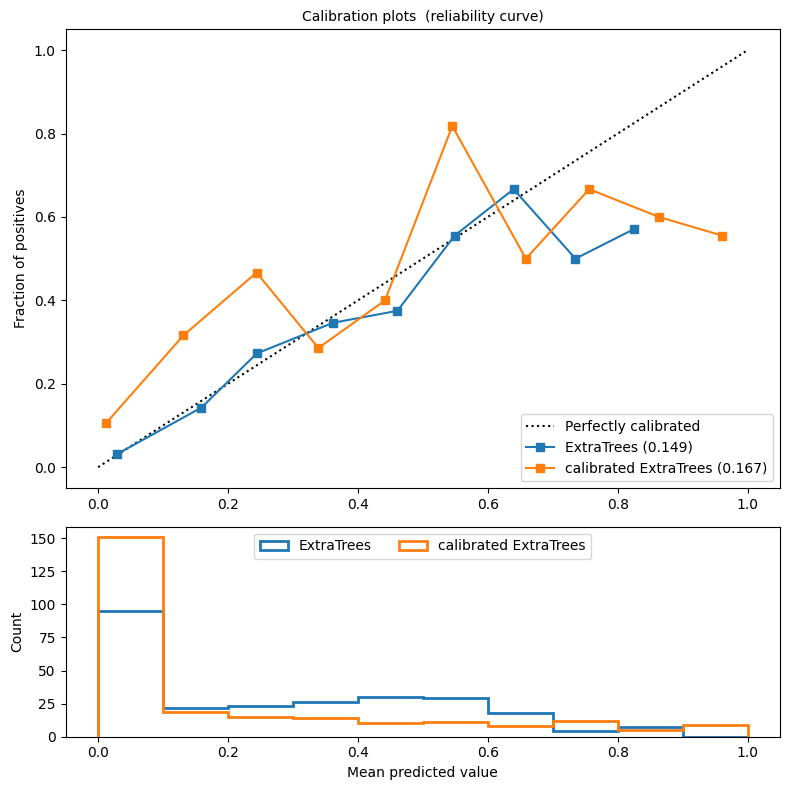

No handles with labels found to put in legend.


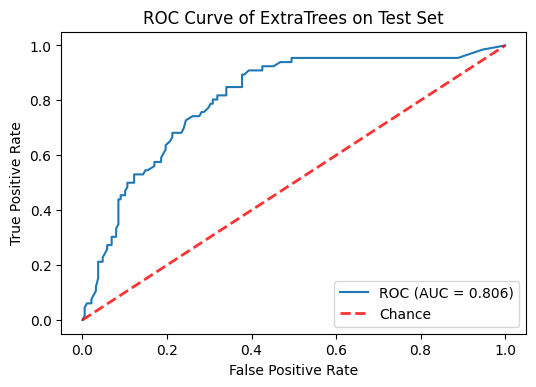

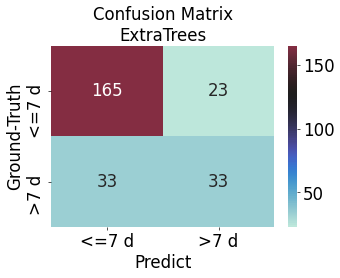

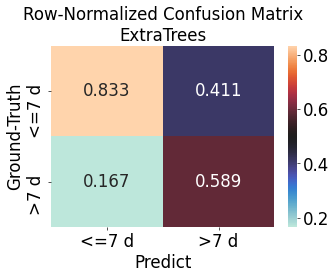

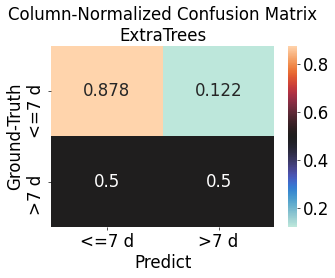

              precision    recall  f1-score   support

       <=7 d      0.833     0.878     0.855       188
        >7 d      0.589     0.500     0.541        66

    accuracy                          0.780       254
   macro avg      0.711     0.689     0.698       254
weighted avg      0.770     0.780     0.773       254

roc_auc: 0.806


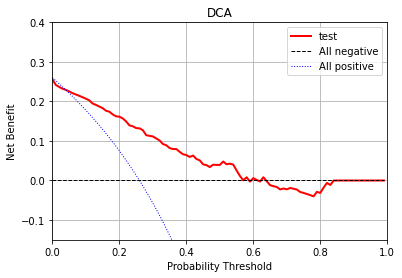

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


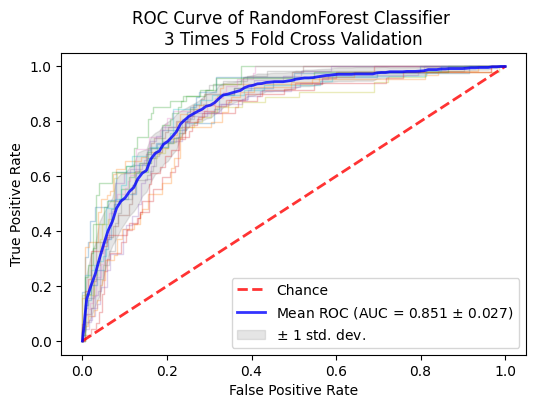

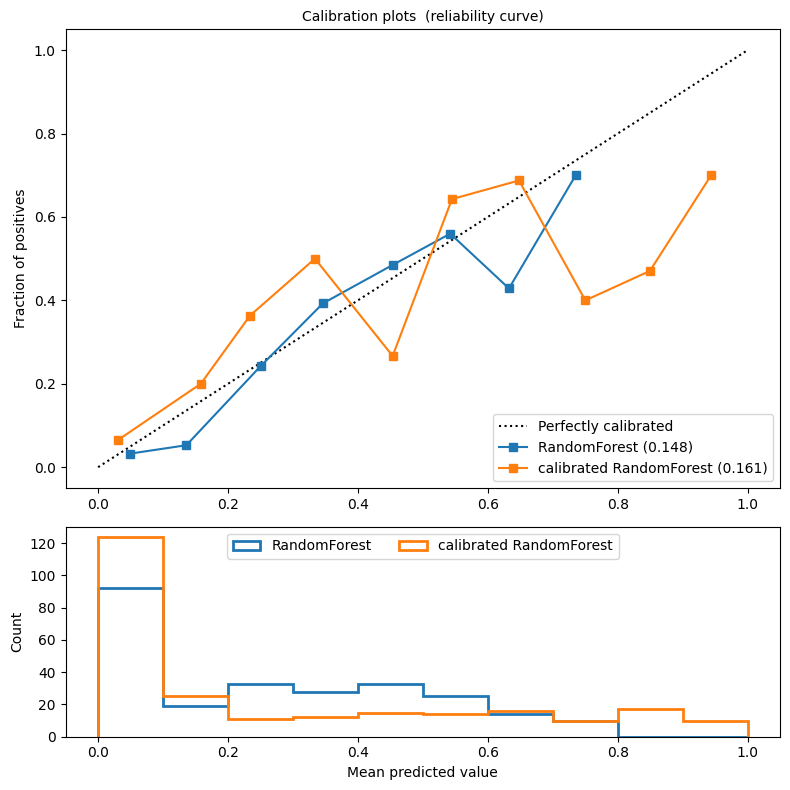

No handles with labels found to put in legend.


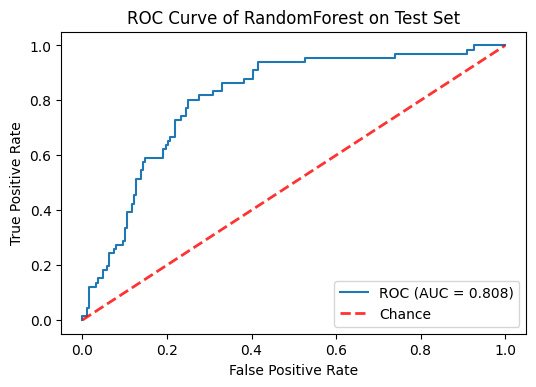

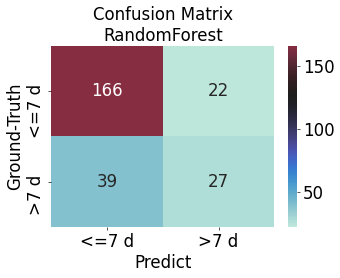

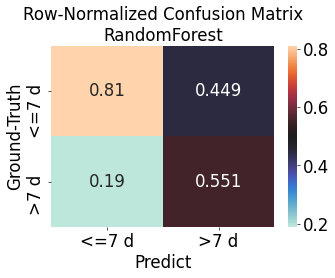

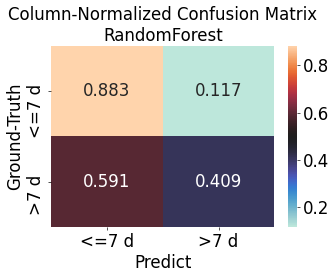

              precision    recall  f1-score   support

       <=7 d      0.810     0.883     0.845       188
        >7 d      0.551     0.409     0.470        66

    accuracy                          0.760       254
   macro avg      0.680     0.646     0.657       254
weighted avg      0.743     0.760     0.747       254

roc_auc: 0.808


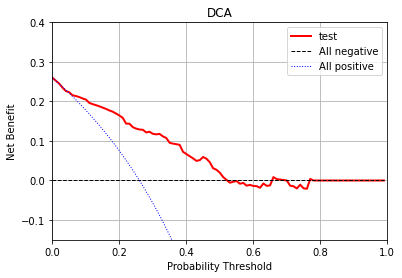

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


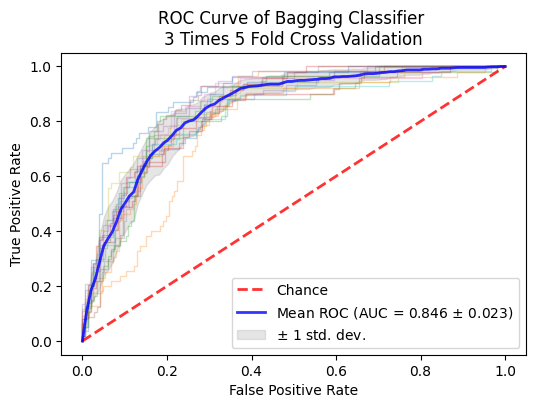

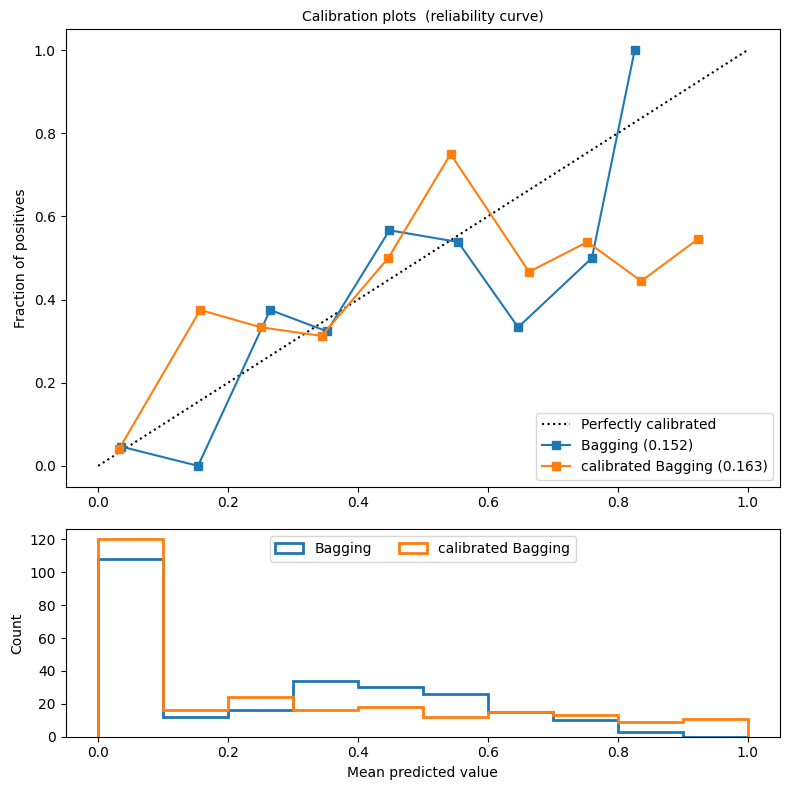

No handles with labels found to put in legend.


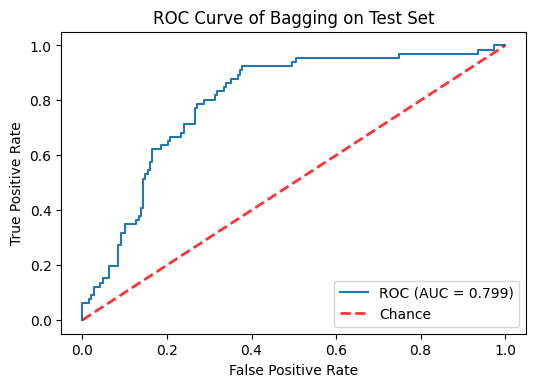

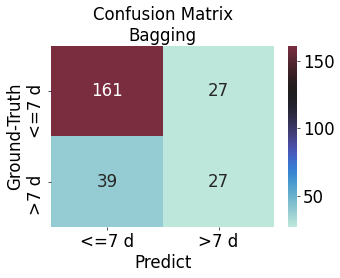

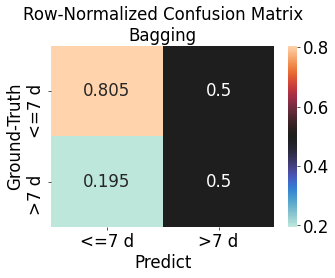

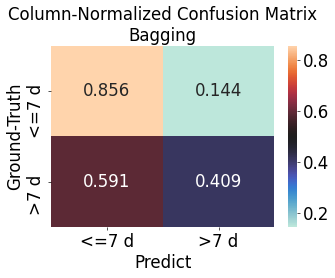

              precision    recall  f1-score   support

       <=7 d      0.805     0.856     0.830       188
        >7 d      0.500     0.409     0.450        66

    accuracy                          0.740       254
   macro avg      0.653     0.633     0.640       254
weighted avg      0.726     0.740     0.731       254

roc_auc: 0.799


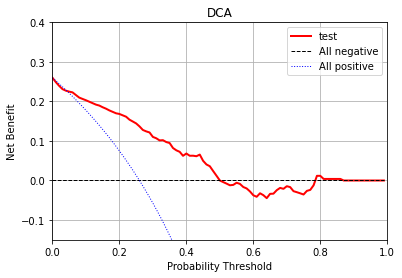

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


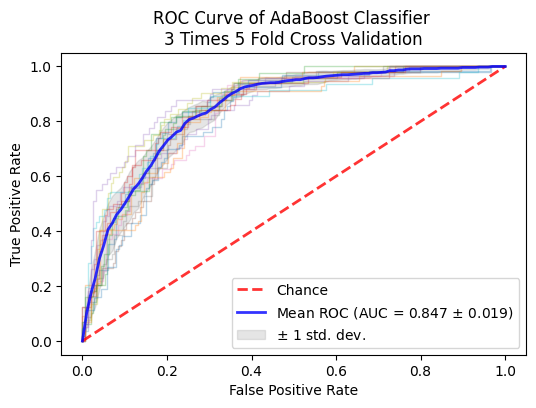

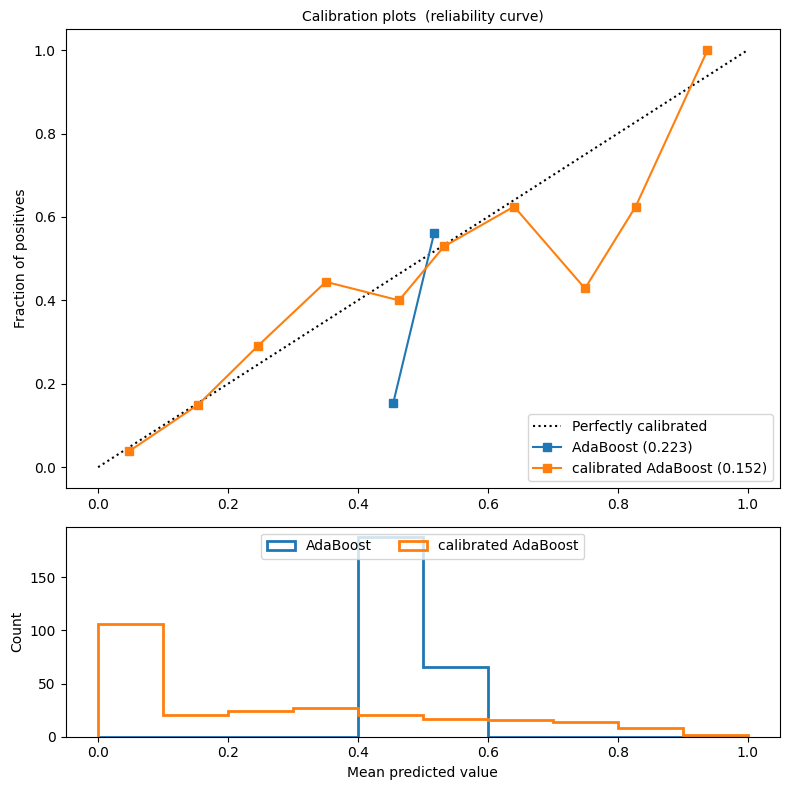

No handles with labels found to put in legend.


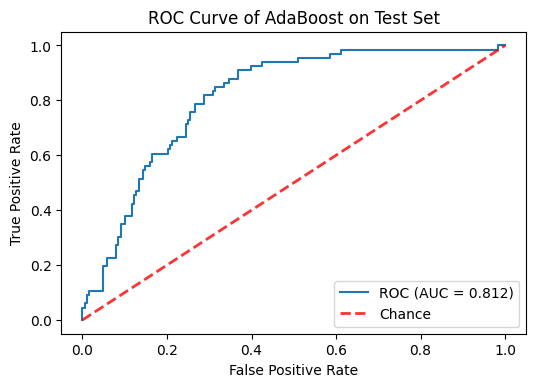

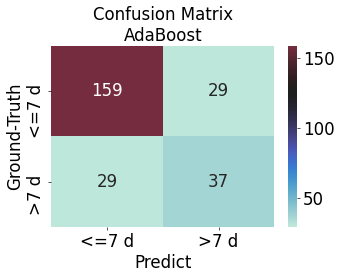

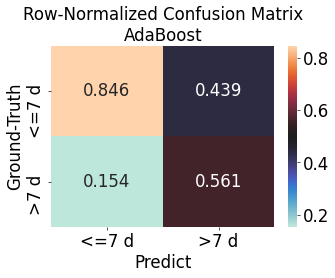

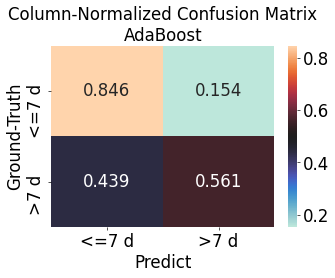

              precision    recall  f1-score   support

       <=7 d      0.846     0.846     0.846       188
        >7 d      0.561     0.561     0.561        66

    accuracy                          0.772       254
   macro avg      0.703     0.703     0.703       254
weighted avg      0.772     0.772     0.772       254

roc_auc: 0.812


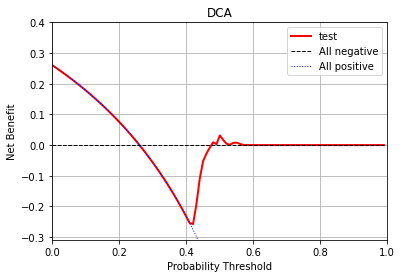

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


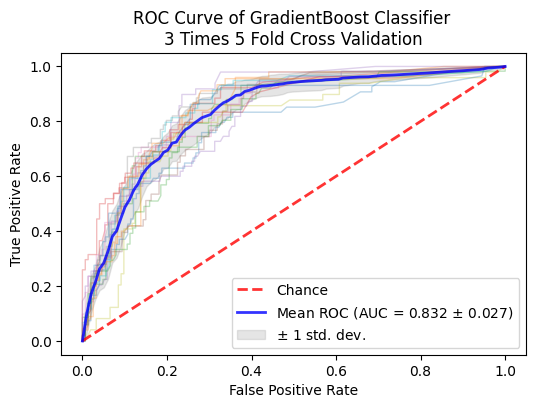

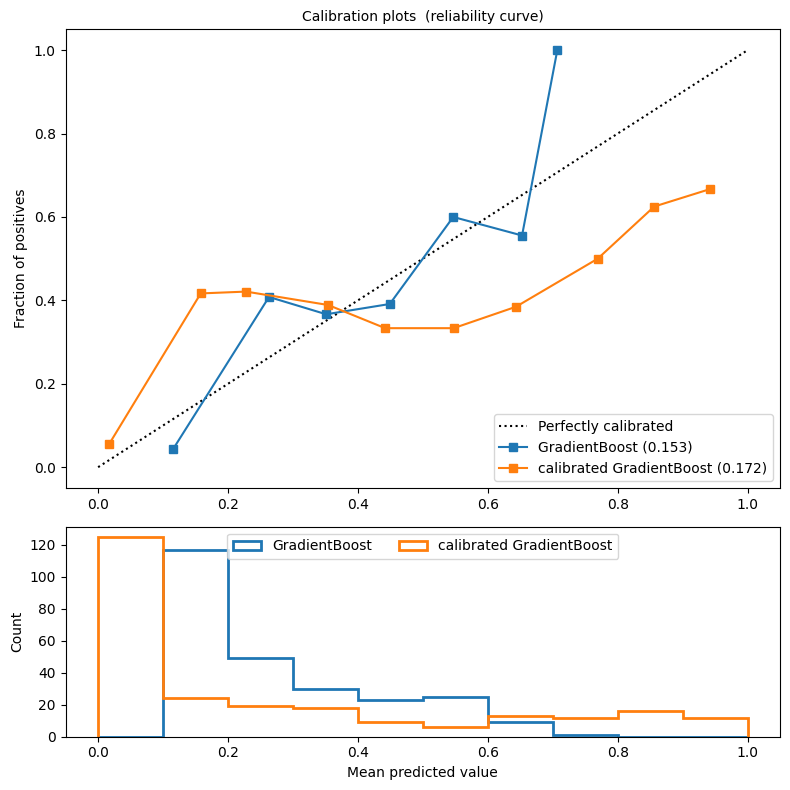

No handles with labels found to put in legend.


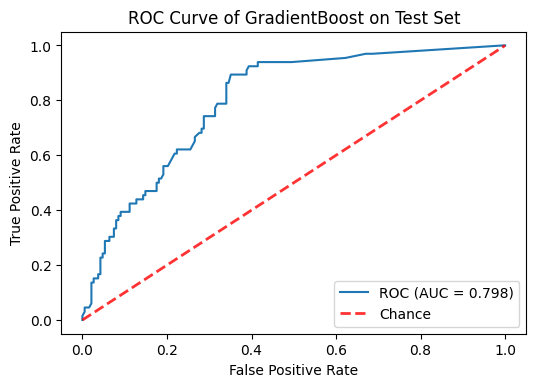

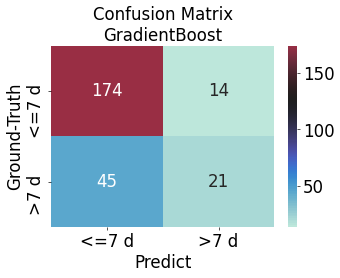

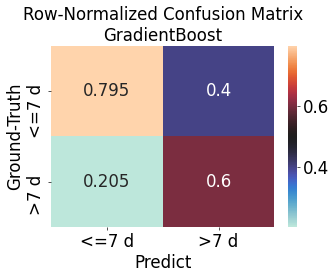

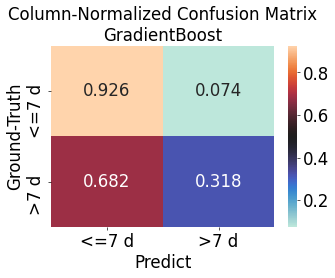

              precision    recall  f1-score   support

       <=7 d      0.795     0.926     0.855       188
        >7 d      0.600     0.318     0.416        66

    accuracy                          0.768       254
   macro avg      0.697     0.622     0.635       254
weighted avg      0.744     0.768     0.741       254

roc_auc: 0.798


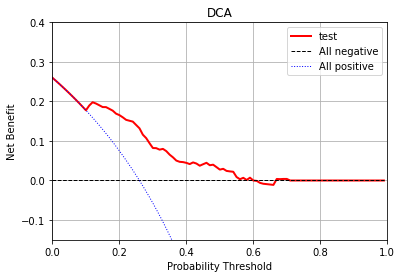

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


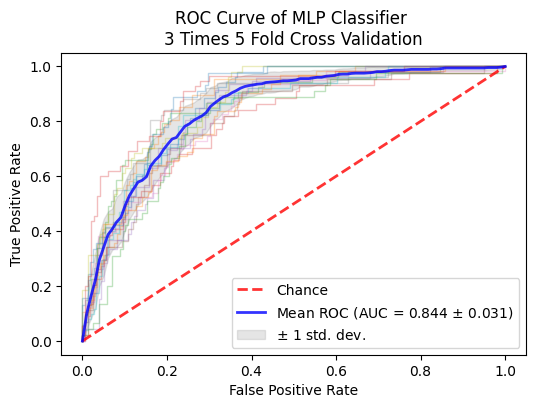

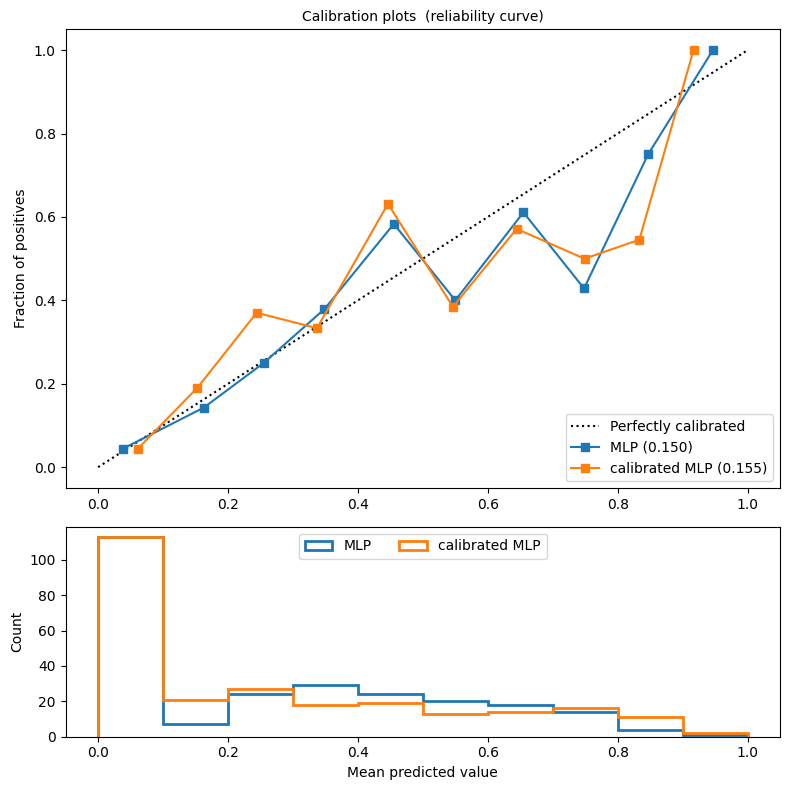

No handles with labels found to put in legend.


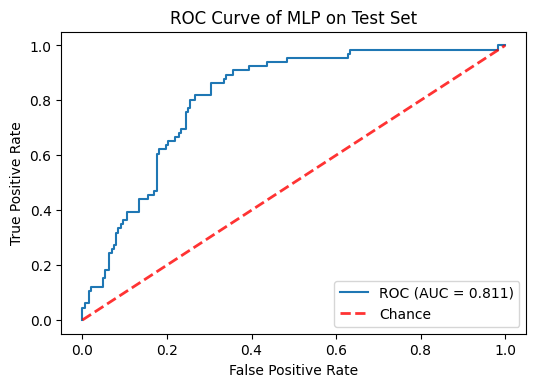

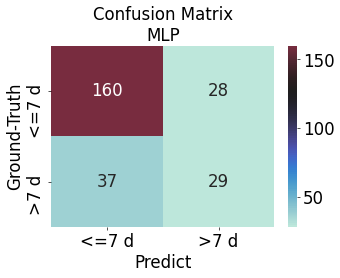

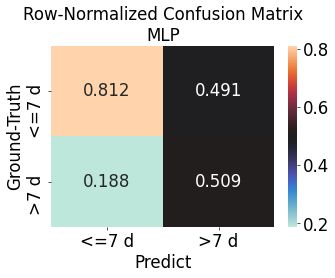

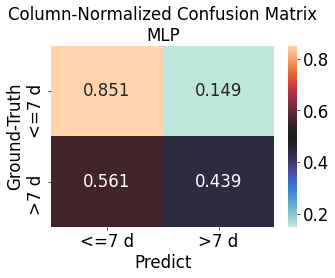

              precision    recall  f1-score   support

       <=7 d      0.812     0.851     0.831       188
        >7 d      0.509     0.439     0.472        66

    accuracy                          0.744       254
   macro avg      0.660     0.645     0.651       254
weighted avg      0.733     0.744     0.738       254

roc_auc: 0.811


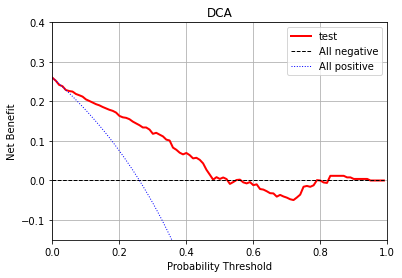

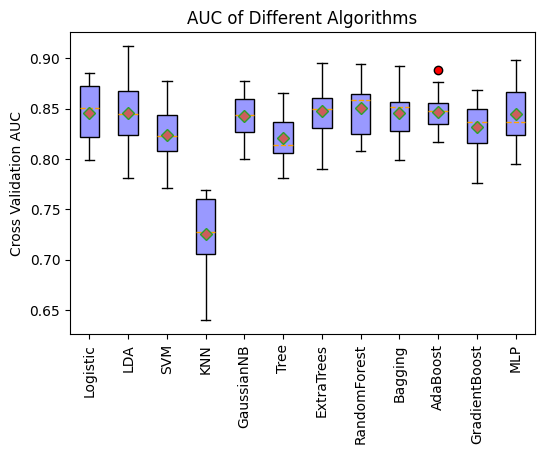

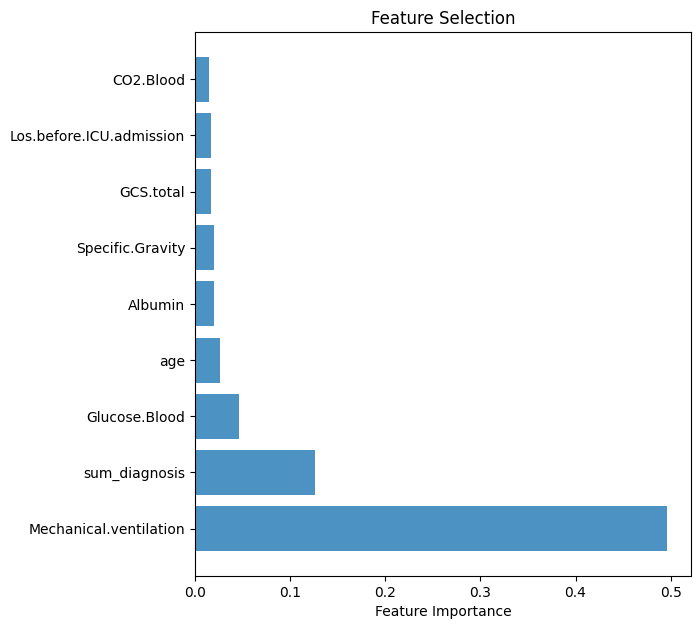

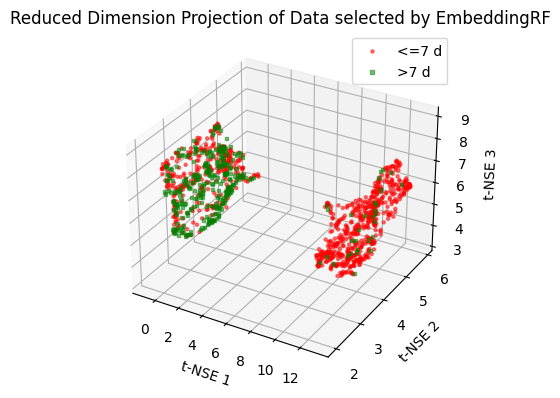

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


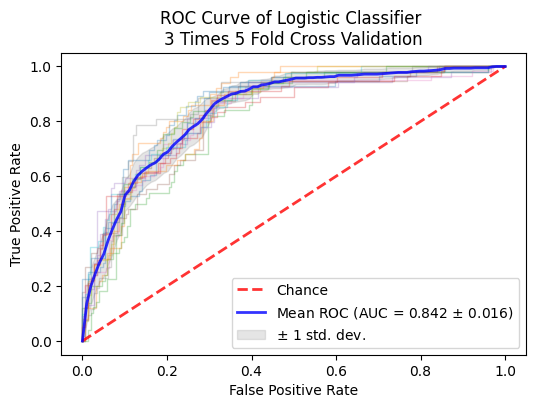

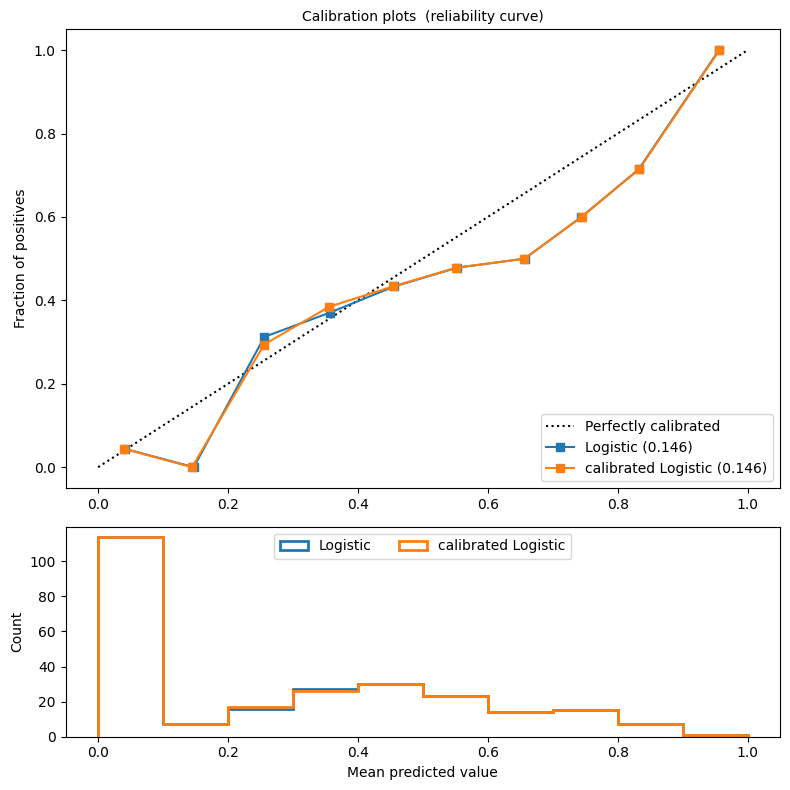

No handles with labels found to put in legend.


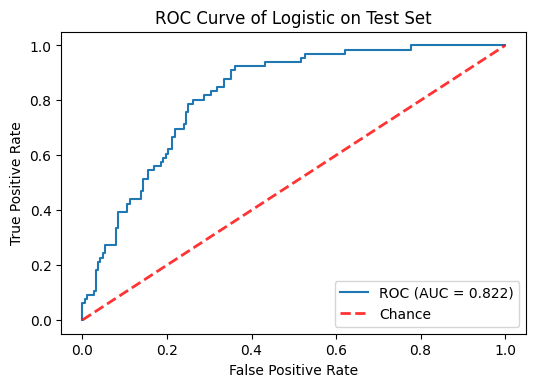

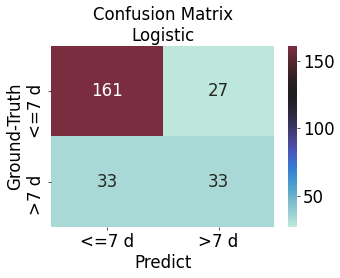

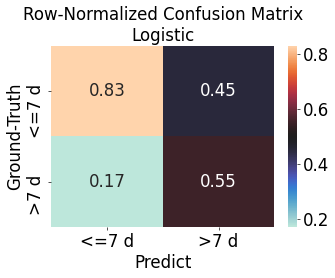

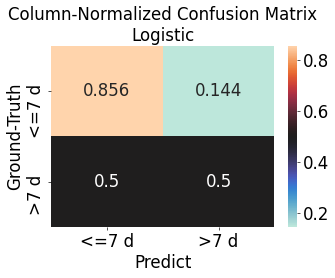

              precision    recall  f1-score   support

       <=7 d      0.830     0.856     0.843       188
        >7 d      0.550     0.500     0.524        66

    accuracy                          0.764       254
   macro avg      0.690     0.678     0.683       254
weighted avg      0.757     0.764     0.760       254

roc_auc: 0.822


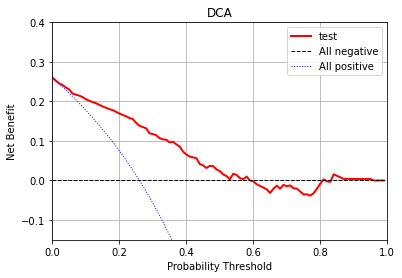

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


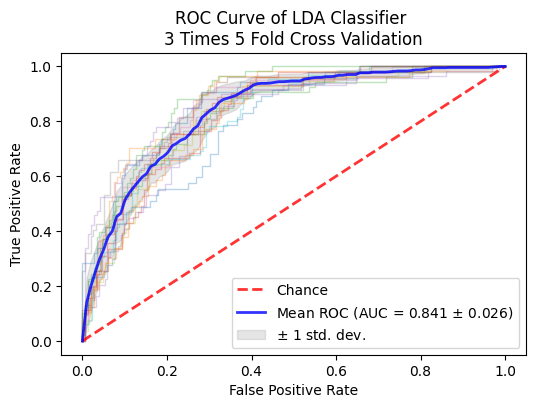

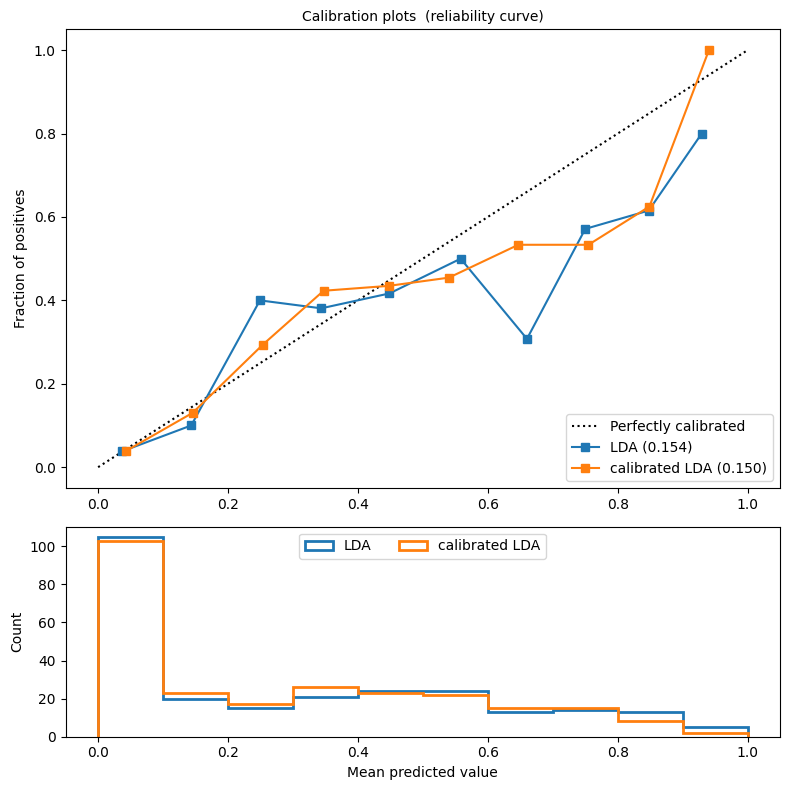

No handles with labels found to put in legend.


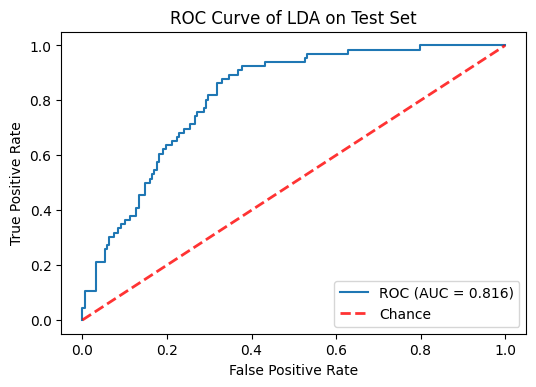

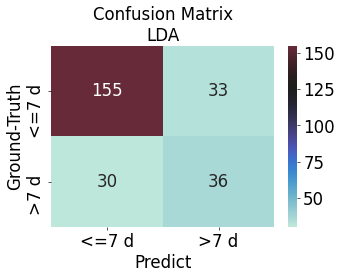

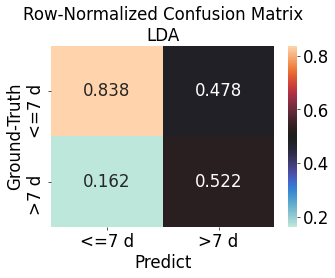

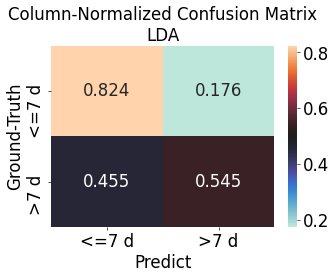

              precision    recall  f1-score   support

       <=7 d      0.838     0.824     0.831       188
        >7 d      0.522     0.545     0.533        66

    accuracy                          0.752       254
   macro avg      0.680     0.685     0.682       254
weighted avg      0.756     0.752     0.754       254

roc_auc: 0.816


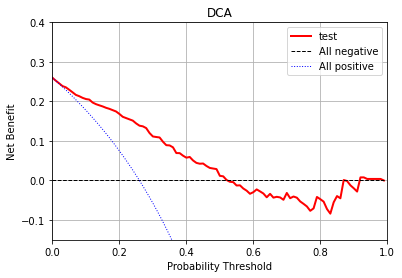

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


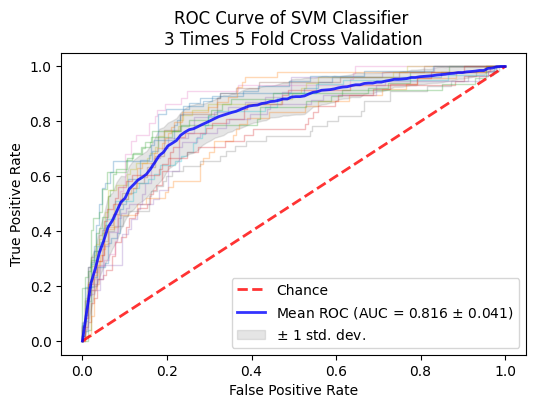

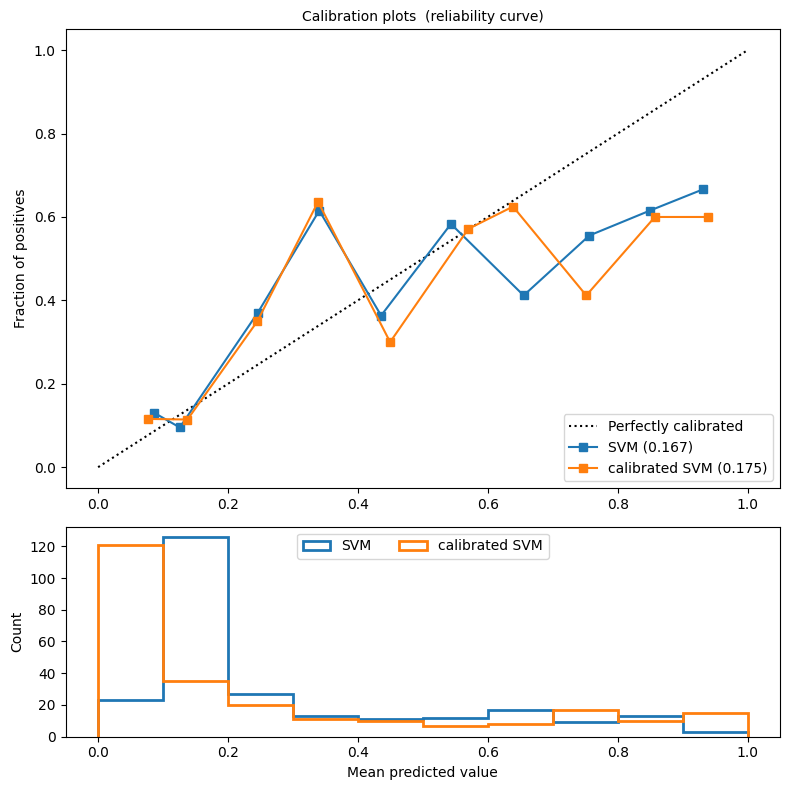

No handles with labels found to put in legend.


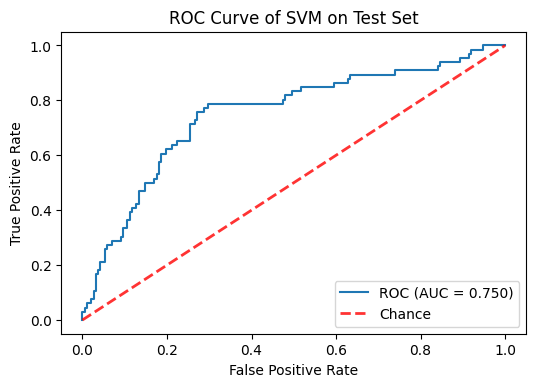

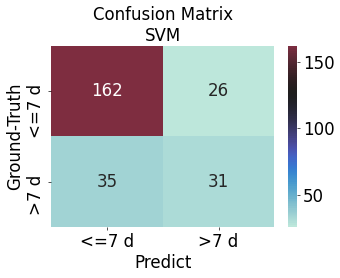

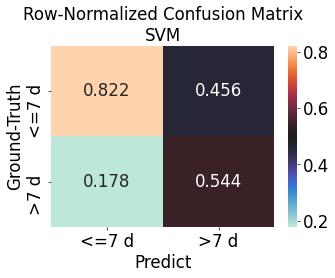

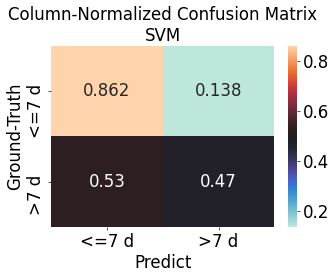

              precision    recall  f1-score   support

       <=7 d      0.822     0.862     0.842       188
        >7 d      0.544     0.470     0.504        66

    accuracy                          0.760       254
   macro avg      0.683     0.666     0.673       254
weighted avg      0.750     0.760     0.754       254

roc_auc: 0.75


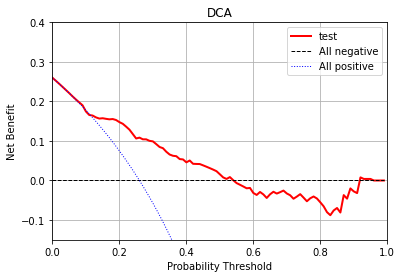

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


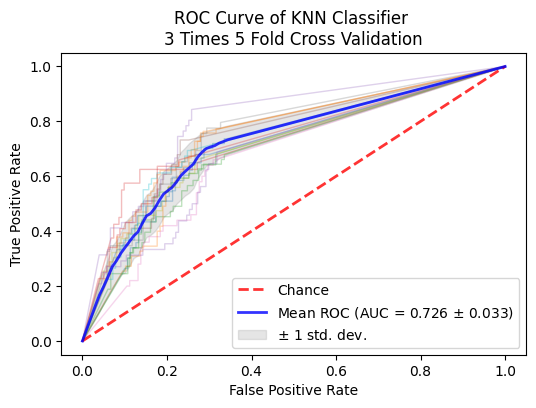

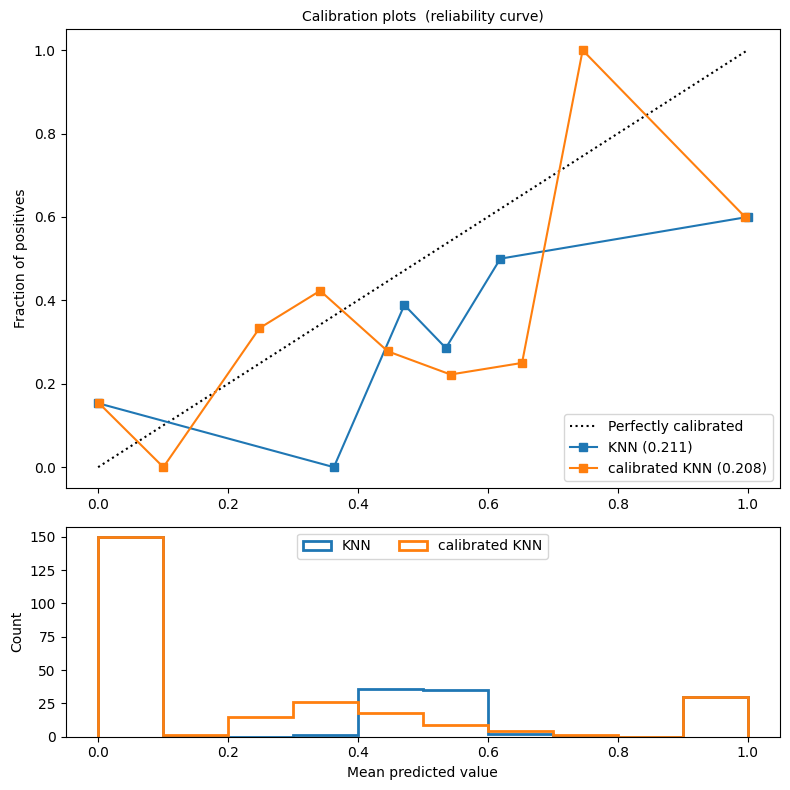

No handles with labels found to put in legend.


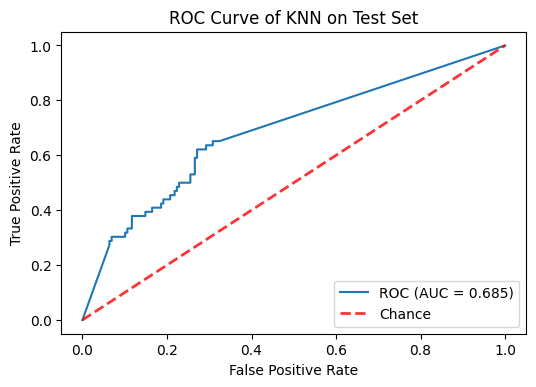

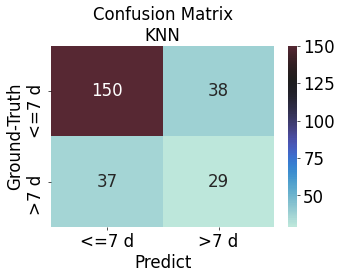

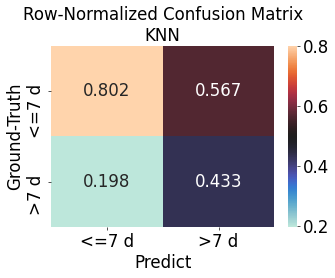

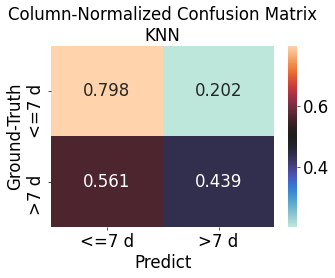

              precision    recall  f1-score   support

       <=7 d      0.802     0.798     0.800       188
        >7 d      0.433     0.439     0.436        66

    accuracy                          0.705       254
   macro avg      0.617     0.619     0.618       254
weighted avg      0.706     0.705     0.705       254

roc_auc: 0.685


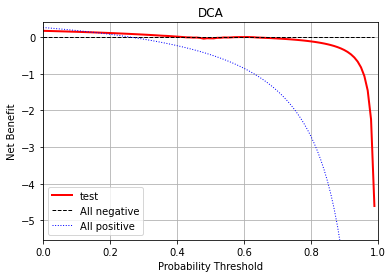

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


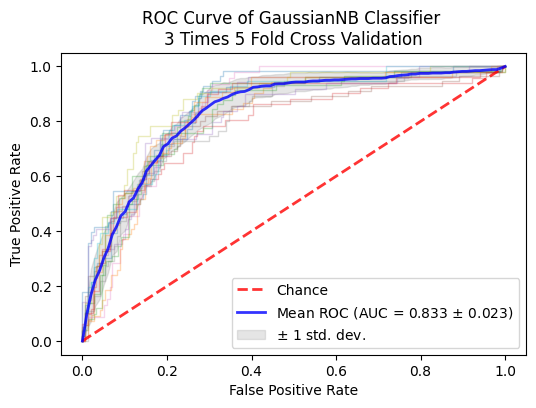

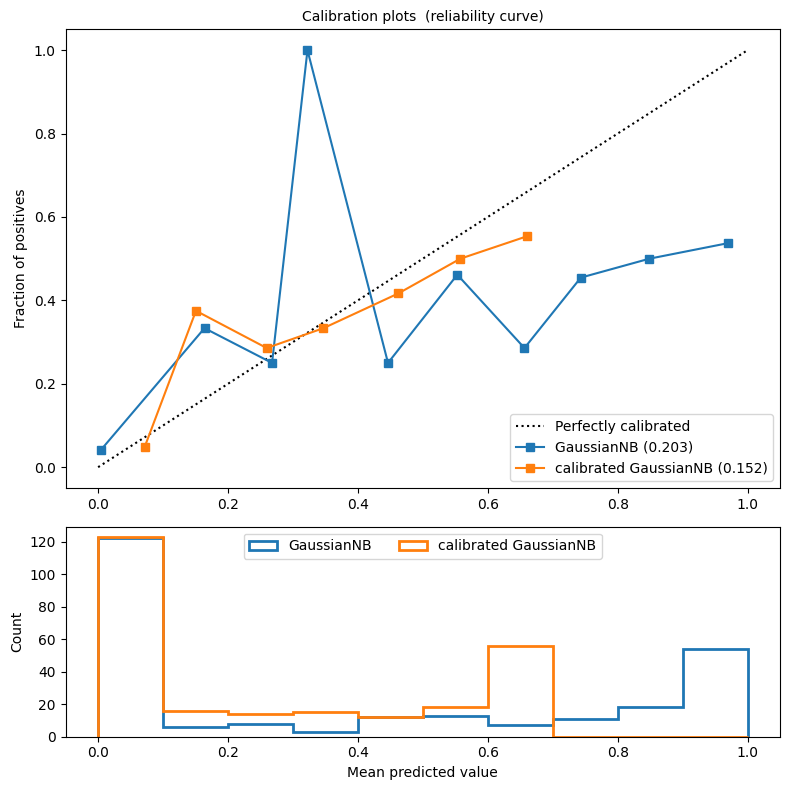

No handles with labels found to put in legend.


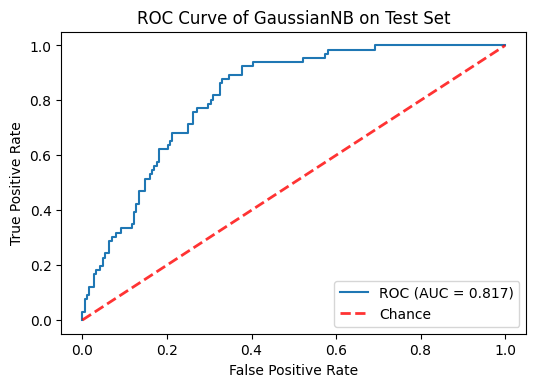

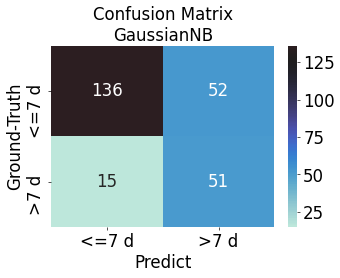

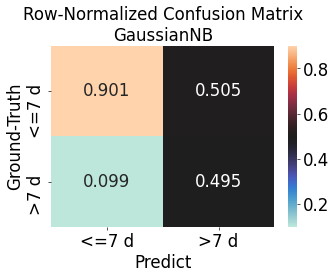

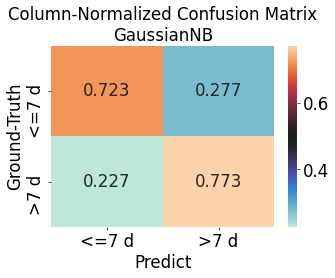

              precision    recall  f1-score   support

       <=7 d      0.901     0.723     0.802       188
        >7 d      0.495     0.773     0.604        66

    accuracy                          0.736       254
   macro avg      0.698     0.748     0.703       254
weighted avg      0.795     0.736     0.751       254

roc_auc: 0.817


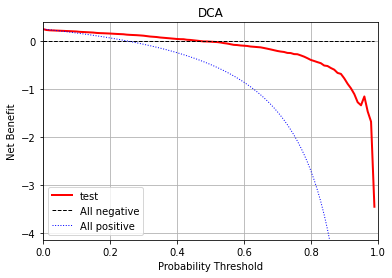

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


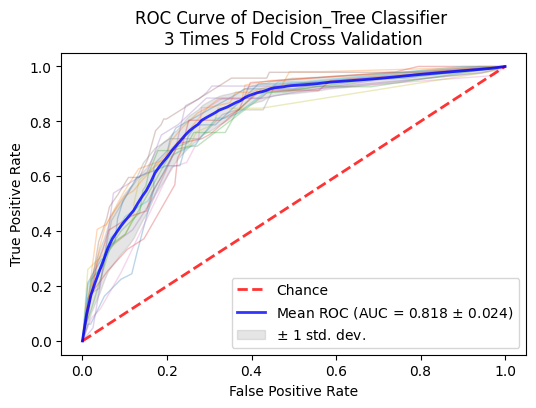

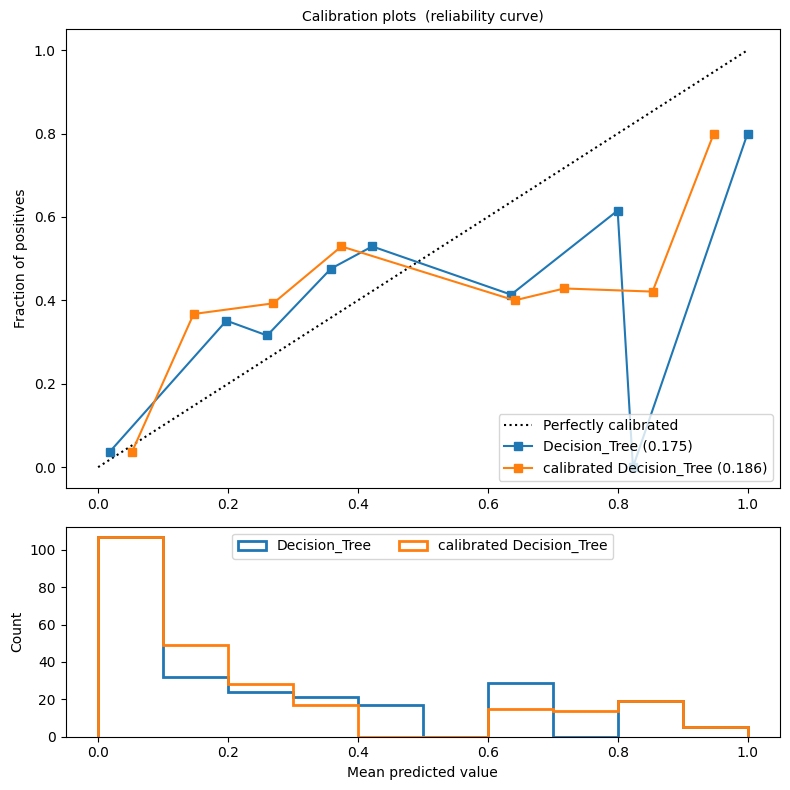

No handles with labels found to put in legend.


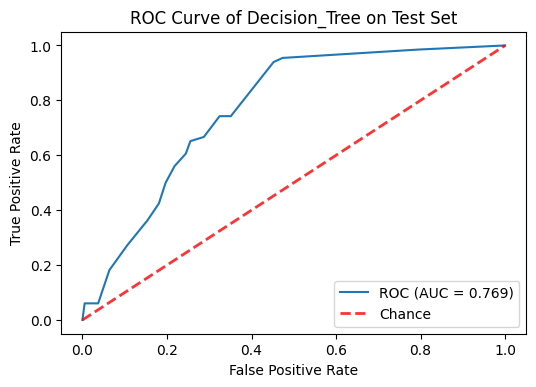

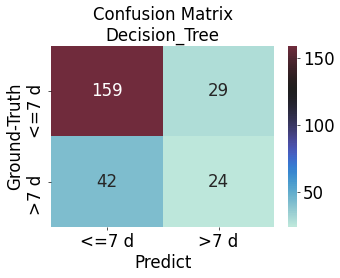

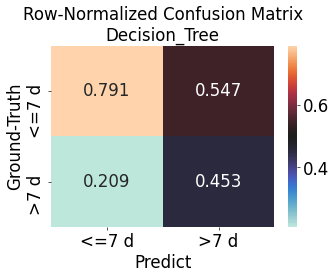

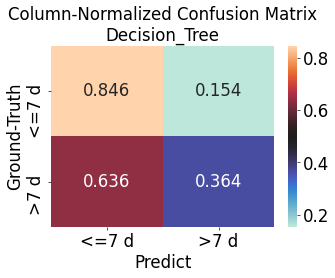

              precision    recall  f1-score   support

       <=7 d      0.791     0.846     0.817       188
        >7 d      0.453     0.364     0.403        66

    accuracy                          0.720       254
   macro avg      0.622     0.605     0.610       254
weighted avg      0.703     0.720     0.710       254

roc_auc: 0.769


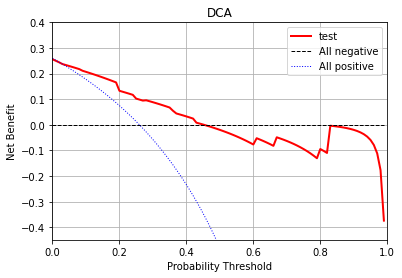

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


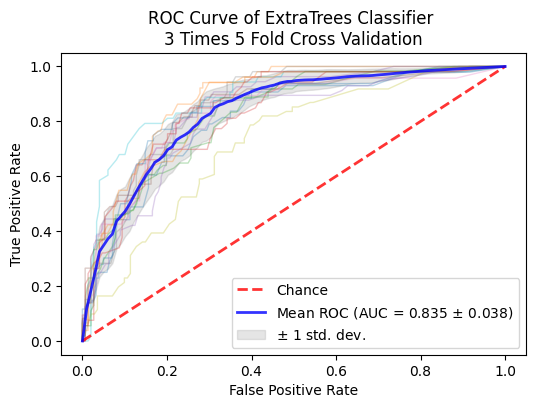

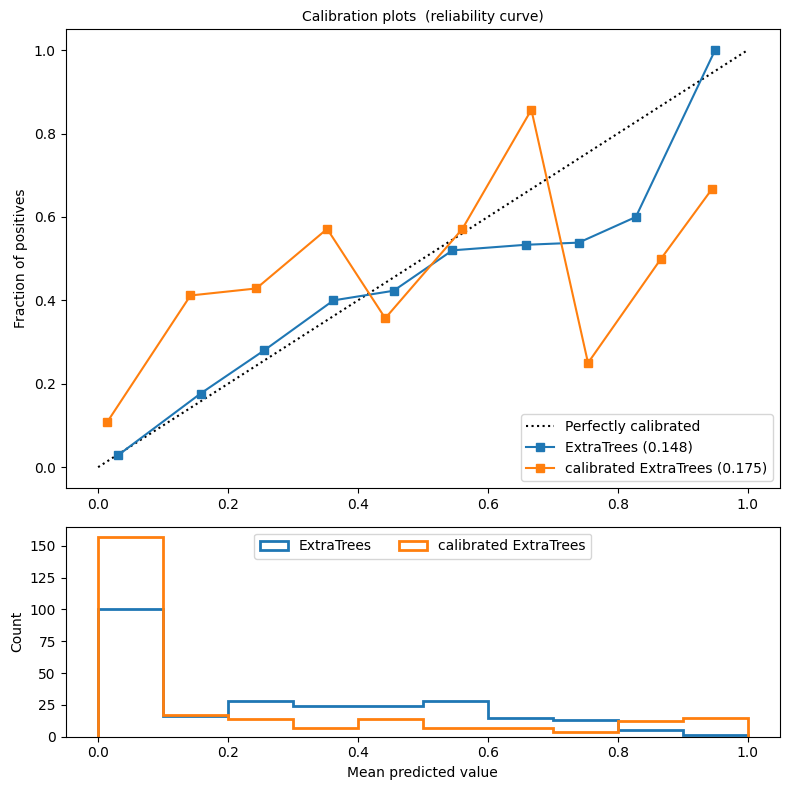

No handles with labels found to put in legend.


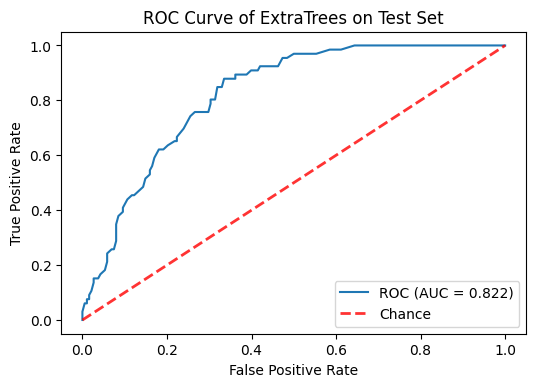

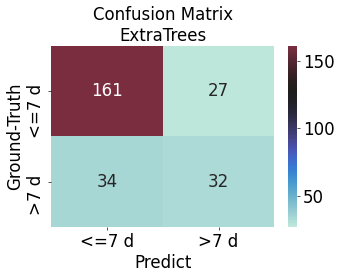

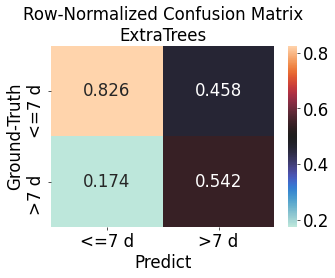

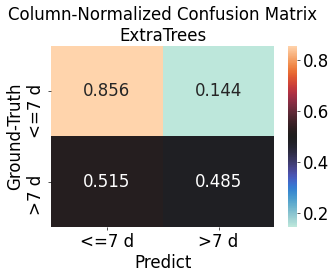

              precision    recall  f1-score   support

       <=7 d      0.826     0.856     0.841       188
        >7 d      0.542     0.485     0.512        66

    accuracy                          0.760       254
   macro avg      0.684     0.671     0.676       254
weighted avg      0.752     0.760     0.755       254

roc_auc: 0.822


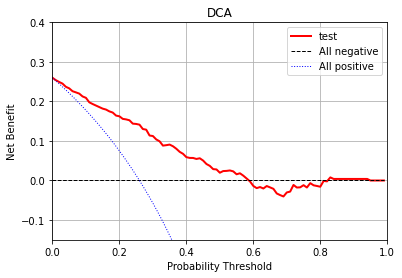

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


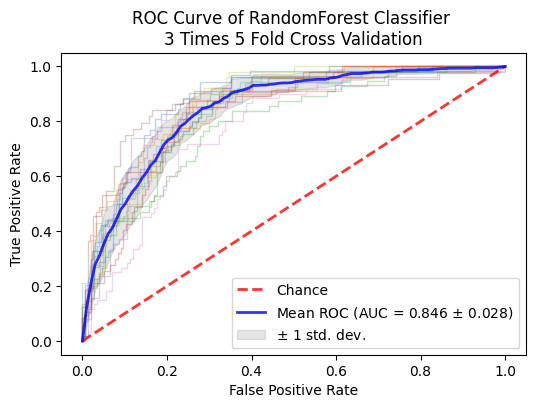

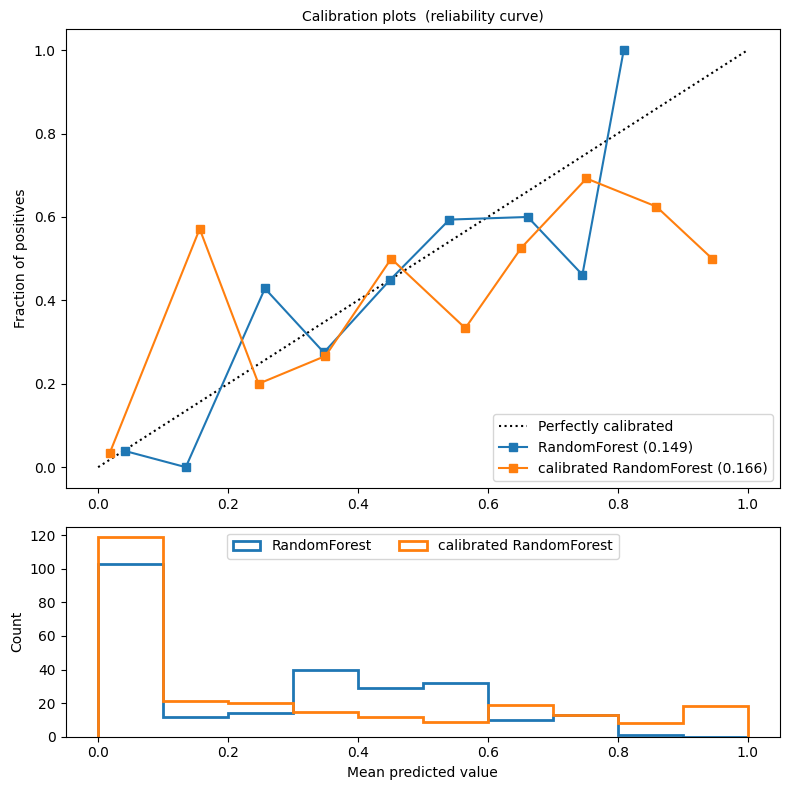

No handles with labels found to put in legend.


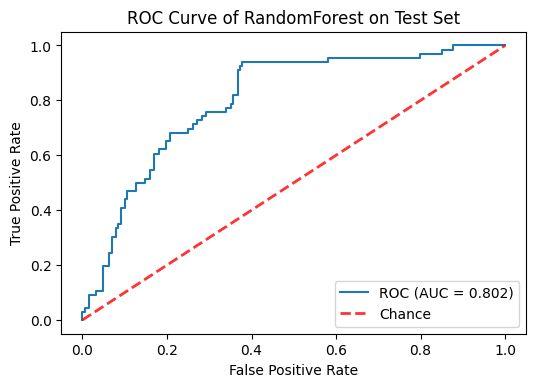

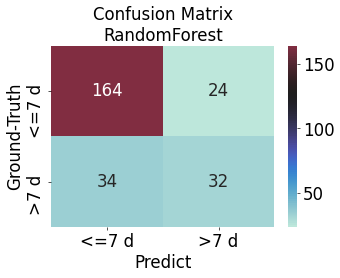

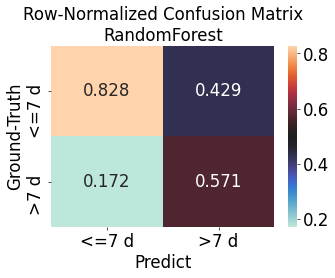

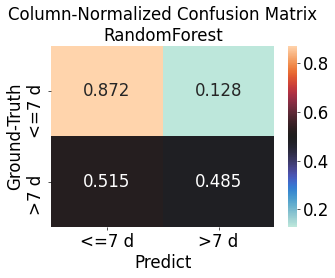

              precision    recall  f1-score   support

       <=7 d      0.828     0.872     0.850       188
        >7 d      0.571     0.485     0.525        66

    accuracy                          0.772       254
   macro avg      0.700     0.679     0.687       254
weighted avg      0.762     0.772     0.765       254

roc_auc: 0.802


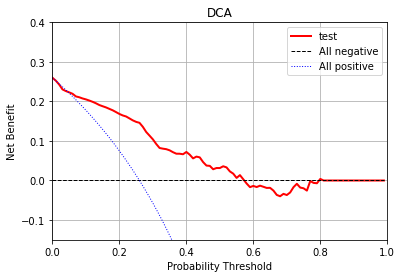

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


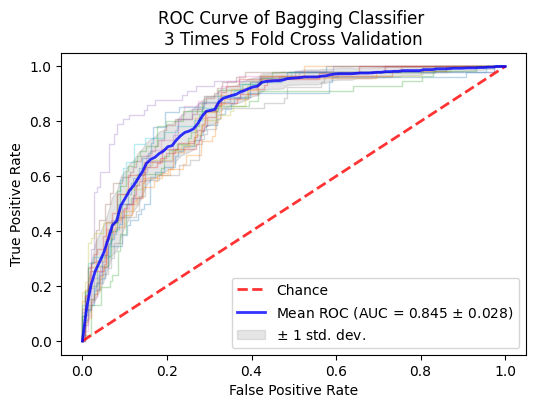

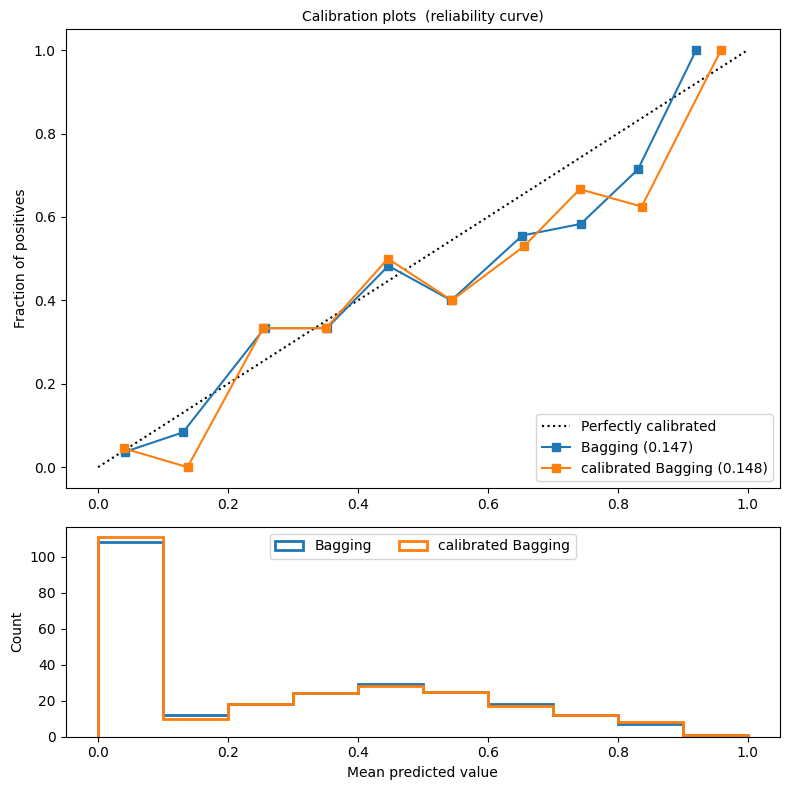

No handles with labels found to put in legend.


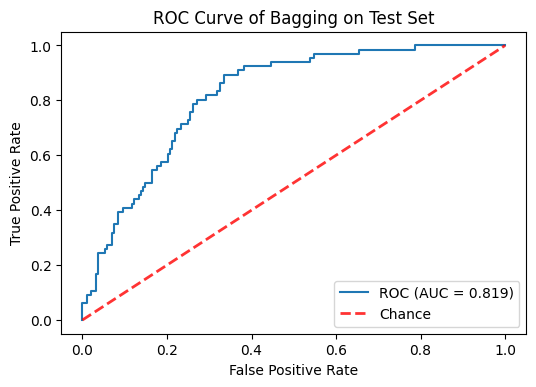

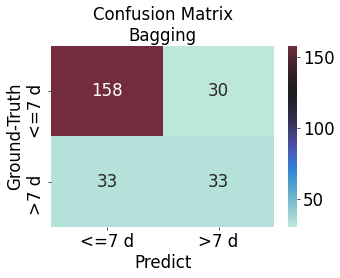

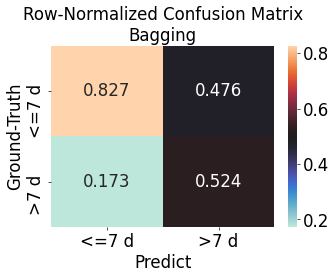

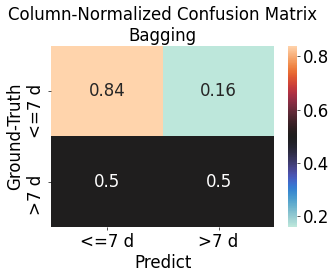

              precision    recall  f1-score   support

       <=7 d      0.827     0.840     0.834       188
        >7 d      0.524     0.500     0.512        66

    accuracy                          0.752       254
   macro avg      0.676     0.670     0.673       254
weighted avg      0.748     0.752     0.750       254

roc_auc: 0.819


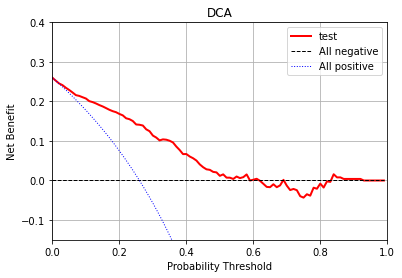

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


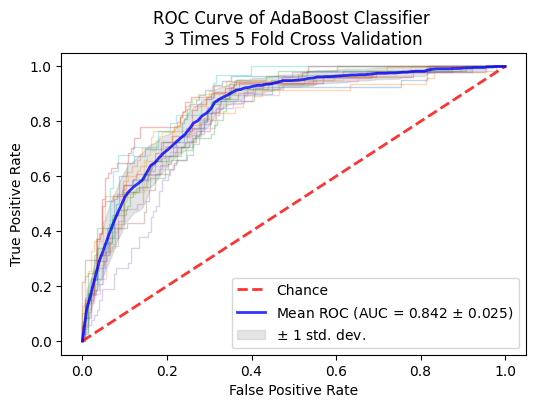

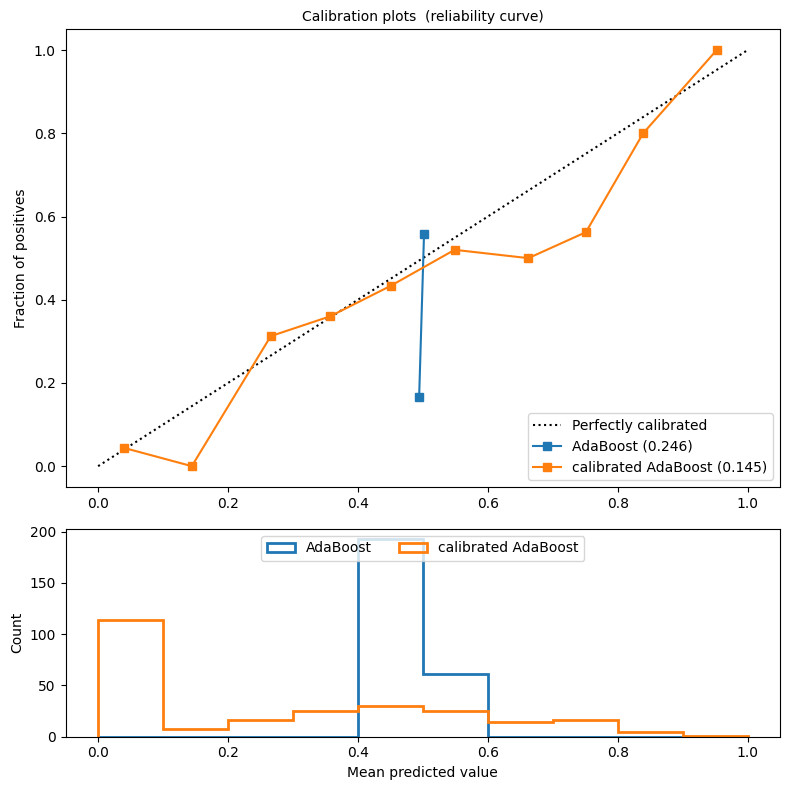

No handles with labels found to put in legend.


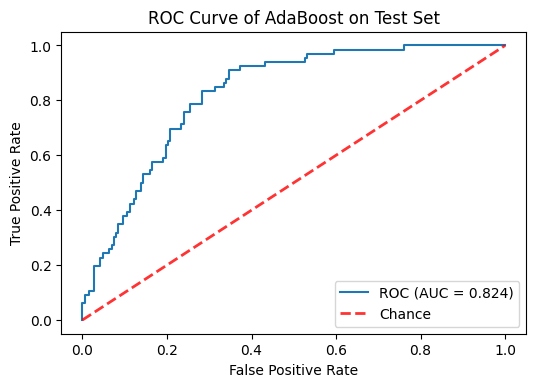

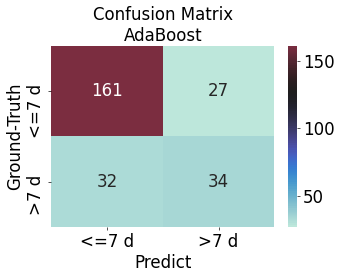

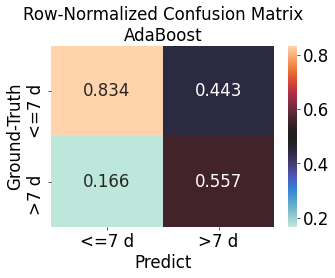

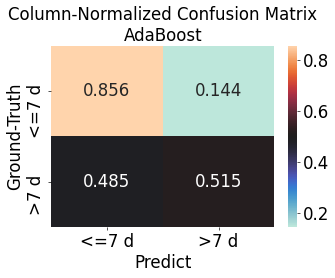

              precision    recall  f1-score   support

       <=7 d      0.834     0.856     0.845       188
        >7 d      0.557     0.515     0.535        66

    accuracy                          0.768       254
   macro avg      0.696     0.686     0.690       254
weighted avg      0.762     0.768     0.765       254

roc_auc: 0.824


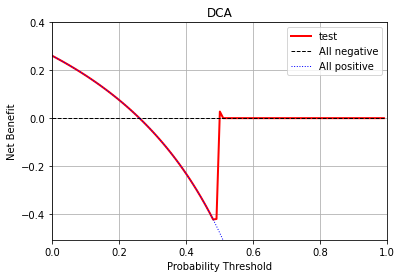

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


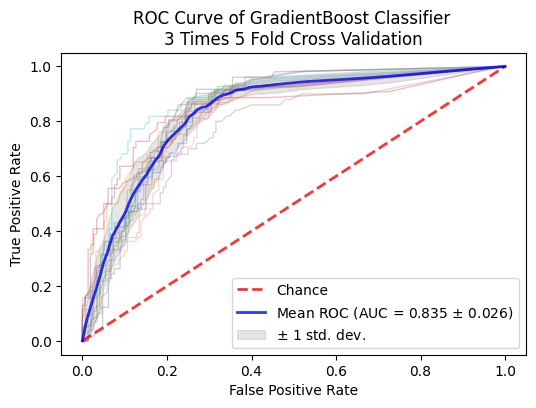

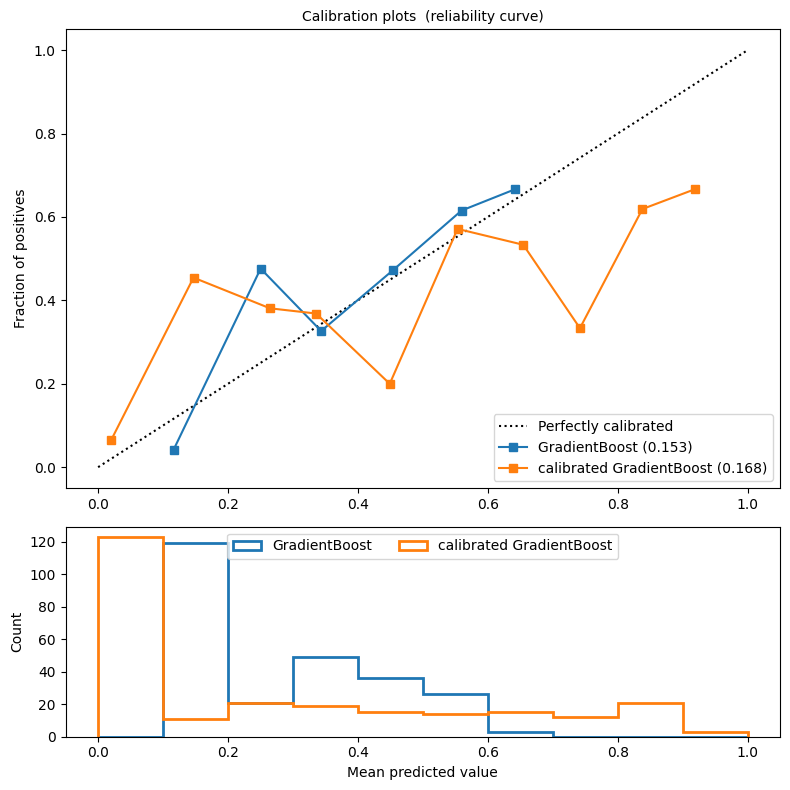

No handles with labels found to put in legend.


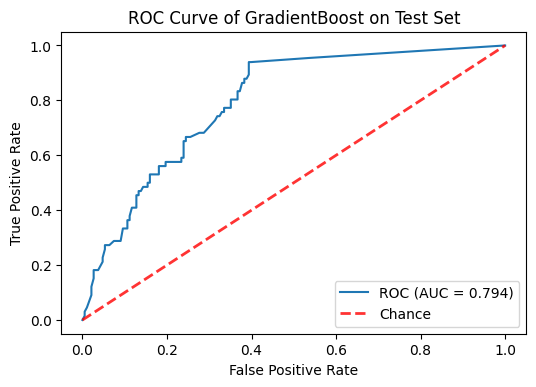

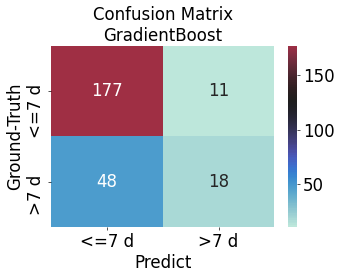

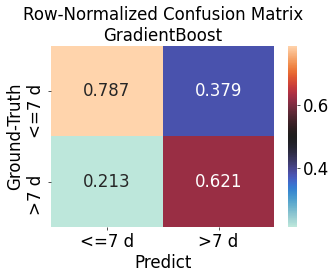

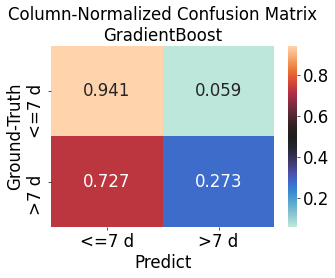

              precision    recall  f1-score   support

       <=7 d      0.787     0.941     0.857       188
        >7 d      0.621     0.273     0.379        66

    accuracy                          0.768       254
   macro avg      0.704     0.607     0.618       254
weighted avg      0.744     0.768     0.733       254

roc_auc: 0.794


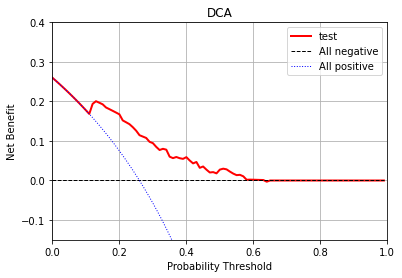

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


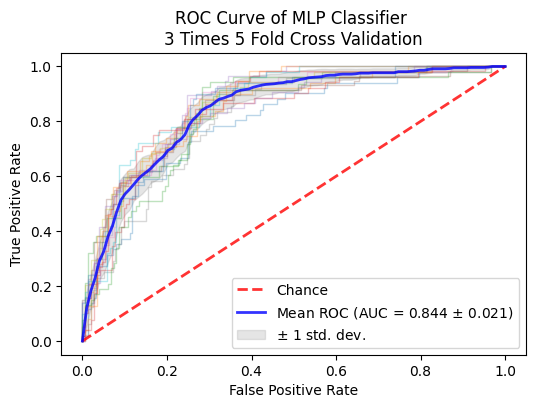

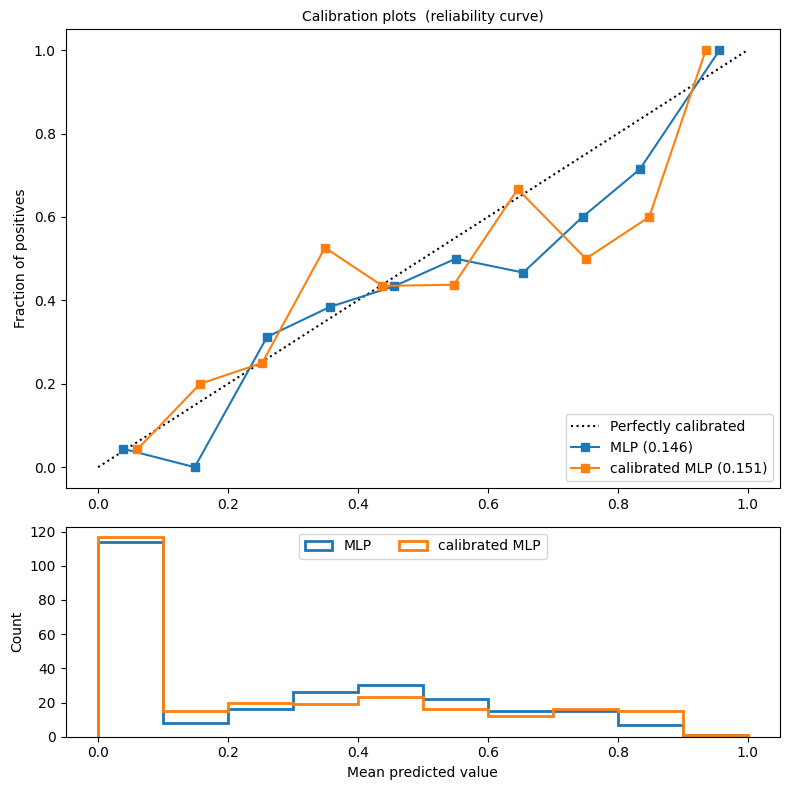

No handles with labels found to put in legend.


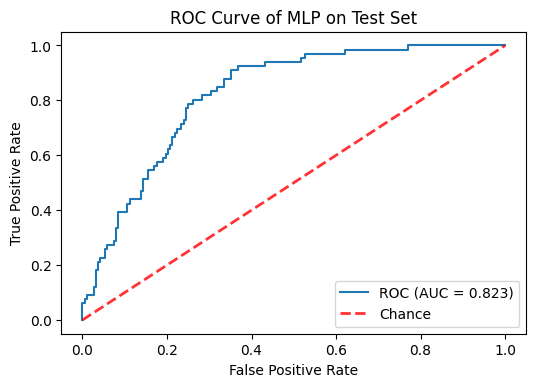

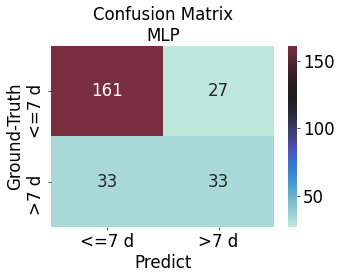

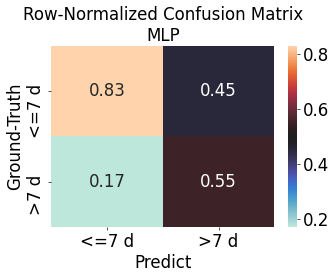

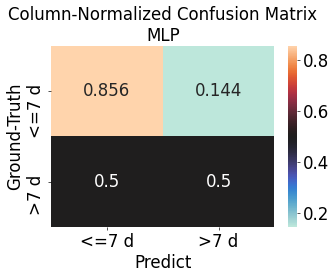

              precision    recall  f1-score   support

       <=7 d      0.830     0.856     0.843       188
        >7 d      0.550     0.500     0.524        66

    accuracy                          0.764       254
   macro avg      0.690     0.678     0.683       254
weighted avg      0.757     0.764     0.760       254

roc_auc: 0.823


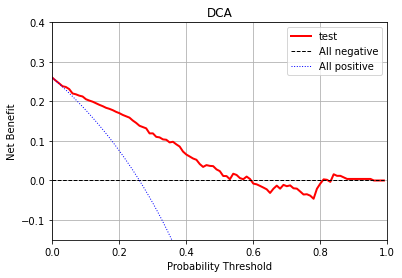

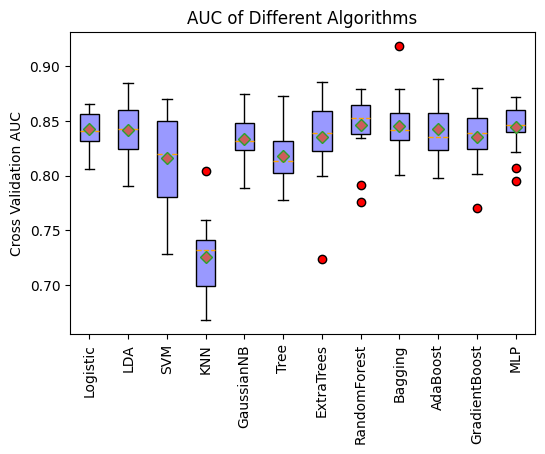

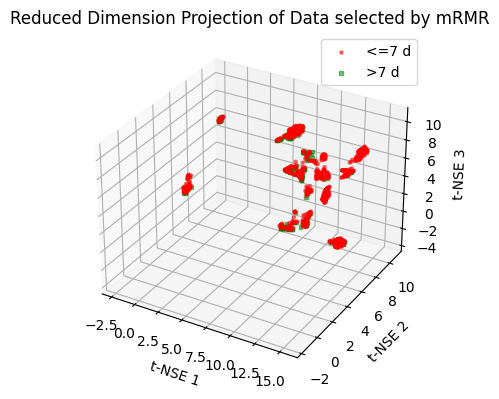

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


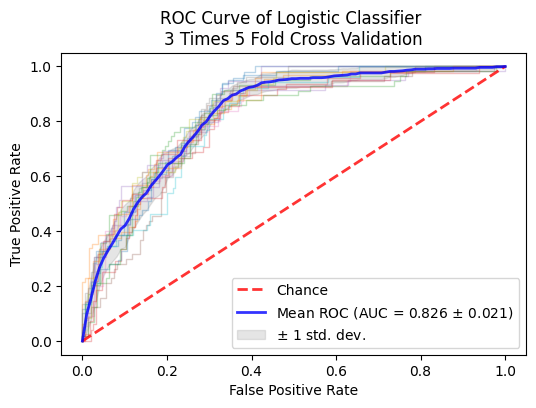

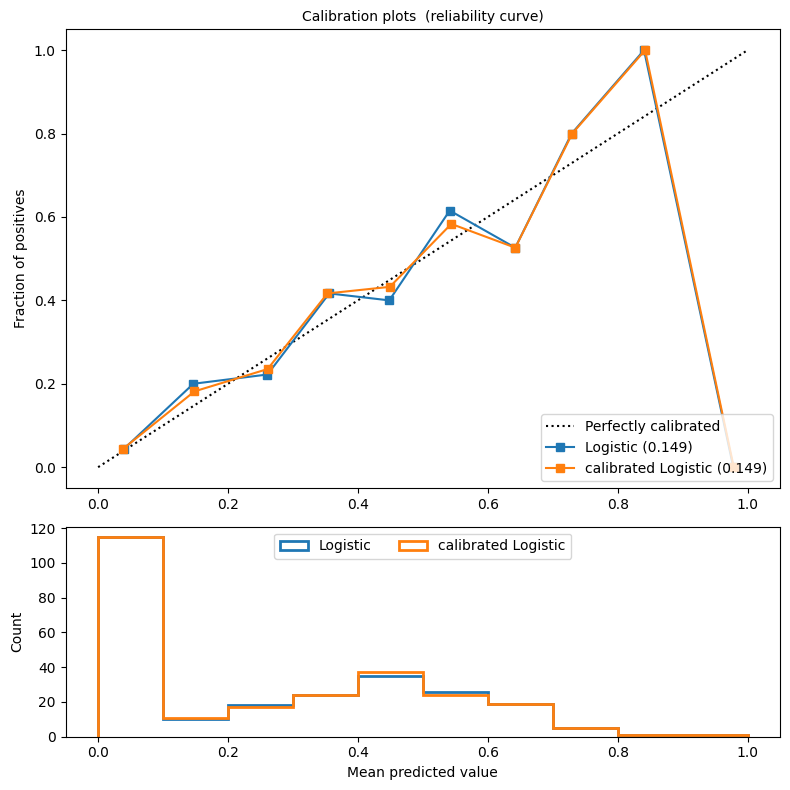

No handles with labels found to put in legend.


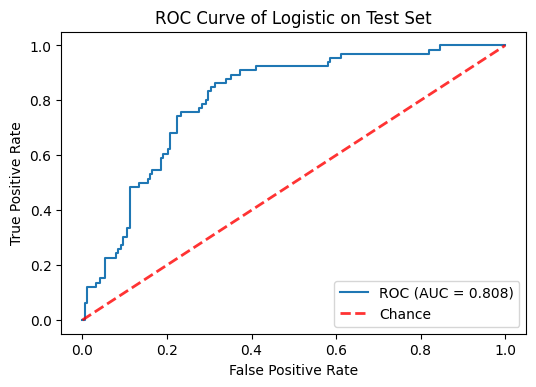

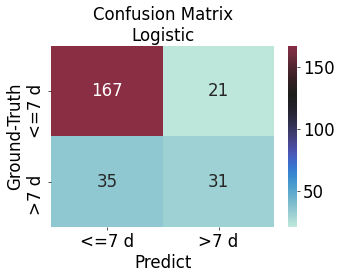

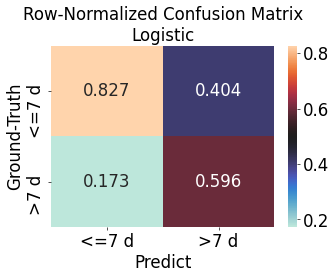

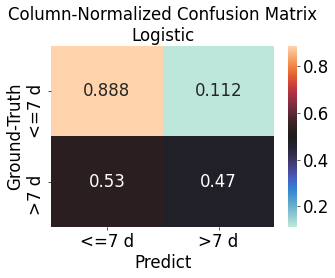

              precision    recall  f1-score   support

       <=7 d      0.827     0.888     0.856       188
        >7 d      0.596     0.470     0.525        66

    accuracy                          0.780       254
   macro avg      0.711     0.679     0.691       254
weighted avg      0.767     0.780     0.770       254

roc_auc: 0.808


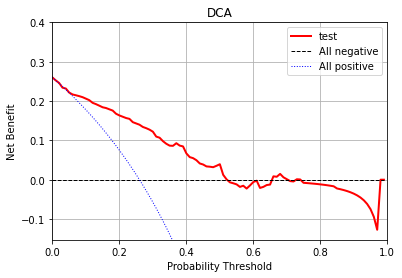

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


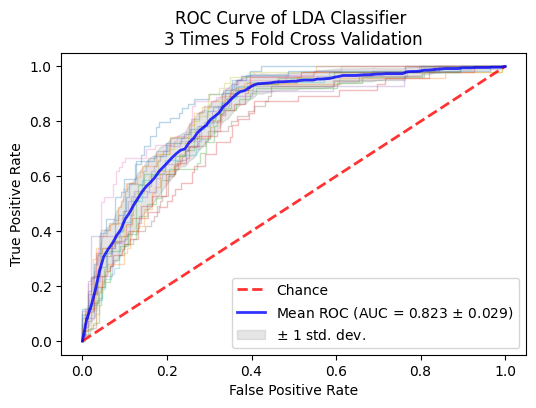

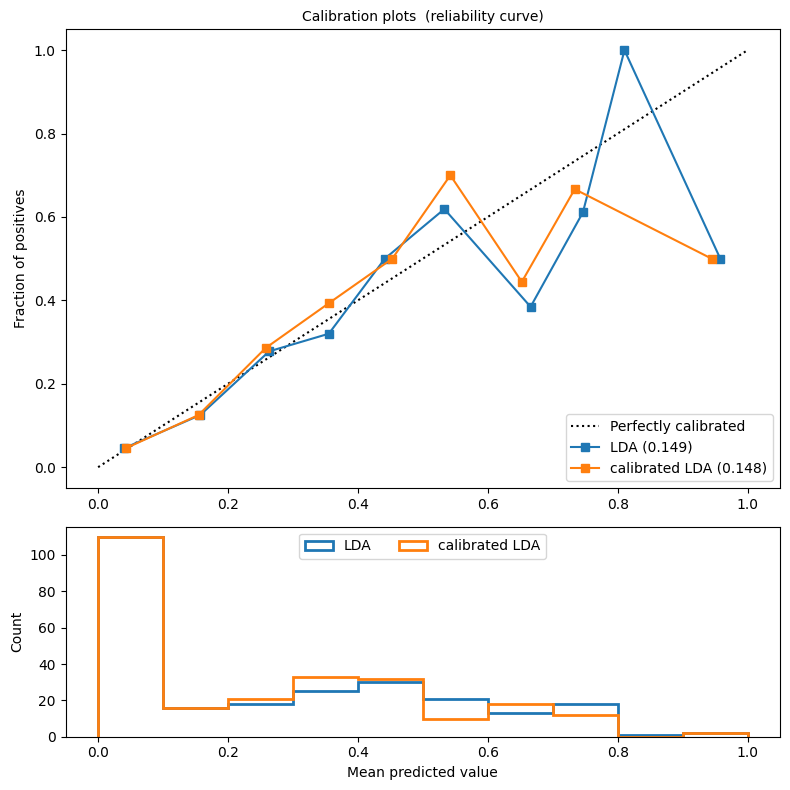

No handles with labels found to put in legend.


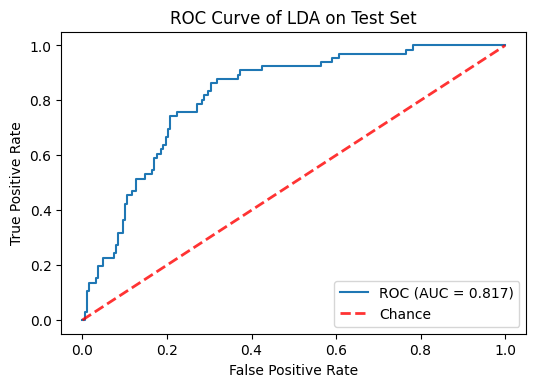

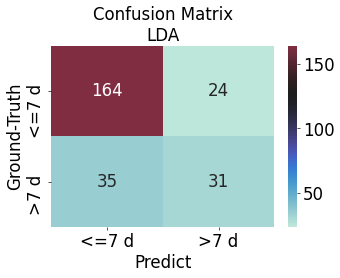

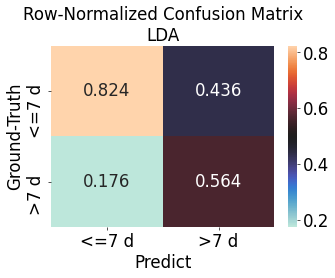

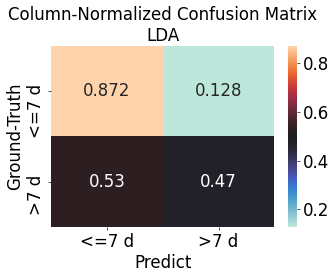

              precision    recall  f1-score   support

       <=7 d      0.824     0.872     0.848       188
        >7 d      0.564     0.470     0.512        66

    accuracy                          0.768       254
   macro avg      0.694     0.671     0.680       254
weighted avg      0.756     0.768     0.760       254

roc_auc: 0.817


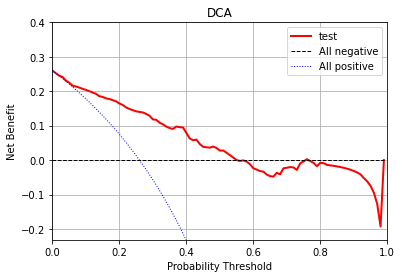

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


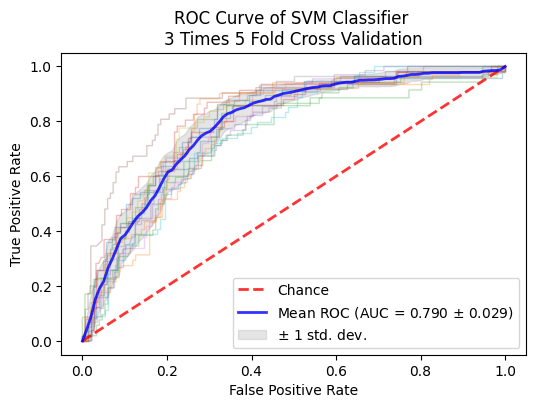

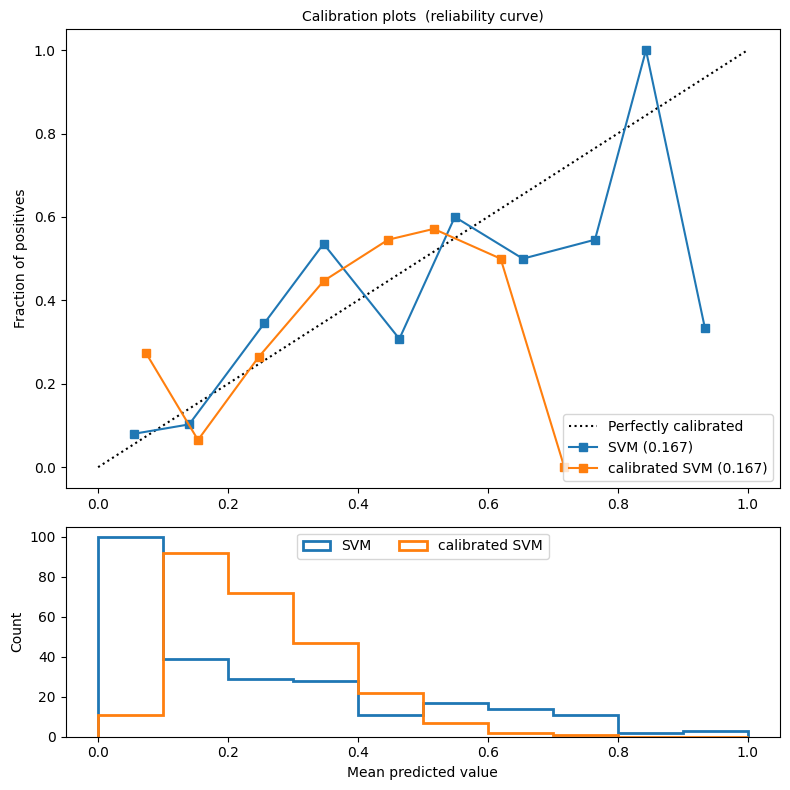

No handles with labels found to put in legend.


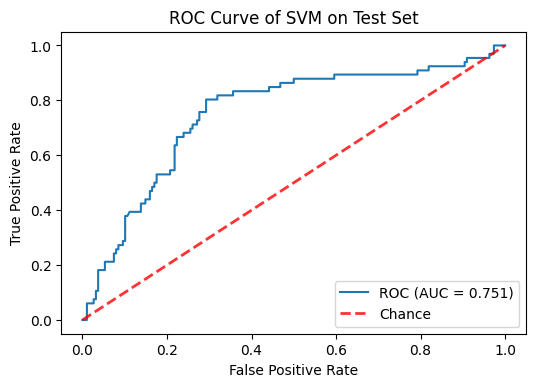

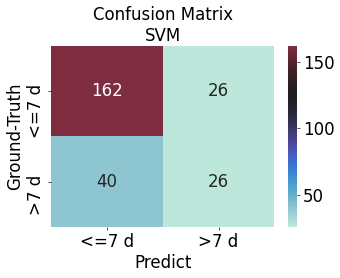

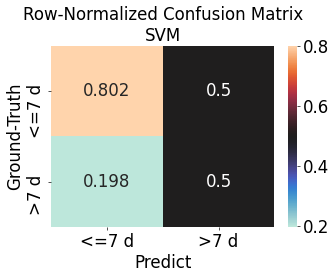

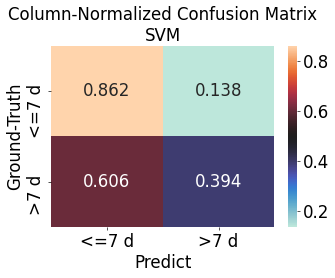

              precision    recall  f1-score   support

       <=7 d      0.802     0.862     0.831       188
        >7 d      0.500     0.394     0.441        66

    accuracy                          0.740       254
   macro avg      0.651     0.628     0.636       254
weighted avg      0.724     0.740     0.729       254

roc_auc: 0.751


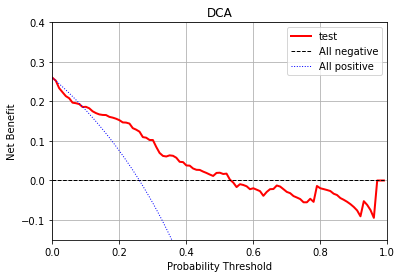

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


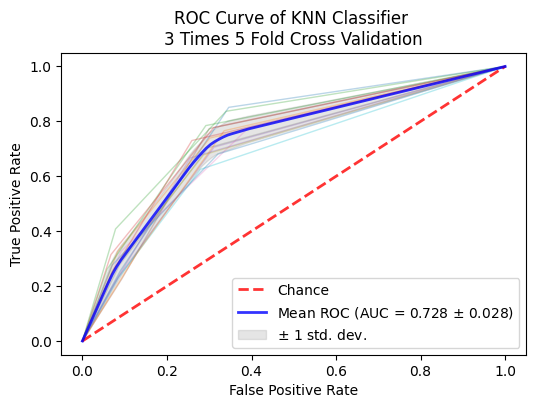

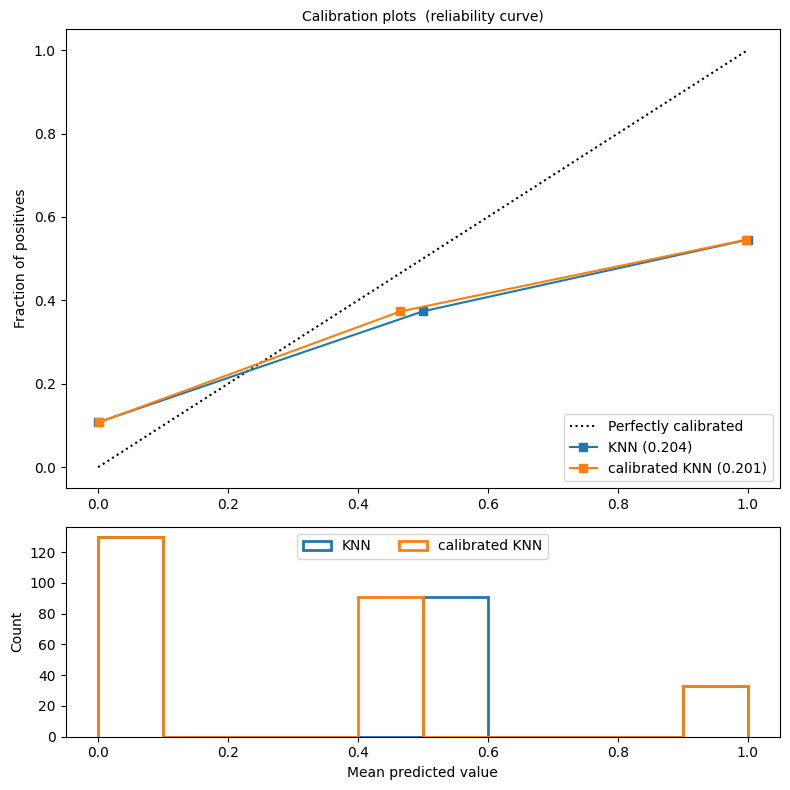

No handles with labels found to put in legend.


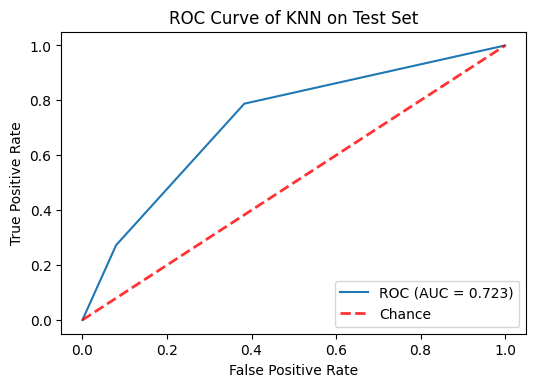

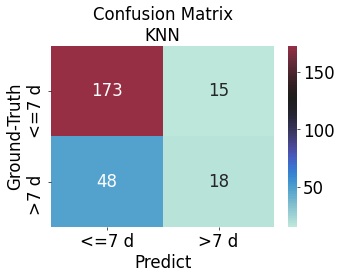

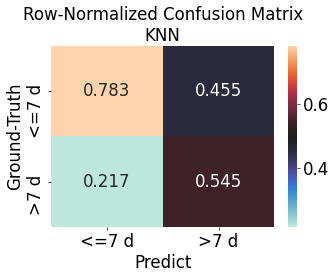

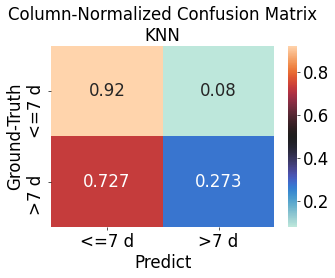

              precision    recall  f1-score   support

       <=7 d      0.783     0.920     0.846       188
        >7 d      0.545     0.273     0.364        66

    accuracy                          0.752       254
   macro avg      0.664     0.596     0.605       254
weighted avg      0.721     0.752     0.721       254

roc_auc: 0.723


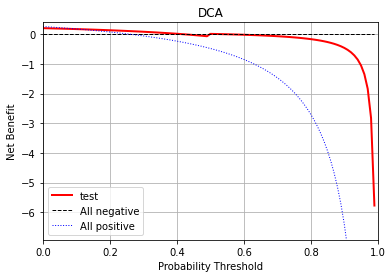

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


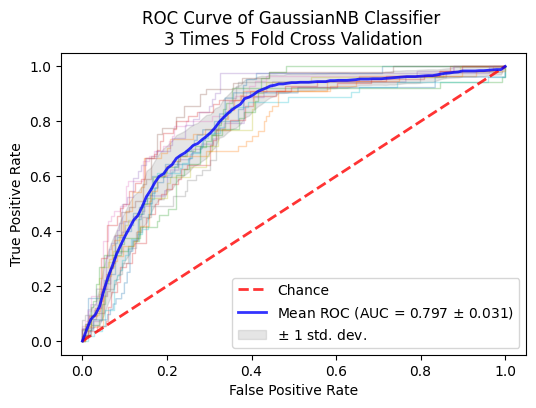

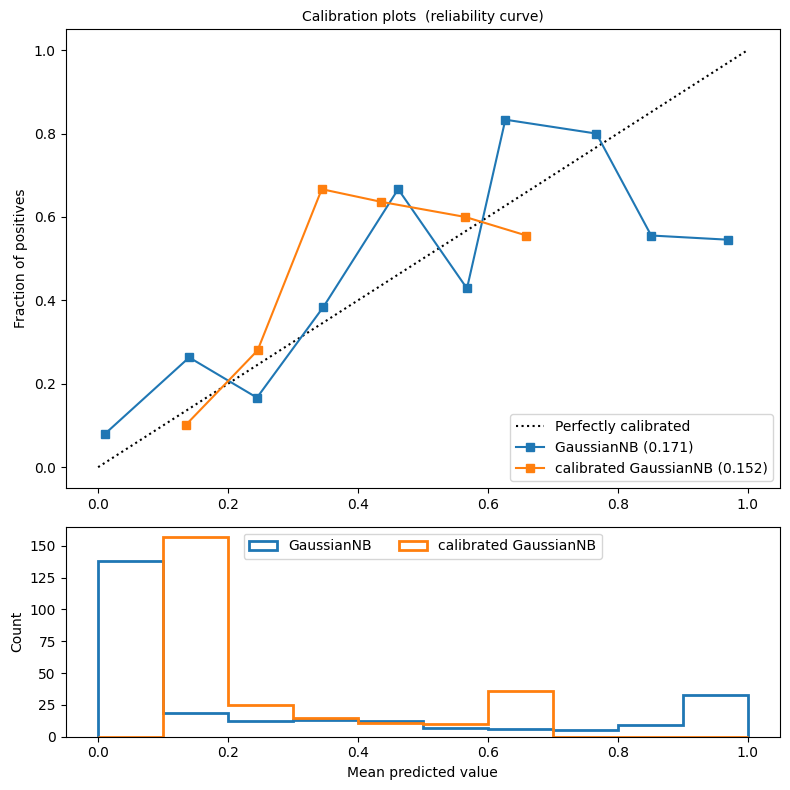

No handles with labels found to put in legend.


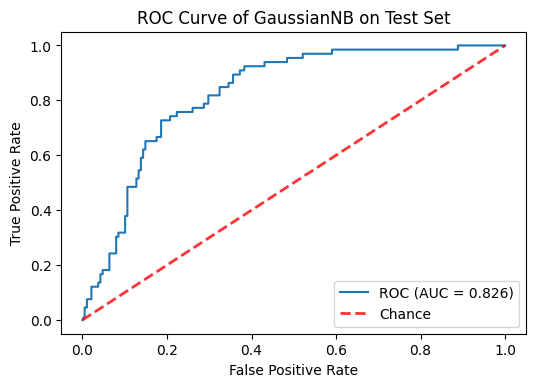

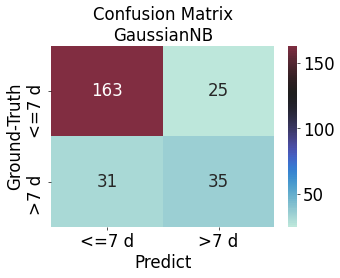

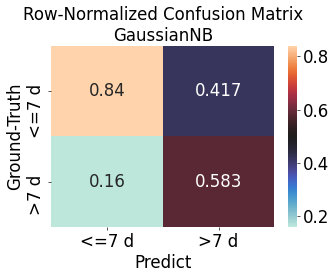

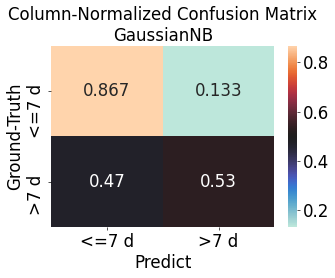

              precision    recall  f1-score   support

       <=7 d      0.840     0.867     0.853       188
        >7 d      0.583     0.530     0.556        66

    accuracy                          0.780       254
   macro avg      0.712     0.699     0.704       254
weighted avg      0.773     0.780     0.776       254

roc_auc: 0.826


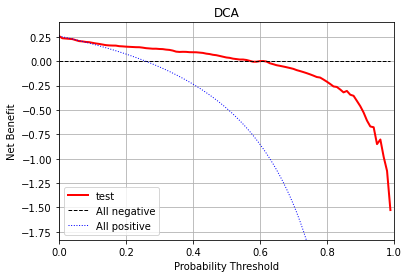

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


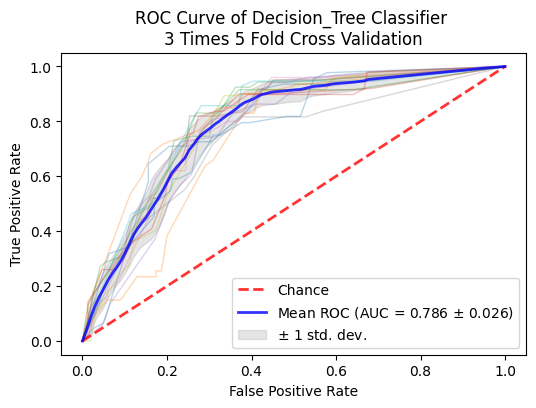

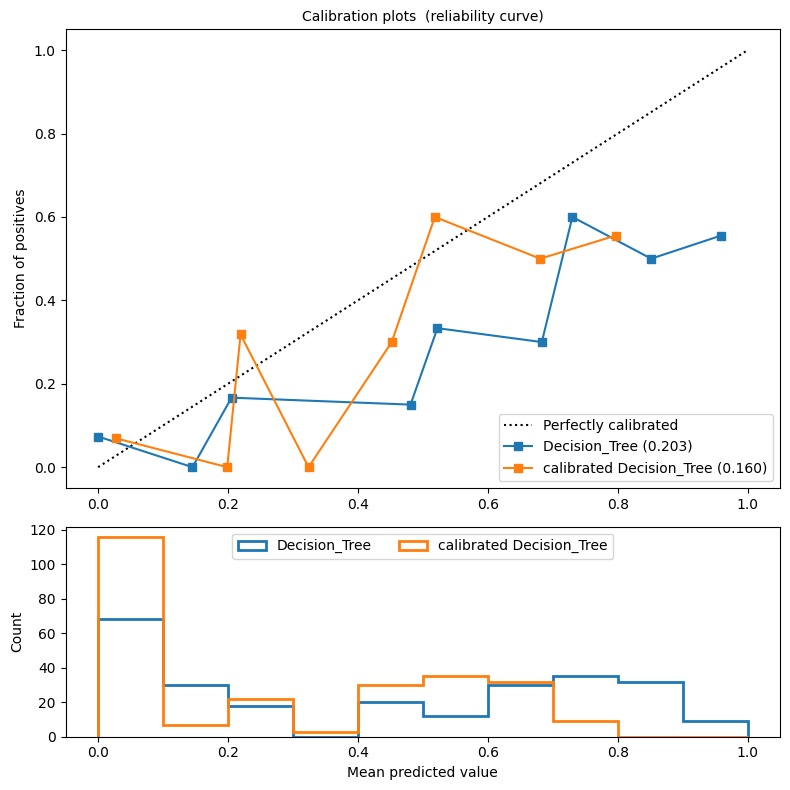

No handles with labels found to put in legend.


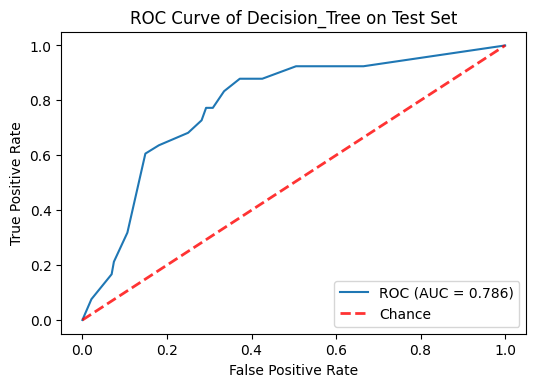

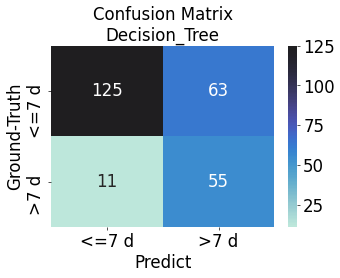

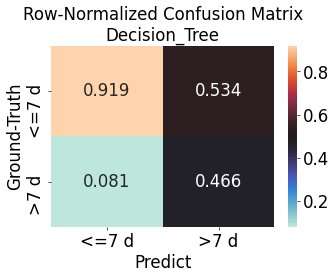

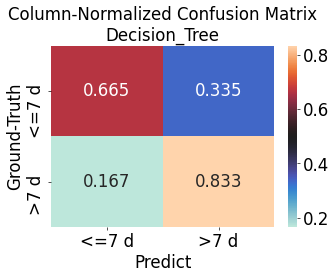

              precision    recall  f1-score   support

       <=7 d      0.919     0.665     0.772       188
        >7 d      0.466     0.833     0.598        66

    accuracy                          0.709       254
   macro avg      0.693     0.749     0.685       254
weighted avg      0.801     0.709     0.726       254

roc_auc: 0.786


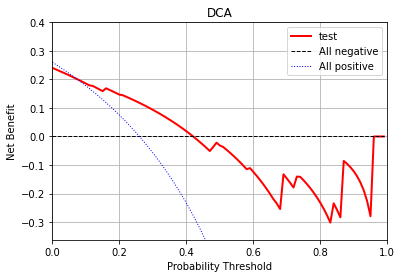

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


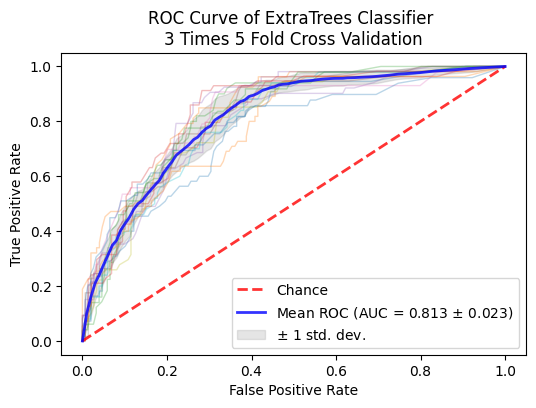

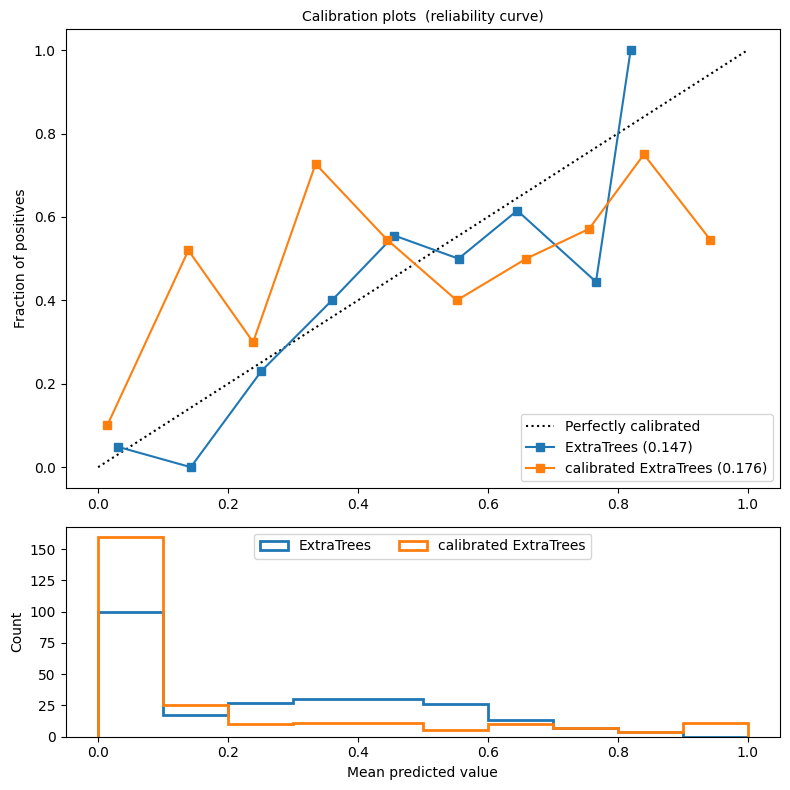

No handles with labels found to put in legend.


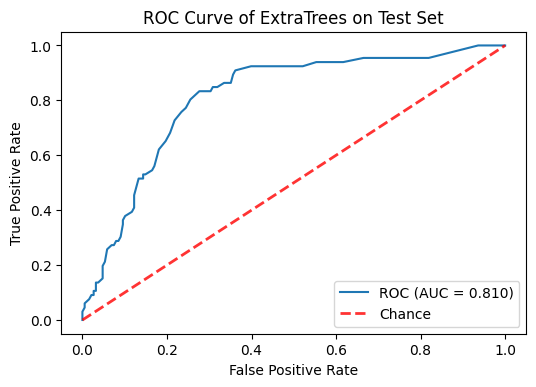

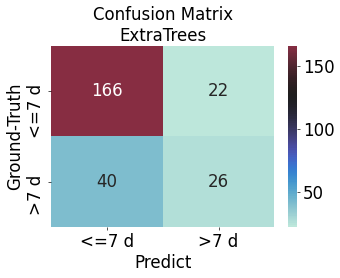

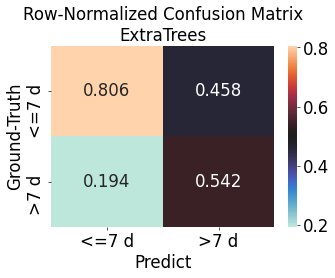

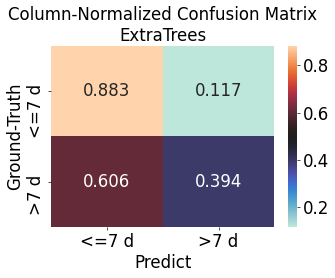

              precision    recall  f1-score   support

       <=7 d      0.806     0.883     0.843       188
        >7 d      0.542     0.394     0.456        66

    accuracy                          0.756       254
   macro avg      0.674     0.638     0.649       254
weighted avg      0.737     0.756     0.742       254

roc_auc: 0.81


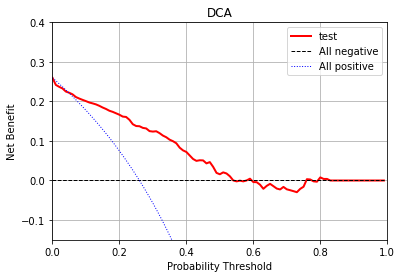

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


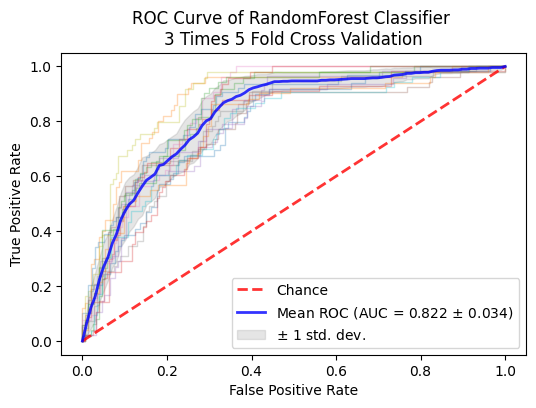

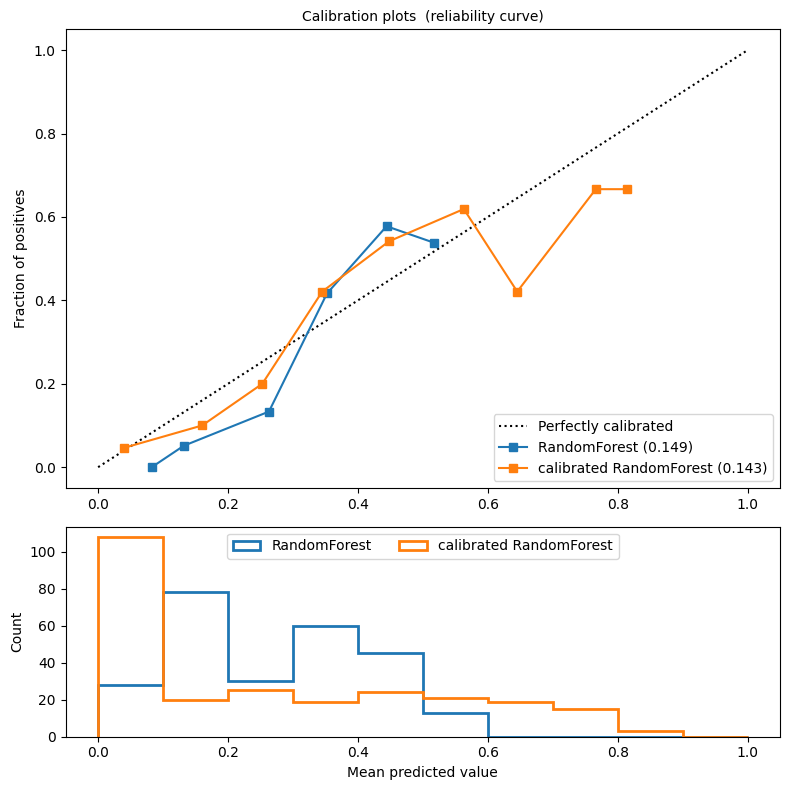

No handles with labels found to put in legend.


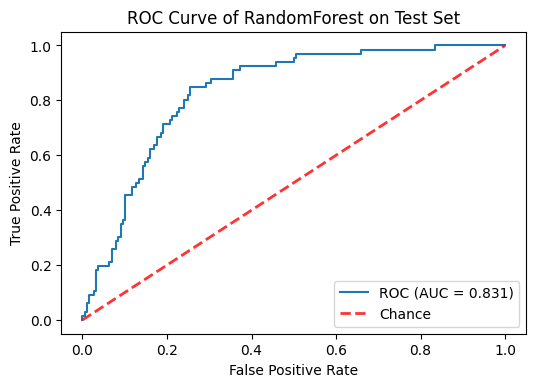

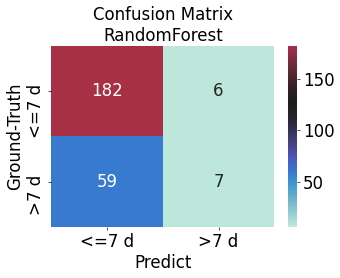

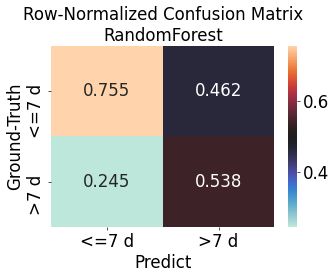

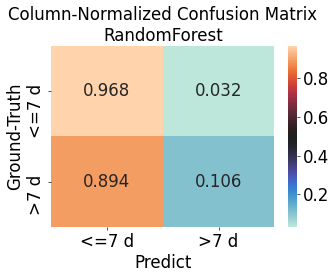

              precision    recall  f1-score   support

       <=7 d      0.755     0.968     0.848       188
        >7 d      0.538     0.106     0.177        66

    accuracy                          0.744       254
   macro avg      0.647     0.537     0.513       254
weighted avg      0.699     0.744     0.674       254

roc_auc: 0.831


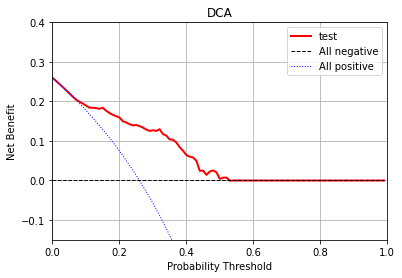

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


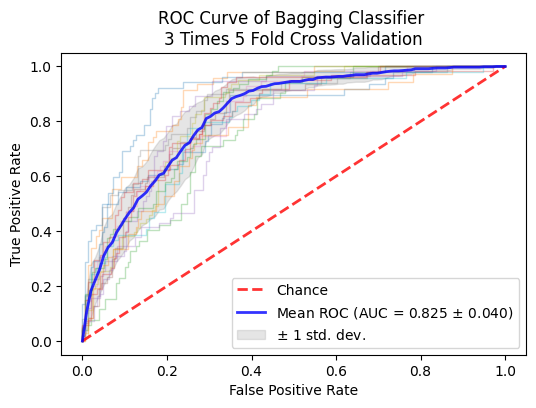

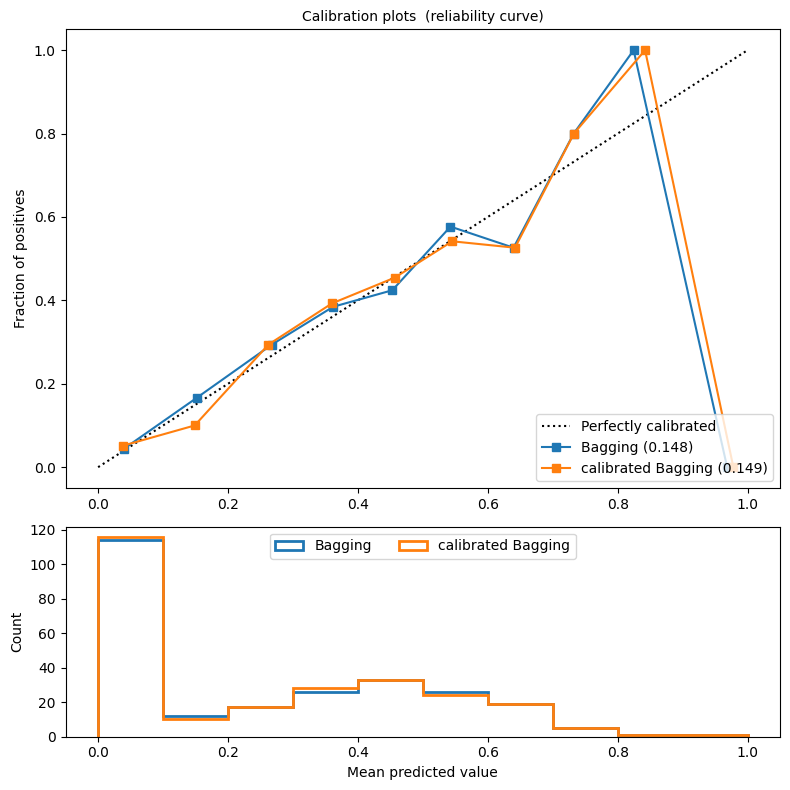

No handles with labels found to put in legend.


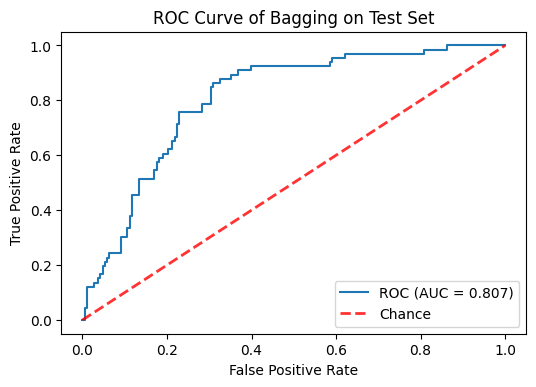

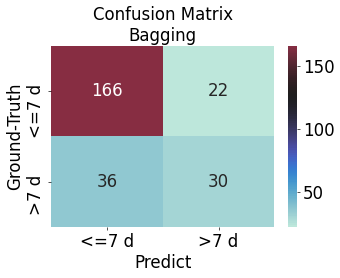

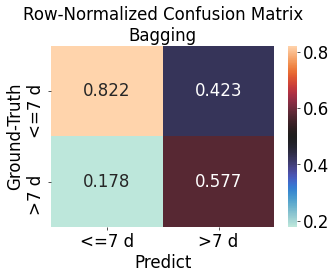

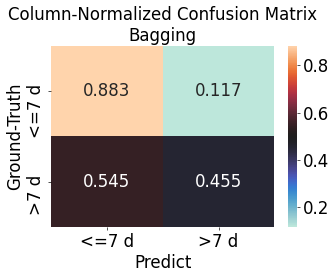

              precision    recall  f1-score   support

       <=7 d      0.822     0.883     0.851       188
        >7 d      0.577     0.455     0.508        66

    accuracy                          0.772       254
   macro avg      0.699     0.669     0.680       254
weighted avg      0.758     0.772     0.762       254

roc_auc: 0.807


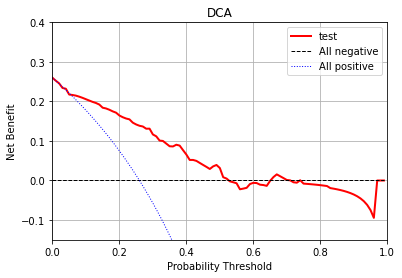

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


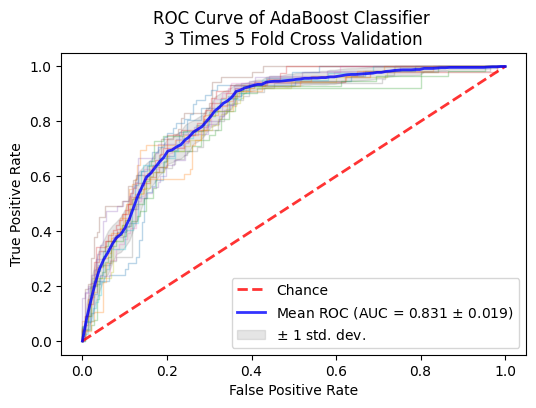

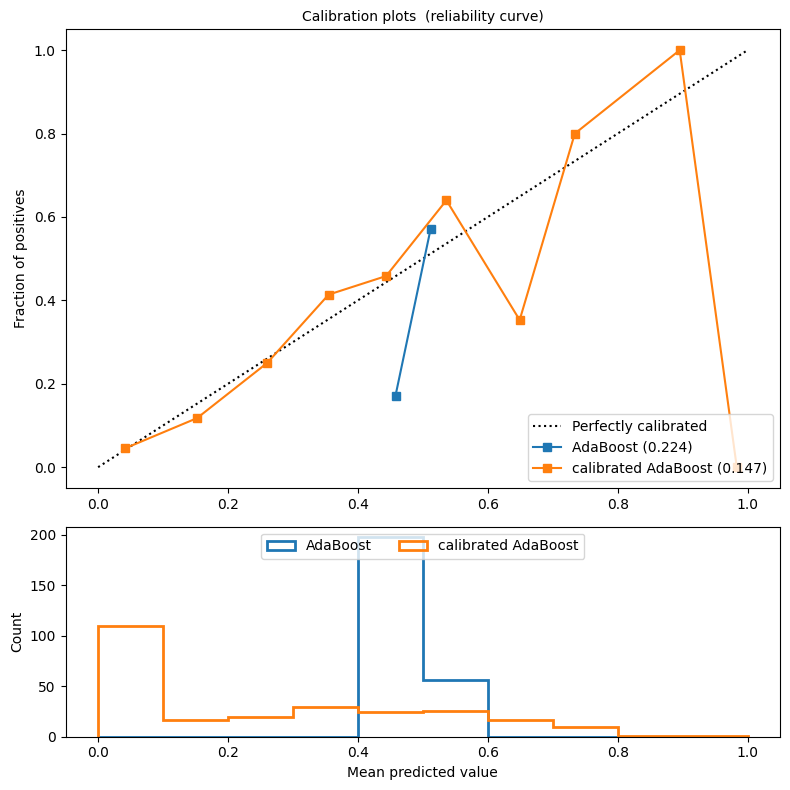

No handles with labels found to put in legend.


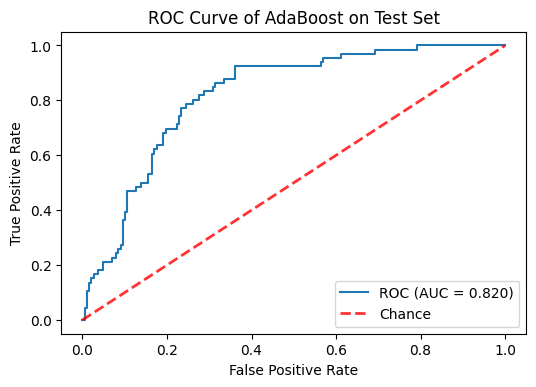

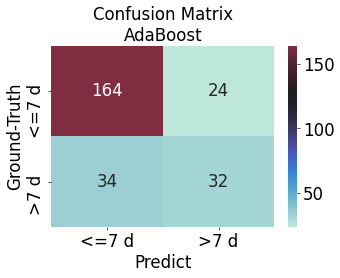

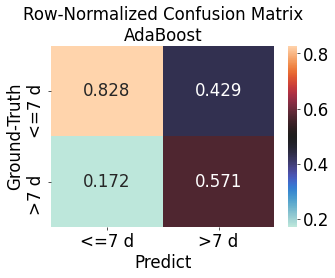

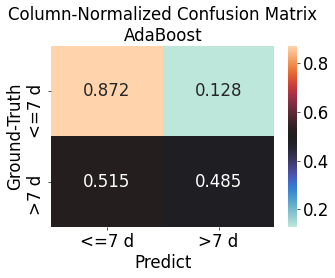

              precision    recall  f1-score   support

       <=7 d      0.828     0.872     0.850       188
        >7 d      0.571     0.485     0.525        66

    accuracy                          0.772       254
   macro avg      0.700     0.679     0.687       254
weighted avg      0.762     0.772     0.765       254

roc_auc: 0.82


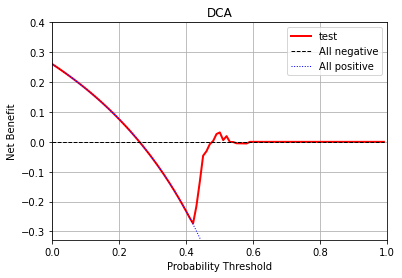

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


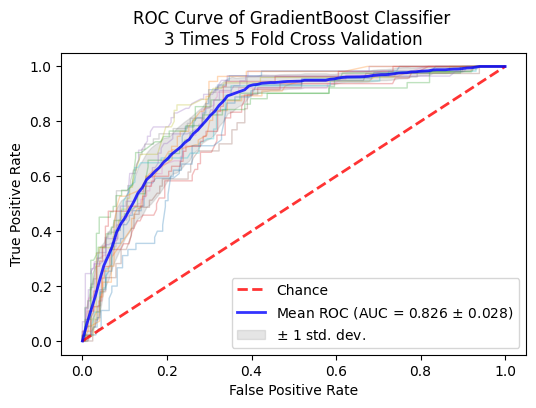

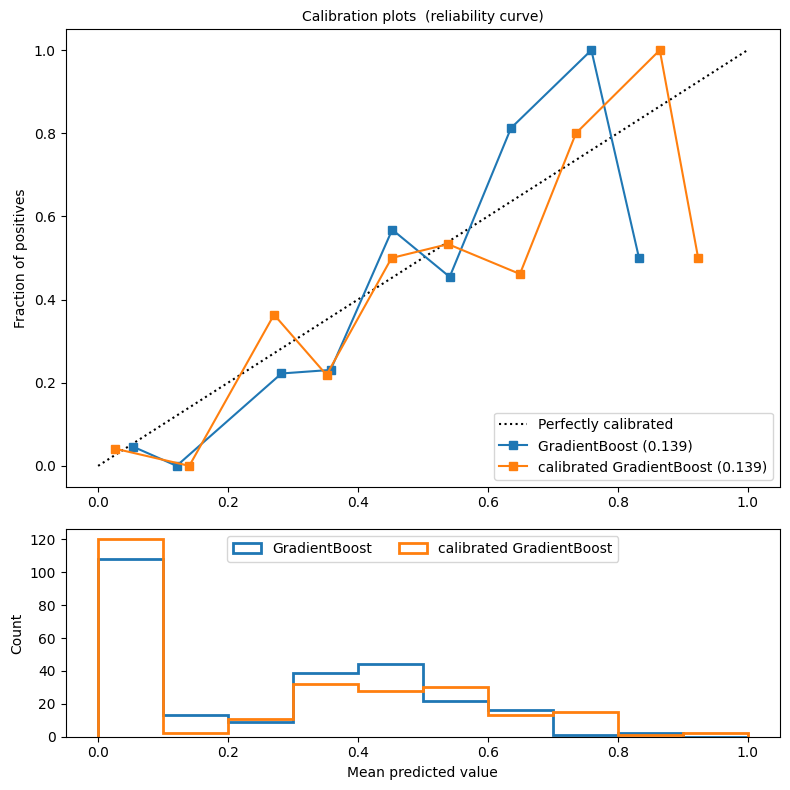

No handles with labels found to put in legend.


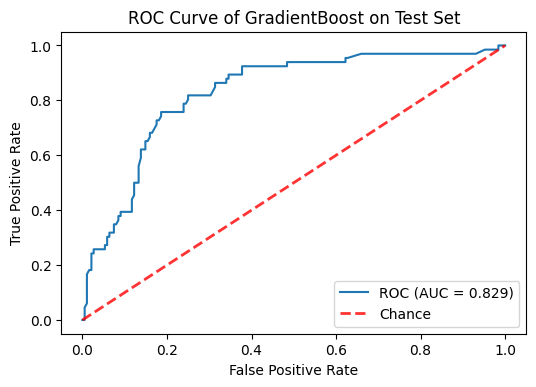

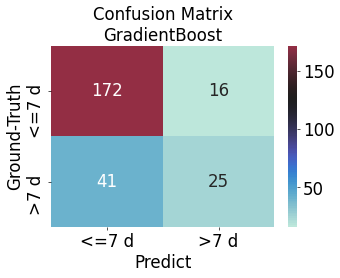

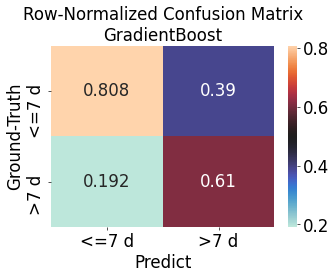

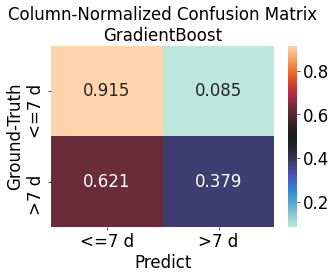

              precision    recall  f1-score   support

       <=7 d      0.808     0.915     0.858       188
        >7 d      0.610     0.379     0.467        66

    accuracy                          0.776       254
   macro avg      0.709     0.647     0.663       254
weighted avg      0.756     0.776     0.756       254

roc_auc: 0.829


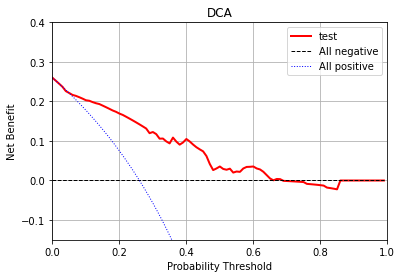

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


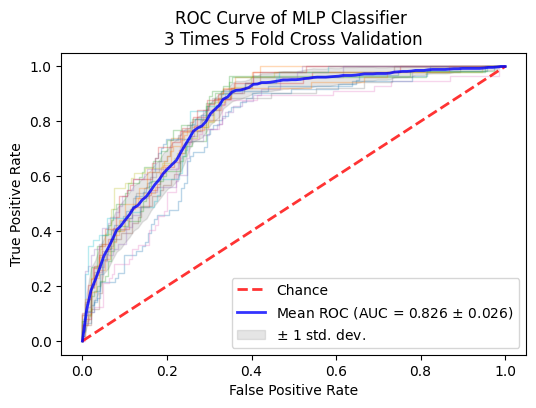

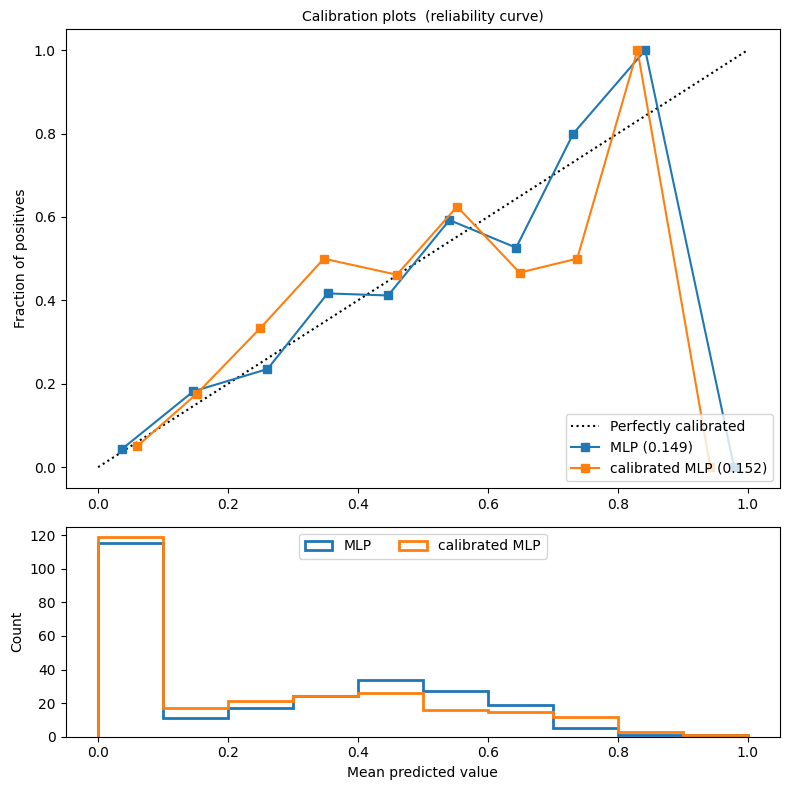

No handles with labels found to put in legend.


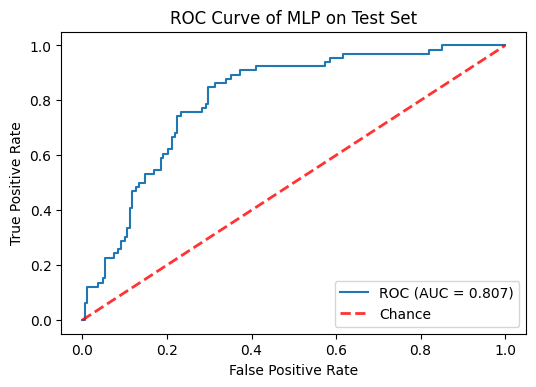

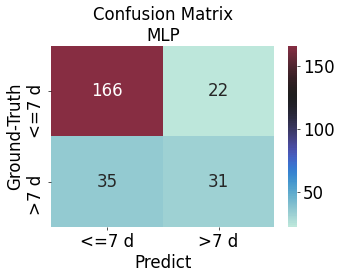

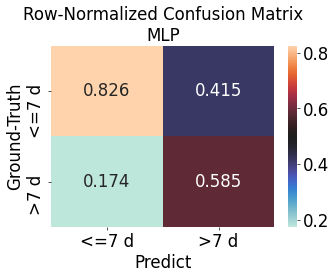

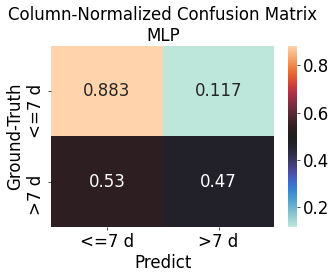

              precision    recall  f1-score   support

       <=7 d      0.826     0.883     0.853       188
        >7 d      0.585     0.470     0.521        66

    accuracy                          0.776       254
   macro avg      0.705     0.676     0.687       254
weighted avg      0.763     0.776     0.767       254

roc_auc: 0.807


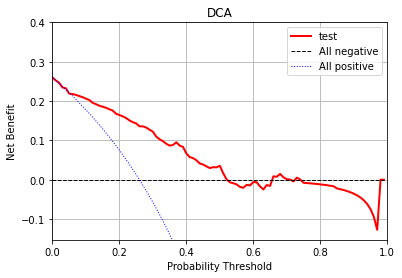

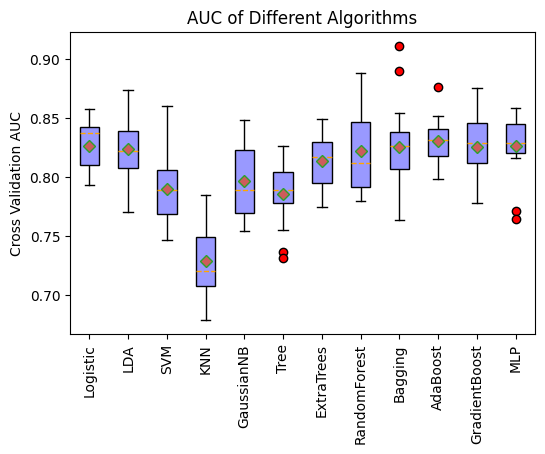

In [6]:
# Traverse all the combinations of feature-selection methods & classifiers

feature_select_method = ['MIC','RFE','EmbeddingLSVC','EmbeddingLR','EmbeddingTree','EmbeddingRF','mRMR']
all_name_selected_features = dict()
for k,method in enumerate(feature_select_method):
    dir_result_method = os.path.join(dir_result,method)
    if not os.path.isdir(dir_result_method):
        os.mkdir(dir_result_method)

    aucs_RepeatedKFold_df,aucs_testset_df,aucs_external_df,best_clf_objects_df,name_selected_features = run_algorithms(
        processed_data,
        data_external=None,
        feature_select_method=method,
        kbest = 25,
        n_splits=n_splits,
        n_repeats=n_repeats,
        dir_result=dir_result_method)
    
    mean_aucs = aucs_RepeatedKFold_df.mean(axis='columns')
    mean_aucs = pd.DataFrame(data=mean_aucs.values[:,np.newaxis],
                             index=mean_aucs.index,
                             columns=[method])
    
    best_clfs_col = pd.DataFrame(best_clf_objects_df['best_clf'].values,
                                 index=best_clf_objects_df.index,
                                 columns=[method] )                             
    
    # names of all the seletcted features
    all_name_selected_features[method] = name_selected_features
    if k==0:
        mean_aucs_matrix = mean_aucs.copy()
        aucs_testset_matrix = aucs_testset_df.copy()
        aucs_external_matrix = aucs_external_df.copy() if aucs_external_df else None
        best_clfs_matrix = best_clfs_col.copy()
    else:
        mean_aucs_matrix = pd.concat([mean_aucs_matrix,mean_aucs],axis=1)
        aucs_testset_matrix = pd.concat([aucs_testset_matrix,aucs_testset_df],axis=1)
        if aucs_external_df and aucs_external_matrix:
            aucs_external_matrix = pd.concat([aucs_external_matrix,aucs_external_df],axis=1) 
        else:
            aucs_external_matrix = None
        best_clfs_matrix = pd.concat([best_clfs_matrix,best_clfs_col],axis=1)

In [7]:
# from sklearn.metrics._plot import base
# dir(base)#._check_classifer_response_method
# base._check_classifier_response_method

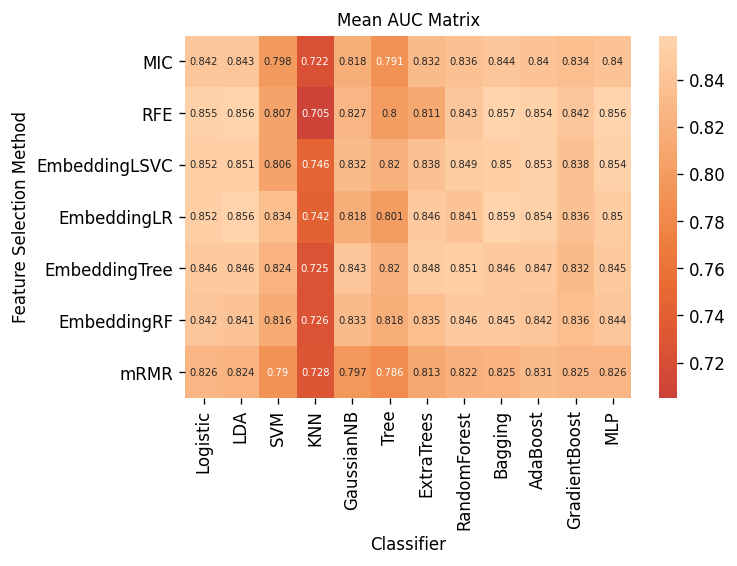

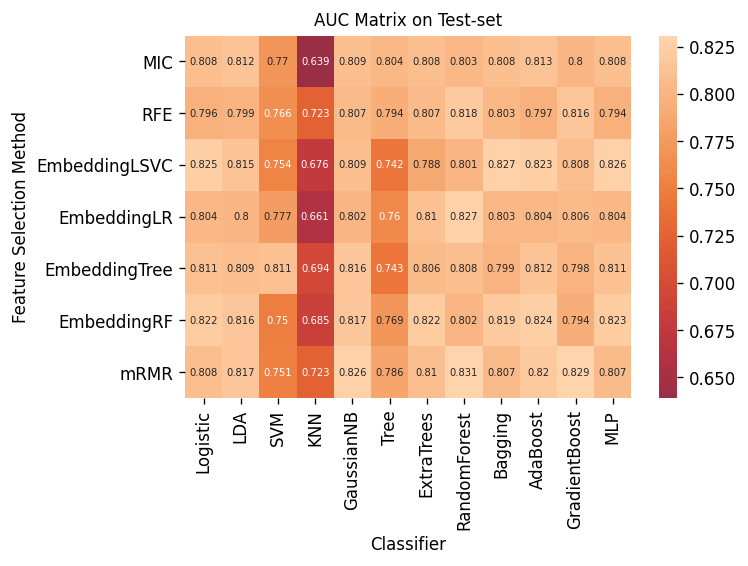

In [31]:
# plot auc matrix
def plot_mean_aucs_matirx(mean_aucs_matrix, fmt='.3g',center=0.5,
                          title='mean AUC Matrix',
                          fn='mean AUC Matrix.png'
                         ):
    """
    plot cv mean auc matrix：axis x is classification algo，axis y is feature selection methods，values are mean_auc
    """

    cm = mean_aucs_matrix.values
    algorithms = mean_aucs_matrix.columns.tolist()
    feature_selection_methods = mean_aucs_matrix.index.tolist()
    
    f,ax = plt.subplots(dpi=120)
    ax = sns.heatmap(cm,annot=True,fmt=fmt,center=center,annot_kws={'size':6,'ha':'center','va':'center'})
    ax.set_title(title,fontsize=10)
    ax.set_xlabel('Classifier',fontsize=10)
    ax.set_ylabel('Feature Selection Method',fontsize=10)
    ax.set_xticklabels(algorithms,fontsize=10, rotation='vertical')
#     plt.xticks([y+1 for y in range(len(x))], x_names, rotation='vertical')
    ax.set_yticklabels(feature_selection_methods,fontsize=10, rotation='horizontal')
    cax = plt.gcf().axes[-1]
    cax.tick_params(labelsize=10)# set font-size of colorbar ticks
    
    plt.savefig(fn, bbox_inches='tight')
    plt.show()
    return f,ax



#　CV AUC
plot_mean_aucs_matirx(mean_aucs_matrix.T, fmt='.3g',
                      title='Mean AUC Matrix',
                      fn=os.path.join(dir_result,'mean AUC Matrix on Train Set RepeatedKFold Cross Validation.png'))
#　internal-test-set AUC
plot_mean_aucs_matirx(aucs_testset_matrix.T, fmt='.3g',
                      title='AUC Matrix on Test-set',
                      fn=os.path.join(dir_result,'AUC Matrix on Test Set.png'))
#　external-test-set AUC
if aucs_external_matrix:
    plot_mean_aucs_matirx(aucs_external_matrix.T, fmt='.3g',
                          title='AUC Matrix on External Data-set',
                          fn=os.path.join(dir_result,'AUC Matrix on External Data-set.png'))

## Ensemble Top-K Classifier 

VotingClassifier / StackingClassifier

In [9]:
best_clfs_matrix_org = best_clfs_matrix.copy()

In [40]:
best_alg_comb

Bagging  EmbeddingLR    0.858644
         RFE            0.856571
LDA      EmbeddingLR    0.856245
dtype: float64

Bagging  EmbeddingLR    0.858644
         RFE            0.856571
LDA      EmbeddingLR    0.856245
dtype: float64

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


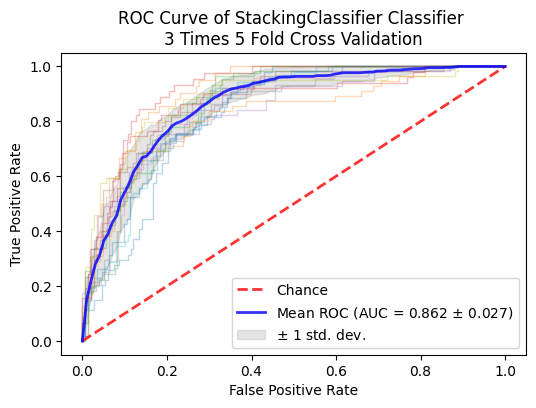

<ipython-input-30-c9810664e0c9>:9: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return X[self.attribute_names].values
No handles with labels found to put in legend.


fail to run plot_calibration_curve_binary_class


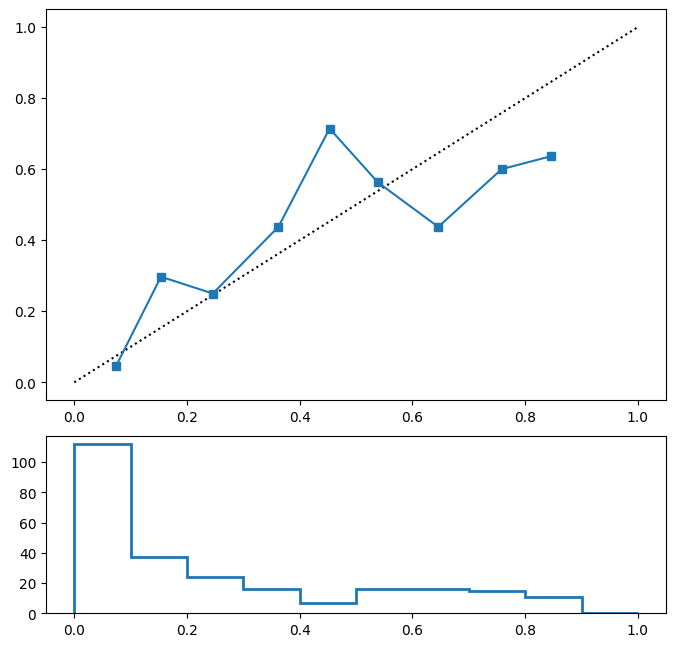

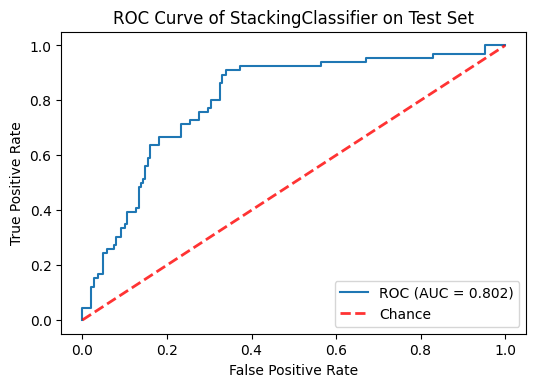

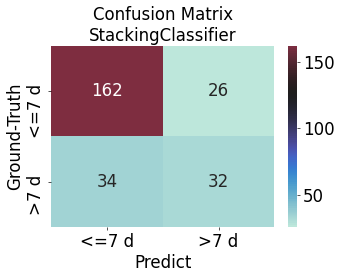

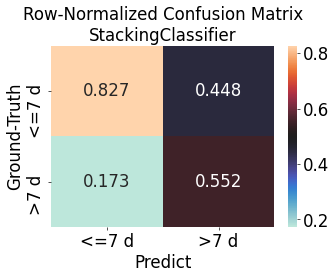

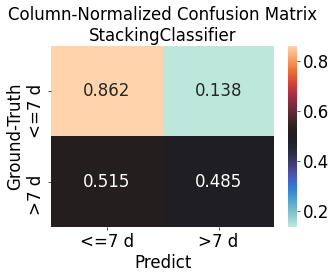

              precision    recall  f1-score   support

       <=7 d      0.827     0.862     0.844       188
        >7 d      0.552     0.485     0.516        66

    accuracy                          0.764       254
   macro avg      0.689     0.673     0.680       254
weighted avg      0.755     0.764     0.759       254

roc_auc: 0.802


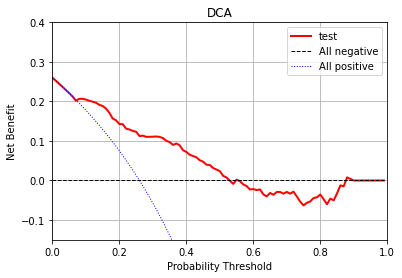

In [30]:
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, attribute_names):
        self.attribute_names = attribute_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.attribute_names].values
    
kbest = 3

# best_clfs_matrix_noDNN = best_clfs_matrix.iloc[0:-1]
if 'DNN' in best_clfs_matrix.index:
    best_clfs_matrix_noDNN = best_clfs_matrix.drop(labels=['DNN'],axis='index')
else:
    best_clfs_matrix_noDNN = best_clfs_matrix.copy()

mean_aucs_matrix_stack = mean_aucs_matrix.stack()
best_alg_comb = mean_aucs_matrix_stack.nlargest(kbest)#panda series
if not os.path.isdir(os.path.join(dir_result,'StackingClassifier')):
    os.mkdir(os.path.join(dir_result,'StackingClassifier'))
fn = os.path.join(dir_result,'StackingClassifier','topN_Algorithm_Combination.csv')
best_alg_comb.to_csv(fn)
display(best_alg_comb)

best_clf = np.zeros([kbest]).tolist()
pipeline = np.zeros([kbest]).tolist()
for k in range(kbest):
    clf_name = best_alg_comb.index[k][0]
    feature_selector_name = best_alg_comb.index[k][1]
    best_clf[k] = best_clfs_matrix_noDNN.loc[ clf_name ][ feature_selector_name ]
    
    selected_features = all_name_selected_features[feature_selector_name]#特征名称列表
    selector = DataFrameSelector(selected_features)

    pipeline[k] = (clf_name+'_'+feature_selector_name,
                   Pipeline( [('selector',selector),('clf',best_clf[k])] )
                  )

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import StackingClassifier
Stacking_clf = StackingClassifier(estimators=pipeline)#, final_estimator=LogisticRegression)
# Stacking_clf.fit( processed_data['X_train'],onehot2label(processed_data['Y_train']) )
# Stacking_clf.predict_proba(processed_data['X_train'])
# from sklearn.ensemble import VotingClassifier
# Voting_clf = VotingClassifier(estimators=pipeline, voting='soft')
# Voting_clf.fit( processed_data['X_train'],onehot2label(processed_data['Y_train']) )


X_train = processed_data['X_train']#.values#dataframe
X_test = processed_data['X_test']#.values#dataframe
Y_train = processed_data['Y_train'].values
Y_test = processed_data['Y_test'].values
X_external,Y_external = None,None
class_names = processed_data['class_names']
# run： CV, internal-test-set，external-test-set
from ultils_for_ML_binary_classify import get_algorithm_result
ret_ensembest_clf,Stacking_clf = get_algorithm_result(
    X_train,Y_train,
    X_test,Y_test,
    X_external,Y_external,
    class_names,
    n_splits,n_repeats,
    classifier=Stacking_clf,#Voting_clf, 
    clf_name='StackingClassifier',#'StackingClassifier',#'VotingClassifier',
    dir_result=dir_result)

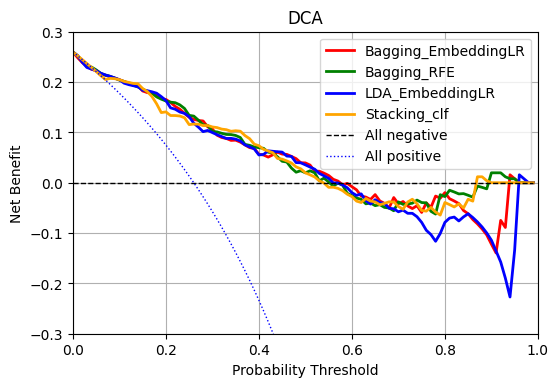

In [20]:
def get_DCA_coords(y_pred,y_true,fn="DCA.png"):
    """
    get coordinates of points of DCA curve
    """
    pt_arr = []
    net_bnf_arr = []
    y_pred = y_pred.ravel()
    for i in range(0,100,1):
        pt = i /100
        #compute TP FP
        y_pred_clip = (y_pred>pt).astype(int)
        TP = np.sum( y_true*np.round(y_pred_clip) )
        FP = np.sum((1 - y_true) * np.round(y_pred_clip))
        net_bnf = ( TP-FP* pt/(1-pt) )/len(y_true)
#         print('pt {}, TP {}, FP {}, net_bf {}'.format(pt,TP,FP,net_bnf))
        pt_arr.append(pt)
        net_bnf_arr.append(net_bnf)
    
    return pt_arr, net_bnf_arr

def plot_multiclfs_DCA(clfs,X,y_true,fn="DCA.png"):
    """
    plot DCA for multi-classifiers
    """
    pi = np.sum(y_true)/len(y_true)# Prevalence
    fig = plt.figure(dpi=100)
    colors = ["red","green","blue","orange"]
    for (clf_name, clf), color in zip(clfs,colors):
        y_proba = clf.predict_proba(X)[:,1]
        pt_arr, net_bnf_arr = get_DCA_coords(y_proba,y_true)
        plt.plot(pt_arr, net_bnf_arr, color=color, lw=2, linestyle='-',label=clf_name)
        
    plt.plot(pt_arr, np.zeros(len(pt_arr)), color='k', lw=1, linestyle='--',label='All negative')
    pt_np = np.array(pt_arr)
    all_pos = pi-(1-pi)*pt_np/(1-pt_np)
    plt.plot(pt_arr, all_pos , color='b', lw=1, linestyle='dotted',label='All positive')
    plt.xlim([0.0, 1.0])
    plt.ylim([-0.3, 0.3])
    plt.xlabel('Probability Threshold')
    plt.ylabel('Net Benefit')
    plt.title('DCA')
    plt.legend()
    plt.grid("on")
    plt.savefig(fn)
    plt.show()
    return None

clfs = pipeline+[("Stacking_clf",Stacking_clf)]
fn = os.path.join(dir_result,"DCA of Top3 and StackingClf.png")
plot_multiclfs_DCA(clfs,X_test,Y_test,fn=fn)

## Feature Importance Sorting

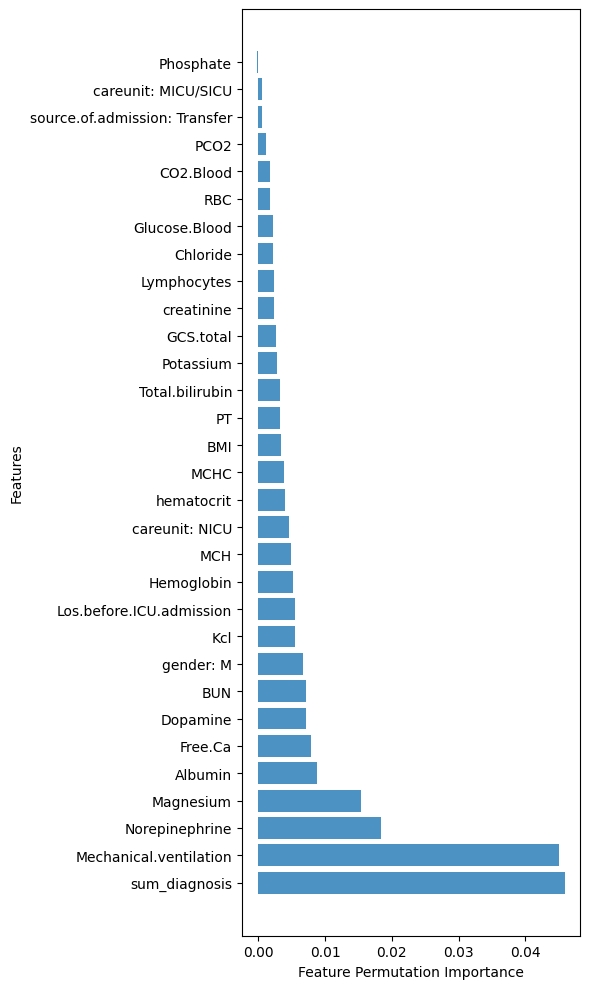

In [12]:
# features importance sorting
stackingclassifier_selected_features = []
for k in range(kbest):
    feature_selector_name = best_alg_comb.index[k][1]
    best_clf[k] = best_clfs_matrix.loc[ clf_name ][ feature_selector_name ]
    stackingclassifier_selected_features += all_name_selected_features[feature_selector_name]#特征名称列表
stackingclassifier_selected_features = list(set(stackingclassifier_selected_features))

import eli5
from eli5.sklearn import PermutationImportance

X_train_stack = X_train[stackingclassifier_selected_features]

Stacking_clf_fitted = Stacking_clf.fit(X_train_stack,Y_train)
perm = PermutationImportance(Stacking_clf_fitted, random_state=42).fit(X_train_stack,Y_train)
eli5.show_weights(perm, feature_names = X_train_stack.columns.tolist(), top=None)

# plot
fig = plt.figure(dpi=100,figsize=(6,10))
feat_imp = pd.DataFrame(data=perm.feature_importances_,
                        index=X_train_stack.columns.tolist(),
                        columns=['feature importance'])
feat_imp.sort_values(by=['feature importance'],axis='index', ascending=False,inplace=True)
y_pos = np.arange(feat_imp.shape[0])
plt.barh(y_pos, feat_imp.values.squeeze(), align='center', alpha=0.8)
plt.yticks(y_pos, feat_imp.index.values)
plt.xlabel("Feature Permutation Importance")
plt.ylabel("Features")
plt.tight_layout()
fn = os.path.join(dir_result,'StackingClassifier','Feature Permutation Importance.png')
plt.savefig(fn, bbox_inches='tight')
plt.show()

## Save importance  variables

In [13]:
result_vars = dict(   
    processed_data = processed_data,
    mean_aucs_matrix = mean_aucs_matrix,
    aucs_testset_matrix = aucs_testset_matrix,
    all_name_selected_features = all_name_selected_features,
    best_clfs_matrix_noDNN = best_clfs_matrix_noDNN, 
    Stacking_clf = Stacking_clf, 
    stackingclassifier_selected_features = stackingclassifier_selected_features,
    feat_imp = feat_imp,
    ret_ensembest_clf = ret_ensembest_clf
    
)
final_allsave_filename = os.path.join(dir_result,'all_python_vars.npy')
np.save(final_allsave_filename,
        result_vars, 
        allow_pickle=True
       )

# Post-process 

## load results

In [14]:
# import os
# import numpy as np
# from sklearn.pipeline import Pipeline
# from sklearn.base import BaseEstimator, TransformerMixin
# class DataFrameSelector(BaseEstimator, TransformerMixin):
#     def __init__(self, attribute_names):
#         self.attribute_names = attribute_names
#     def fit(self, X, y=None):
#         return self
#     def transform(self, X):
#         return X[self.attribute_names].values

# dir_result = './SCI-Paper-results-los_icustay'#结果保存路径
# final_allsave_filename = os.path.join(dir_result,'all_python_vars.npy') 
    
# result_vars = np.load(final_allsave_filename, allow_pickle=True)
# processed_data = result_vars.item()['processed_data']
# mean_aucs_matrix = result_vars.item()['mean_aucs_matrix']
# aucs_testset_matrix = result_vars.item()['aucs_testset_matrix']
# all_name_selected_features = result_vars.item()['all_name_selected_features']
# best_clfs_matrix_noDNN = result_vars.item()['best_clfs_matrix_noDNN']
# Stacking_clf = result_vars.item()['Stacking_clf']
# # stackingclassifier_selected_features = result_vars.item()['stackingclassifier_selected_features']
# # feat_imp = result_vars.item()['feat_imp']
# ret_ensembest_clf = result_vars.item()['ret_ensembest_clf']